## Import modules

In [2]:
# For data processing
import numpy as np
import pandas as pd

# For plotting data
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

# For model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler
from keras.optimizers import Adam
from keras.losses import CategoricalCrossentropy
from keras.metrics import Precision, Recall
from keras.utils import to_categorical
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasClassifier

# Show all rows and columns
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# For progress bar
from tqdm import tqdm

# For handling json files
import json

In [6]:
def create_multi_class_model(hidden_layer_units, input_dim, dropout=False, dropout_rate=0.2, model_name='model'):
    """
    Creates a neural network classifier model with:
        - l hidden layers, where l is len(hidden_layer_units)
        - hidden_layer_units[i] units for i'th layer
        - Categorical Crossentropy loss
        - Adam optimizer
        - Accuracy, precision, and recall metrics
        - Dropout in each layer (optional)
        - Model name model_name
    
    Returns the compiled model.
    """
    model = Sequential(name=model_name)

    # Input layer
    model.add(Dense(hidden_layer_units[0], 
                    activation='relu', 
                    input_dim=input_dim,
                    name='Dense_1'))

    if dropout:
        model.add(Dropout(dropout_rate, name='Dropout_1'))    

    # Add the hidden layers
    for i, units in enumerate(hidden_layer_units[1:], start=2):
        model.add(Dense(units, activation='relu', name=f'Dense_{i}'))
        if dropout:
            model.add(Dropout(dropout_rate, name=f'Dropout_{i}'))

    # Output layer (softmax outputs probabilities for each class)
    num_classes = 3  # Number of output classes
    model.add(Dense(num_classes, activation='softmax', name='Output'))
    
    # Compile the model
    model.compile(loss='categorical_crossentropy', optimizer='adam', 
                  metrics=['accuracy', Precision(name='precision'), Recall(name='recall')])

    return model

def visualize_performance(y_train, y_train_pred, y_test, y_test_pred):
    """
    Creates a confusion matrix visualization for train and test set
    using heatmap with added information such as:
        - Accuracy
        - Precision
        - Recall
        - F1 score
        - True Positive (TP), False Positive (FP), True Negative (TN), False Negative (FN) for each class
        
    Returns the accuracy, precision, recall, and F1 score from test set.
    """
    
    f, ax = plt.subplots(ncols=2, figsize=(14, 4))
    f.suptitle('Training vs Test Performance', fontweight='bold', fontsize='x-large')
    
    # Training set
    cf_train = confusion_matrix(y_train, y_train_pred)
    sns.heatmap(cf_train, fmt='.0f', cmap='Blues', annot=True, ax=ax[0])
    
    # Calculate metrics
    accuracy_train = accuracy_score(y_train, y_train_pred)
    precision_train = precision_score(y_train, y_train_pred, average='weighted')
    recall_train = recall_score(y_train, y_train_pred, average='weighted')
    f1_score_train = f1_score(y_train, y_train_pred, average='weighted')
    
    stats_text_train = "\n\nAccuracy={:.2f}\nPrecision={:.2f}\nRecall={:.2f}\nF1 Score={:.2f}".format(
        accuracy_train, precision_train, recall_train, f1_score_train)
    
    ax[0].set(xlabel='Predicted' + stats_text_train, 
              ylabel='Actual', title='Training Performance')
    
    # Test set
    cf_test = confusion_matrix(y_test, y_test_pred)
    sns.heatmap(cf_test, fmt='.0f', cmap='Blues', annot=True, ax=ax[1])
    
    # Calculate metrics
    accuracy_test = accuracy_score(y_test, y_test_pred)
    precision_test = precision_score(y_test, y_test_pred, average='weighted')
    recall_test = recall_score(y_test, y_test_pred, average='weighted')
    f1_score_test = f1_score(y_test, y_test_pred, average='weighted')
    
    stats_text_test = "\n\nAccuracy={:.2f}\nPrecision={:.2f}\nRecall={:.2f}\nF1 Score={:.2f}".format(
        accuracy_test, precision_test, recall_test, f1_score_test)
    
    ax[1].set(xlabel='Predicted' + stats_text_test, 
              ylabel='Actual', title='Test Performance')
    
    plt.show()
    
    print("Training Metrics:")
    print("Accuracy:", accuracy_train)
    print("Precision:", precision_train)
    print("Recall:", recall_train)
    print("F1 Score:", f1_score_train)
    
    print("\nTest Metrics:")
    print("Accuracy:", accuracy_test)
    print("Precision:", precision_test)
    print("Recall:", recall_test)
    print("F1 Score:", f1_score_test)
    
    # Print TP, FP, TN, FN for each class
    print("\nTraining Confusion Matrix:")
    for i in range(len(cf_train)):
        tp = cf_train[i, i]
        fp = np.sum(cf_train[:, i]) - tp
        fn = np.sum(cf_train[i, :]) - tp
        tn = np.sum(cf_train) - tp - fp - fn
        print(f"Class {i} - TP: {tp}, FP: {fp}, TN: {tn}, FN: {fn}")
    
    print("\nTest Confusion Matrix:")
    for i in range(len(cf_test)):
        tp = cf_test[i, i]
        fp = np.sum(cf_test[:, i]) - tp
        fn = np.sum(cf_test[i, :]) - tp
        tn = np.sum(cf_test) - tp - fp - fn
        print(f"Class {i} - TP: {tp}, FP: {fp}, TN: {tn}, FN: {fn}")
    
    return accuracy_test, precision_test, recall_test, f1_score_test

   
def test_performance(y_test, y_test_pred):
    """ 
    Returns the accuracy, precision, recall, and F1 score from test set.
    """

    # Test set
    cf_test = confusion_matrix(y_test, y_test_pred)
    
    # Calculate metrics
    accuracy_test = np.trace(cf_test) / float(np.sum(cf_test))
    precision_test = cf_test[1,1] / sum(cf_test[:,1])
    recall_test = cf_test[1,1] / sum(cf_test[1,:])
    f1_score_test = 2 * precision_test * recall_test / (precision_test + recall_test)
    
    return accuracy_test, precision_test, recall_test, f1_score_test


def visualize_training_history(history):
    """
    Creates a visualization of model's training process that contains:
        - Loss
        - Accuracy
        - Precision
        - Recall
    """
    f, ax = plt.subplots(nrows=2, ncols=2, figsize=(14, 12))
    f.suptitle('Training History', fontweight='bold', fontsize='x-large')
    
    ax[0][0].plot(history.history['loss'], label='Loss (training data)')
    ax[0][0].set_title('Loss History')
    ax[0][0].set(ylabel='Loss', xlabel='Number of Epochs')
    ax[0][0].legend(loc="upper right")

    ax[0][1].plot(history.history['accuracy'], label='Accuracy (training data)')
    ax[0][1].set_title('Accuracy History')
    ax[0][1].set(ylabel='Loss', xlabel='Number of Epochs')
    ax[0][1].legend(loc="lower right")    
    
    ax[1][0].plot(history.history['precision'], label='Precision (training data)')
    ax[1][0].set_title('Precision History')
    ax[1][0].set(ylabel='Precision', xlabel='Number of Epochs')
    ax[1][0].legend(loc="lower right")
        
    ax[1][1].plot(history.history['recall'], label='Recall (training data)')
    ax[1][1].set_title('Recall History')
    ax[1][1].set(ylabel='Precision', xlabel='Number of Epochs')
    ax[1][1].legend(loc="lower right")

    
def visualize_multiple_training_histories(training_histories):
    """
    Creates a visualization of training histories from different resampling methods.
    
    Input: dictionary (key -> metric, value -> history callback)
    """
    
    
    f, ax = plt.subplots(nrows=2, ncols=2, figsize=(14, 12))
    f.suptitle('Training Histories Between Different Resampling Methods'
               , fontweight='bold', fontsize='x-large')
    
    # Set title and labels for each axis
    ax[0][0].set_title('Loss History')
    ax[0][0].set(ylabel='Loss', xlabel='Number of Epochs')

    ax[1][0].set_title('Precision History')
    ax[1][0].set(ylabel='Precision', xlabel='Number of Epochs')

    ax[0][1].set_title('Accuracy History')
    ax[0][1].set(ylabel='Loss', xlabel='Number of Epochs')

    ax[1][1].set_title('Recall History')
    ax[1][1].set(ylabel='Precision', xlabel='Number of Epochs')
    
    # Plotting data
    for metric, cb in training_histories.items():
        ax[0][0].plot(cb.history['loss'], label=metric)
        ax[0][0].legend(loc="upper right")
        
        ax[0][1].plot(cb.history['accuracy'], label=metric)
        ax[0][1].legend(loc="lower right")
        
        ax[1][0].plot(cb.history['precision'], label=metric)
        ax[1][0].legend(loc="lower right")
        
        ax[1][1].plot(cb.history['recall'], label=metric)
        ax[1][1].legend(loc="lower right")
        
    plt.show()
    

def visualize_tests_performance(tests_performance):
    """
    Display 4 barplots comparing:
        - Accuracy
        - Precision
        - Recall
        - F1 Score
    on test sets between different resampling methods.
    """
    
    f, ax = plt.subplots(nrows=2, ncols=2, figsize=(14, 12))
    f.suptitle('Tests Performance Between Different Resampling Methods'
               , fontweight='bold', fontsize='x-large')
    
    i = 0
    for metric, ls in tests_performance.items():
        # Takes the labels
        x = pd.DataFrame(ls).T.iloc[0].to_list()
        # Takes the values
        y = pd.DataFrame(ls).T.iloc[1].to_list()
        
        plot = sns.barplot(x=x, y=y, ax=ax[i // 2][i % 2])
        
        # Show the actual numbers on the barplots
        for p in plot.patches:
            plot.annotate(format(p.get_height(), '.2f'), 
                           (p.get_x() + p.get_width() / 2., p.get_height()), 
                           ha = 'center', 
                           va = 'center', 
                           xytext = (0, 10), 
                           textcoords = 'offset points')
        
        ax[i // 2][i % 2].set(title=metric)
        ax[i // 2][i % 2].set_ylim(0, 1)
        
        i += 1
    
    plt.show()
    
def standardize(x_train, x_test):
    """
    Standardizes the features using the mean and standard deviation of the training set.
    
    Args:
        x_train (numpy.ndarray): The training set features.
        x_test (numpy.ndarray): The testing set features.
    
    Returns:
        x_train (numpy.ndarray): The standardized training set features.
        x_test (numpy.ndarray): The standardized testing set features.
    """
    # Compute the mean and standard deviation of the training set features
    mu = np.mean(x_train, axis=0)
    sigma = np.std(x_train, axis=0)

    # Standardize the training set features
    x_train = (x_train - mu) / sigma

    # Standardize the testing set features using the same mean and standard deviation
    x_test = (x_test - mu) / sigma

    return x_train, x_test

def repeat_train_and_test(iterations):
    template = {'original': 0, 'oversampled': 0, 'smotetomek': 0, 'bootstrapping': 0}
    winner_count = {'Test Accuracy': template.copy(), 
                    'Test Precision': template.copy(), 
                    'Test Recall': template.copy(), 
                    'Test F1 Score': template.copy()}
    
    original_train_df = pd.read_csv('./datasets/train.csv', index_col=0)
    test_df = pd.read_csv('./datasets/test.csv', index_col=0)
    x_test, y_test = test_df.iloc[:, :-1], test_df.iloc[:, -1]
    
    for i in tqdm(range(iterations)):
        tests_performance = {'Test Accuracy': [], 
                             'Test Precision': [], 
                             'Test Recall': [], 
                             'Test F1 Score': []}

        for resampling_method in ['original', 'oversampled', 'smotetomek', 'bootstrapping']:
            if resampling_method == 'original':
                train_df = original_train_df.copy()
            else:
                train_df = pd.read_csv(f'./datasets/{resampling_method.lower()}_train.csv', index_col=0)
            
            x_train, y_train = train_df.iloc[:, :-1], train_df.iloc[:, -1]
            
            num_classes = 3  # Number of classes (0, 1, 2)
            y_train = to_categorical(y_train, num_classes=num_classes)
            
            # Convert train and test sets to numpy arrays
            x_train_std, x_test_std = standardize(x_train.values, x_test.values)
            
            model = create_multi_class_model([16, 16, 16], input_dim=x_train.shape[1])
            history = model.fit(x_train_std, y_train, batch_size=16, epochs=100, verbose=0)
            
            y_train_pred = np.argmax(model.predict(x_train_std), axis=1)
            y_test_pred = np.argmax(model.predict(x_test_std), axis=1)
            
            accuracy, precision, recall, f1_score = visualize_performance(np.argmax(y_train, axis=1), y_train_pred, y_test, y_test_pred)
            
            tests_performance['Test Accuracy'].append((resampling_method, accuracy))
            tests_performance['Test Precision'].append((resampling_method, precision))
            tests_performance['Test Recall'].append((resampling_method, recall))
            tests_performance['Test F1 Score'].append((resampling_method, f1_score))
        
        for metric, ls in tests_performance.items():
            winner_name = max(ls, key=lambda x: x[1])[0]
            winner_count[metric][winner_name] += 1
            
    return winner_count


def visualize_winner_count(winner_count):
    """
    Displays 4 barplots containing how many times does each resampling method
    did the best compared to other methods after multiple iterations for each metric.
    """

    f, ax = plt.subplots(nrows=2, ncols=2, figsize=(14, 10))
    f.suptitle('Number of Wins Between Different Resampling Methods After Multiple Iterations'
               , fontweight='bold', fontsize='x-large')

    i = 0
    for metric, count in winner_count.items():
        # Takes the labels
        x = list(count.keys())
        # Takes the values
        y = list(count.values())

        plot = sns.barplot(x=x, y=y, ax=ax[i // 2][i % 2])
        for p in plot.patches:
            plot.annotate(format(p.get_height(), '.0f'), 
                           (p.get_x() + p.get_width() / 2., p.get_height()), 
                           ha = 'center', 
                           va = 'center', 
                           xytext = (0, 10), 
                           textcoords = 'offset points')

        ax[i // 2][i % 2].set(title=f'{metric} Win Count', ylabel='Win Count')
        ax[i // 2][i % 2].set_ylim(0, 110)

        i += 1

    plt.show()

## Train Model

In [7]:
# To store training histories of different resampling methods
training_histories = {}
tests_performance = {'Test Accuracy': [], 
                     'Test Precision': [], 
                     'Test Recall': [], 
                     'Test F1 Score': []}

## 1. Model for Original Data

In [8]:
# Import and prepare dataset
train_df = pd.read_csv('./datasets/train.csv', index_col=0)
print(train_df.head())

# One-hot encode 'RISK_CATEGORY'
#train_df = pd.get_dummies(train_df, columns=['RISK_CATEGORY'])

# Convert one-hot encoded columns to integer type
#train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']] = train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']].astype(int)
#print(train_df.head())

train_df = train_df.drop(columns=['NEO_REFERENCE_ID'])

test_df = pd.read_csv('./datasets/test.csv', index_col=0)
test_df = test_df.drop(columns=['NEO_REFERENCE_ID'])

# Split into X and y
x_train, y_train = train_df.iloc[:, :-1], train_df.iloc[:, -1]

# Assuming y_train contains integer labels ranging from 0 to num_classes - 1
num_classes = 3  # Number of classes (0, 1, 2)
y_train = to_categorical(y_train, num_classes=num_classes)
x_test, y_test = test_df.iloc[:, :-1], test_df.iloc[:, -1]

# Standardize inputs
x_train, x_test = standardize(x_train, x_test)

      NEO_REFERENCE_ID  EST_DIA_IN_M(MIN)  EST_DIA_IN_M(MAX)  \
2586           3529625         183.888672         411.187571   
29             3182169          50.647146         113.250461   
1677           3256739         253.837029         567.596853   
1833           3761549         334.622374         748.238376   
3632           3653520          69.912523         156.329154   

      RELATIVE_VELOCITY_KM_PER_SEC  MISS_DIST.(KILOMETERS)  \
2586                      9.551351              27837396.0   
29                        3.838017              12937927.0   
1677                      6.477856              72234080.0   
1833                     18.027267              25818802.0   
3632                     24.300910              71082192.0   

      PERIHELION_DISTANCE  APHELION_DIST  PERIHELION_TIME  MEAN_ANOMALY  \
2586             0.783714       1.338152      2457843.686    141.435423   
29               0.894596       1.275511      2458019.676    343.278084   
1677             

## Create the model

In [9]:
# Create NN model
# Define the architecture of the neural network
hidden_layer_units = [16, 16, 16]  # Define the number of units in each hidden layer
input_dim = x_train.shape[1]  # Set the input dimension based on the number of features

# Create the model
model = create_multi_class_model(hidden_layer_units, input_dim=input_dim, model_name="original_model")
model.summary()

Model: "original_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Dense_1 (Dense)             (None, 16)                176       
                                                                 
 Dense_2 (Dense)             (None, 16)                272       
                                                                 
 Dense_3 (Dense)             (None, 16)                272       
                                                                 
 Output (Dense)              (None, 3)                 51        
                                                                 
Total params: 771
Trainable params: 771
Non-trainable params: 0
_________________________________________________________________


In [10]:
print("Shape of x_train:", x_train.shape)
print("Shape of y_train:", y_train.shape)

Shape of x_train: (2604, 10)
Shape of y_train: (2604, 3)


In [11]:
history = model.fit(x_train, y_train, batch_size=16, epochs=100)

# Save training history
training_histories['Original'] = history

Epoch 1/100
163/163 [==============================] - 3s 4ms/step - loss: 0.8498 - accuracy: 0.6310 - precision: 0.7648 - recall: 0.3034
Epoch 2/100
163/163 [==============================] - 1s 3ms/step - loss: 0.4215 - accuracy: 0.8222 - precision: 0.8349 - recall: 0.8003
Epoch 3/100
163/163 [==============================] - 1s 3ms/step - loss: 0.3213 - accuracy: 0.8621 - precision: 0.8647 - recall: 0.8587
Epoch 4/100
163/163 [==============================] - 1s 4ms/step - loss: 0.2844 - accuracy: 0.8817 - precision: 0.8822 - recall: 0.8802
Epoch 5/100
163/163 [==============================] - 1s 3ms/step - loss: 0.2549 - accuracy: 0.8936 - precision: 0.8935 - recall: 0.8929
Epoch 6/100
163/163 [==============================] - 1s 3ms/step - loss: 0.2399 - accuracy: 0.9002 - precision: 0.9005 - recall: 0.9002
Epoch 7/100
163/163 [==============================] - 1s 3ms/step - loss: 0.2189 - accuracy: 0.9147 - precision: 0.9147 - recall: 0.9144
Epoch 8/100
163/163 [=============

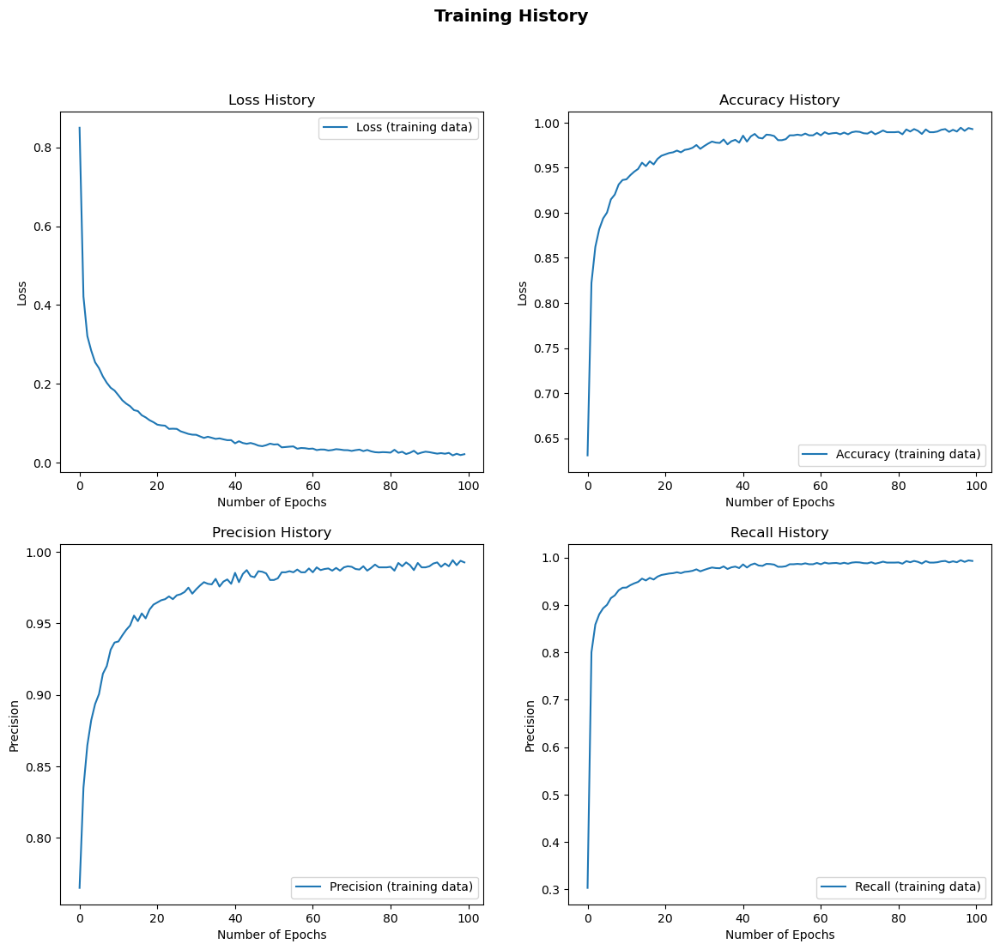

In [12]:
visualize_training_history(history)

35/35 [==============================] - 0s 3ms/step


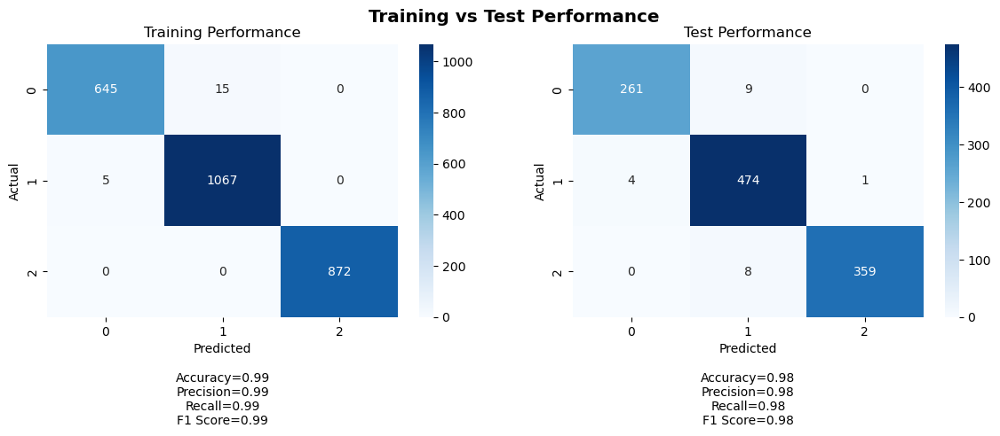

Training Metrics:
Accuracy: 0.9923195084485407
Precision: 0.9923432062541239
Recall: 0.9923195084485407
F1 Score: 0.9923080220343611

Test Metrics:
Accuracy: 0.9802867383512545
Precision: 0.9805739807101376
Recall: 0.9802867383512545
F1 Score: 0.9803154176186334

Training Confusion Matrix:
Class 0 - TP: 645, FP: 5, TN: 1939, FN: 15
Class 1 - TP: 1067, FP: 15, TN: 1517, FN: 5
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 4, TN: 842, FN: 9
Class 1 - TP: 474, FP: 17, TN: 620, FN: 5
Class 2 - TP: 359, FP: 1, TN: 748, FN: 8


In [13]:
# Convert one-hot encoded labels to integer labels
y_train_labels = np.argmax(y_train, axis=1)

# Convert y_test to a numpy array if it's not already
y_test_array = y_test.values if isinstance(y_test, pd.Series) else y_test

# Get predictions for both train and test set
y_train_pred = np.argmax(model.predict(x_train), axis=1)
y_test_pred = np.argmax(model.predict(x_test), axis=1)

# Calculate metrics using the true labels and predicted labels
accuracy0, precision0, recall0, f1_score0 = visualize_performance(y_train_labels, y_train_pred, y_test_array, y_test_pred)

# Save values
tests_performance['Test Accuracy'].append(('Original', accuracy0))
tests_performance['Test Precision'].append(('Original', precision0))
tests_performance['Test Recall'].append(('Original', recall0))
tests_performance['Test F1 Score'].append(('Original', f1_score0))


## 2. Model for Oversampling data

In [14]:
# Import and prepare dataset
train_df = pd.read_csv('./datasets/oversampled_train.csv', index_col=0)
print(train_df.head())

# One-hot encode 'RISK_CATEGORY'
#train_df = pd.get_dummies(train_df, columns=['RISK_CATEGORY'])

# Convert one-hot encoded columns to integer type
#train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']] = train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']].astype(int)
#print(train_df.head())

train_df = train_df.drop(columns=['NEO_REFERENCE_ID'])

test_df = pd.read_csv('./datasets/test.csv', index_col=0)
test_df = test_df.drop(columns=['NEO_REFERENCE_ID'])

# Split into X and y
x_train, y_train = train_df.iloc[:, :-1], train_df.iloc[:, -1]

# Assuming y_train contains integer labels ranging from 0 to num_classes - 1
num_classes = 3  # Number of classes (0, 1, 2)
y_train = to_categorical(y_train, num_classes=num_classes)
x_test, y_test = test_df.iloc[:, :-1], test_df.iloc[:, -1]

# Standardize inputs
x_train, x_test = standardize(x_train, x_test)

   NEO_REFERENCE_ID  EST_DIA_IN_M(MIN)  EST_DIA_IN_M(MAX)  \
0           3529625         183.888672         411.187571   
1           3182169          50.647146         113.250461   
2           3256739         253.837029         567.596853   
3           3761549         334.622374         748.238376   
4           3653520          69.912523         156.329154   

   RELATIVE_VELOCITY_KM_PER_SEC  MISS_DIST.(KILOMETERS)  PERIHELION_DISTANCE  \
0                      9.551351              27837396.0             0.783714   
1                      3.838017              12937927.0             0.894596   
2                      6.477856              72234080.0             1.239713   
3                     18.027267              25818802.0             0.993025   
4                     24.300910              71082192.0             0.922122   

   APHELION_DIST  PERIHELION_TIME  MEAN_ANOMALY  MEAN_MOTION  HAZARDOUS  \
0       1.338152      2457843.686    141.435423     0.901929          0   
1 

In [15]:
# Create NN model
# Define the architecture of the neural network
hidden_layer_units = [16, 16, 16]  # Define the number of units in each hidden layer
input_dim = x_train.shape[1]  # Set the input dimension based on the number of features

# Create the model
model = create_multi_class_model(hidden_layer_units, input_dim=input_dim, model_name="oversampling_model")
model.summary()

Model: "oversampling_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Dense_1 (Dense)             (None, 16)                176       
                                                                 
 Dense_2 (Dense)             (None, 16)                272       
                                                                 
 Dense_3 (Dense)             (None, 16)                272       
                                                                 
 Output (Dense)              (None, 3)                 51        
                                                                 
Total params: 771
Trainable params: 771
Non-trainable params: 0
_________________________________________________________________


In [16]:
history = model.fit(x_train, y_train, batch_size=16, epochs=100)
training_histories['Oversampling'] = history

Epoch 1/100
201/201 [==============================] - 3s 3ms/step - loss: 0.8036 - accuracy: 0.6266 - precision: 0.8294 - recall: 0.3265
Epoch 2/100
201/201 [==============================] - 1s 3ms/step - loss: 0.4290 - accuracy: 0.8209 - precision: 0.8313 - recall: 0.7817
Epoch 3/100
201/201 [==============================] - 1s 3ms/step - loss: 0.3406 - accuracy: 0.8520 - precision: 0.8535 - recall: 0.8495
Epoch 4/100
201/201 [==============================] - 1s 3ms/step - loss: 0.2915 - accuracy: 0.8685 - precision: 0.8685 - recall: 0.8685
Epoch 5/100
201/201 [==============================] - 1s 3ms/step - loss: 0.2558 - accuracy: 0.8877 - precision: 0.8877 - recall: 0.8877
Epoch 6/100
201/201 [==============================] - 1s 3ms/step - loss: 0.2186 - accuracy: 0.9132 - precision: 0.9135 - recall: 0.9129
Epoch 7/100
201/201 [==============================] - 1s 3ms/step - loss: 0.1872 - accuracy: 0.9226 - precision: 0.9226 - recall: 0.9226
Epoch 8/100
201/201 [=============

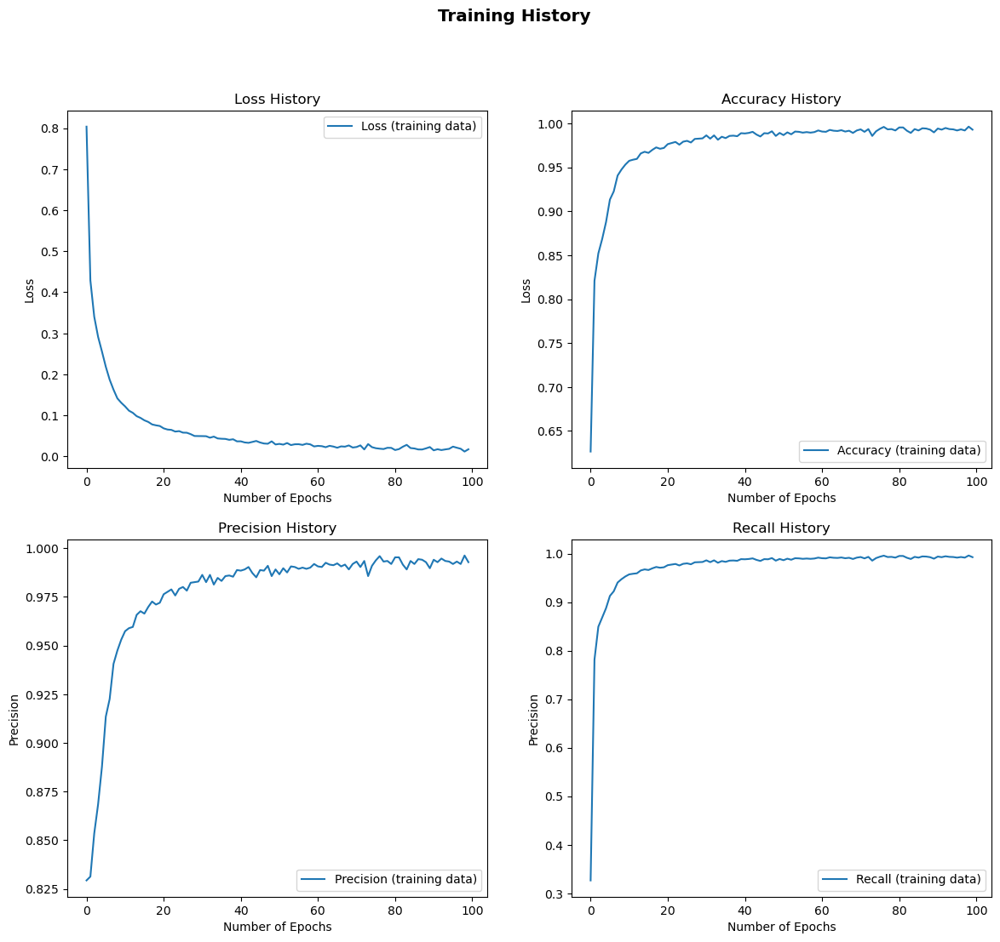

In [17]:
visualize_training_history(history)

35/35 [==============================] - 0s 2ms/step


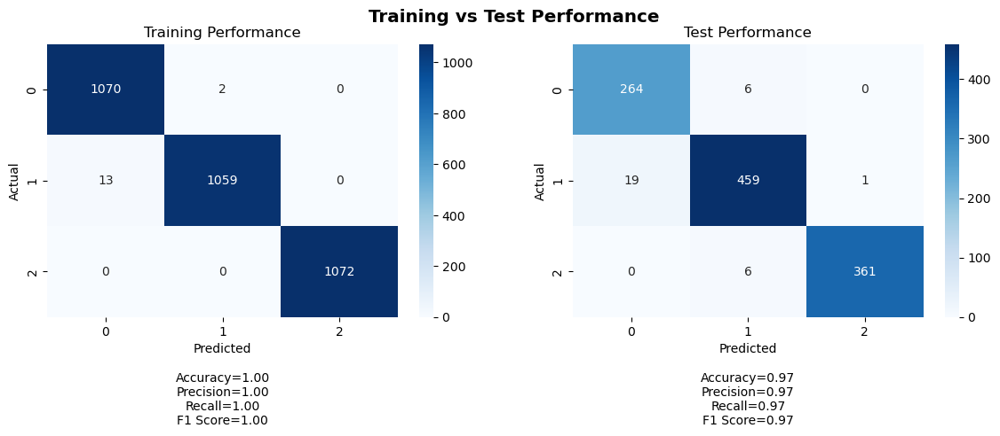

Training Metrics:
Accuracy: 0.9953358208955224
Precision: 0.9953704308060858
Recall: 0.9953358208955224
F1 Score: 0.995335698116984

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9719132237533042
Recall: 0.9713261648745519
F1 Score: 0.971447230635151

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 13, TN: 2131, FN: 2
Class 1 - TP: 1059, FP: 2, TN: 2142, FN: 13
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 19, TN: 827, FN: 6
Class 1 - TP: 459, FP: 12, TN: 625, FN: 20
Class 2 - TP: 361, FP: 1, TN: 748, FN: 6


In [18]:
# Convert one-hot encoded labels to integer labels
y_train_labels = np.argmax(y_train, axis=1)

# Convert y_test to a numpy array if it's not already
y_test_array = y_test.values if isinstance(y_test, pd.Series) else y_test

# Get predictions for both train and test set
y_train_pred = np.argmax(model.predict(x_train), axis=1)
y_test_pred = np.argmax(model.predict(x_test), axis=1)

# Calculate metrics using the true labels and predicted labels
accuracy1, precision1, recall1, f1_score_result1 = visualize_performance(y_train_labels, y_train_pred, y_test_array, y_test_pred)

# Save values
tests_performance['Test Accuracy'].append(('Oversampling', accuracy1))
tests_performance['Test Precision'].append(('Oversampling', precision1))
tests_performance['Test Recall'].append(('Oversampling', recall1))
tests_performance['Test F1 Score' ].append(('Oversampling', f1_score_result1))


## 3. Model for Smotetomek data

In [19]:
# Import and prepare dataset
train_df = pd.read_csv('./datasets/smotetomek_train.csv', index_col=0)
print(train_df.head())

# One-hot encode 'RISK_CATEGORY'
#train_df = pd.get_dummies(train_df, columns=['RISK_CATEGORY'])

# Convert one-hot encoded columns to integer type
#train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']] = train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']].astype(int)
#print(train_df.head())

train_df = train_df.drop(columns=['NEO_REFERENCE_ID'])

test_df = pd.read_csv('./datasets/test.csv', index_col=0)
test_df = test_df.drop(columns=['NEO_REFERENCE_ID'])

# Split into X and y
x_train, y_train = train_df.iloc[:, :-1], train_df.iloc[:, -1]

# Assuming y_train contains integer labels ranging from 0 to num_classes - 1
num_classes = 3  # Number of classes (0, 1, 2)
y_train = to_categorical(y_train, num_classes=num_classes)
x_test, y_test = test_df.iloc[:, :-1], test_df.iloc[:, -1]

# Standardize inputs
x_train, x_test = standardize(x_train, x_test)

   NEO_REFERENCE_ID  EST_DIA_IN_M(MIN)  EST_DIA_IN_M(MAX)  \
0           3182169          50.647146         113.250461   
1           3256739         253.837029         567.596853   
2           3761549         334.622374         748.238376   
3           3653520          69.912523         156.329154   
4           3071917         265.800000         594.346868   

   RELATIVE_VELOCITY_KM_PER_SEC  MISS_DIST.(KILOMETERS)  PERIHELION_DISTANCE  \
0                      3.838017              12937927.0             0.894596   
1                      6.477856              72234080.0             1.239713   
2                     18.027267              25818802.0             0.993025   
3                     24.300910              71082192.0             0.922122   
4                     10.896092              33441924.0             1.163723   

   APHELION_DIST  PERIHELION_TIME  MEAN_ANOMALY  MEAN_MOTION  HAZARDOUS  \
0       1.275511      2458019.676    343.278084     0.872021          0   
1 

In [20]:
# Create NN model
# Define the architecture of the neural network
hidden_layer_units = [16, 16, 16]  # Define the number of units in each hidden layer
input_dim = x_train.shape[1]  # Set the input dimension based on the number of features

# Create the model
model = create_multi_class_model(hidden_layer_units, input_dim=input_dim, model_name="smotetomek_model")
model.summary()

Model: "smotetomek_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Dense_1 (Dense)             (None, 16)                176       
                                                                 
 Dense_2 (Dense)             (None, 16)                272       
                                                                 
 Dense_3 (Dense)             (None, 16)                272       
                                                                 
 Output (Dense)              (None, 3)                 51        
                                                                 
Total params: 771
Trainable params: 771
Non-trainable params: 0
_________________________________________________________________


In [21]:
history = model.fit(x_train, y_train, batch_size=16, epochs=100)
training_histories['SMOTETomek'] = history

Epoch 1/100
151/151 [==============================] - 2s 3ms/step - loss: 0.9439 - accuracy: 0.5290 - precision: 0.6867 - recall: 0.1987
Epoch 2/100
151/151 [==============================] - 1s 3ms/step - loss: 0.4616 - accuracy: 0.7980 - precision: 0.8178 - recall: 0.7653
Epoch 3/100
151/151 [==============================] - 1s 3ms/step - loss: 0.3089 - accuracy: 0.8667 - precision: 0.8678 - recall: 0.8642
Epoch 4/100
151/151 [==============================] - 0s 3ms/step - loss: 0.2462 - accuracy: 0.8974 - precision: 0.8973 - recall: 0.8969
Epoch 5/100
151/151 [==============================] - 0s 3ms/step - loss: 0.2061 - accuracy: 0.9180 - precision: 0.9180 - recall: 0.9180
Epoch 6/100
151/151 [==============================] - 0s 3ms/step - loss: 0.1818 - accuracy: 0.9230 - precision: 0.9230 - recall: 0.9230
Epoch 7/100
151/151 [==============================] - 1s 3ms/step - loss: 0.1627 - accuracy: 0.9350 - precision: 0.9350 - recall: 0.9350
Epoch 8/100
151/151 [=============

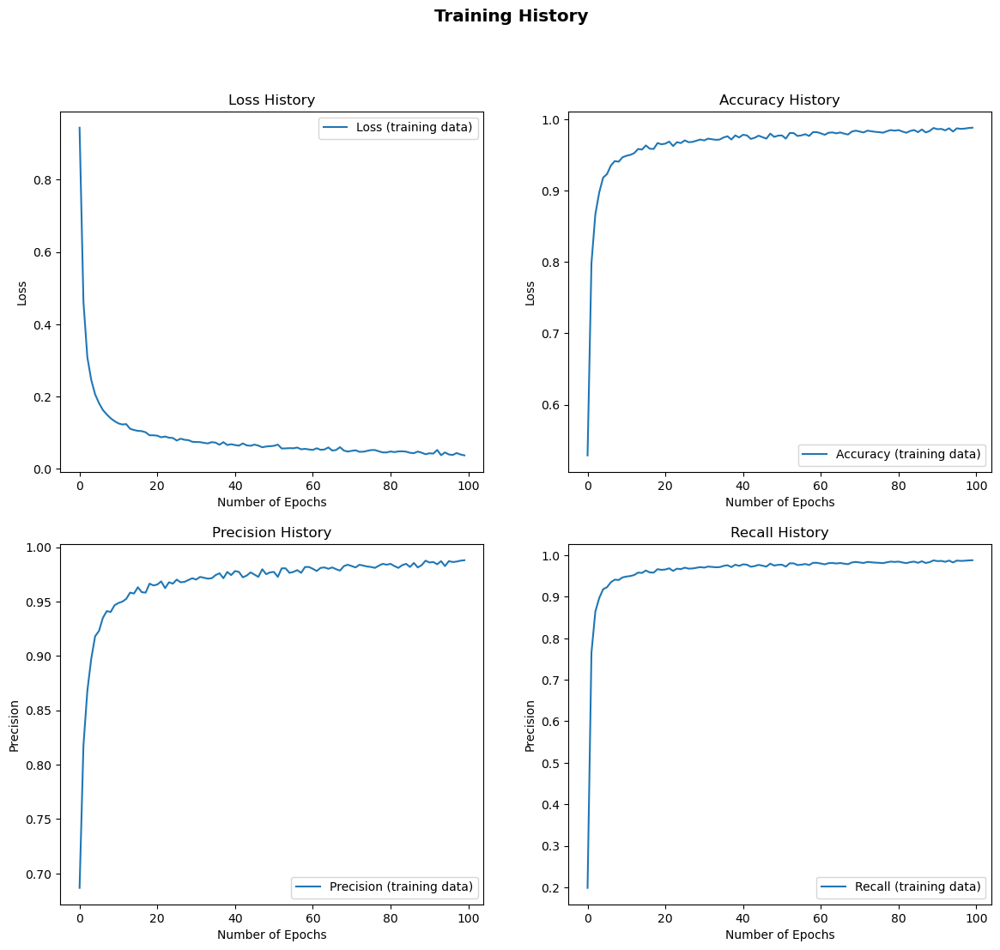

In [22]:
visualize_training_history(history)

35/35 [==============================] - 0s 3ms/step


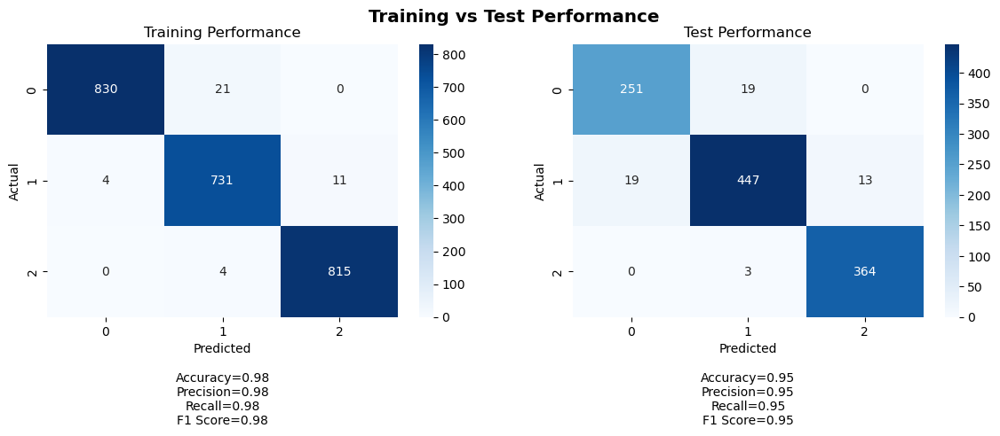

Training Metrics:
Accuracy: 0.9834437086092715
Precision: 0.9835854194526029
Recall: 0.9834437086092715
F1 Score: 0.9834598335787459

Test Metrics:
Accuracy: 0.9516129032258065
Precision: 0.9515015631098177
Recall: 0.9516129032258065
F1 Score: 0.9514540472716292

Training Confusion Matrix:
Class 0 - TP: 830, FP: 4, TN: 1561, FN: 21
Class 1 - TP: 731, FP: 25, TN: 1645, FN: 15
Class 2 - TP: 815, FP: 11, TN: 1586, FN: 4

Test Confusion Matrix:
Class 0 - TP: 251, FP: 19, TN: 827, FN: 19
Class 1 - TP: 447, FP: 22, TN: 615, FN: 32
Class 2 - TP: 364, FP: 13, TN: 736, FN: 3


In [23]:
# Convert one-hot encoded labels to integer labels
y_train_labels = np.argmax(y_train, axis=1)

# Convert y_test to a numpy array if it's not already
y_test_array = y_test.values if isinstance(y_test, pd.Series) else y_test

# Get predictions for both train and test set
y_train_pred = np.argmax(model.predict(x_train), axis=1)
y_test_pred = np.argmax(model.predict(x_test), axis=1)

# Calculate metrics using the true labels and predicted labels
accuracy2, precision2, recall2, f1_score2 = visualize_performance(y_train_labels, y_train_pred, y_test_array, y_test_pred)

# Save values
tests_performance['Test Accuracy'].append(('SMOTETomek', accuracy2))
tests_performance['Test Precision'].append(('SMOTETomek', precision2))
tests_performance['Test Recall'].append(('SMOTETomek', recall2))
tests_performance['Test F1 Score' ].append(('SMOTETomek', f1_score2))


## 4. Model for Bootstrapping data

In [24]:
# Import and prepare dataset
train_df = pd.read_csv('./datasets/bootstrapping_train.csv', index_col=0)
print(train_df.head())

# One-hot encode 'RISK_CATEGORY'
#train_df = pd.get_dummies(train_df, columns=['RISK_CATEGORY'])

# Convert one-hot encoded columns to integer type
#train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']] = train_df[['RISK_CATEGORY_0', 'RISK_CATEGORY_1', 'RISK_CATEGORY_2']].astype(int)
#print(train_df.head())

train_df = train_df.drop(columns=['NEO_REFERENCE_ID'])

test_df = pd.read_csv('./datasets/test.csv', index_col=0)
test_df = test_df.drop(columns=['NEO_REFERENCE_ID'])

# Split into X and y
x_train, y_train = train_df.iloc[:, :-1], train_df.iloc[:, -1]

# Assuming y_train contains integer labels ranging from 0 to num_classes - 1
num_classes = 3  # Number of classes (0, 1, 2)
y_train = to_categorical(y_train, num_classes=num_classes)
x_test, y_test = test_df.iloc[:, :-1], test_df.iloc[:, -1]

# Standardize inputs
x_train, x_test = standardize(x_train, x_test)

   NEO_REFERENCE_ID  EST_DIA_IN_M(MIN)  EST_DIA_IN_M(MAX)  \
0           3529625         183.888672         411.187571   
1           3256739         253.837029         567.596853   
2           3653520          69.912523         156.329154   
3           3071917         265.800000         594.346868   
4           3766293          23.150212          51.765448   

   RELATIVE_VELOCITY_KM_PER_SEC  MISS_DIST.(KILOMETERS)  PERIHELION_DISTANCE  \
0                      9.551351              27837396.0             0.783714   
1                      6.477856              72234080.0             1.239713   
2                     24.300910              71082192.0             0.922122   
3                     10.896092              33441924.0             1.163723   
4                     13.348297              25744922.0             0.826214   

   APHELION_DIST  PERIHELION_TIME  MEAN_ANOMALY  MEAN_MOTION  HAZARDOUS  \
0       1.338152      2457843.686    141.435423     0.901929        0.0   
1 

In [25]:
# Create NN model
# Define the architecture of the neural network
hidden_layer_units = [16, 16, 16]  # Define the number of units in each hidden layer
input_dim = x_train.shape[1]  # Set the input dimension based on the number of features

# Create the model
model = create_multi_class_model(hidden_layer_units, input_dim=input_dim, model_name="bootstrapping_model")
model.summary()
#model = create_multi_class_model([16, 16, 16], input_dim=len(x_train[0]),model_name='bootstrapping_model')


Model: "bootstrapping_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Dense_1 (Dense)             (None, 16)                176       
                                                                 
 Dense_2 (Dense)             (None, 16)                272       
                                                                 
 Dense_3 (Dense)             (None, 16)                272       
                                                                 
 Output (Dense)              (None, 3)                 51        
                                                                 
Total params: 771
Trainable params: 771
Non-trainable params: 0
_________________________________________________________________


In [26]:
history = model.fit(x_train, y_train, batch_size=16, epochs=100)
training_histories['Bootstrapping'] = history

Epoch 1/100
189/189 [==============================] - 3s 3ms/step - loss: 0.7900 - accuracy: 0.6592 - precision: 0.8746 - recall: 0.3236
Epoch 2/100
189/189 [==============================] - 1s 3ms/step - loss: 0.3866 - accuracy: 0.8382 - precision: 0.8443 - recall: 0.8236
Epoch 3/100
189/189 [==============================] - 1s 3ms/step - loss: 0.2865 - accuracy: 0.8876 - precision: 0.8877 - recall: 0.8859
Epoch 4/100
189/189 [==============================] - 1s 3ms/step - loss: 0.2320 - accuracy: 0.9075 - precision: 0.9074 - recall: 0.9068
Epoch 5/100
189/189 [==============================] - 1s 3ms/step - loss: 0.2014 - accuracy: 0.9237 - precision: 0.9237 - recall: 0.9237
Epoch 6/100
189/189 [==============================] - 1s 3ms/step - loss: 0.1758 - accuracy: 0.9340 - precision: 0.9340 - recall: 0.9340
Epoch 7/100
189/189 [==============================] - 1s 3ms/step - loss: 0.1605 - accuracy: 0.9400 - precision: 0.9400 - recall: 0.9400
Epoch 8/100
189/189 [=============

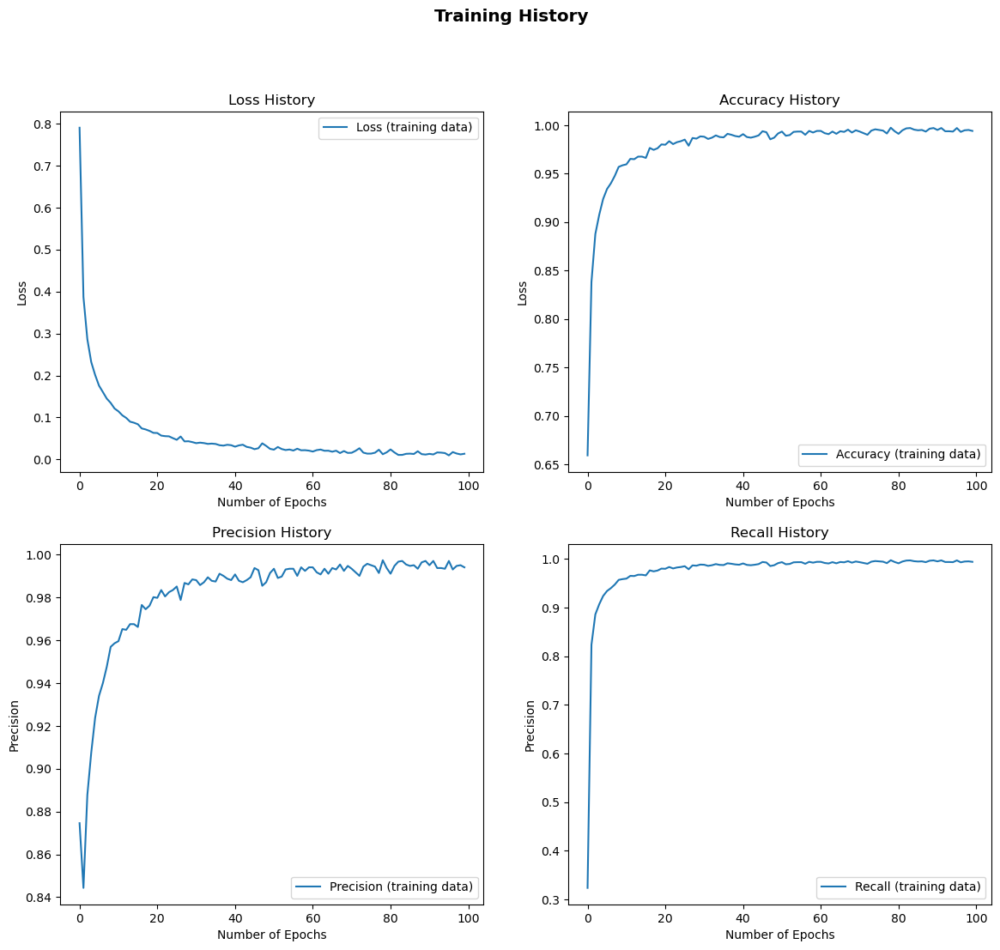

In [27]:
visualize_training_history(history)

35/35 [==============================] - 0s 2ms/step


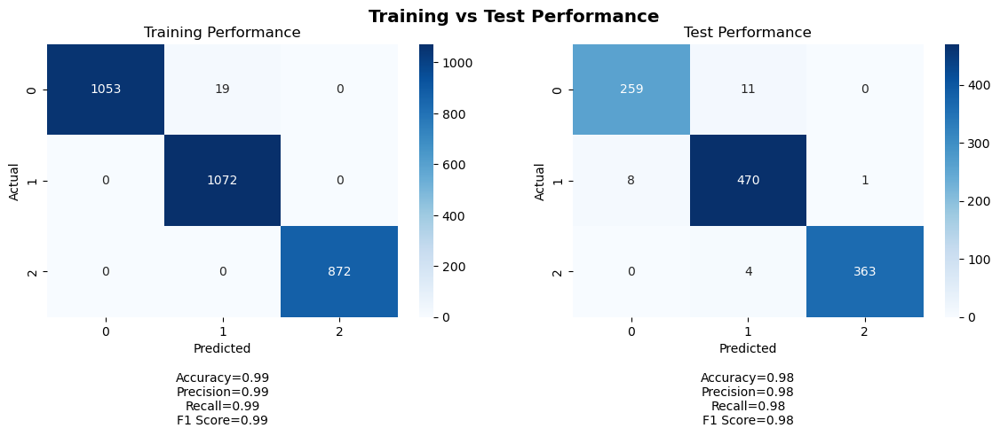

Training Metrics:
Accuracy: 0.9937002652519894
Precision: 0.9938099764895807
Recall: 0.9937002652519894
F1 Score: 0.9936997704698527

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9785729727702671
Recall: 0.978494623655914
F1 Score: 0.9785047995099116

Training Confusion Matrix:
Class 0 - TP: 1053, FP: 0, TN: 1944, FN: 19
Class 1 - TP: 1072, FP: 19, TN: 1925, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 8, TN: 838, FN: 11
Class 1 - TP: 470, FP: 15, TN: 622, FN: 9
Class 2 - TP: 363, FP: 1, TN: 748, FN: 4


In [28]:
# Convert one-hot encoded labels to integer labels
y_train_labels = np.argmax(y_train, axis=1)

# Convert y_test to a numpy array if it's not already
y_test_array = y_test.values if isinstance(y_test, pd.Series) else y_test

# Get predictions for both train and test set
y_train_pred = np.argmax(model.predict(x_train), axis=1)
y_test_pred = np.argmax(model.predict(x_test), axis=1)

# Calculate metrics using the true labels and predicted labels
accuracy3, precision3, recall3, f1_score3 = visualize_performance(y_train_labels, y_train_pred, y_test_array, y_test_pred)

# Save values
tests_performance['Test Accuracy'].append(('Bootstrapping', accuracy3))
tests_performance['Test Precision'].append(('Bootstrapping', precision3))
tests_performance['Test Recall'].append(('Bootstrapping', recall3))
tests_performance['Test F1 Score' ].append(('Bootstrapping', f1_score3))


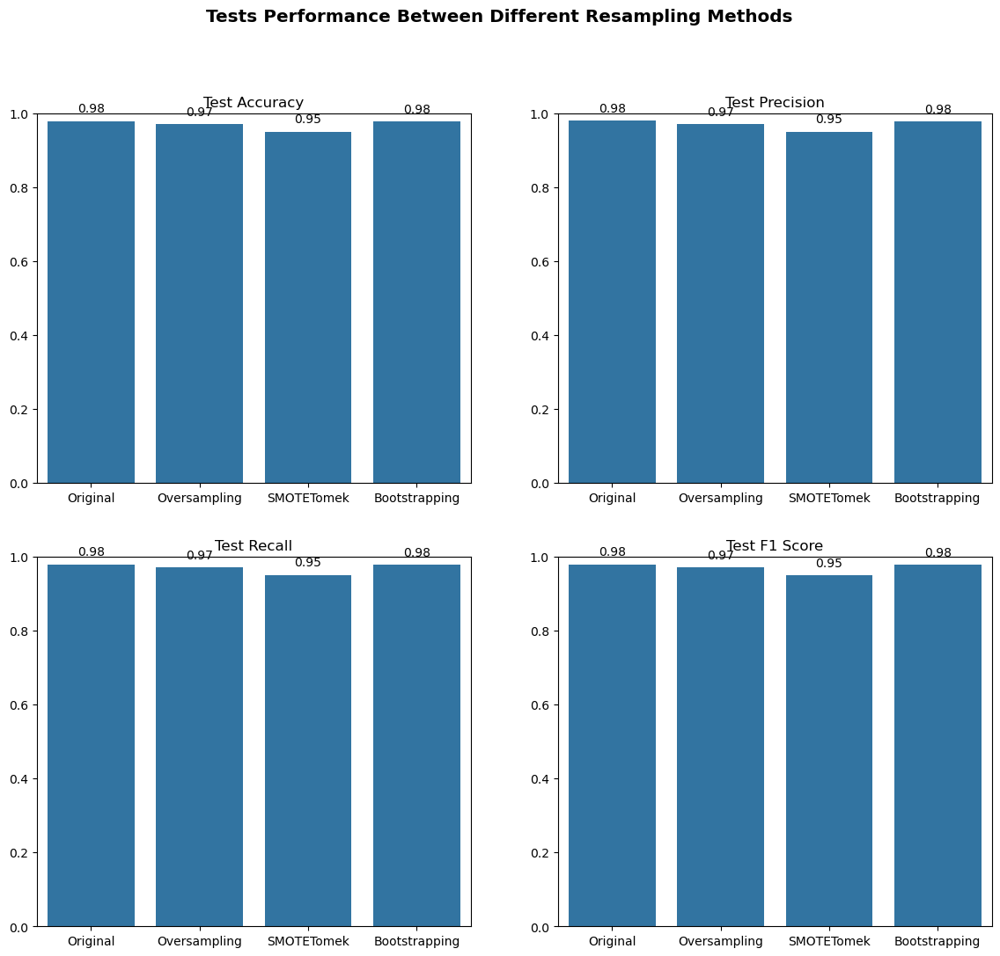

In [29]:
visualize_tests_performance(tests_performance)

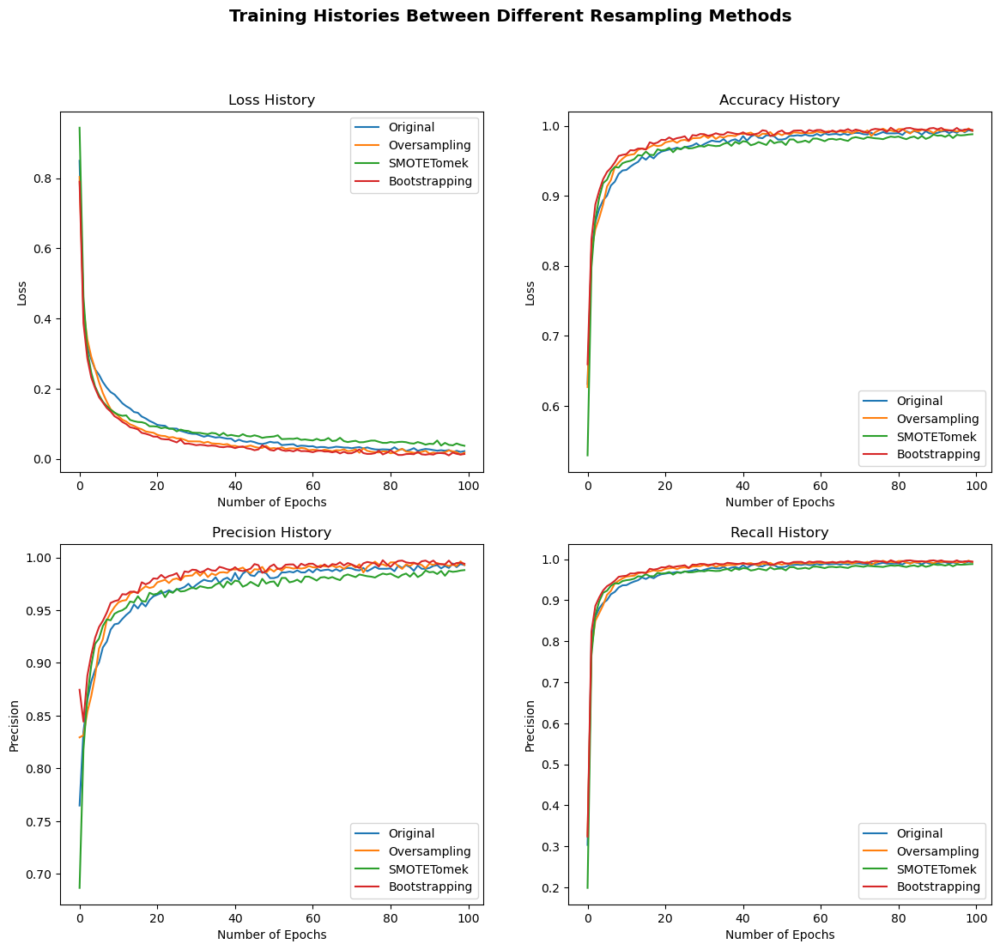

In [30]:
visualize_multiple_training_histories(training_histories)

  0%|          | 0/100 [00:00<?, ?it/s]

35/35 [==============================] - 0s 2ms/step


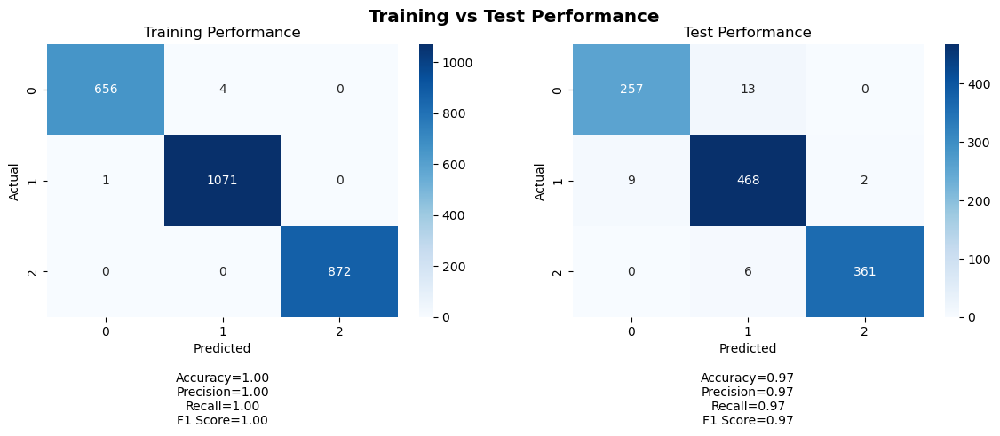

Training Metrics:
Accuracy: 0.9980798771121352
Precision: 0.9980824103612335
Recall: 0.9980798771121352
F1 Score: 0.9980790316764864

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9732569337601928
Recall: 0.9731182795698925
F1 Score: 0.9731363944821025

Training Confusion Matrix:
Class 0 - TP: 656, FP: 1, TN: 1943, FN: 4
Class 1 - TP: 1071, FP: 4, TN: 1528, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 9, TN: 837, FN: 13
Class 1 - TP: 468, FP: 19, TN: 618, FN: 11
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 3ms/step


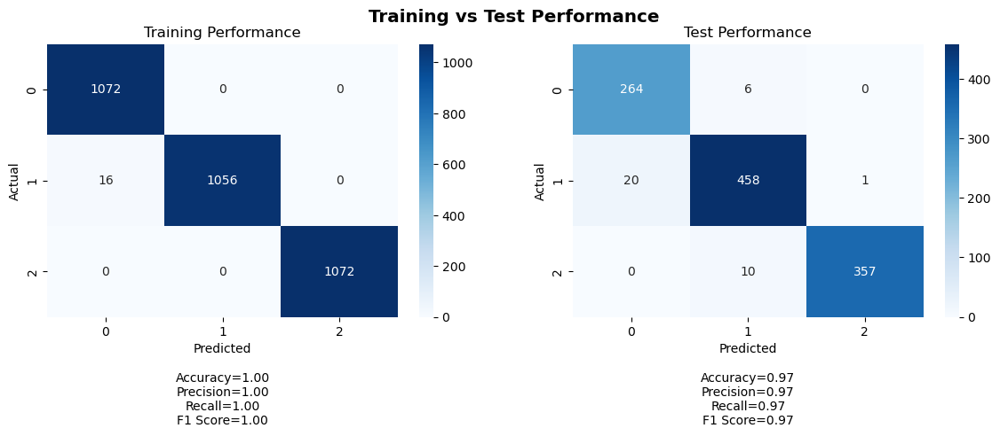

Training Metrics:
Accuracy: 0.9950248756218906
Precision: 0.9950980392156862
Recall: 0.9950248756218906
F1 Score: 0.9950245985333704

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9675555550688576
Recall: 0.9668458781362007
F1 Score: 0.9669920986413693

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 16, TN: 2128, FN: 0
Class 1 - TP: 1056, FP: 0, TN: 2144, FN: 16
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 20, TN: 826, FN: 6
Class 1 - TP: 458, FP: 16, TN: 621, FN: 21
Class 2 - TP: 357, FP: 1, TN: 748, FN: 10
35/35 [==============================] - 0s 3ms/step


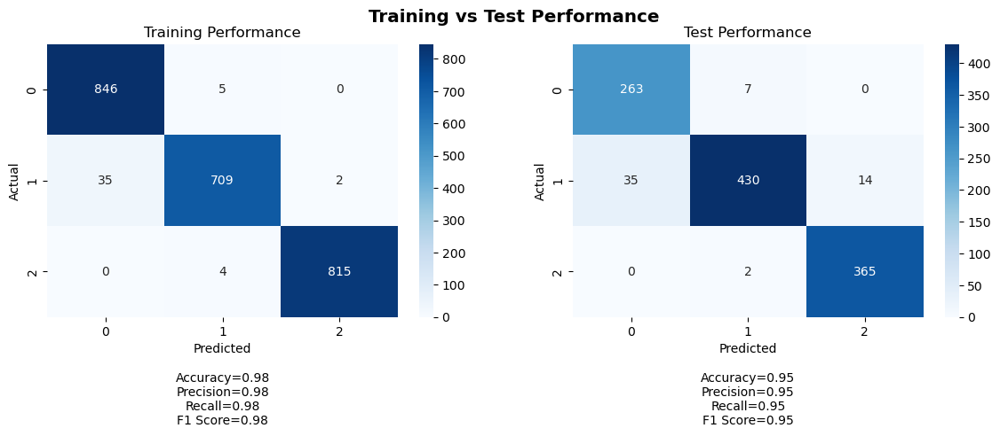

Training Metrics:
Accuracy: 0.9809602649006622
Precision: 0.981306273417877
Recall: 0.9809602649006622
F1 Score: 0.9809200588291723

Test Metrics:
Accuracy: 0.9480286738351255
Precision: 0.9506378286861561
Recall: 0.9480286738351255
F1 Score: 0.9479393199255818

Training Confusion Matrix:
Class 0 - TP: 846, FP: 35, TN: 1530, FN: 5
Class 1 - TP: 709, FP: 9, TN: 1661, FN: 37
Class 2 - TP: 815, FP: 2, TN: 1595, FN: 4

Test Confusion Matrix:
Class 0 - TP: 263, FP: 35, TN: 811, FN: 7
Class 1 - TP: 430, FP: 9, TN: 628, FN: 49
Class 2 - TP: 365, FP: 14, TN: 735, FN: 2
35/35 [==============================] - 0s 2ms/step


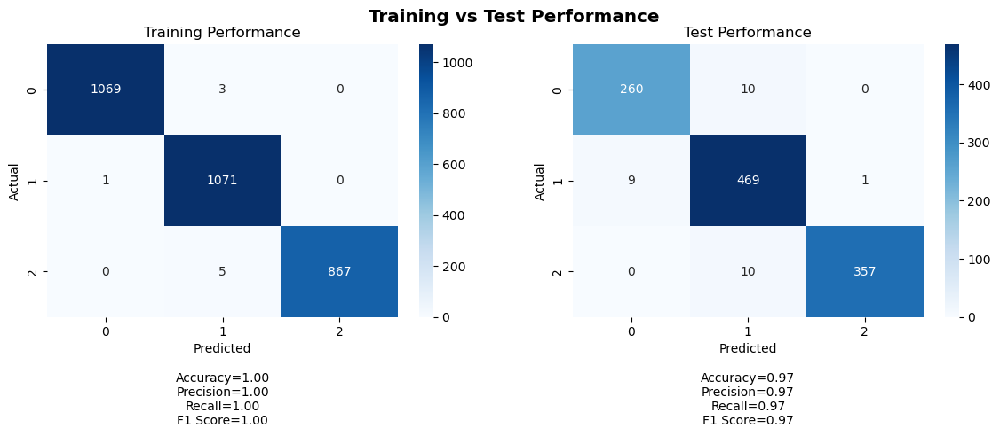

  1%|          | 1/100 [03:37<5:59:11, 217.69s/it]

Training Metrics:
Accuracy: 0.9970159151193634
Precision: 0.9970325035638073
Recall: 0.9970159151193634
F1 Score: 0.9970177682024965

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9734322589974328
Recall: 0.9731182795698925
F1 Score: 0.9731801591251847

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 1, TN: 1943, FN: 3
Class 1 - TP: 1071, FP: 8, TN: 1936, FN: 1
Class 2 - TP: 867, FP: 0, TN: 2144, FN: 5

Test Confusion Matrix:
Class 0 - TP: 260, FP: 9, TN: 837, FN: 10
Class 1 - TP: 469, FP: 20, TN: 617, FN: 10
Class 2 - TP: 357, FP: 1, TN: 748, FN: 10
35/35 [==============================] - 0s 3ms/step


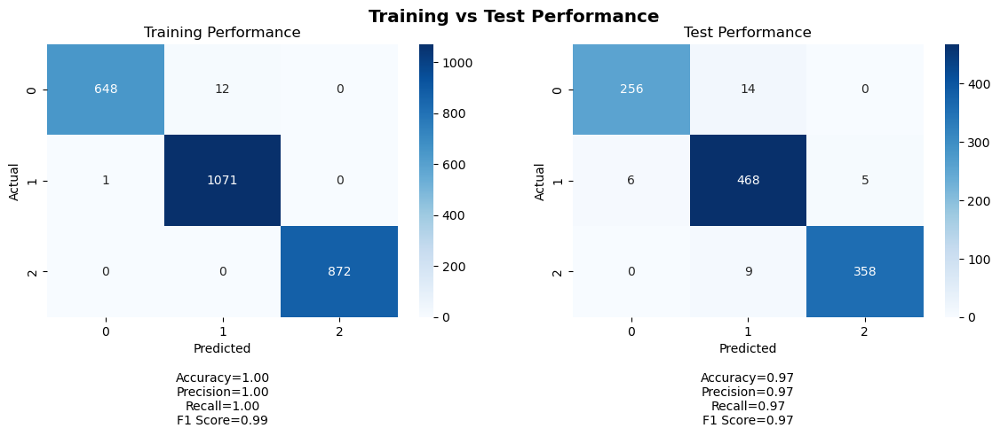

Training Metrics:
Accuracy: 0.9950076804915514
Precision: 0.9950479779201103
Recall: 0.9950076804915514
F1 Score: 0.9949994457778621

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9698242075274821
Recall: 0.9695340501792115
F1 Score: 0.9695533845646213

Training Confusion Matrix:
Class 0 - TP: 648, FP: 1, TN: 1943, FN: 12
Class 1 - TP: 1071, FP: 12, TN: 1520, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 6, TN: 840, FN: 14
Class 1 - TP: 468, FP: 23, TN: 614, FN: 11
Class 2 - TP: 358, FP: 5, TN: 744, FN: 9
35/35 [==============================] - 0s 3ms/step


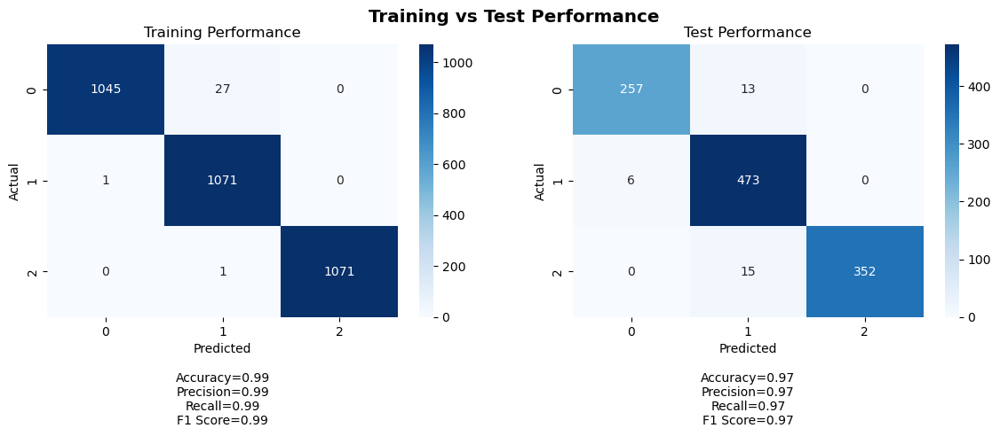

Training Metrics:
Accuracy: 0.9909825870646766
Precision: 0.9911887566830268
Recall: 0.9909825870646766
F1 Score: 0.9909851486570616

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9704926927425386
Recall: 0.9695340501792115
F1 Score: 0.9696240142105025

Training Confusion Matrix:
Class 0 - TP: 1045, FP: 1, TN: 2143, FN: 27
Class 1 - TP: 1071, FP: 28, TN: 2116, FN: 1
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 257, FP: 6, TN: 840, FN: 13
Class 1 - TP: 473, FP: 28, TN: 609, FN: 6
Class 2 - TP: 352, FP: 0, TN: 749, FN: 15
35/35 [==============================] - 0s 2ms/step


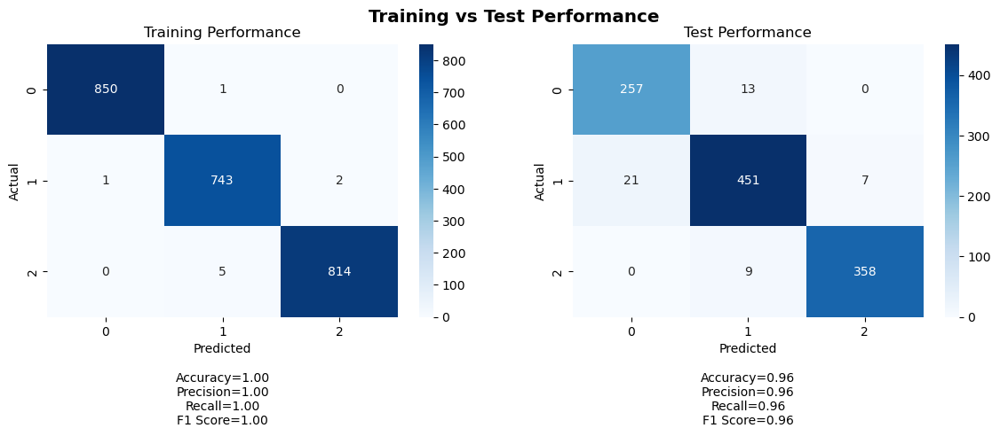

Training Metrics:
Accuracy: 0.9962748344370861
Precision: 0.9962817380387199
Recall: 0.9962748344370861
F1 Score: 0.9962759139412193

Test Metrics:
Accuracy: 0.9551971326164874
Precision: 0.9554542030599795
Recall: 0.9551971326164874
F1 Score: 0.9552587403528444

Training Confusion Matrix:
Class 0 - TP: 850, FP: 1, TN: 1564, FN: 1
Class 1 - TP: 743, FP: 6, TN: 1664, FN: 3
Class 2 - TP: 814, FP: 2, TN: 1595, FN: 5

Test Confusion Matrix:
Class 0 - TP: 257, FP: 21, TN: 825, FN: 13
Class 1 - TP: 451, FP: 22, TN: 615, FN: 28
Class 2 - TP: 358, FP: 7, TN: 742, FN: 9
35/35 [==============================] - 0s 2ms/step


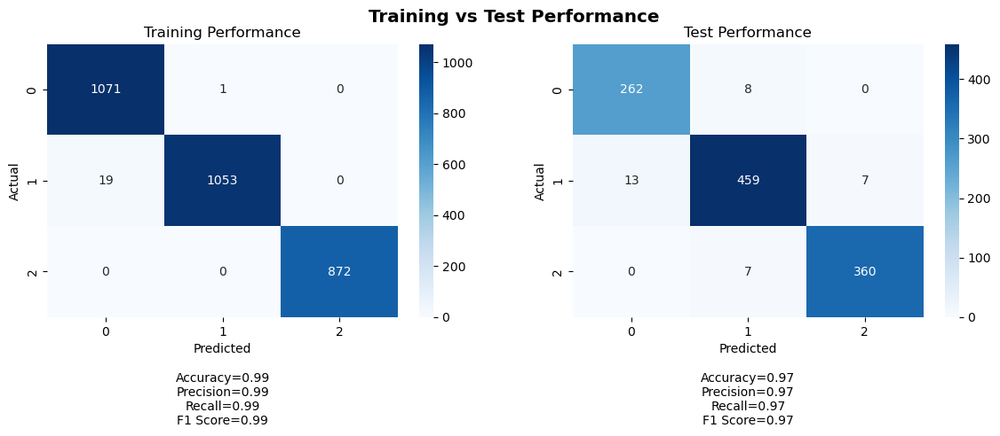

  2%|▏         | 2/100 [07:12<5:52:28, 215.80s/it]

Training Metrics:
Accuracy: 0.993368700265252
Precision: 0.9934670701820386
Recall: 0.993368700265252
F1 Score: 0.9933682328264944

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9687080069787298
Recall: 0.9686379928315412
F1 Score: 0.9686420384903114

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 19, TN: 1925, FN: 1
Class 1 - TP: 1053, FP: 1, TN: 1943, FN: 19
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 13, TN: 833, FN: 8
Class 1 - TP: 459, FP: 15, TN: 622, FN: 20
Class 2 - TP: 360, FP: 7, TN: 742, FN: 7
35/35 [==============================] - 0s 2ms/step


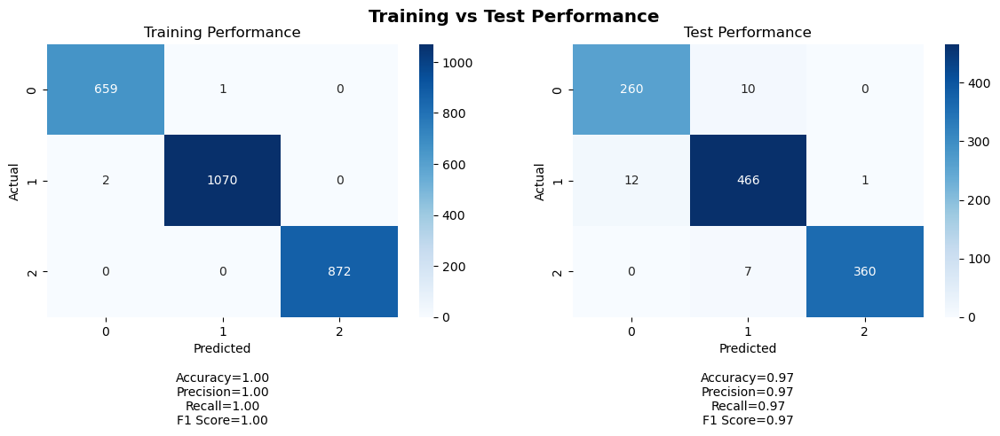

Training Metrics:
Accuracy: 0.9988479262672811
Precision: 0.9988487296512258
Recall: 0.9988479262672811
F1 Score: 0.9988480935292128

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9733086035349329
Recall: 0.9731182795698925
F1 Score: 0.9731809977018879

Training Confusion Matrix:
Class 0 - TP: 659, FP: 2, TN: 1942, FN: 1
Class 1 - TP: 1070, FP: 1, TN: 1531, FN: 2
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 12, TN: 834, FN: 10
Class 1 - TP: 466, FP: 17, TN: 620, FN: 13
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 1ms/step


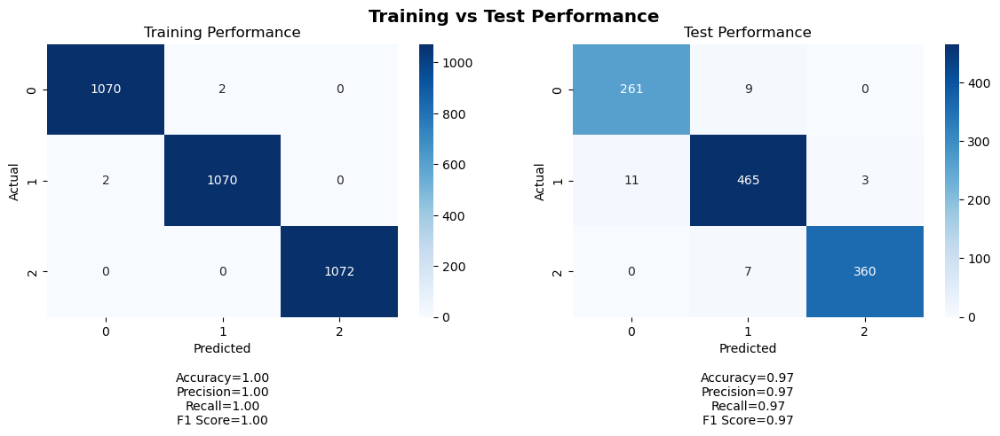

Training Metrics:
Accuracy: 0.9987562189054726
Precision: 0.9987562189054726
Recall: 0.9987562189054726
F1 Score: 0.9987562189054726

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9732207460288795
Recall: 0.9731182795698925
F1 Score: 0.9731547966924101

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 2, TN: 2142, FN: 2
Class 1 - TP: 1070, FP: 2, TN: 2142, FN: 2
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 11, TN: 835, FN: 9
Class 1 - TP: 465, FP: 16, TN: 621, FN: 14
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 3ms/step


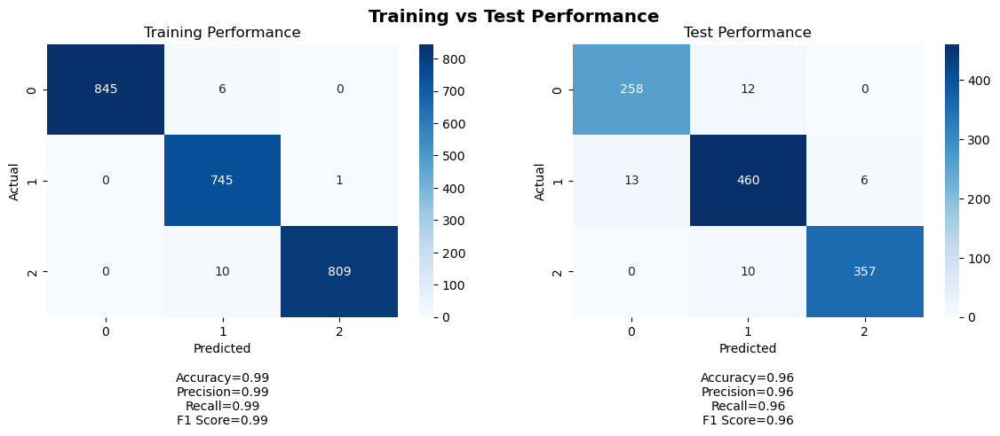

Training Metrics:
Accuracy: 0.9929635761589404
Precision: 0.9930895129950813
Recall: 0.9929635761589404
F1 Score: 0.99298162468045

Test Metrics:
Accuracy: 0.9632616487455197
Precision: 0.9633680862345936
Recall: 0.9632616487455197
F1 Score: 0.9633004171878803

Training Confusion Matrix:
Class 0 - TP: 845, FP: 0, TN: 1565, FN: 6
Class 1 - TP: 745, FP: 16, TN: 1654, FN: 1
Class 2 - TP: 809, FP: 1, TN: 1596, FN: 10

Test Confusion Matrix:
Class 0 - TP: 258, FP: 13, TN: 833, FN: 12
Class 1 - TP: 460, FP: 22, TN: 615, FN: 19
Class 2 - TP: 357, FP: 6, TN: 743, FN: 10
35/35 [==============================] - 0s 3ms/step


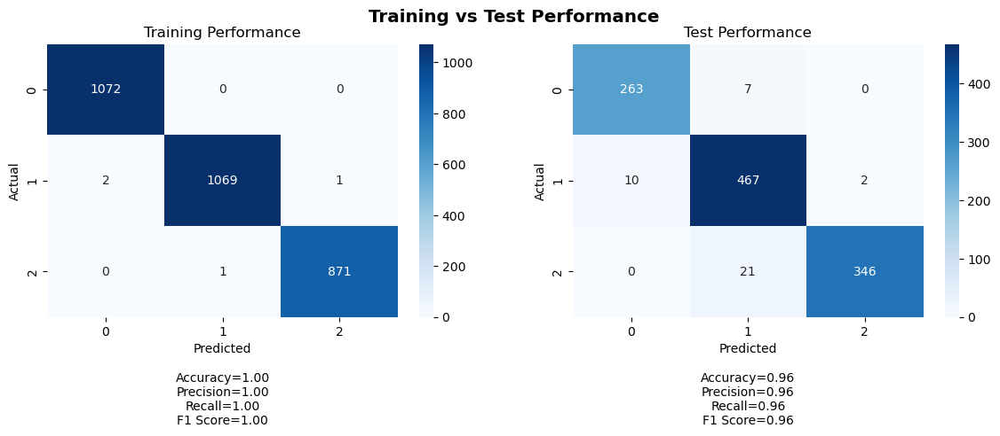

  3%|▎         | 3/100 [10:49<5:50:07, 216.57s/it]

Training Metrics:
Accuracy: 0.9986737400530504
Precision: 0.9986743551843195
Recall: 0.9986737400530504
F1 Score: 0.9986734298915175

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9649693057460947
Recall: 0.96415770609319
F1 Score: 0.9642203485795952

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1069, FP: 1, TN: 1943, FN: 3
Class 2 - TP: 871, FP: 1, TN: 2143, FN: 1

Test Confusion Matrix:
Class 0 - TP: 263, FP: 10, TN: 836, FN: 7
Class 1 - TP: 467, FP: 28, TN: 609, FN: 12
Class 2 - TP: 346, FP: 2, TN: 747, FN: 21
35/35 [==============================] - 0s 3ms/step


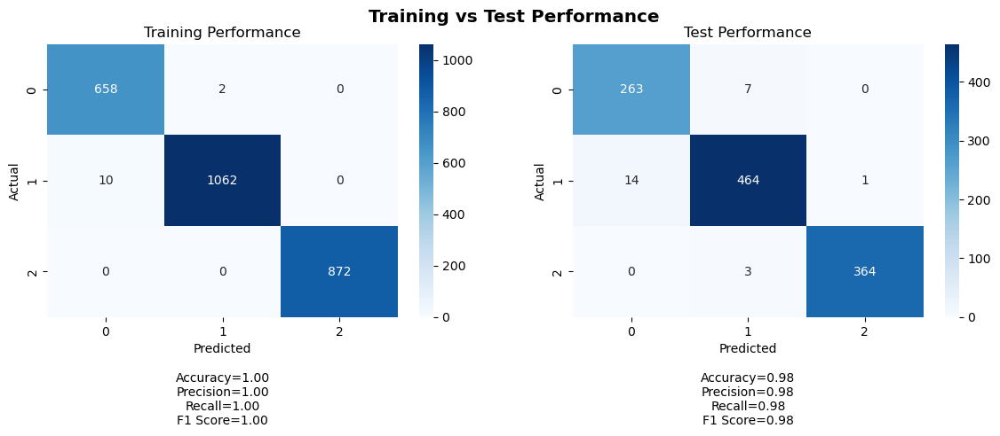

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.9954319212308207
Recall: 0.9953917050691244
F1 Score: 0.9953969557097545

Test Metrics:
Accuracy: 0.9775985663082437
Precision: 0.9778161522666632
Recall: 0.9775985663082437
F1 Score: 0.9776553068411177

Training Confusion Matrix:
Class 0 - TP: 658, FP: 10, TN: 1934, FN: 2
Class 1 - TP: 1062, FP: 2, TN: 1530, FN: 10
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 14, TN: 832, FN: 7
Class 1 - TP: 464, FP: 10, TN: 627, FN: 15
Class 2 - TP: 364, FP: 1, TN: 748, FN: 3
35/35 [==============================] - 0s 2ms/step


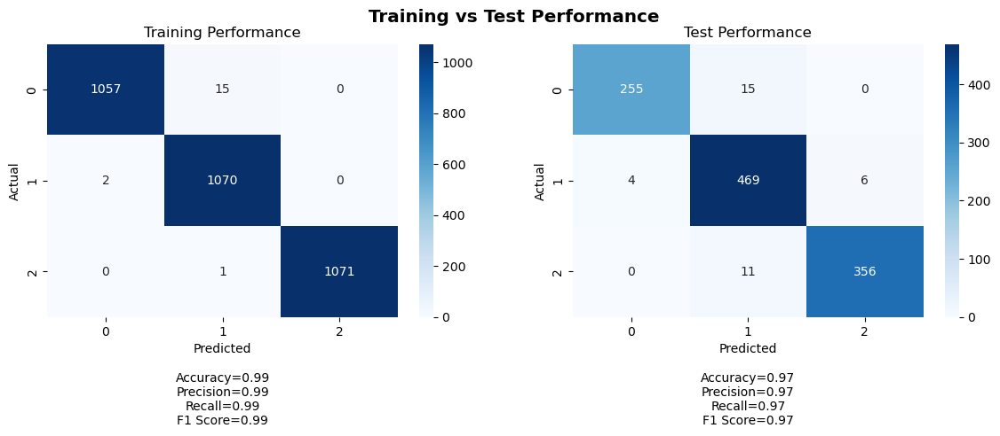

Training Metrics:
Accuracy: 0.9944029850746269
Precision: 0.9944594869547525
Recall: 0.9944029850746269
F1 Score: 0.9944049441816213

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9682685008443934
Recall: 0.967741935483871
F1 Score: 0.9677776400646492

Training Confusion Matrix:
Class 0 - TP: 1057, FP: 2, TN: 2142, FN: 15
Class 1 - TP: 1070, FP: 16, TN: 2128, FN: 2
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 255, FP: 4, TN: 842, FN: 15
Class 1 - TP: 469, FP: 26, TN: 611, FN: 10
Class 2 - TP: 356, FP: 6, TN: 743, FN: 11
35/35 [==============================] - 0s 2ms/step


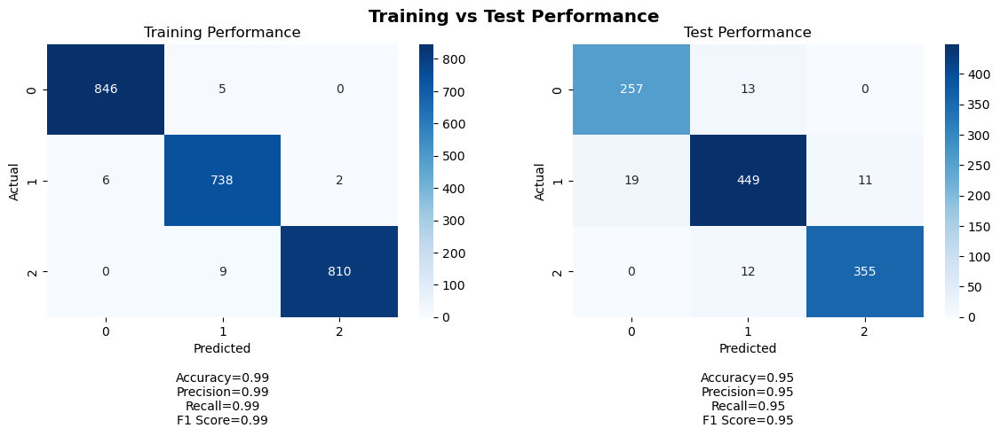

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9909360525669992
Recall: 0.9908940397350994
F1 Score: 0.990903842379806

Test Metrics:
Accuracy: 0.9507168458781362
Precision: 0.9508237237932649
Recall: 0.9507168458781362
F1 Score: 0.9507310519794739

Training Confusion Matrix:
Class 0 - TP: 846, FP: 6, TN: 1559, FN: 5
Class 1 - TP: 738, FP: 14, TN: 1656, FN: 8
Class 2 - TP: 810, FP: 2, TN: 1595, FN: 9

Test Confusion Matrix:
Class 0 - TP: 257, FP: 19, TN: 827, FN: 13
Class 1 - TP: 449, FP: 25, TN: 612, FN: 30
Class 2 - TP: 355, FP: 11, TN: 738, FN: 12
35/35 [==============================] - 0s 3ms/step


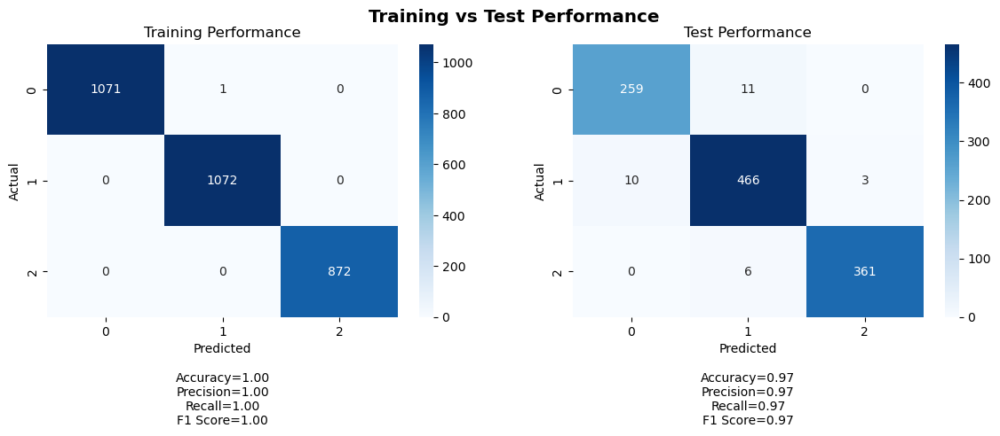

  4%|▍         | 4/100 [14:23<5:45:03, 215.66s/it]

Training Metrics:
Accuracy: 0.9996684350132626
Precision: 0.999668744020706
Recall: 0.9996684350132626
F1 Score: 0.9996684349411321

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9731889666250605
Recall: 0.9731182795698925
F1 Score: 0.9731401628052262

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 0, TN: 1944, FN: 1
Class 1 - TP: 1072, FP: 1, TN: 1943, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 10, TN: 836, FN: 11
Class 1 - TP: 466, FP: 17, TN: 620, FN: 13
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 3ms/step


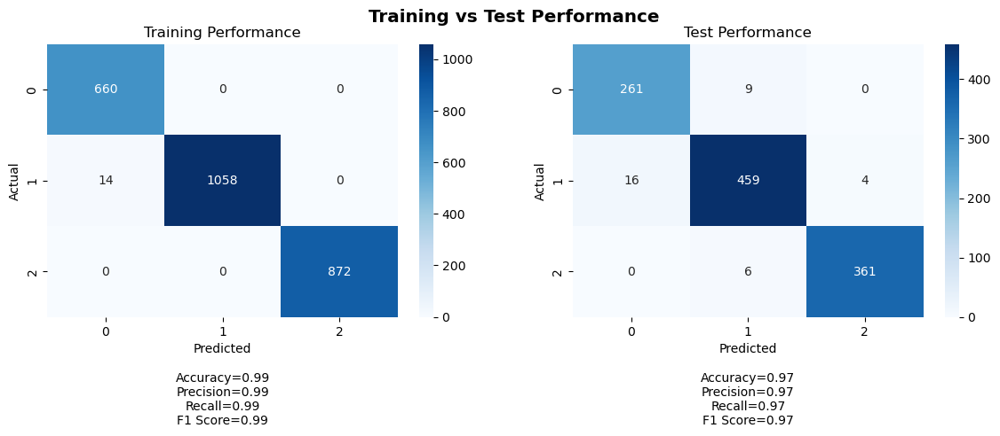

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.9947353307169522
Recall: 0.9946236559139785
F1 Score: 0.9946341988781469

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9688388767684977
Recall: 0.9686379928315412
F1 Score: 0.9686868162318111

Training Confusion Matrix:
Class 0 - TP: 660, FP: 14, TN: 1930, FN: 0
Class 1 - TP: 1058, FP: 0, TN: 1532, FN: 14
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 16, TN: 830, FN: 9
Class 1 - TP: 459, FP: 15, TN: 622, FN: 20
Class 2 - TP: 361, FP: 4, TN: 745, FN: 6
35/35 [==============================] - 0s 2ms/step


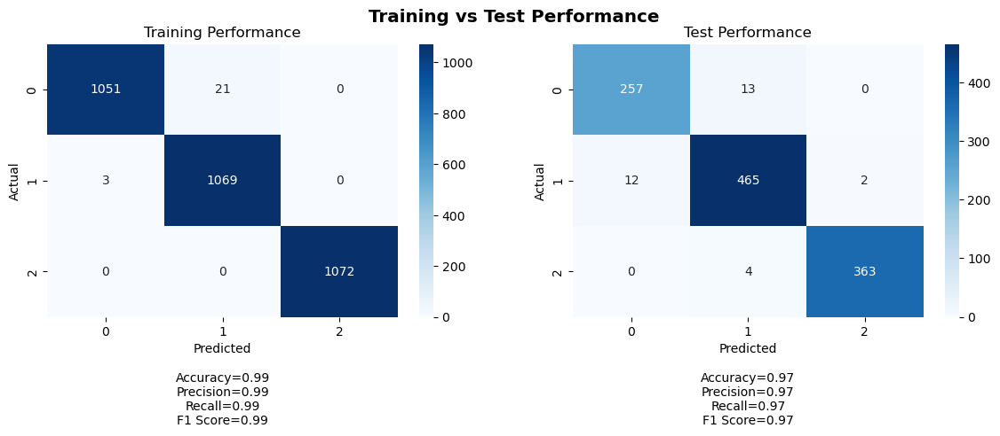

Training Metrics:
Accuracy: 0.9925373134328358
Precision: 0.9926292150479605
Recall: 0.9925373134328358
F1 Score: 0.9925367873898163

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.972267240644349
Recall: 0.9722222222222222
F1 Score: 0.9722374545527267

Training Confusion Matrix:
Class 0 - TP: 1051, FP: 3, TN: 2141, FN: 21
Class 1 - TP: 1069, FP: 21, TN: 2123, FN: 3
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 12, TN: 834, FN: 13
Class 1 - TP: 465, FP: 17, TN: 620, FN: 14
Class 2 - TP: 363, FP: 2, TN: 747, FN: 4
35/35 [==============================] - 0s 2ms/step


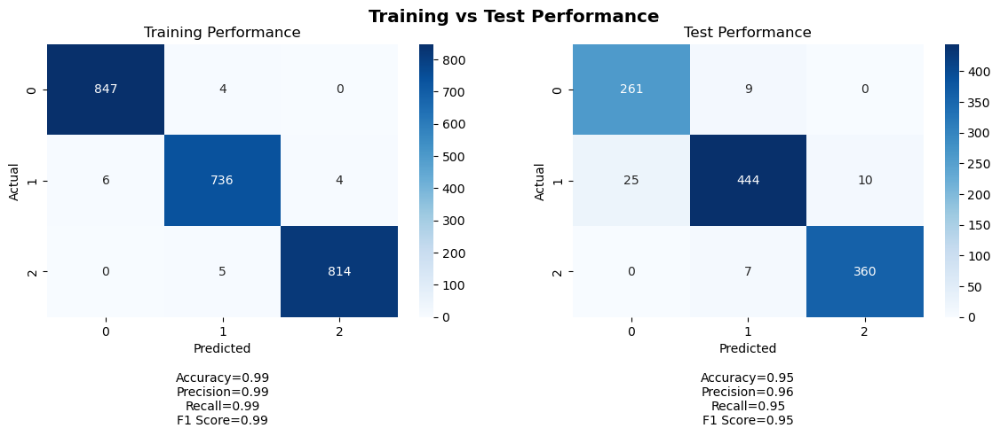

Training Metrics:
Accuracy: 0.992135761589404
Precision: 0.9921345602164106
Recall: 0.992135761589404
F1 Score: 0.9921344155839901

Test Metrics:
Accuracy: 0.9543010752688172
Precision: 0.9550347785971909
Recall: 0.9543010752688172
F1 Score: 0.9543080949111369

Training Confusion Matrix:
Class 0 - TP: 847, FP: 6, TN: 1559, FN: 4
Class 1 - TP: 736, FP: 9, TN: 1661, FN: 10
Class 2 - TP: 814, FP: 4, TN: 1593, FN: 5

Test Confusion Matrix:
Class 0 - TP: 261, FP: 25, TN: 821, FN: 9
Class 1 - TP: 444, FP: 16, TN: 621, FN: 35
Class 2 - TP: 360, FP: 10, TN: 739, FN: 7
35/35 [==============================] - 0s 2ms/step


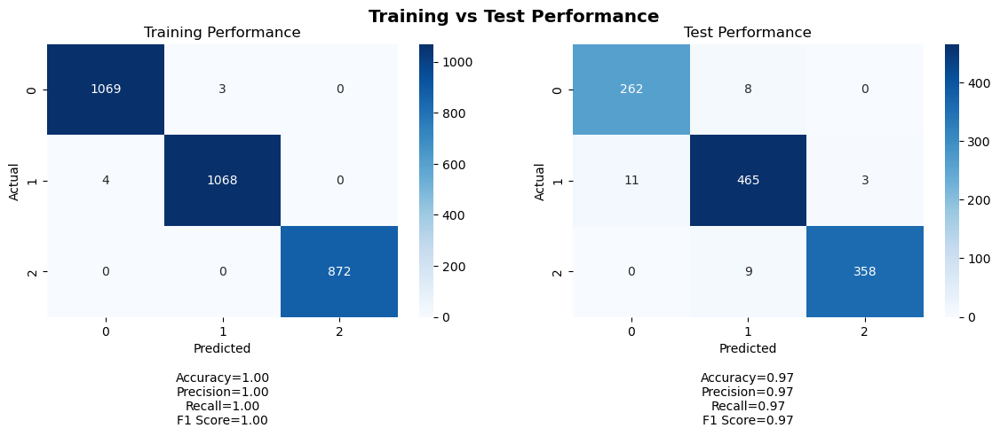

  5%|▌         | 5/100 [17:41<5:31:18, 209.25s/it]

Training Metrics:
Accuracy: 0.9976790450928382
Precision: 0.9976793523691475
Recall: 0.9976790450928382
F1 Score: 0.9976790445879244

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9723806691341084
Recall: 0.9722222222222222
F1 Score: 0.9722682999419077

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 4, TN: 1940, FN: 3
Class 1 - TP: 1068, FP: 3, TN: 1941, FN: 4
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 11, TN: 835, FN: 8
Class 1 - TP: 465, FP: 17, TN: 620, FN: 14
Class 2 - TP: 358, FP: 3, TN: 746, FN: 9
35/35 [==============================] - 0s 3ms/step


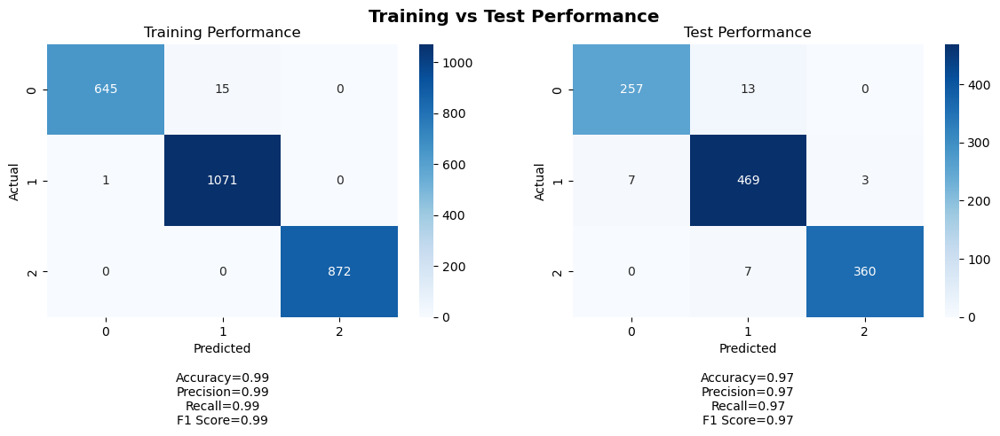

Training Metrics:
Accuracy: 0.9938556067588326
Precision: 0.9939215431409834
Recall: 0.9938556067588326
F1 Score: 0.9938426044038039

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9733125888841216
Recall: 0.9731182795698925
F1 Score: 0.9731319013143818

Training Confusion Matrix:
Class 0 - TP: 645, FP: 1, TN: 1943, FN: 15
Class 1 - TP: 1071, FP: 15, TN: 1517, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 7, TN: 839, FN: 13
Class 1 - TP: 469, FP: 20, TN: 617, FN: 10
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


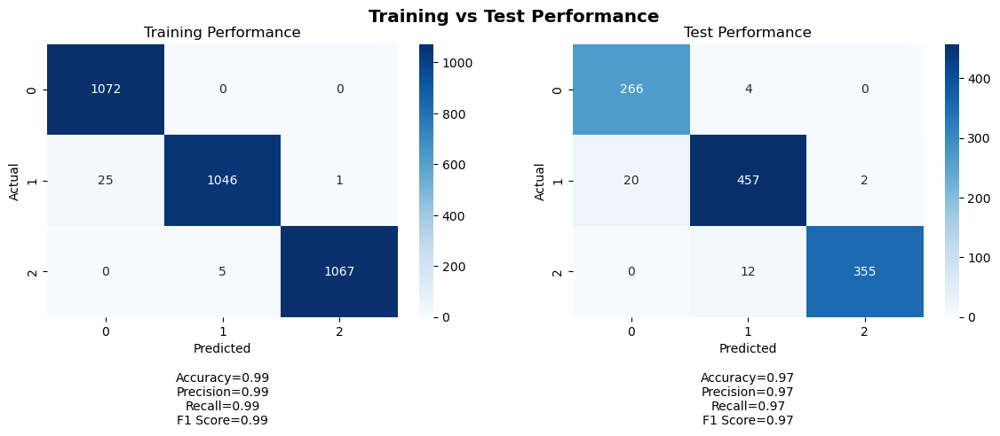

Training Metrics:
Accuracy: 0.990360696517413
Precision: 0.990505623591974
Recall: 0.990360696517413
F1 Score: 0.9903560781597492

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9667203394973573
Recall: 0.9659498207885304
F1 Score: 0.9660653143001565

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 25, TN: 2119, FN: 0
Class 1 - TP: 1046, FP: 5, TN: 2139, FN: 26
Class 2 - TP: 1067, FP: 1, TN: 2143, FN: 5

Test Confusion Matrix:
Class 0 - TP: 266, FP: 20, TN: 826, FN: 4
Class 1 - TP: 457, FP: 16, TN: 621, FN: 22
Class 2 - TP: 355, FP: 2, TN: 747, FN: 12
35/35 [==============================] - 0s 3ms/step


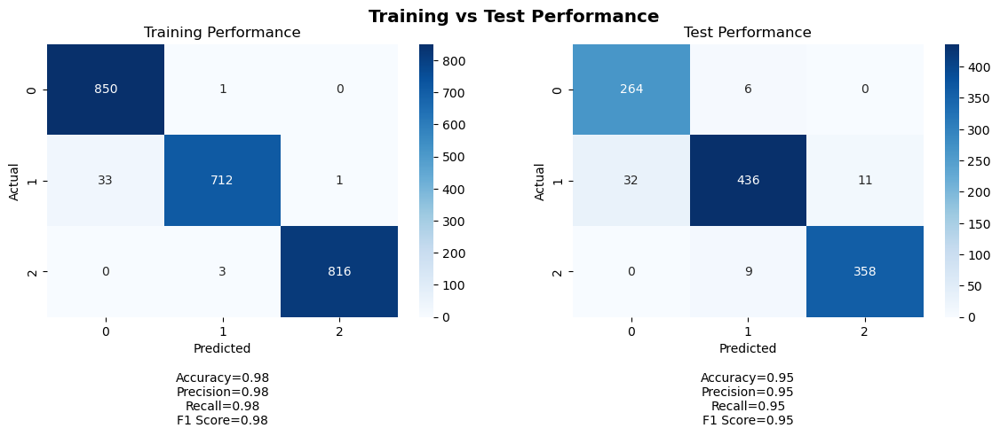

Training Metrics:
Accuracy: 0.984271523178808
Precision: 0.9846961412433892
Recall: 0.984271523178808
F1 Score: 0.984238991565164

Test Metrics:
Accuracy: 0.9480286738351255
Precision: 0.9497662791657022
Recall: 0.9480286738351255
F1 Score: 0.948052730423753

Training Confusion Matrix:
Class 0 - TP: 850, FP: 33, TN: 1532, FN: 1
Class 1 - TP: 712, FP: 4, TN: 1666, FN: 34
Class 2 - TP: 816, FP: 1, TN: 1596, FN: 3

Test Confusion Matrix:
Class 0 - TP: 264, FP: 32, TN: 814, FN: 6
Class 1 - TP: 436, FP: 15, TN: 622, FN: 43
Class 2 - TP: 358, FP: 11, TN: 738, FN: 9
35/35 [==============================] - 0s 2ms/step


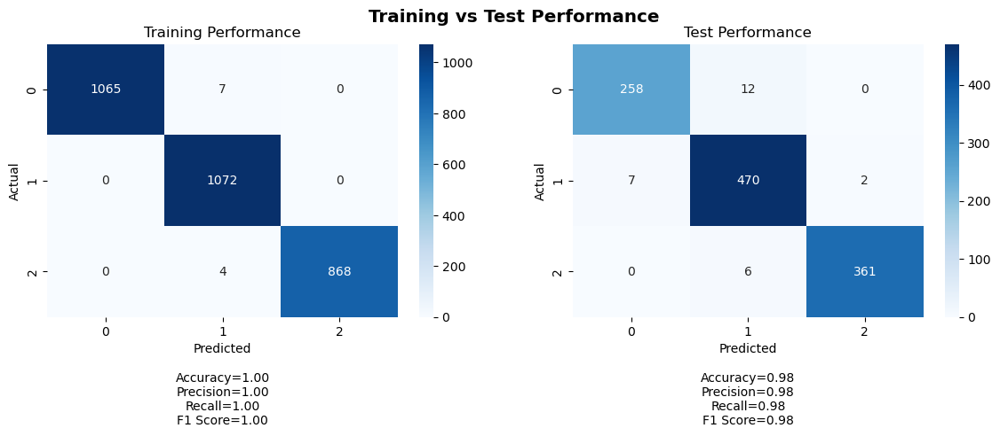

  6%|▌         | 6/100 [21:21<5:33:32, 212.90s/it]

Training Metrics:
Accuracy: 0.9963527851458885
Precision: 0.9963898298027632
Recall: 0.9963527851458885
F1 Score: 0.9963567678629615

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9759658182562039
Recall: 0.9758064516129032
F1 Score: 0.9758198418224948

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 0, TN: 1944, FN: 7
Class 1 - TP: 1072, FP: 11, TN: 1933, FN: 0
Class 2 - TP: 868, FP: 0, TN: 2144, FN: 4

Test Confusion Matrix:
Class 0 - TP: 258, FP: 7, TN: 839, FN: 12
Class 1 - TP: 470, FP: 18, TN: 619, FN: 9
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


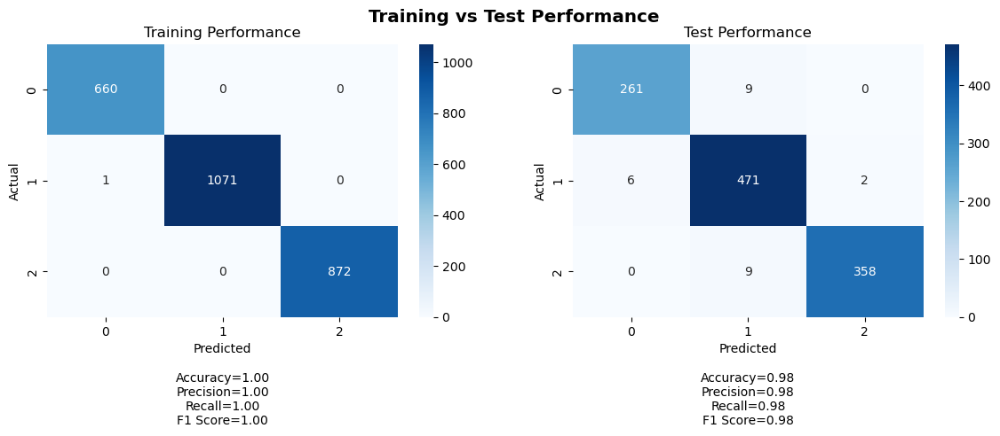

Training Metrics:
Accuracy: 0.9996159754224271
Precision: 0.9996165563975822
Recall: 0.9996159754224271
F1 Score: 0.9996160311764043

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9769370909859169
Recall: 0.9767025089605734
F1 Score: 0.9767378501078053

Training Confusion Matrix:
Class 0 - TP: 660, FP: 1, TN: 1943, FN: 0
Class 1 - TP: 1071, FP: 0, TN: 1532, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 6, TN: 840, FN: 9
Class 1 - TP: 471, FP: 18, TN: 619, FN: 8
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 3ms/step


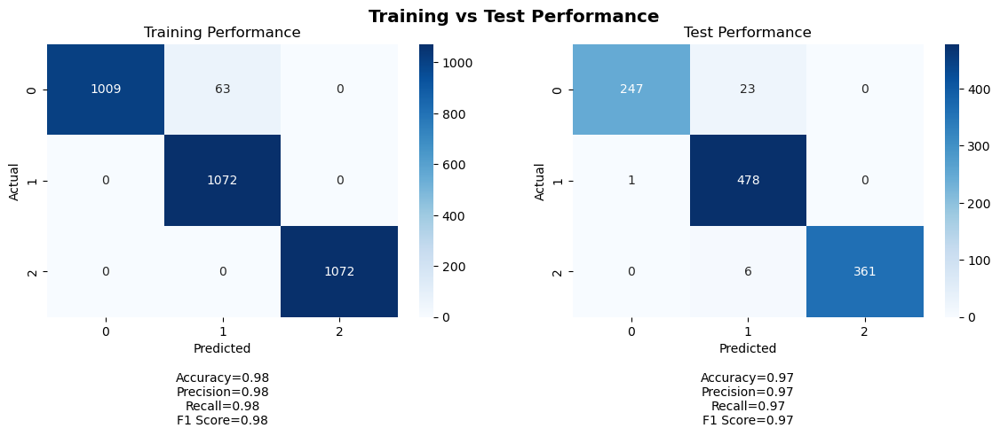

Training Metrics:
Accuracy: 0.980410447761194
Precision: 0.9814977973568282
Recall: 0.980410447761194
F1 Score: 0.980393518765485

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9744738962650994
Recall: 0.9731182795698925
F1 Score: 0.9730211341437868

Training Confusion Matrix:
Class 0 - TP: 1009, FP: 0, TN: 2144, FN: 63
Class 1 - TP: 1072, FP: 63, TN: 2081, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 247, FP: 1, TN: 845, FN: 23
Class 1 - TP: 478, FP: 29, TN: 608, FN: 1
Class 2 - TP: 361, FP: 0, TN: 749, FN: 6
35/35 [==============================] - 0s 3ms/step


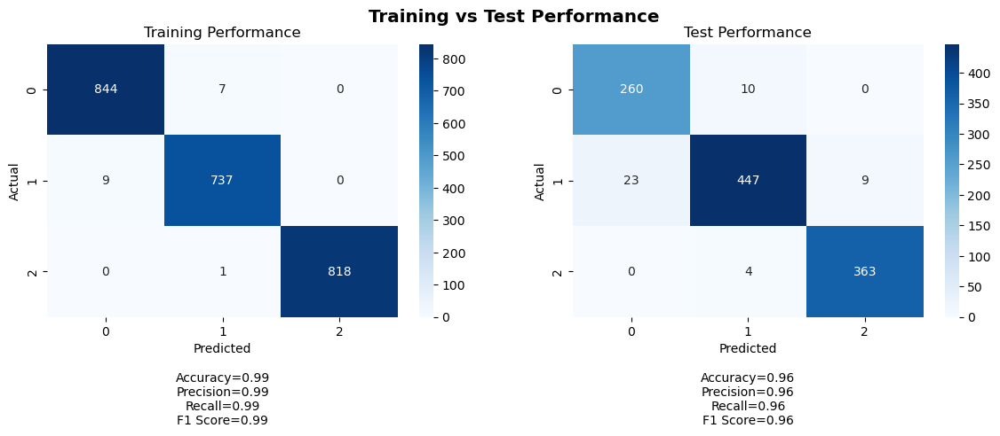

Training Metrics:
Accuracy: 0.9929635761589404
Precision: 0.9929678657855681
Recall: 0.9929635761589404
F1 Score: 0.9929649765574042

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9593466551078624
Recall: 0.9587813620071685
F1 Score: 0.9587736891441186

Training Confusion Matrix:
Class 0 - TP: 844, FP: 9, TN: 1556, FN: 7
Class 1 - TP: 737, FP: 8, TN: 1662, FN: 9
Class 2 - TP: 818, FP: 0, TN: 1597, FN: 1

Test Confusion Matrix:
Class 0 - TP: 260, FP: 23, TN: 823, FN: 10
Class 1 - TP: 447, FP: 14, TN: 623, FN: 32
Class 2 - TP: 363, FP: 9, TN: 740, FN: 4
35/35 [==============================] - 0s 3ms/step


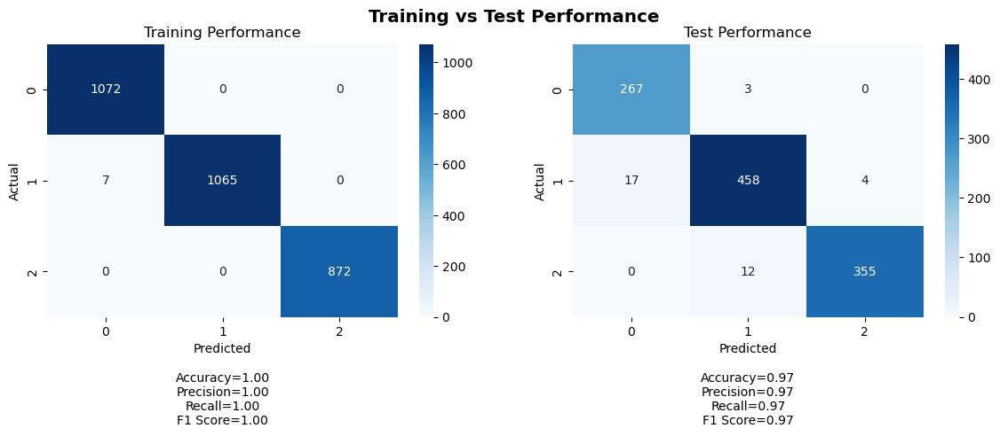

  7%|▋         | 7/100 [25:03<5:34:38, 215.89s/it]

Training Metrics:
Accuracy: 0.9976790450928382
Precision: 0.9976941022609106
Recall: 0.9976790450928382
F1 Score: 0.9976790203518039

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.968242488205489
Recall: 0.967741935483871
F1 Score: 0.9677877311228527

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 7, TN: 1937, FN: 0
Class 1 - TP: 1065, FP: 0, TN: 1944, FN: 7
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 267, FP: 17, TN: 829, FN: 3
Class 1 - TP: 458, FP: 15, TN: 622, FN: 21
Class 2 - TP: 355, FP: 4, TN: 745, FN: 12
35/35 [==============================] - 0s 2ms/step


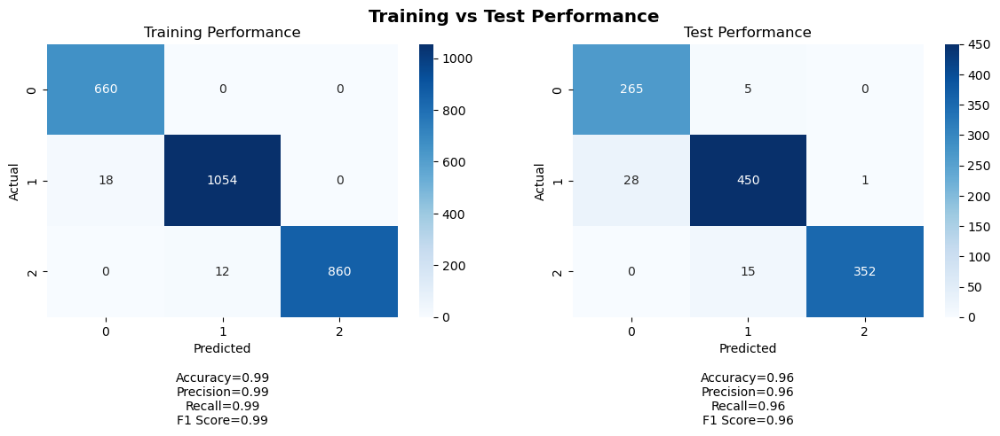

Training Metrics:
Accuracy: 0.988479262672811
Precision: 0.9886368409724696
Recall: 0.988479262672811
F1 Score: 0.9884936291774608

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.9576839726150256
Recall: 0.9560931899641577
F1 Score: 0.9563496076147536

Training Confusion Matrix:
Class 0 - TP: 660, FP: 18, TN: 1926, FN: 0
Class 1 - TP: 1054, FP: 12, TN: 1520, FN: 18
Class 2 - TP: 860, FP: 0, TN: 1732, FN: 12

Test Confusion Matrix:
Class 0 - TP: 265, FP: 28, TN: 818, FN: 5
Class 1 - TP: 450, FP: 20, TN: 617, FN: 29
Class 2 - TP: 352, FP: 1, TN: 748, FN: 15
35/35 [==============================] - 0s 3ms/step


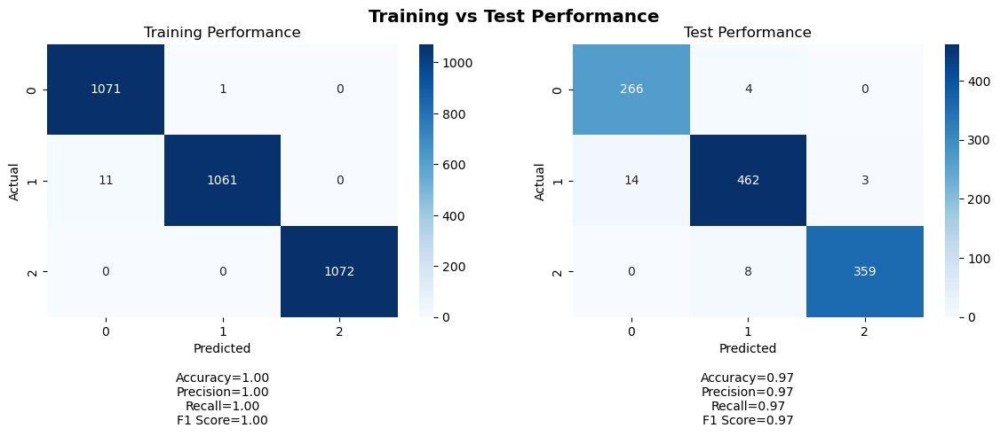

Training Metrics:
Accuracy: 0.996268656716418
Precision: 0.9962973406063729
Recall: 0.996268656716418
F1 Score: 0.9962685755408957

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9743118111625722
Recall: 0.9740143369175627
F1 Score: 0.974058994538218

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 11, TN: 2133, FN: 1
Class 1 - TP: 1061, FP: 1, TN: 2143, FN: 11
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 14, TN: 832, FN: 4
Class 1 - TP: 462, FP: 12, TN: 625, FN: 17
Class 2 - TP: 359, FP: 3, TN: 746, FN: 8
35/35 [==============================] - 0s 3ms/step


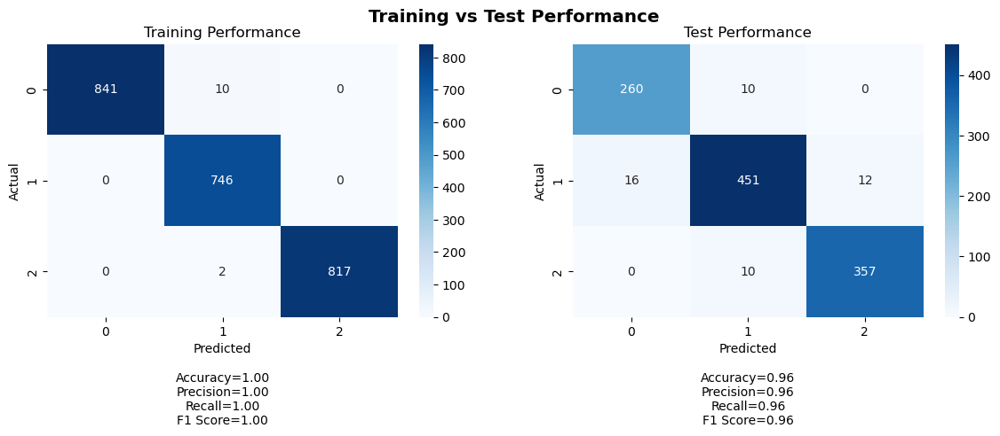

Training Metrics:
Accuracy: 0.9950331125827815
Precision: 0.9951117440458509
Recall: 0.9950331125827815
F1 Score: 0.9950401899913554

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9570548064312527
Recall: 0.956989247311828
F1 Score: 0.9569629419211891

Training Confusion Matrix:
Class 0 - TP: 841, FP: 0, TN: 1565, FN: 10
Class 1 - TP: 746, FP: 12, TN: 1658, FN: 0
Class 2 - TP: 817, FP: 0, TN: 1597, FN: 2

Test Confusion Matrix:
Class 0 - TP: 260, FP: 16, TN: 830, FN: 10
Class 1 - TP: 451, FP: 20, TN: 617, FN: 28
Class 2 - TP: 357, FP: 12, TN: 737, FN: 10
35/35 [==============================] - 0s 3ms/step


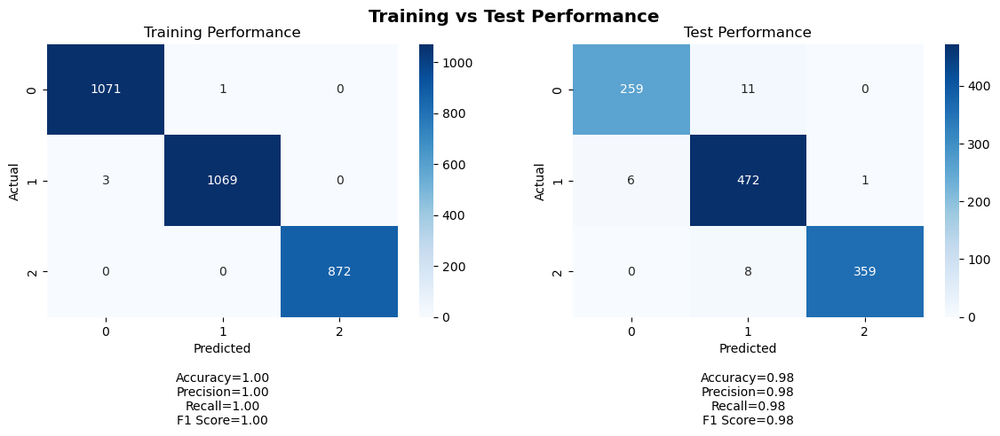

  8%|▊         | 8/100 [28:47<5:34:46, 218.33s/it]

Training Metrics:
Accuracy: 0.9986737400530504
Precision: 0.9986749726237732
Recall: 0.9986737400530504
F1 Score: 0.998673738898961

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9769997369717961
Recall: 0.9767025089605734
F1 Score: 0.9767366099835582

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 3, TN: 1941, FN: 1
Class 1 - TP: 1069, FP: 1, TN: 1943, FN: 3
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 6, TN: 840, FN: 11
Class 1 - TP: 472, FP: 19, TN: 618, FN: 7
Class 2 - TP: 359, FP: 1, TN: 748, FN: 8
35/35 [==============================] - 0s 3ms/step


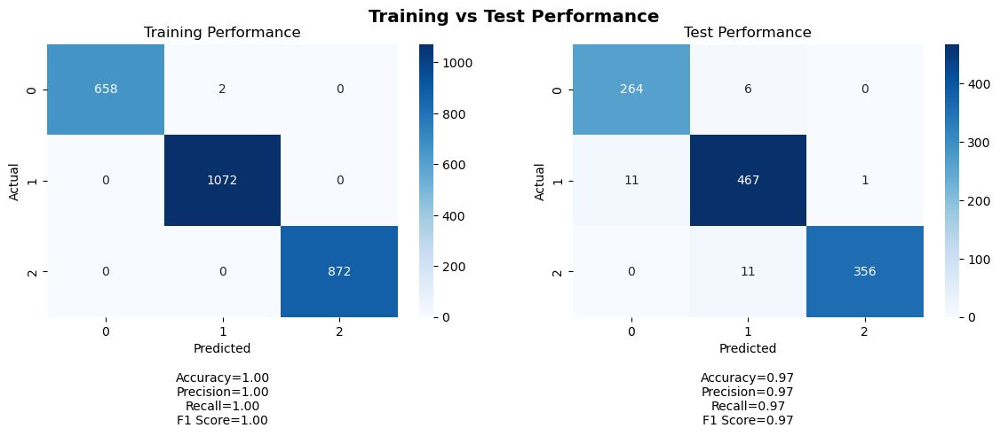

Training Metrics:
Accuracy: 0.999231950844854
Precision: 0.9992333811039884
Recall: 0.999231950844854
F1 Score: 0.9992317260045185

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9743258141847929
Recall: 0.9740143369175627
F1 Score: 0.9740774142375799

Training Confusion Matrix:
Class 0 - TP: 658, FP: 0, TN: 1944, FN: 2
Class 1 - TP: 1072, FP: 2, TN: 1530, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 11, TN: 835, FN: 6
Class 1 - TP: 467, FP: 17, TN: 620, FN: 12
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 3ms/step


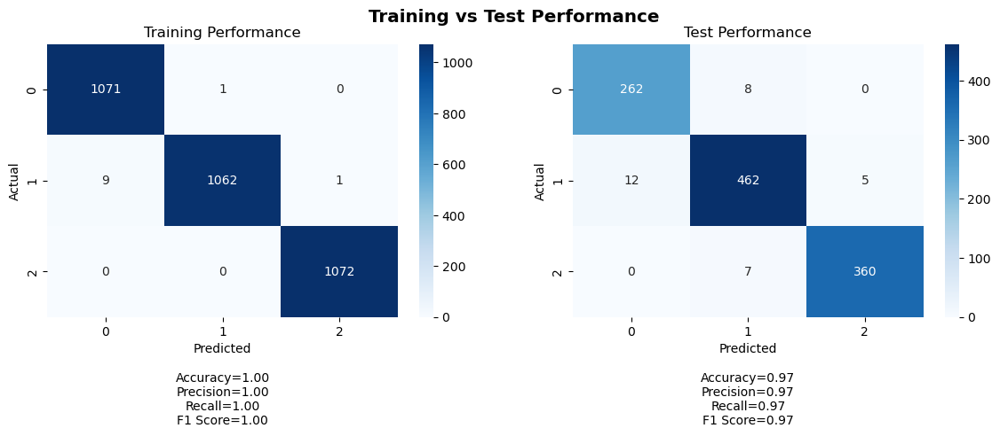

Training Metrics:
Accuracy: 0.9965796019900498
Precision: 0.9965979888150389
Recall: 0.9965796019900498
F1 Score: 0.9965782448535817

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9714022331001048
Recall: 0.9713261648745519
F1 Score: 0.9713473684281312

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 9, TN: 2135, FN: 1
Class 1 - TP: 1062, FP: 1, TN: 2143, FN: 10
Class 2 - TP: 1072, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 12, TN: 834, FN: 8
Class 1 - TP: 462, FP: 15, TN: 622, FN: 17
Class 2 - TP: 360, FP: 5, TN: 744, FN: 7
35/35 [==============================] - 0s 3ms/step


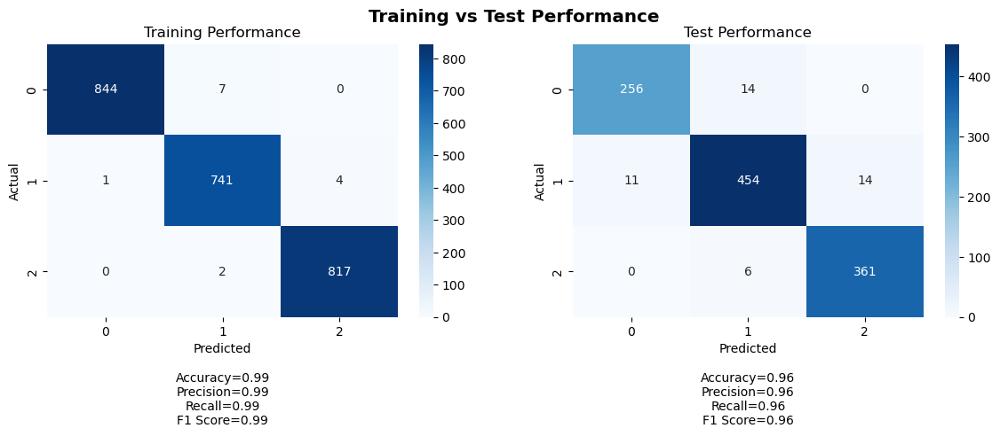

Training Metrics:
Accuracy: 0.9942052980132451
Precision: 0.9942262597775898
Recall: 0.9942052980132451
F1 Score: 0.9942087020574212

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9596452515205319
Recall: 0.9596774193548387
F1 Score: 0.9596056774558513

Training Confusion Matrix:
Class 0 - TP: 844, FP: 1, TN: 1564, FN: 7
Class 1 - TP: 741, FP: 9, TN: 1661, FN: 5
Class 2 - TP: 817, FP: 4, TN: 1593, FN: 2

Test Confusion Matrix:
Class 0 - TP: 256, FP: 11, TN: 835, FN: 14
Class 1 - TP: 454, FP: 20, TN: 617, FN: 25
Class 2 - TP: 361, FP: 14, TN: 735, FN: 6
35/35 [==============================] - 0s 3ms/step


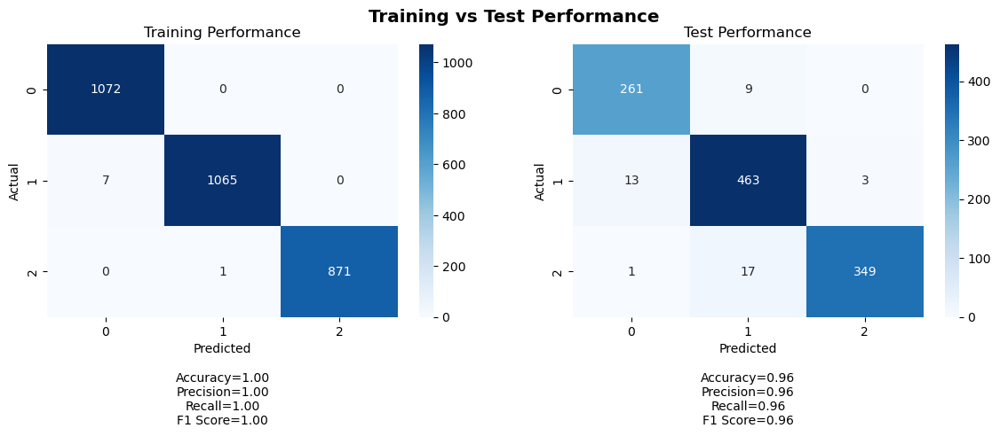

  9%|▉         | 9/100 [32:37<5:36:41, 221.99s/it]

Training Metrics:
Accuracy: 0.9973474801061007
Precision: 0.9973606710547357
Recall: 0.9973474801061007
F1 Score: 0.9973474395706452

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9620594998987166
Recall: 0.9614695340501792
F1 Score: 0.9615621796540444

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 7, TN: 1937, FN: 0
Class 1 - TP: 1065, FP: 1, TN: 1943, FN: 7
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 261, FP: 14, TN: 832, FN: 9
Class 1 - TP: 463, FP: 26, TN: 611, FN: 16
Class 2 - TP: 349, FP: 3, TN: 746, FN: 18
35/35 [==============================] - 0s 3ms/step


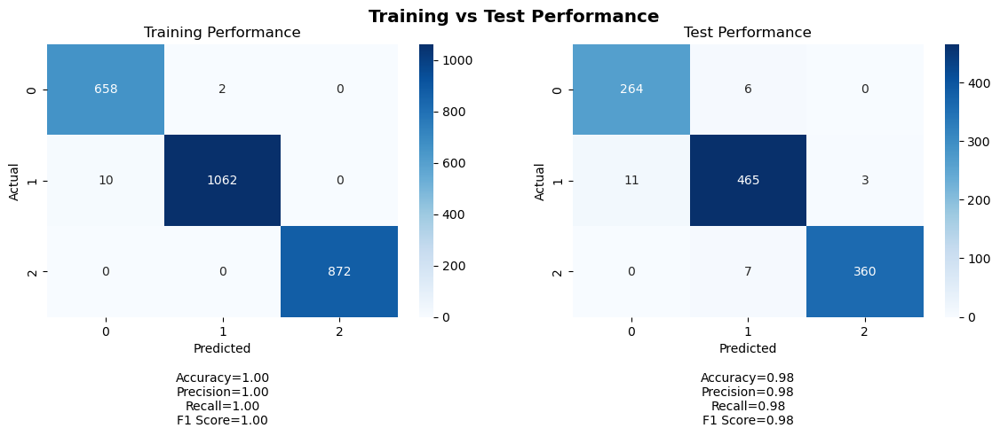

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.9954319212308207
Recall: 0.9953917050691244
F1 Score: 0.9953969557097545

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9759316715914342
Recall: 0.9758064516129032
F1 Score: 0.9758391378208154

Training Confusion Matrix:
Class 0 - TP: 658, FP: 10, TN: 1934, FN: 2
Class 1 - TP: 1062, FP: 2, TN: 1530, FN: 10
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 11, TN: 835, FN: 6
Class 1 - TP: 465, FP: 13, TN: 624, FN: 14
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 3ms/step


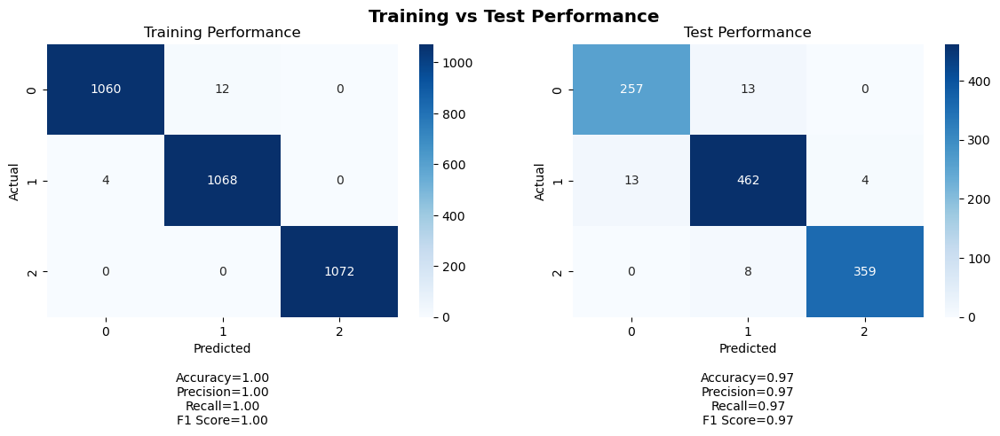

Training Metrics:
Accuracy: 0.9950248756218906
Precision: 0.9950431634642161
Recall: 0.9950248756218906
F1 Score: 0.995024806352654

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9660661612083261
Recall: 0.9659498207885304
F1 Score: 0.965991151762252

Training Confusion Matrix:
Class 0 - TP: 1060, FP: 4, TN: 2140, FN: 12
Class 1 - TP: 1068, FP: 12, TN: 2132, FN: 4
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 13, TN: 833, FN: 13
Class 1 - TP: 462, FP: 21, TN: 616, FN: 17
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 3ms/step


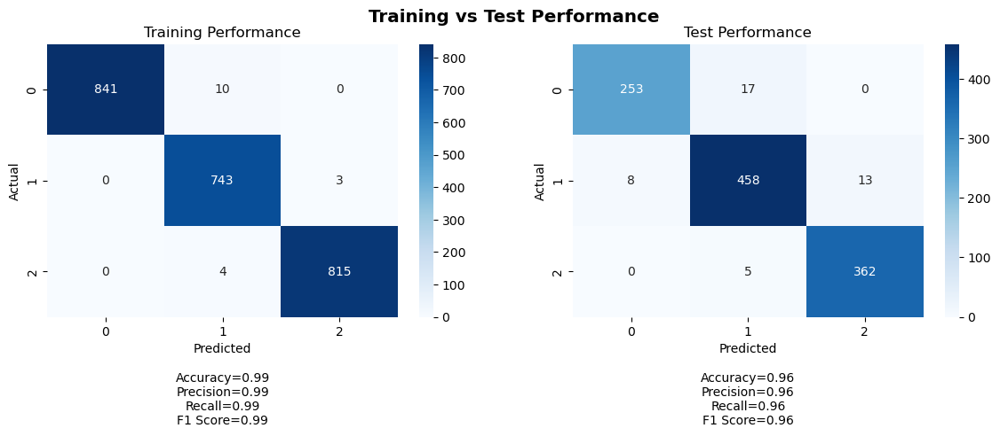

Training Metrics:
Accuracy: 0.9929635761589404
Precision: 0.9930462612287423
Recall: 0.9929635761589404
F1 Score: 0.9929762086219607

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9615119216825277
Recall: 0.9614695340501792
F1 Score: 0.9613867292296634

Training Confusion Matrix:
Class 0 - TP: 841, FP: 0, TN: 1565, FN: 10
Class 1 - TP: 743, FP: 14, TN: 1656, FN: 3
Class 2 - TP: 815, FP: 3, TN: 1594, FN: 4

Test Confusion Matrix:
Class 0 - TP: 253, FP: 8, TN: 838, FN: 17
Class 1 - TP: 458, FP: 22, TN: 615, FN: 21
Class 2 - TP: 362, FP: 13, TN: 736, FN: 5
35/35 [==============================] - 0s 3ms/step


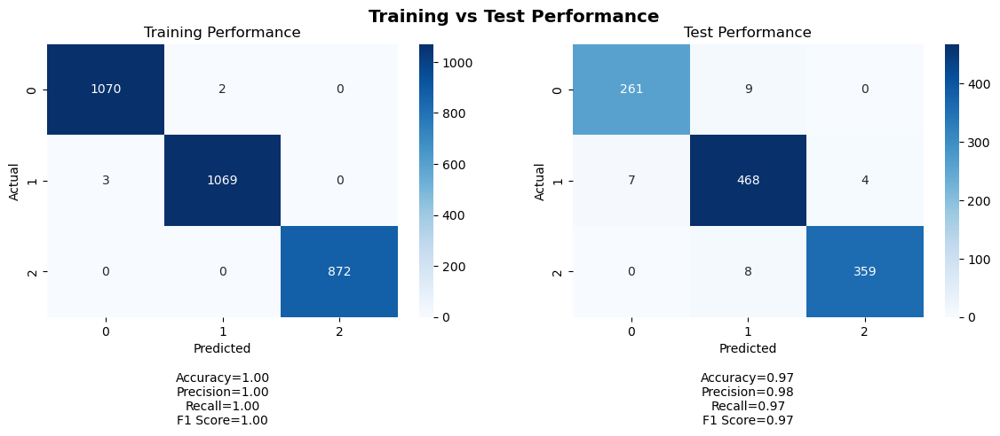

 10%|█         | 10/100 [36:29<5:37:46, 225.19s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983424829196668
Recall: 0.998342175066313
F1 Score: 0.9983421747056603

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9750125388327904
Recall: 0.974910394265233
F1 Score: 0.9749323659858244

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 3, TN: 1941, FN: 2
Class 1 - TP: 1069, FP: 2, TN: 1942, FN: 3
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 7, TN: 839, FN: 9
Class 1 - TP: 468, FP: 17, TN: 620, FN: 11
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 3ms/step


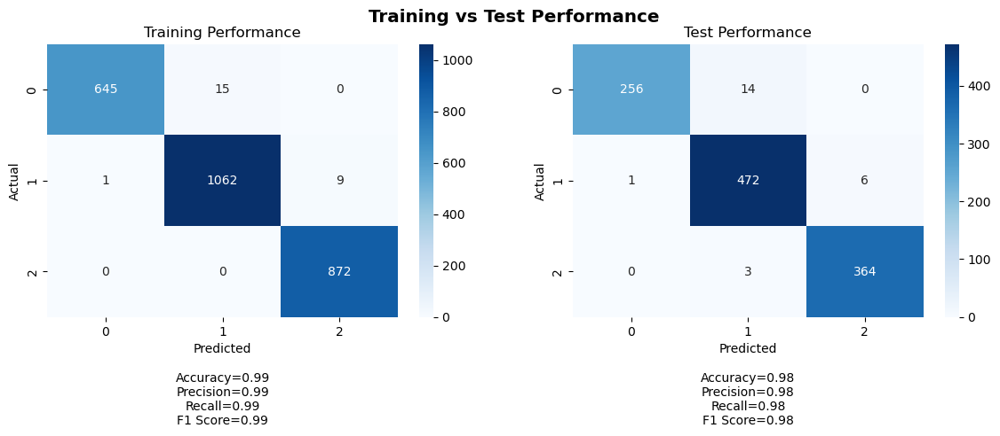

Training Metrics:
Accuracy: 0.9903993855606759
Precision: 0.990453113299749
Recall: 0.9903993855606759
F1 Score: 0.9903864932819924

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9788044025562902
Recall: 0.978494623655914
F1 Score: 0.9784563395679883

Training Confusion Matrix:
Class 0 - TP: 645, FP: 1, TN: 1943, FN: 15
Class 1 - TP: 1062, FP: 15, TN: 1517, FN: 10
Class 2 - TP: 872, FP: 9, TN: 1723, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 1, TN: 845, FN: 14
Class 1 - TP: 472, FP: 17, TN: 620, FN: 7
Class 2 - TP: 364, FP: 6, TN: 743, FN: 3
35/35 [==============================] - 0s 2ms/step


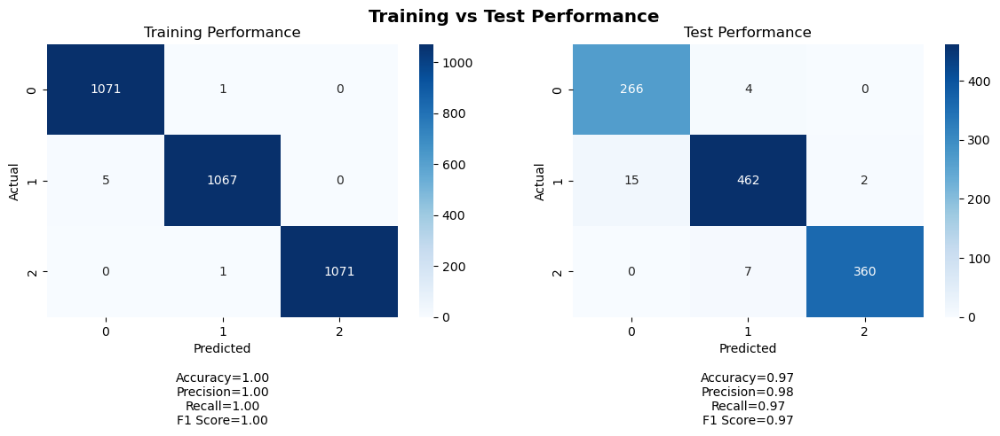

Training Metrics:
Accuracy: 0.9978233830845771
Precision: 0.9978274174870723
Recall: 0.9978233830845771
F1 Score: 0.9978235227064832

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9752867647123533
Recall: 0.974910394265233
F1 Score: 0.9749736162014028

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 5, TN: 2139, FN: 1
Class 1 - TP: 1067, FP: 2, TN: 2142, FN: 5
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 266, FP: 15, TN: 831, FN: 4
Class 1 - TP: 462, FP: 11, TN: 626, FN: 17
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


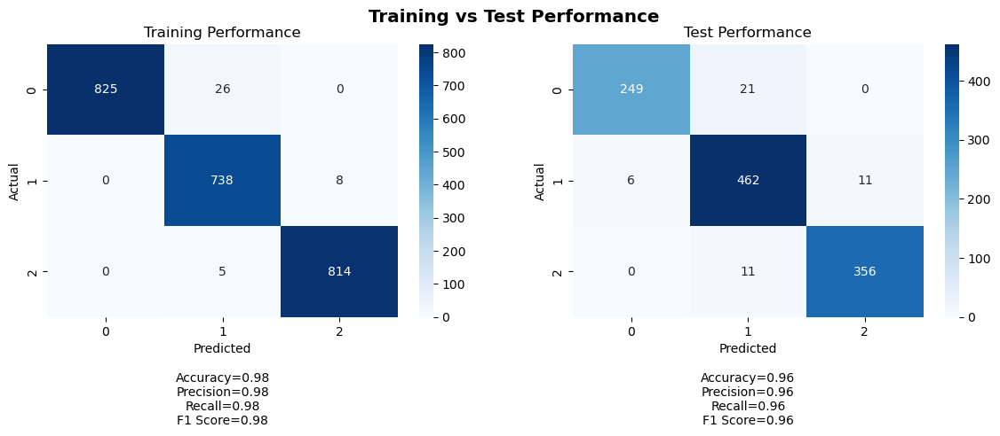

Training Metrics:
Accuracy: 0.9838576158940397
Precision: 0.9842534665702558
Recall: 0.9838576158940397
F1 Score: 0.9839015943533695

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.956647597439568
Recall: 0.9560931899641577
F1 Score: 0.9560860067706205

Training Confusion Matrix:
Class 0 - TP: 825, FP: 0, TN: 1565, FN: 26
Class 1 - TP: 738, FP: 31, TN: 1639, FN: 8
Class 2 - TP: 814, FP: 8, TN: 1589, FN: 5

Test Confusion Matrix:
Class 0 - TP: 249, FP: 6, TN: 840, FN: 21
Class 1 - TP: 462, FP: 32, TN: 605, FN: 17
Class 2 - TP: 356, FP: 11, TN: 738, FN: 11
35/35 [==============================] - 0s 3ms/step


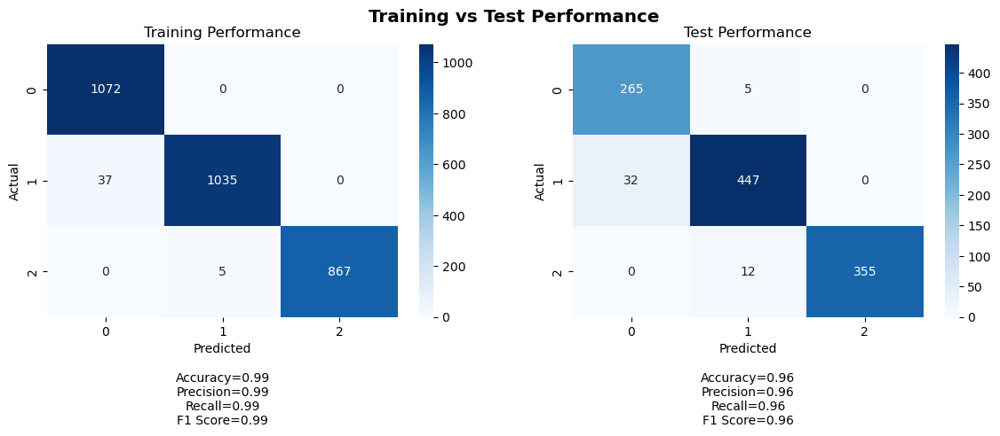

 11%|█         | 11/100 [40:16<5:34:52, 225.76s/it]

Training Metrics:
Accuracy: 0.9860742705570292
Precision: 0.986432559447116
Recall: 0.9860742705570292
F1 Score: 0.986070449934335

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.9582074569386861
Recall: 0.9560931899641577
F1 Score: 0.9564440104923988

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 37, TN: 1907, FN: 0
Class 1 - TP: 1035, FP: 5, TN: 1939, FN: 37
Class 2 - TP: 867, FP: 0, TN: 2144, FN: 5

Test Confusion Matrix:
Class 0 - TP: 265, FP: 32, TN: 814, FN: 5
Class 1 - TP: 447, FP: 17, TN: 620, FN: 32
Class 2 - TP: 355, FP: 0, TN: 749, FN: 12
35/35 [==============================] - 0s 2ms/step


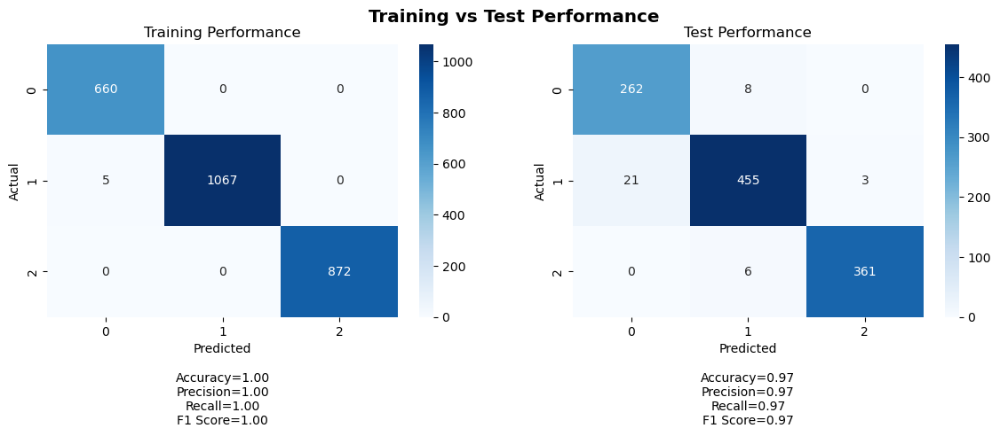

Training Metrics:
Accuracy: 0.9980798771121352
Precision: 0.9980943141263297
Recall: 0.9980798771121352
F1 Score: 0.9980812558026102

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9665245802630308
Recall: 0.9659498207885304
F1 Score: 0.9660591202505209

Training Confusion Matrix:
Class 0 - TP: 660, FP: 5, TN: 1939, FN: 0
Class 1 - TP: 1067, FP: 0, TN: 1532, FN: 5
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 21, TN: 825, FN: 8
Class 1 - TP: 455, FP: 14, TN: 623, FN: 24
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 2ms/step


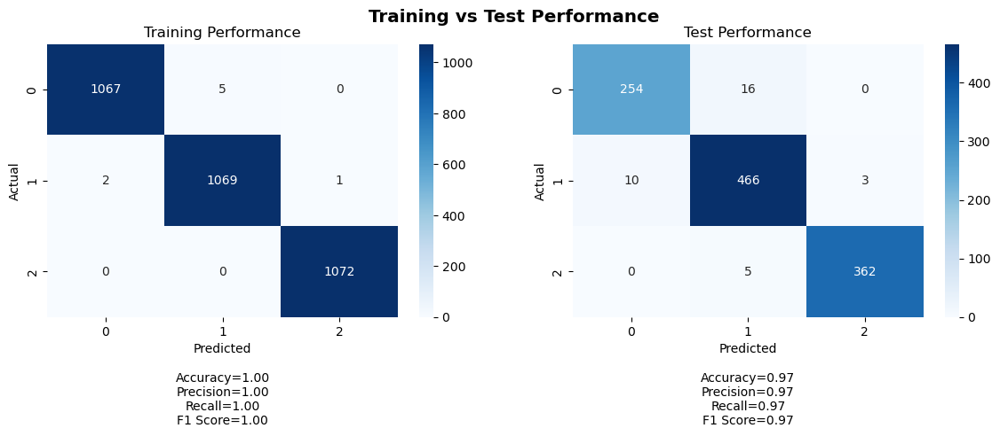

Training Metrics:
Accuracy: 0.9975124378109452
Precision: 0.9975138775594664
Recall: 0.9975124378109452
F1 Score: 0.997512144501144

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.969624783257833
Recall: 0.9695340501792115
F1 Score: 0.9695195254229423

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 2, TN: 2142, FN: 5
Class 1 - TP: 1069, FP: 5, TN: 2139, FN: 3
Class 2 - TP: 1072, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 254, FP: 10, TN: 836, FN: 16
Class 1 - TP: 466, FP: 21, TN: 616, FN: 13
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 3ms/step


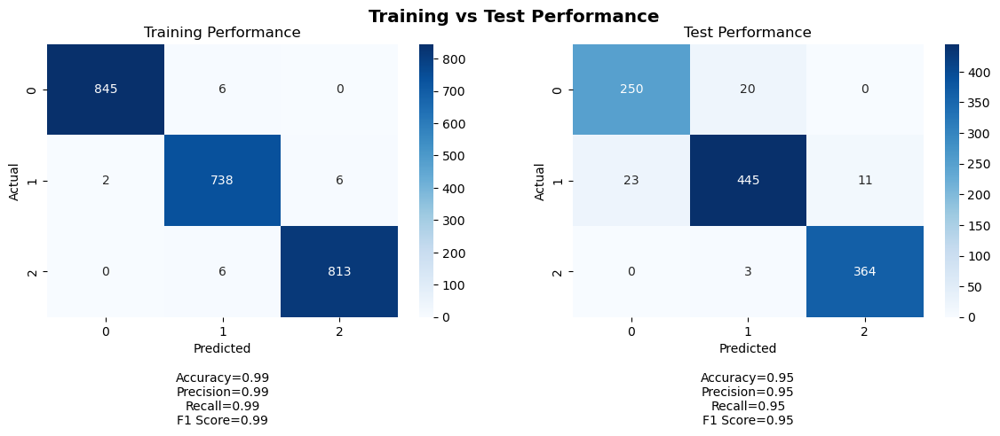

Training Metrics:
Accuracy: 0.9917218543046358
Precision: 0.9917444349750191
Recall: 0.9917218543046358
F1 Score: 0.9917290211579065

Test Metrics:
Accuracy: 0.9489247311827957
Precision: 0.9488770749362146
Recall: 0.9489247311827957
F1 Score: 0.948802160234725

Training Confusion Matrix:
Class 0 - TP: 845, FP: 2, TN: 1563, FN: 6
Class 1 - TP: 738, FP: 12, TN: 1658, FN: 8
Class 2 - TP: 813, FP: 6, TN: 1591, FN: 6

Test Confusion Matrix:
Class 0 - TP: 250, FP: 23, TN: 823, FN: 20
Class 1 - TP: 445, FP: 23, TN: 614, FN: 34
Class 2 - TP: 364, FP: 11, TN: 738, FN: 3
35/35 [==============================] - 0s 3ms/step


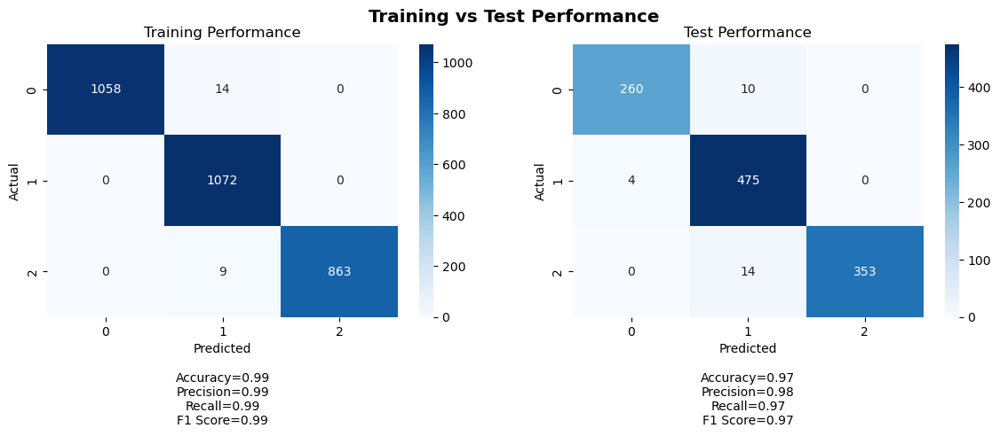

 12%|█▏        | 12/100 [44:05<5:32:15, 226.54s/it]

Training Metrics:
Accuracy: 0.9923740053050398
Precision: 0.9925341860155276
Recall: 0.9923740053050398
F1 Score: 0.9923914807081392

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9756908734379806
Recall: 0.974910394265233
F1 Score: 0.9749744944193574

Training Confusion Matrix:
Class 0 - TP: 1058, FP: 0, TN: 1944, FN: 14
Class 1 - TP: 1072, FP: 23, TN: 1921, FN: 0
Class 2 - TP: 863, FP: 0, TN: 2144, FN: 9

Test Confusion Matrix:
Class 0 - TP: 260, FP: 4, TN: 842, FN: 10
Class 1 - TP: 475, FP: 24, TN: 613, FN: 4
Class 2 - TP: 353, FP: 0, TN: 749, FN: 14
35/35 [==============================] - 0s 3ms/step


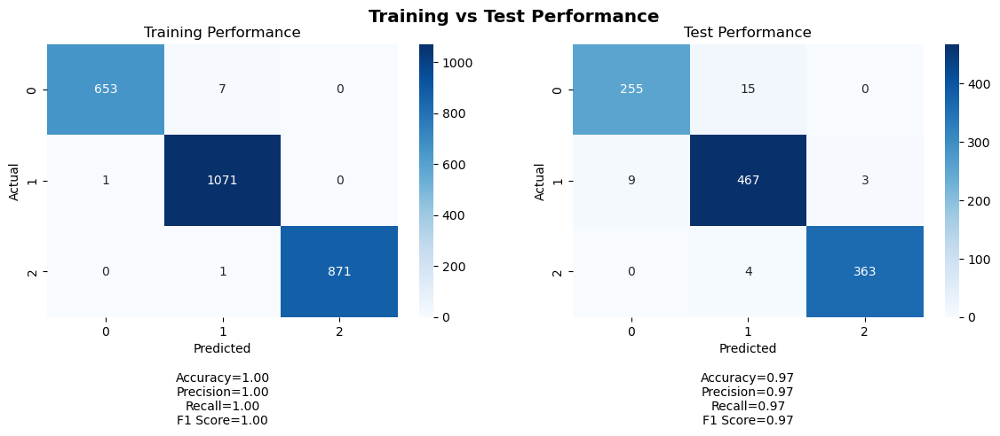

Training Metrics:
Accuracy: 0.9965437788018433
Precision: 0.9965601864805664
Recall: 0.9965437788018433
F1 Score: 0.996542278283237

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9722768103723867
Recall: 0.9722222222222222
F1 Score: 0.9721978753358473

Training Confusion Matrix:
Class 0 - TP: 653, FP: 1, TN: 1943, FN: 7
Class 1 - TP: 1071, FP: 8, TN: 1524, FN: 1
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 255, FP: 9, TN: 837, FN: 15
Class 1 - TP: 467, FP: 19, TN: 618, FN: 12
Class 2 - TP: 363, FP: 3, TN: 746, FN: 4
35/35 [==============================] - 0s 3ms/step


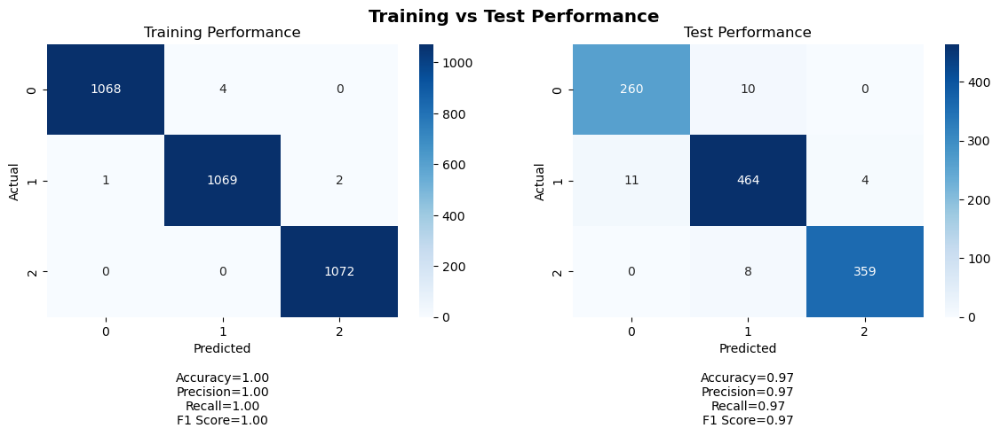

Training Metrics:
Accuracy: 0.9978233830845771
Precision: 0.9978248277050678
Recall: 0.9978233830845771
F1 Score: 0.9978230909925737

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9705273713852497
Recall: 0.9704301075268817
F1 Score: 0.9704641941177394

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 1, TN: 2143, FN: 4
Class 1 - TP: 1069, FP: 4, TN: 2140, FN: 3
Class 2 - TP: 1072, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 11, TN: 835, FN: 10
Class 1 - TP: 464, FP: 18, TN: 619, FN: 15
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 3ms/step


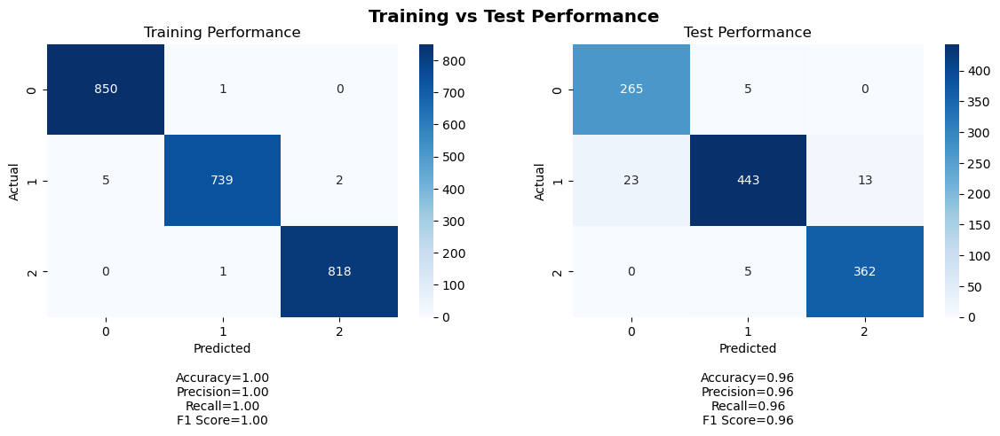

Training Metrics:
Accuracy: 0.9962748344370861
Precision: 0.9962799402154812
Recall: 0.9962748344370861
F1 Score: 0.9962718617770403

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9598036576151027
Recall: 0.9587813620071685
F1 Score: 0.9586980439447758

Training Confusion Matrix:
Class 0 - TP: 850, FP: 5, TN: 1560, FN: 1
Class 1 - TP: 739, FP: 2, TN: 1668, FN: 7
Class 2 - TP: 818, FP: 2, TN: 1595, FN: 1

Test Confusion Matrix:
Class 0 - TP: 265, FP: 23, TN: 823, FN: 5
Class 1 - TP: 443, FP: 10, TN: 627, FN: 36
Class 2 - TP: 362, FP: 13, TN: 736, FN: 5
35/35 [==============================] - 0s 3ms/step


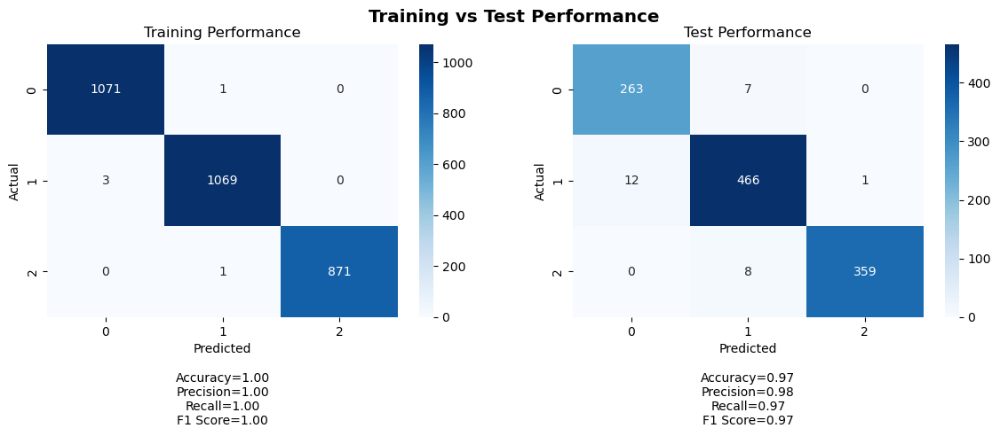

 13%|█▎        | 13/100 [47:46<5:26:04, 224.88s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983434082156986
Recall: 0.998342175066313
F1 Score: 0.9983423111678621

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9751443615018884
Recall: 0.974910394265233
F1 Score: 0.9749758009692553

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 3, TN: 1941, FN: 1
Class 1 - TP: 1069, FP: 2, TN: 1942, FN: 3
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 263, FP: 12, TN: 834, FN: 7
Class 1 - TP: 466, FP: 15, TN: 622, FN: 13
Class 2 - TP: 359, FP: 1, TN: 748, FN: 8
35/35 [==============================] - 0s 2ms/step


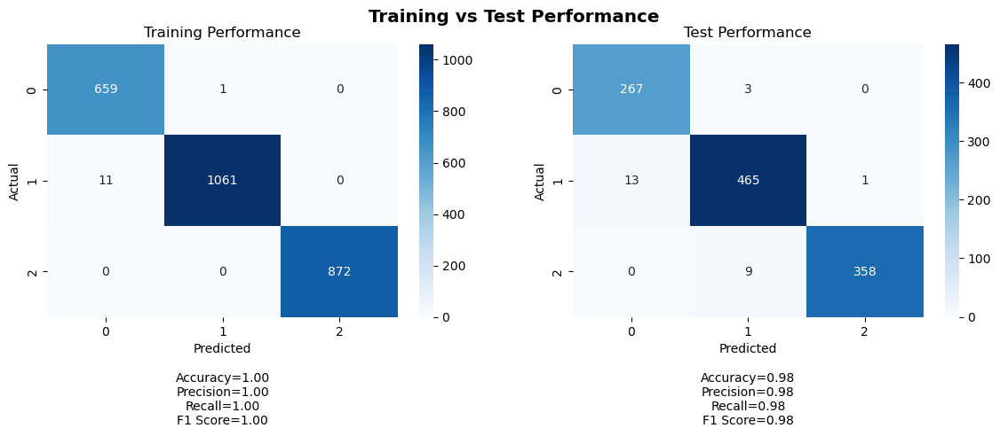

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.9954511378297315
Recall: 0.9953917050691244
F1 Score: 0.9953982321690752

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9770534830880953
Recall: 0.9767025089605734
F1 Score: 0.9767591052634427

Training Confusion Matrix:
Class 0 - TP: 659, FP: 11, TN: 1933, FN: 1
Class 1 - TP: 1061, FP: 1, TN: 1531, FN: 11
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 267, FP: 13, TN: 833, FN: 3
Class 1 - TP: 465, FP: 12, TN: 625, FN: 14
Class 2 - TP: 358, FP: 1, TN: 748, FN: 9
35/35 [==============================] - 0s 2ms/step


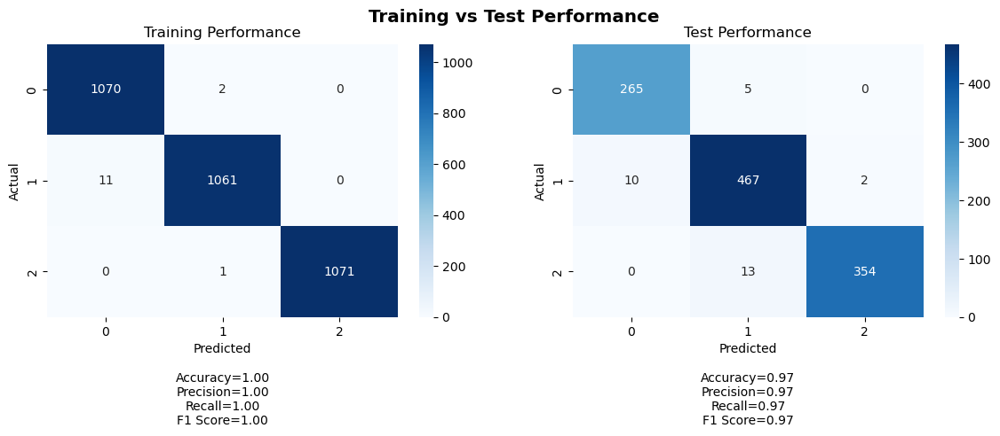

Training Metrics:
Accuracy: 0.9956467661691543
Precision: 0.9956682293151936
Recall: 0.9956467661691543
F1 Score: 0.9956469903117279

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.973425359176864
Recall: 0.9731182795698925
F1 Score: 0.9731613444905758

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 11, TN: 2133, FN: 2
Class 1 - TP: 1061, FP: 3, TN: 2141, FN: 11
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 265, FP: 10, TN: 836, FN: 5
Class 1 - TP: 467, FP: 18, TN: 619, FN: 12
Class 2 - TP: 354, FP: 2, TN: 747, FN: 13
35/35 [==============================] - 0s 3ms/step


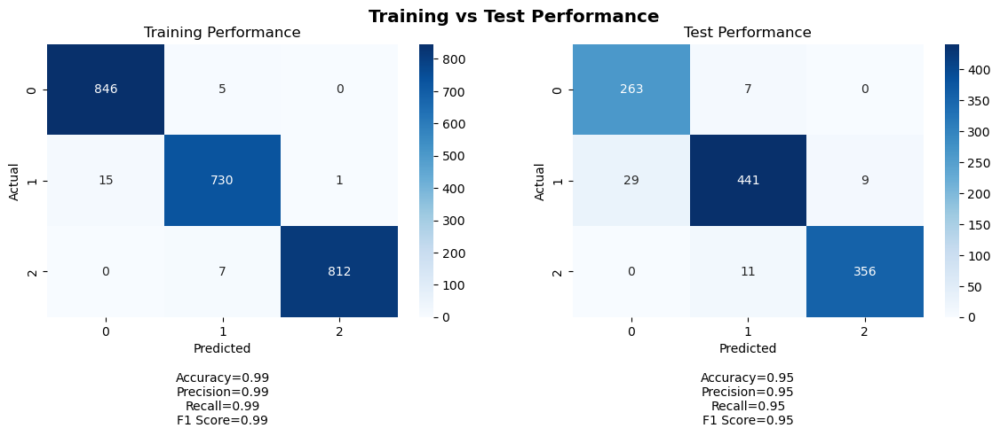

Training Metrics:
Accuracy: 0.9884105960264901
Precision: 0.9884528749698342
Recall: 0.9884105960264901
F1 Score: 0.9884131088261581

Test Metrics:
Accuracy: 0.9498207885304659
Precision: 0.9510316332552563
Recall: 0.9498207885304659
F1 Score: 0.9498927320831316

Training Confusion Matrix:
Class 0 - TP: 846, FP: 15, TN: 1550, FN: 5
Class 1 - TP: 730, FP: 12, TN: 1658, FN: 16
Class 2 - TP: 812, FP: 1, TN: 1596, FN: 7

Test Confusion Matrix:
Class 0 - TP: 263, FP: 29, TN: 817, FN: 7
Class 1 - TP: 441, FP: 18, TN: 619, FN: 38
Class 2 - TP: 356, FP: 9, TN: 740, FN: 11
35/35 [==============================] - 0s 3ms/step


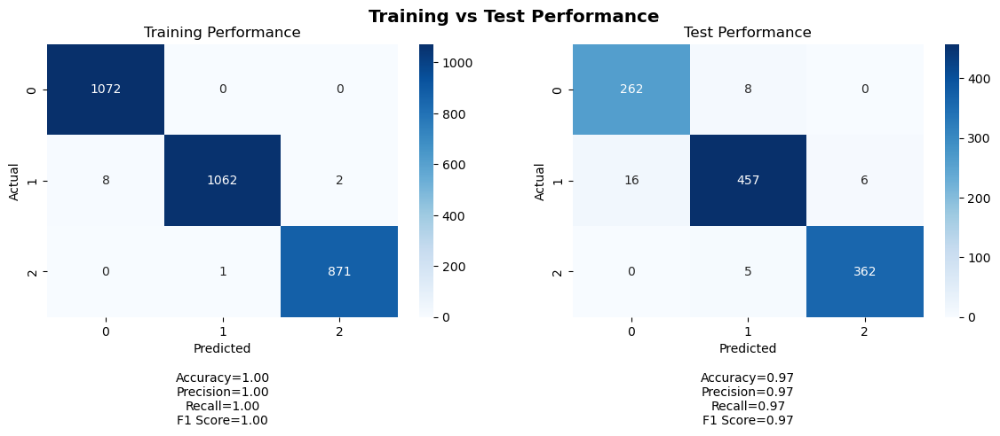

 14%|█▍        | 14/100 [51:28<5:20:59, 223.95s/it]

Training Metrics:
Accuracy: 0.9963527851458885
Precision: 0.9963703858110253
Recall: 0.9963527851458885
F1 Score: 0.9963503131550464

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9688421145450625
Recall: 0.9686379928315412
F1 Score: 0.9686529581560356

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 8, TN: 1936, FN: 0
Class 1 - TP: 1062, FP: 1, TN: 1943, FN: 10
Class 2 - TP: 871, FP: 2, TN: 2142, FN: 1

Test Confusion Matrix:
Class 0 - TP: 262, FP: 16, TN: 830, FN: 8
Class 1 - TP: 457, FP: 13, TN: 624, FN: 22
Class 2 - TP: 362, FP: 6, TN: 743, FN: 5
35/35 [==============================] - 0s 3ms/step


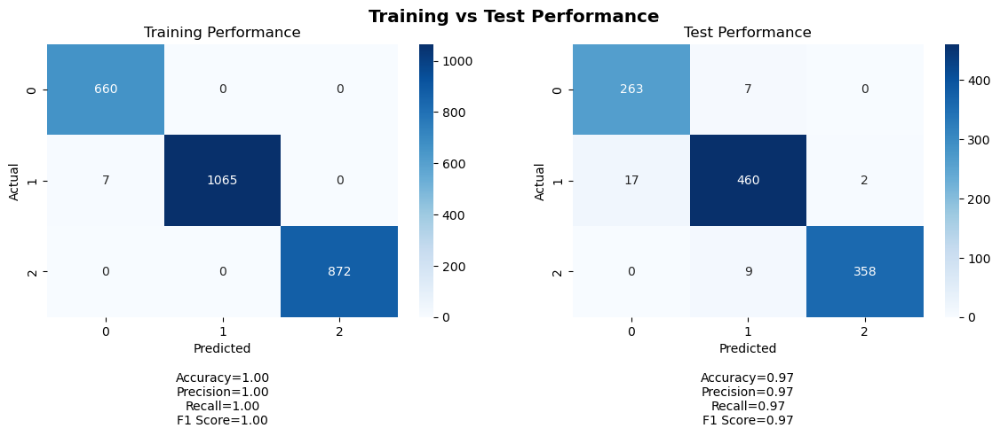

Training Metrics:
Accuracy: 0.9973118279569892
Precision: 0.9973400396575905
Recall: 0.9973118279569892
F1 Score: 0.9973145153716269

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9690568222510032
Recall: 0.9686379928315412
F1 Score: 0.968736783725074

Training Confusion Matrix:
Class 0 - TP: 660, FP: 7, TN: 1937, FN: 0
Class 1 - TP: 1065, FP: 0, TN: 1532, FN: 7
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 17, TN: 829, FN: 7
Class 1 - TP: 460, FP: 16, TN: 621, FN: 19
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 3ms/step


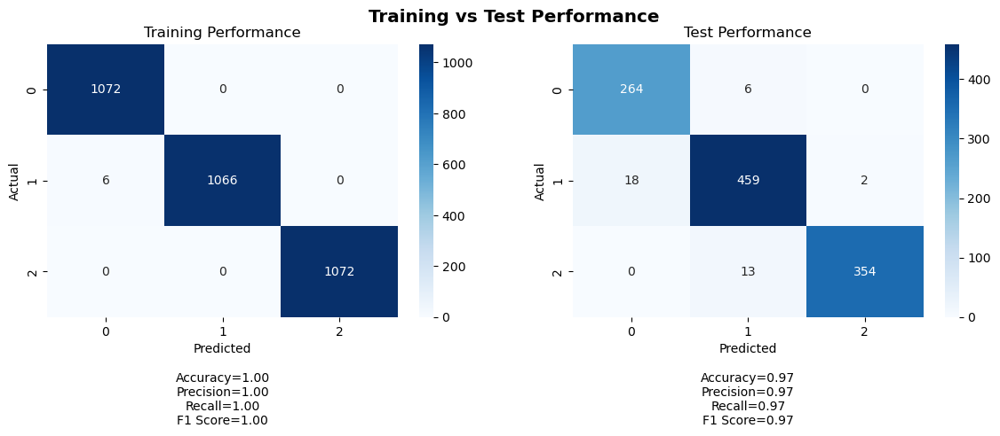

Training Metrics:
Accuracy: 0.9981343283582089
Precision: 0.9981447124304267
Recall: 0.9981343283582089
F1 Score: 0.9981343137468183

Test Metrics:
Accuracy: 0.9650537634408602
Precision: 0.9656491135663302
Recall: 0.9650537634408602
F1 Score: 0.9651670121020174

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 6, TN: 2138, FN: 0
Class 1 - TP: 1066, FP: 0, TN: 2144, FN: 6
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 18, TN: 828, FN: 6
Class 1 - TP: 459, FP: 19, TN: 618, FN: 20
Class 2 - TP: 354, FP: 2, TN: 747, FN: 13
35/35 [==============================] - 0s 4ms/step


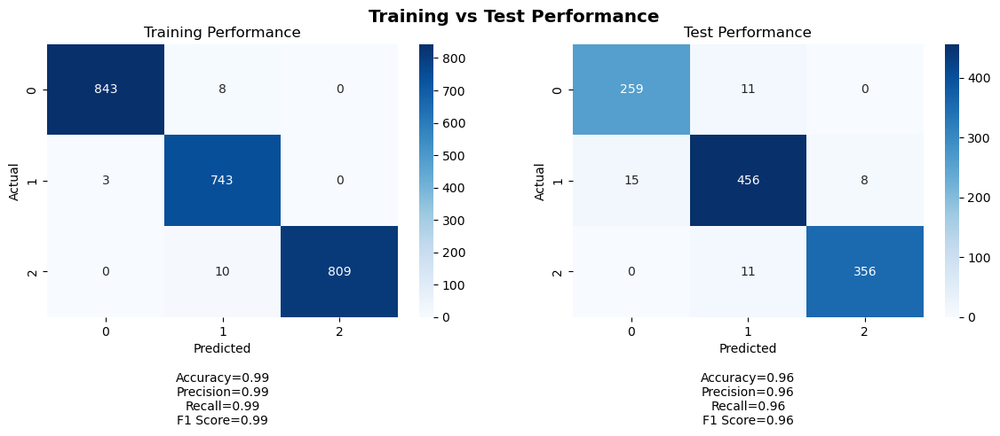

Training Metrics:
Accuracy: 0.9913079470198676
Precision: 0.9914474610199409
Recall: 0.9913079470198676
F1 Score: 0.9913317858764761

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9597733144548865
Recall: 0.9596774193548387
F1 Score: 0.9597070695120151

Training Confusion Matrix:
Class 0 - TP: 843, FP: 3, TN: 1562, FN: 8
Class 1 - TP: 743, FP: 18, TN: 1652, FN: 3
Class 2 - TP: 809, FP: 0, TN: 1597, FN: 10

Test Confusion Matrix:
Class 0 - TP: 259, FP: 15, TN: 831, FN: 11
Class 1 - TP: 456, FP: 22, TN: 615, FN: 23
Class 2 - TP: 356, FP: 8, TN: 741, FN: 11
35/35 [==============================] - 0s 2ms/step


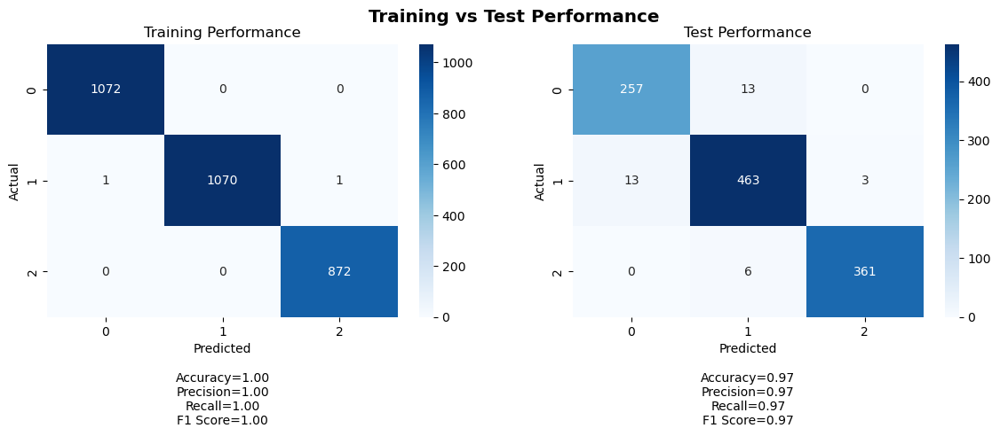

 15%|█▌        | 15/100 [55:16<5:19:01, 225.19s/it]

Training Metrics:
Accuracy: 0.9993368700265252
Precision: 0.9993375588334953
Recall: 0.9993368700265252
F1 Score: 0.999336732734207

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.968721802855453
Recall: 0.9686379928315412
F1 Score: 0.9686703967212141

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 1, TN: 1943, FN: 0
Class 1 - TP: 1070, FP: 0, TN: 1944, FN: 2
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 13, TN: 833, FN: 13
Class 1 - TP: 463, FP: 19, TN: 618, FN: 16
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 3ms/step


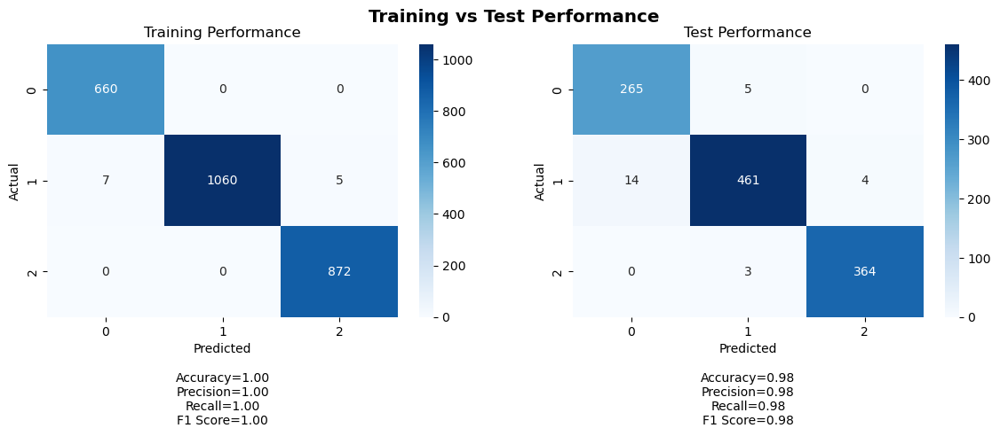

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.9954308638785504
Recall: 0.9953917050691244
F1 Score: 0.9953885708648165

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9769640741715766
Recall: 0.9767025089605734
F1 Score: 0.976723448752681

Training Confusion Matrix:
Class 0 - TP: 660, FP: 7, TN: 1937, FN: 0
Class 1 - TP: 1060, FP: 0, TN: 1532, FN: 12
Class 2 - TP: 872, FP: 5, TN: 1727, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 14, TN: 832, FN: 5
Class 1 - TP: 461, FP: 8, TN: 629, FN: 18
Class 2 - TP: 364, FP: 4, TN: 745, FN: 3
35/35 [==============================] - 0s 3ms/step


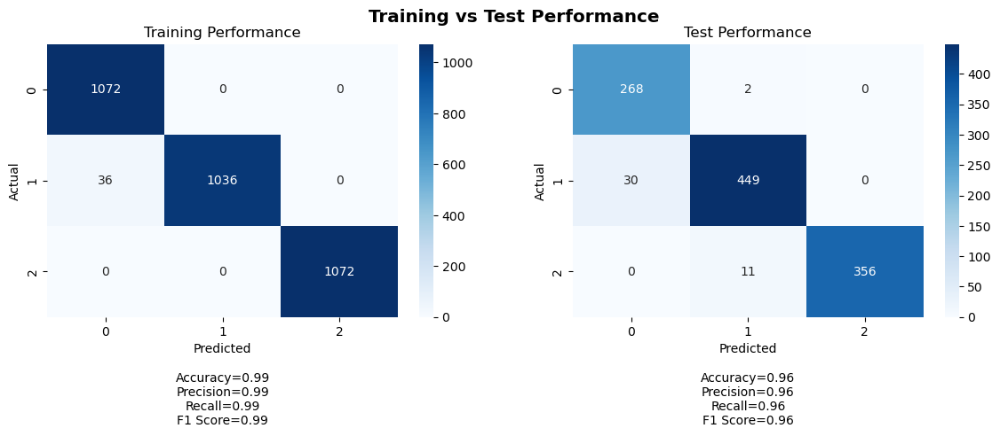

Training Metrics:
Accuracy: 0.9888059701492538
Precision: 0.9891696750902528
Recall: 0.9888059701492538
F1 Score: 0.9888028132235434

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9635666997920733
Recall: 0.9614695340501792
F1 Score: 0.9617532586930629

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 36, TN: 2108, FN: 0
Class 1 - TP: 1036, FP: 0, TN: 2144, FN: 36
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 268, FP: 30, TN: 816, FN: 2
Class 1 - TP: 449, FP: 13, TN: 624, FN: 30
Class 2 - TP: 356, FP: 0, TN: 749, FN: 11
35/35 [==============================] - 0s 3ms/step


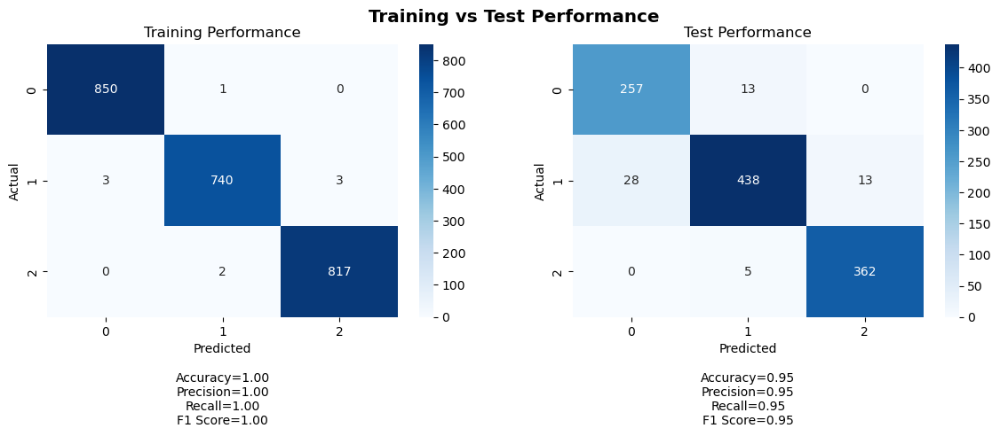

Training Metrics:
Accuracy: 0.9962748344370861
Precision: 0.9962742464731205
Recall: 0.9962748344370861
F1 Score: 0.9962726847063669

Test Metrics:
Accuracy: 0.9471326164874552
Precision: 0.9478881028736716
Recall: 0.9471326164874552
F1 Score: 0.9470657891086804

Training Confusion Matrix:
Class 0 - TP: 850, FP: 3, TN: 1562, FN: 1
Class 1 - TP: 740, FP: 3, TN: 1667, FN: 6
Class 2 - TP: 817, FP: 3, TN: 1594, FN: 2

Test Confusion Matrix:
Class 0 - TP: 257, FP: 28, TN: 818, FN: 13
Class 1 - TP: 438, FP: 18, TN: 619, FN: 41
Class 2 - TP: 362, FP: 13, TN: 736, FN: 5
35/35 [==============================] - 0s 2ms/step


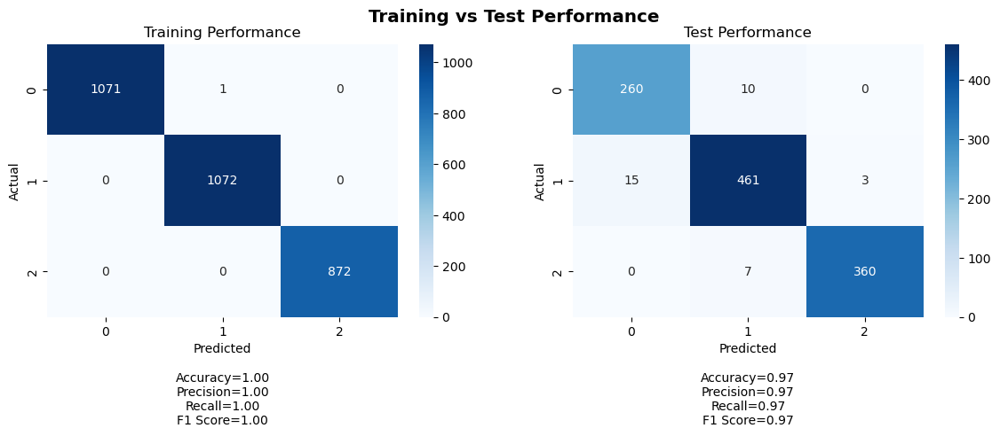

 16%|█▌        | 16/100 [59:07<5:17:53, 227.06s/it]

Training Metrics:
Accuracy: 0.9996684350132626
Precision: 0.999668744020706
Recall: 0.9996684350132626
F1 Score: 0.9996684349411321

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9688208822293289
Recall: 0.9686379928315412
F1 Score: 0.9686998166016298

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 0, TN: 1944, FN: 1
Class 1 - TP: 1072, FP: 1, TN: 1943, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 15, TN: 831, FN: 10
Class 1 - TP: 461, FP: 17, TN: 620, FN: 18
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 3ms/step


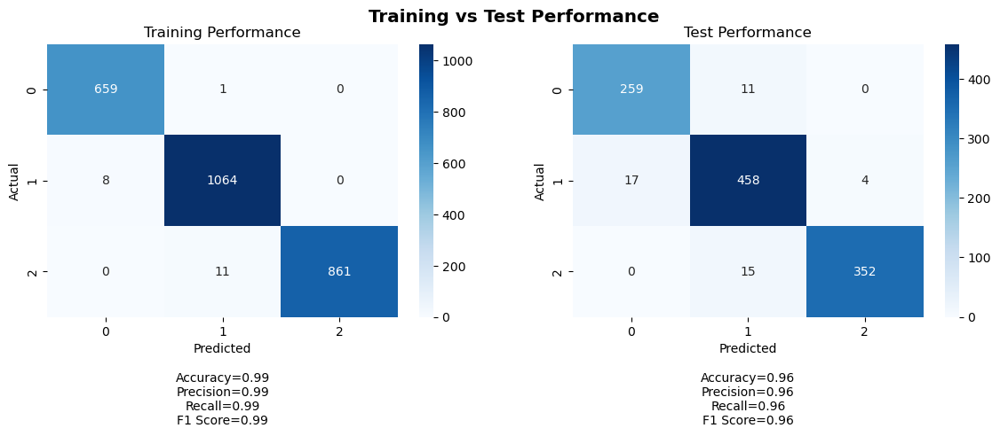

Training Metrics:
Accuracy: 0.9923195084485407
Precision: 0.9923688816000066
Recall: 0.9923195084485407
F1 Score: 0.9923223691123422

Test Metrics:
Accuracy: 0.9578853046594982
Precision: 0.9583463841873616
Recall: 0.9578853046594982
F1 Score: 0.958002978529492

Training Confusion Matrix:
Class 0 - TP: 659, FP: 8, TN: 1936, FN: 1
Class 1 - TP: 1064, FP: 12, TN: 1520, FN: 8
Class 2 - TP: 861, FP: 0, TN: 1732, FN: 11

Test Confusion Matrix:
Class 0 - TP: 259, FP: 17, TN: 829, FN: 11
Class 1 - TP: 458, FP: 26, TN: 611, FN: 21
Class 2 - TP: 352, FP: 4, TN: 745, FN: 15
35/35 [==============================] - 0s 2ms/step


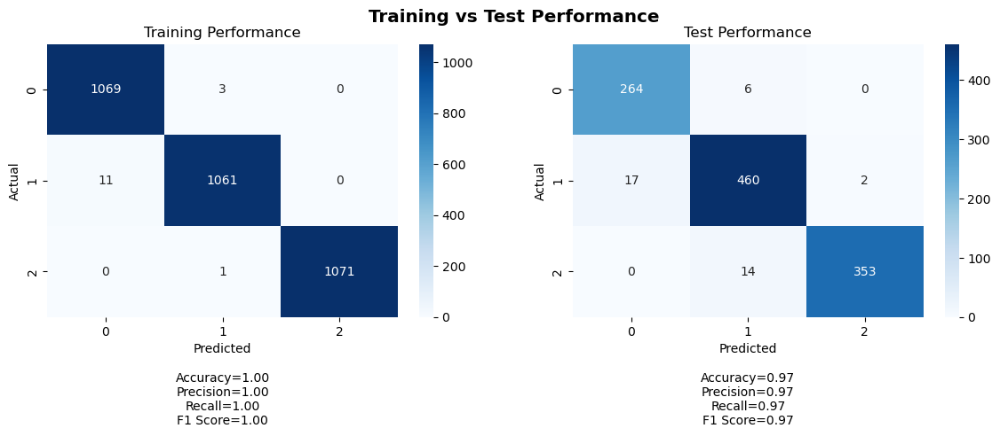

Training Metrics:
Accuracy: 0.9953358208955224
Precision: 0.9953529820900713
Recall: 0.9953358208955224
F1 Score: 0.9953362008199138

Test Metrics:
Accuracy: 0.9650537634408602
Precision: 0.9656268292651524
Recall: 0.9650537634408602
F1 Score: 0.9651585593809413

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 11, TN: 2133, FN: 3
Class 1 - TP: 1061, FP: 4, TN: 2140, FN: 11
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 264, FP: 17, TN: 829, FN: 6
Class 1 - TP: 460, FP: 20, TN: 617, FN: 19
Class 2 - TP: 353, FP: 2, TN: 747, FN: 14
35/35 [==============================] - 0s 3ms/step


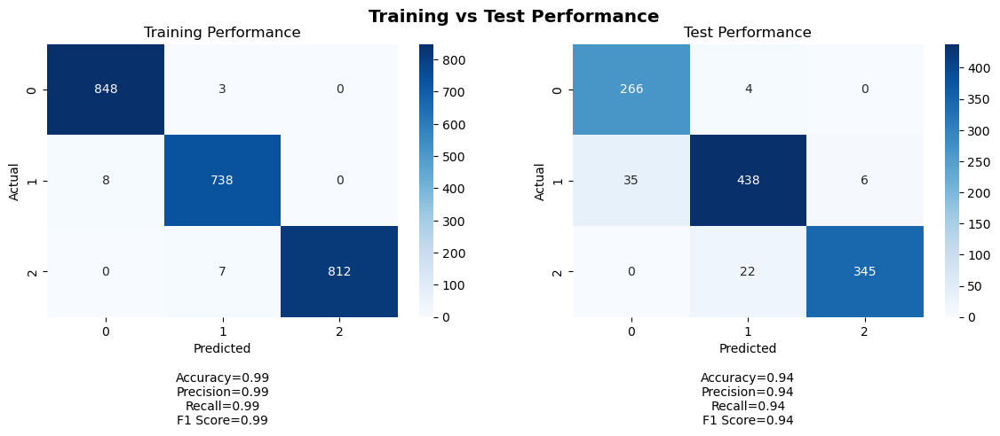

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9925800773757769
Recall: 0.9925496688741722
F1 Score: 0.9925551063196537

Test Metrics:
Accuracy: 0.9399641577060932
Precision: 0.9421959047024258
Recall: 0.9399641577060932
F1 Score: 0.9401557504290994

Training Confusion Matrix:
Class 0 - TP: 848, FP: 8, TN: 1557, FN: 3
Class 1 - TP: 738, FP: 10, TN: 1660, FN: 8
Class 2 - TP: 812, FP: 0, TN: 1597, FN: 7

Test Confusion Matrix:
Class 0 - TP: 266, FP: 35, TN: 811, FN: 4
Class 1 - TP: 438, FP: 26, TN: 611, FN: 41
Class 2 - TP: 345, FP: 6, TN: 743, FN: 22
35/35 [==============================] - 0s 3ms/step


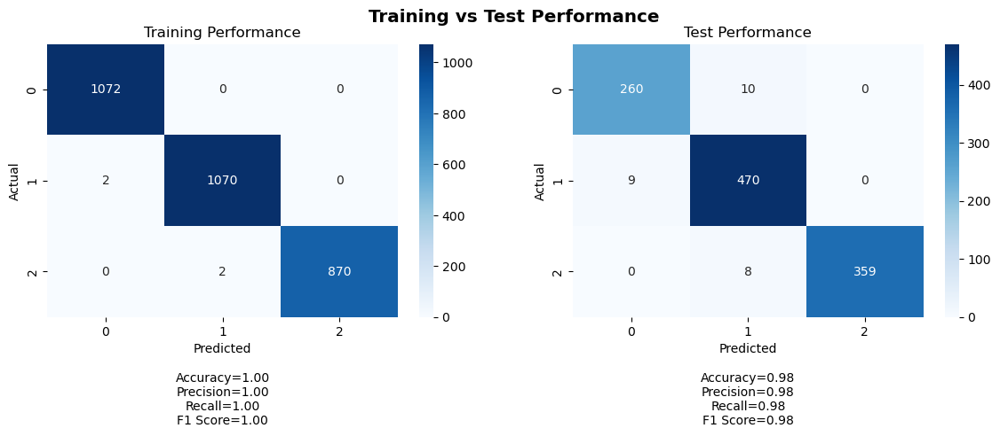

 17%|█▋        | 17/100 [1:02:48<5:11:25, 225.13s/it]

Training Metrics:
Accuracy: 0.9986737400530504
Precision: 0.9986749749319582
Recall: 0.9986737400530504
F1 Score: 0.9986736683888673

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9760739336595378
Recall: 0.9758064516129032
F1 Score: 0.9758637490698521

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1070, FP: 2, TN: 1942, FN: 2
Class 2 - TP: 870, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 260, FP: 9, TN: 837, FN: 10
Class 1 - TP: 470, FP: 18, TN: 619, FN: 9
Class 2 - TP: 359, FP: 0, TN: 749, FN: 8
35/35 [==============================] - 0s 3ms/step


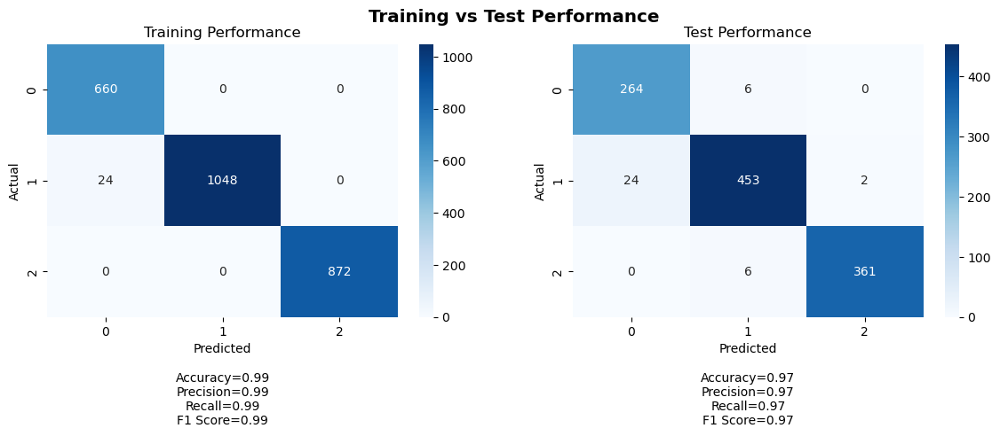

Training Metrics:
Accuracy: 0.9907834101382489
Precision: 0.991106799256205
Recall: 0.9907834101382489
F1 Score: 0.9908135317425814

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9669504221415111
Recall: 0.9659498207885304
F1 Score: 0.9661112665757219

Training Confusion Matrix:
Class 0 - TP: 660, FP: 24, TN: 1920, FN: 0
Class 1 - TP: 1048, FP: 0, TN: 1532, FN: 24
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 24, TN: 822, FN: 6
Class 1 - TP: 453, FP: 12, TN: 625, FN: 26
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 3ms/step


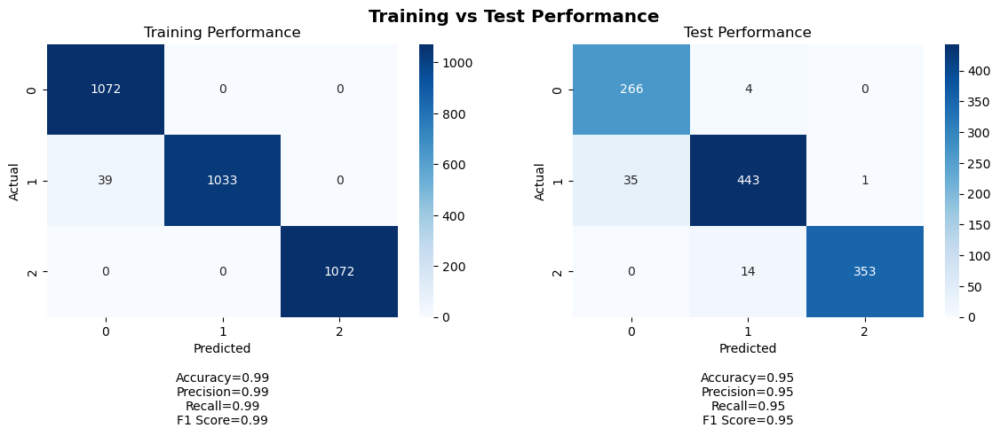

Training Metrics:
Accuracy: 0.9878731343283582
Precision: 0.9882988298829883
Recall: 0.9878731343283582
F1 Score: 0.9878691203784806

Test Metrics:
Accuracy: 0.9516129032258065
Precision: 0.954180204339008
Recall: 0.9516129032258065
F1 Score: 0.9519770778461779

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 39, TN: 2105, FN: 0
Class 1 - TP: 1033, FP: 0, TN: 2144, FN: 39
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 35, TN: 811, FN: 4
Class 1 - TP: 443, FP: 18, TN: 619, FN: 36
Class 2 - TP: 353, FP: 1, TN: 748, FN: 14
35/35 [==============================] - 0s 3ms/step


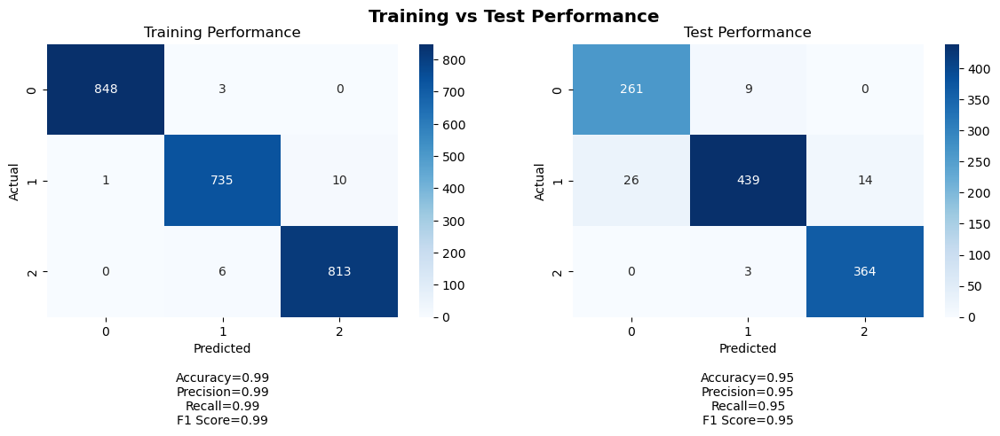

Training Metrics:
Accuracy: 0.9917218543046358
Precision: 0.9917309823725814
Recall: 0.9917218543046358
F1 Score: 0.9917233910052885

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9544824964223512
Recall: 0.953405017921147
F1 Score: 0.9532946406517674

Training Confusion Matrix:
Class 0 - TP: 848, FP: 1, TN: 1564, FN: 3
Class 1 - TP: 735, FP: 9, TN: 1661, FN: 11
Class 2 - TP: 813, FP: 10, TN: 1587, FN: 6

Test Confusion Matrix:
Class 0 - TP: 261, FP: 26, TN: 820, FN: 9
Class 1 - TP: 439, FP: 12, TN: 625, FN: 40
Class 2 - TP: 364, FP: 14, TN: 735, FN: 3
35/35 [==============================] - 0s 3ms/step


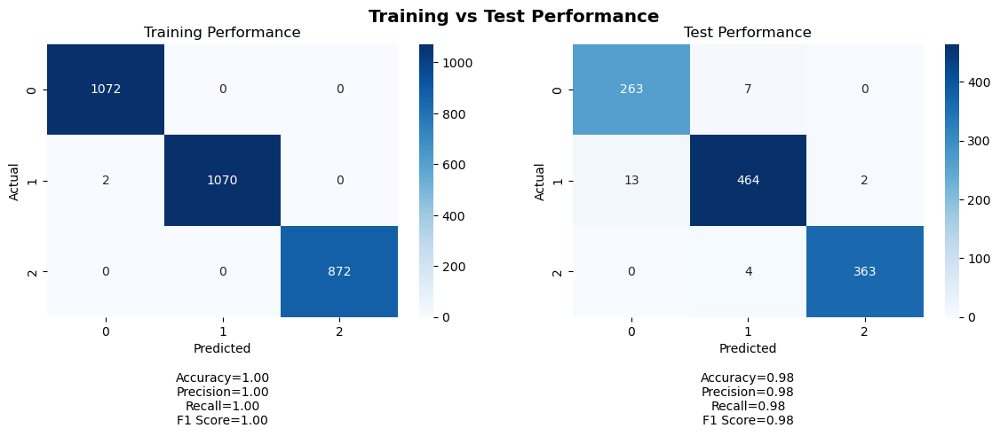

 18%|█▊        | 18/100 [1:06:39<5:10:10, 226.96s/it]

Training Metrics:
Accuracy: 0.9993368700265252
Precision: 0.999338104905433
Recall: 0.9993368700265252
F1 Score: 0.9993368694494805

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9768629195453361
Recall: 0.9767025089605734
F1 Score: 0.9767447903683266

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1070, FP: 0, TN: 1944, FN: 2
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 13, TN: 833, FN: 7
Class 1 - TP: 464, FP: 11, TN: 626, FN: 15
Class 2 - TP: 363, FP: 2, TN: 747, FN: 4
35/35 [==============================] - 0s 2ms/step


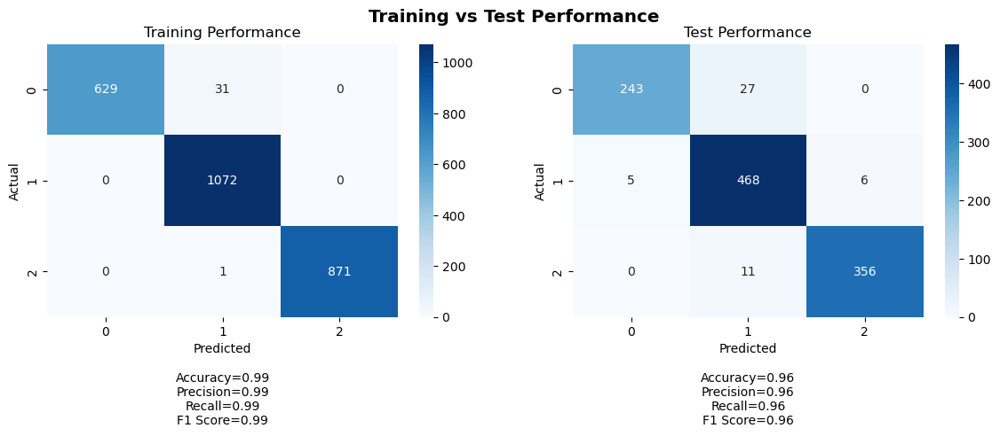

Training Metrics:
Accuracy: 0.9877112135176651
Precision: 0.988067410227298
Recall: 0.9877112135176651
F1 Score: 0.9876583093959623

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.9574383930725054
Recall: 0.9560931899641577
F1 Score: 0.9560338153089102

Training Confusion Matrix:
Class 0 - TP: 629, FP: 0, TN: 1944, FN: 31
Class 1 - TP: 1072, FP: 32, TN: 1500, FN: 0
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 243, FP: 5, TN: 841, FN: 27
Class 1 - TP: 468, FP: 38, TN: 599, FN: 11
Class 2 - TP: 356, FP: 6, TN: 743, FN: 11
35/35 [==============================] - 0s 3ms/step


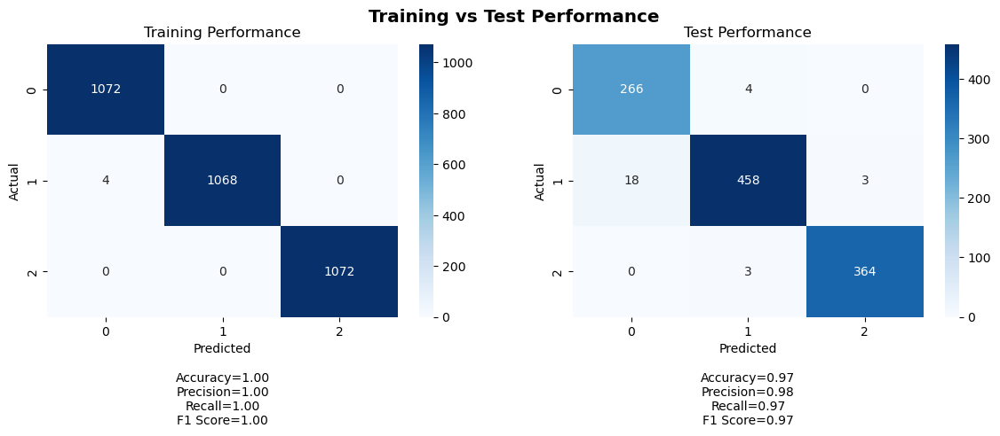

Training Metrics:
Accuracy: 0.9987562189054726
Precision: 0.9987608426270137
Recall: 0.9987562189054726
F1 Score: 0.9987562145761906

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9755166409099373
Recall: 0.974910394265233
F1 Score: 0.9749734329934642

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 4, TN: 2140, FN: 0
Class 1 - TP: 1068, FP: 0, TN: 2144, FN: 4
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 18, TN: 828, FN: 4
Class 1 - TP: 458, FP: 7, TN: 630, FN: 21
Class 2 - TP: 364, FP: 3, TN: 746, FN: 3
35/35 [==============================] - 0s 2ms/step


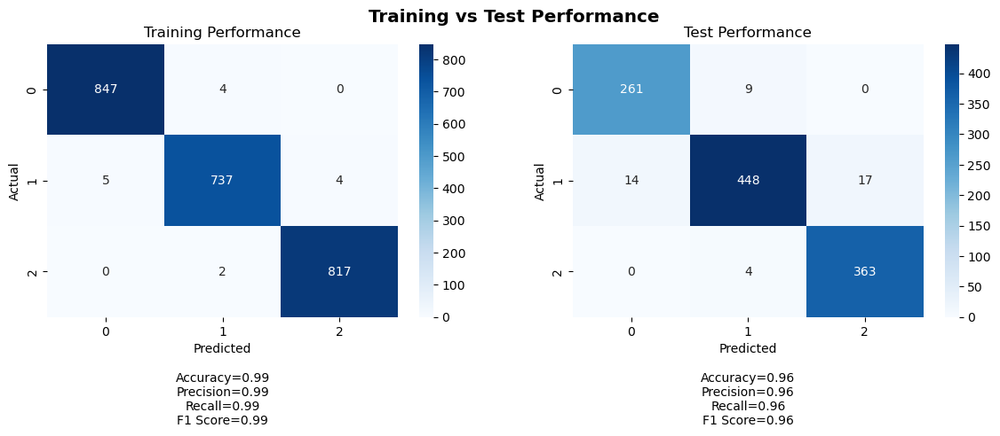

Training Metrics:
Accuracy: 0.9937913907284768
Precision: 0.9937878255995904
Recall: 0.9937913907284768
F1 Score: 0.9937877442548556

Test Metrics:
Accuracy: 0.9605734767025089
Precision: 0.9608678604041437
Recall: 0.9605734767025089
F1 Score: 0.9604542642608478

Training Confusion Matrix:
Class 0 - TP: 847, FP: 5, TN: 1560, FN: 4
Class 1 - TP: 737, FP: 6, TN: 1664, FN: 9
Class 2 - TP: 817, FP: 4, TN: 1593, FN: 2

Test Confusion Matrix:
Class 0 - TP: 261, FP: 14, TN: 832, FN: 9
Class 1 - TP: 448, FP: 13, TN: 624, FN: 31
Class 2 - TP: 363, FP: 17, TN: 732, FN: 4
35/35 [==============================] - 0s 3ms/step


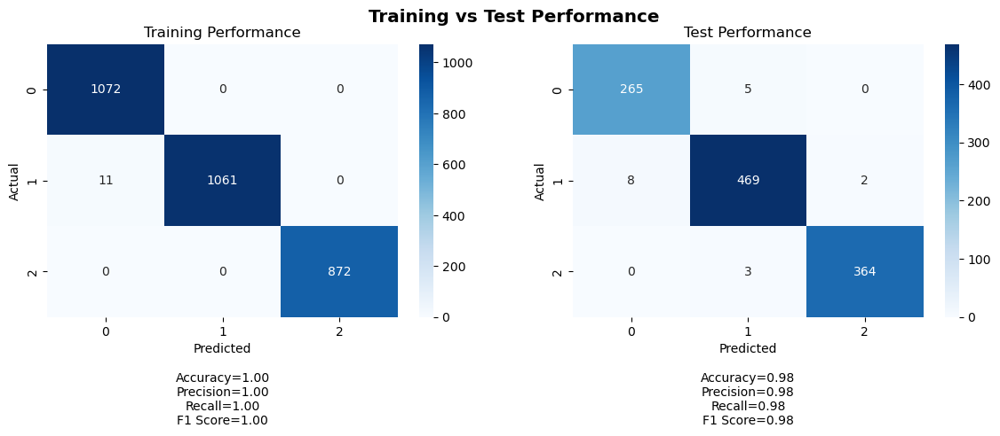

 19%|█▉        | 19/100 [1:10:18<5:03:13, 224.61s/it]

Training Metrics:
Accuracy: 0.9963527851458885
Precision: 0.9963898298027632
Recall: 0.9963527851458885
F1 Score: 0.996352689137631

Test Metrics:
Accuracy: 0.9838709677419355
Precision: 0.9839147890950705
Recall: 0.9838709677419355
F1 Score: 0.9838832190941994

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 11, TN: 1933, FN: 0
Class 1 - TP: 1061, FP: 0, TN: 1944, FN: 11
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 8, TN: 838, FN: 5
Class 1 - TP: 469, FP: 8, TN: 629, FN: 10
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3
35/35 [==============================] - 0s 3ms/step


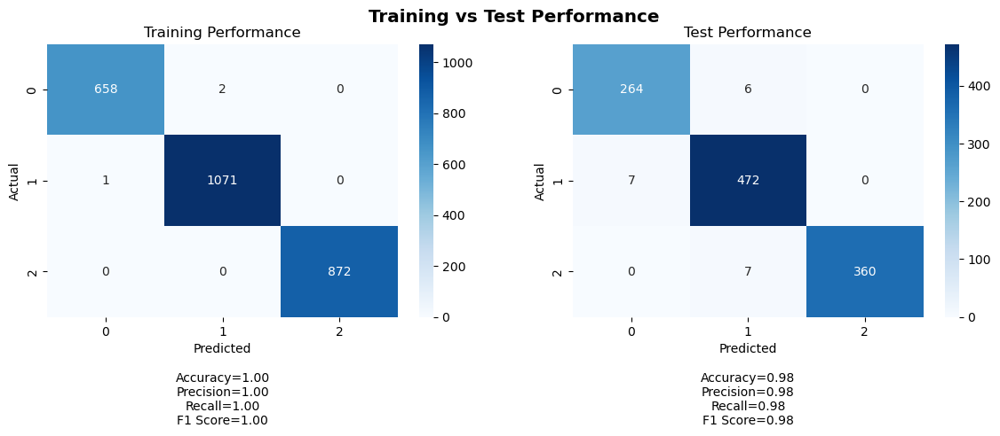

Training Metrics:
Accuracy: 0.9988479262672811
Precision: 0.9988480593249677
Recall: 0.9988479262672811
F1 Score: 0.9988477580935211

Test Metrics:
Accuracy: 0.982078853046595
Precision: 0.9822461066313357
Recall: 0.982078853046595
F1 Score: 0.9821151929334943

Training Confusion Matrix:
Class 0 - TP: 658, FP: 1, TN: 1943, FN: 2
Class 1 - TP: 1071, FP: 2, TN: 1530, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 7, TN: 839, FN: 6
Class 1 - TP: 472, FP: 13, TN: 624, FN: 7
Class 2 - TP: 360, FP: 0, TN: 749, FN: 7
35/35 [==============================] - 0s 2ms/step


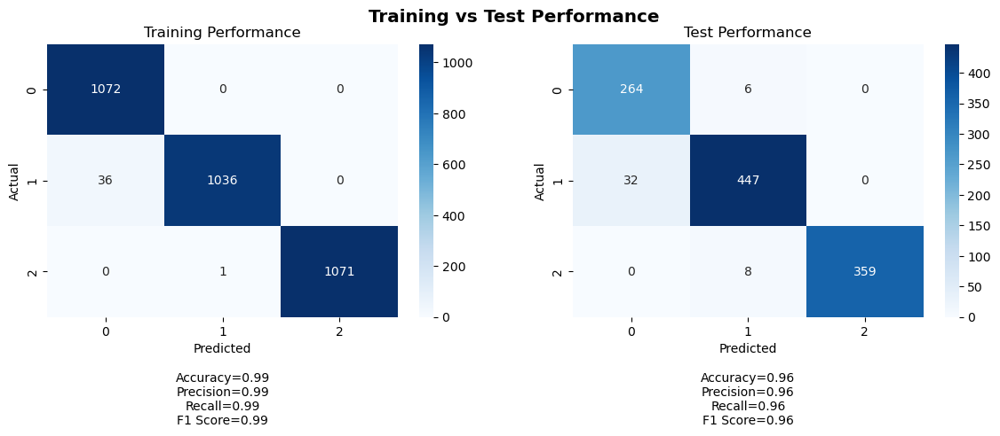

Training Metrics:
Accuracy: 0.9884950248756219
Precision: 0.9888482350388224
Recall: 0.9884950248756219
F1 Score: 0.9884919144417859

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9608101909200503
Recall: 0.9587813620071685
F1 Score: 0.9591292910864995

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 36, TN: 2108, FN: 0
Class 1 - TP: 1036, FP: 1, TN: 2143, FN: 36
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 264, FP: 32, TN: 814, FN: 6
Class 1 - TP: 447, FP: 14, TN: 623, FN: 32
Class 2 - TP: 359, FP: 0, TN: 749, FN: 8
35/35 [==============================] - 0s 717us/step


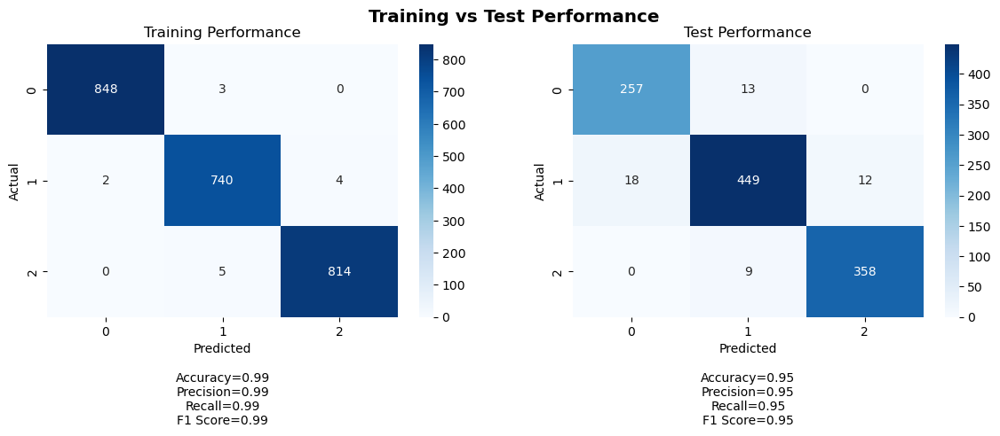

Training Metrics:
Accuracy: 0.9942052980132451
Precision: 0.9942111537490086
Recall: 0.9942052980132451
F1 Score: 0.9942074305306029

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9534506245416456
Recall: 0.953405017921147
F1 Score: 0.9533745477667469

Training Confusion Matrix:
Class 0 - TP: 848, FP: 2, TN: 1563, FN: 3
Class 1 - TP: 740, FP: 8, TN: 1662, FN: 6
Class 2 - TP: 814, FP: 4, TN: 1593, FN: 5

Test Confusion Matrix:
Class 0 - TP: 257, FP: 18, TN: 828, FN: 13
Class 1 - TP: 449, FP: 22, TN: 615, FN: 30
Class 2 - TP: 358, FP: 12, TN: 737, FN: 9
35/35 [==============================] - 0s 3ms/step


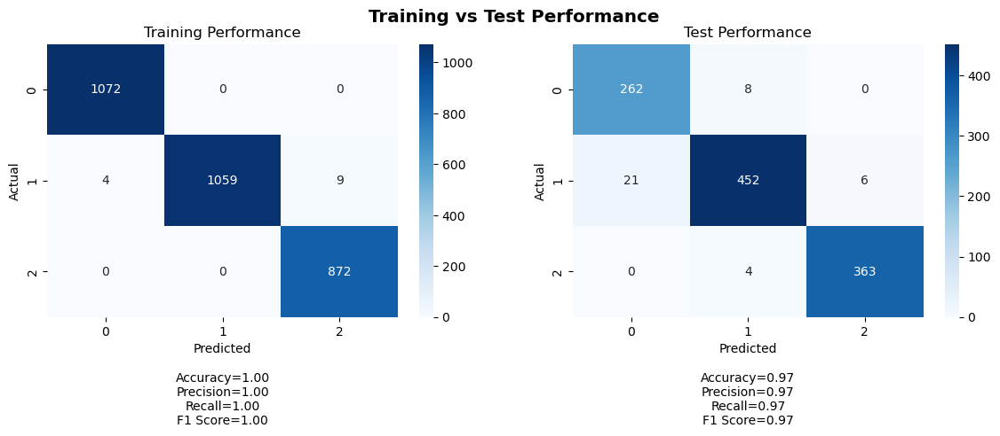

 20%|██        | 20/100 [1:50:18<19:30:19, 877.75s/it]

Training Metrics:
Accuracy: 0.9956896551724138
Precision: 0.9957250699153314
Recall: 0.9956896551724138
F1 Score: 0.9956854028186884

Test Metrics:
Accuracy: 0.9650537634408602
Precision: 0.9655996896072354
Recall: 0.9650537634408602
F1 Score: 0.9650934360874308

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1059, FP: 0, TN: 1944, FN: 13
Class 2 - TP: 872, FP: 9, TN: 2135, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 21, TN: 825, FN: 8
Class 1 - TP: 452, FP: 12, TN: 625, FN: 27
Class 2 - TP: 363, FP: 6, TN: 743, FN: 4
35/35 [==============================] - 0s 906us/step


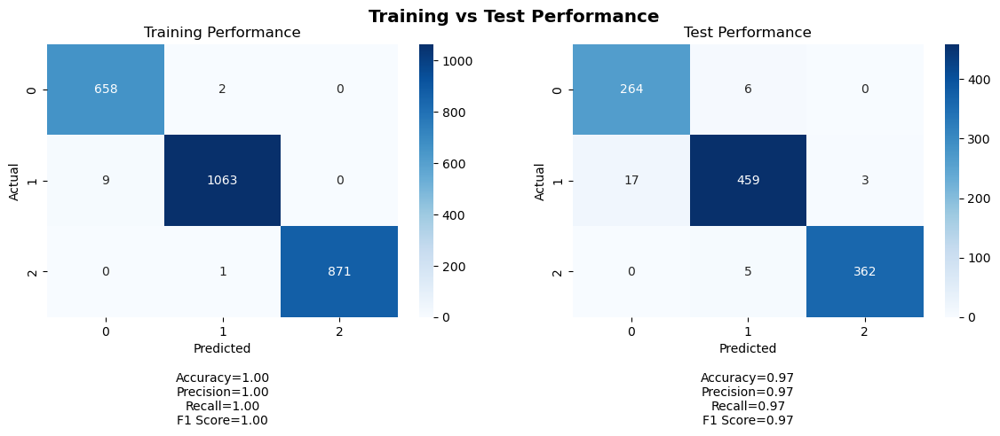

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.995421492788073
Recall: 0.9953917050691244
F1 Score: 0.9953962702698188

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9726150571442739
Recall: 0.9722222222222222
F1 Score: 0.9722864308034106

Training Confusion Matrix:
Class 0 - TP: 658, FP: 9, TN: 1935, FN: 2
Class 1 - TP: 1063, FP: 3, TN: 1529, FN: 9
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 264, FP: 17, TN: 829, FN: 6
Class 1 - TP: 459, FP: 11, TN: 626, FN: 20
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 1ms/step


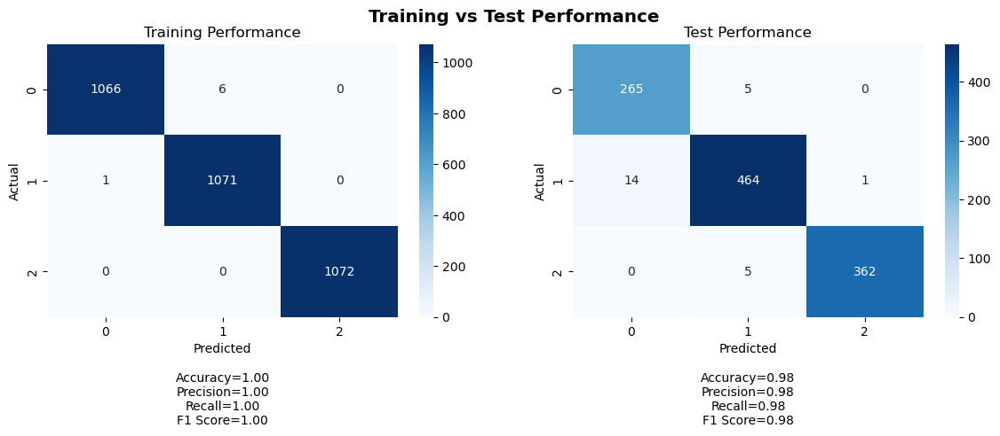

Training Metrics:
Accuracy: 0.9978233830845771
Precision: 0.9978305874121858
Recall: 0.9978233830845771
F1 Score: 0.9978233712466733

Test Metrics:
Accuracy: 0.9775985663082437
Precision: 0.97789884264105
Recall: 0.9775985663082437
F1 Score: 0.977664620947397

Training Confusion Matrix:
Class 0 - TP: 1066, FP: 1, TN: 2143, FN: 6
Class 1 - TP: 1071, FP: 6, TN: 2138, FN: 1
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 14, TN: 832, FN: 5
Class 1 - TP: 464, FP: 10, TN: 627, FN: 15
Class 2 - TP: 362, FP: 1, TN: 748, FN: 5
35/35 [==============================] - 0s 1ms/step


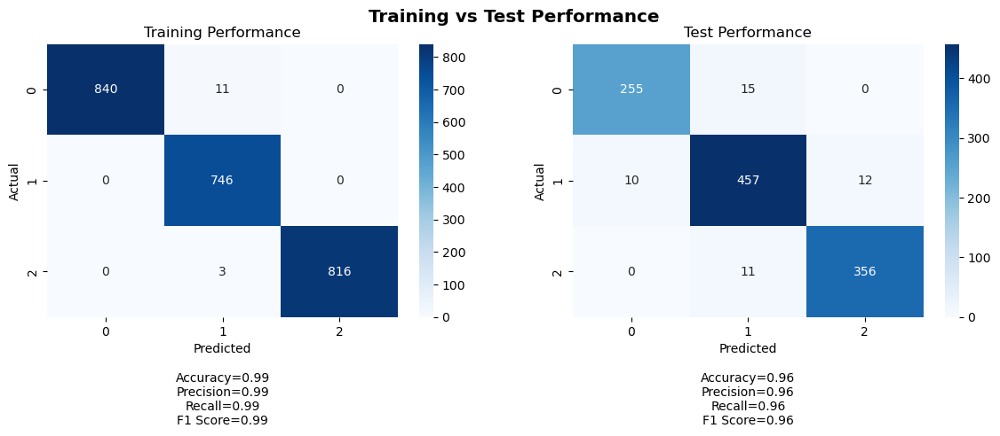

Training Metrics:
Accuracy: 0.9942052980132451
Precision: 0.9943120425235273
Recall: 0.9942052980132451
F1 Score: 0.9942162843962035

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9570423390334608
Recall: 0.956989247311828
F1 Score: 0.9569880071042912

Training Confusion Matrix:
Class 0 - TP: 840, FP: 0, TN: 1565, FN: 11
Class 1 - TP: 746, FP: 14, TN: 1656, FN: 0
Class 2 - TP: 816, FP: 0, TN: 1597, FN: 3

Test Confusion Matrix:
Class 0 - TP: 255, FP: 10, TN: 836, FN: 15
Class 1 - TP: 457, FP: 26, TN: 611, FN: 22
Class 2 - TP: 356, FP: 12, TN: 737, FN: 11
35/35 [==============================] - 0s 1ms/step


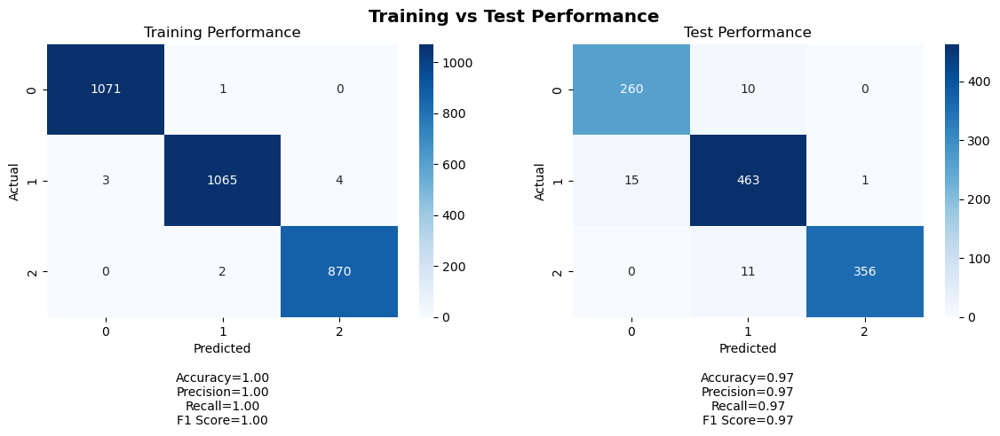

 21%|██        | 21/100 [1:52:10<14:13:07, 647.94s/it]

Training Metrics:
Accuracy: 0.996684350132626
Precision: 0.9966855119214856
Recall: 0.996684350132626
F1 Score: 0.9966830088078988

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9672595503736612
Recall: 0.9668458781362007
F1 Score: 0.9669604480007428

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 3, TN: 1941, FN: 1
Class 1 - TP: 1065, FP: 3, TN: 1941, FN: 7
Class 2 - TP: 870, FP: 4, TN: 2140, FN: 2

Test Confusion Matrix:
Class 0 - TP: 260, FP: 15, TN: 831, FN: 10
Class 1 - TP: 463, FP: 21, TN: 616, FN: 16
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 1ms/step


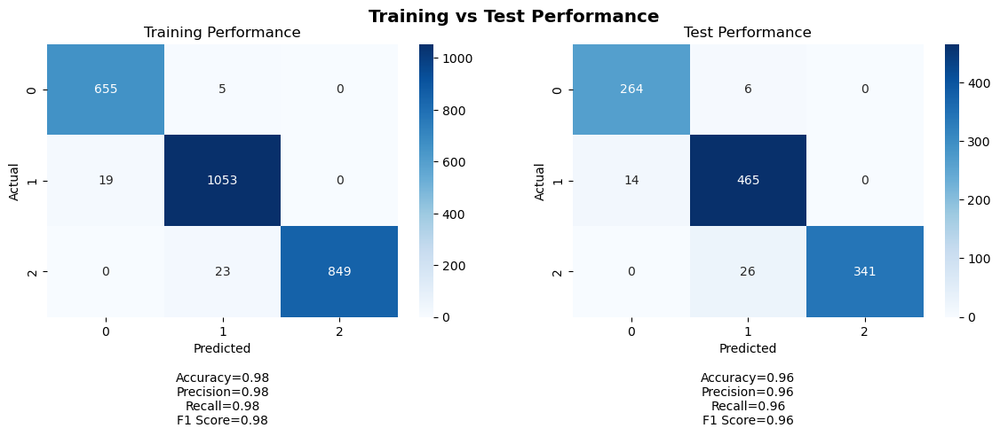

Training Metrics:
Accuracy: 0.9819508448540707
Precision: 0.9821919263584947
Recall: 0.9819508448540707
F1 Score: 0.9819779118038031

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9601808525270391
Recall: 0.9587813620071685
F1 Score: 0.9588644844080513

Training Confusion Matrix:
Class 0 - TP: 655, FP: 19, TN: 1925, FN: 5
Class 1 - TP: 1053, FP: 28, TN: 1504, FN: 19
Class 2 - TP: 849, FP: 0, TN: 1732, FN: 23

Test Confusion Matrix:
Class 0 - TP: 264, FP: 14, TN: 832, FN: 6
Class 1 - TP: 465, FP: 32, TN: 605, FN: 14
Class 2 - TP: 341, FP: 0, TN: 749, FN: 26
35/35 [==============================] - 0s 1ms/step


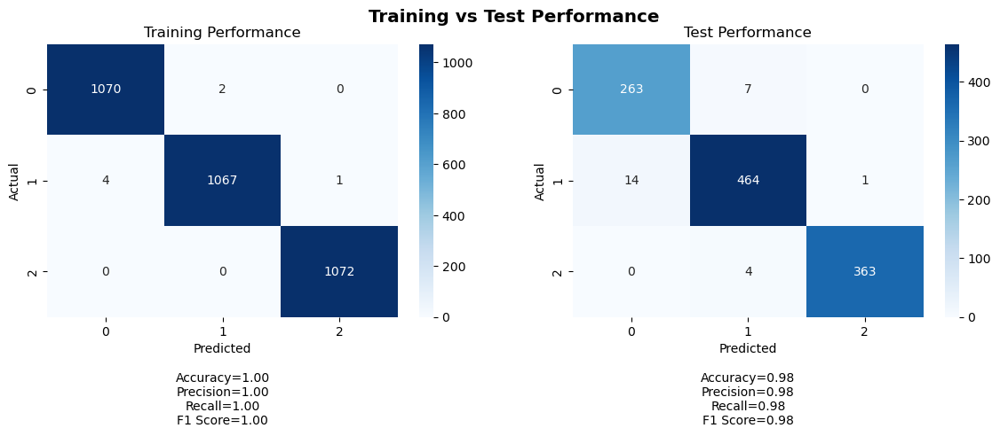

Training Metrics:
Accuracy: 0.9978233830845771
Precision: 0.9978242437916203
Recall: 0.9978233830845771
F1 Score: 0.9978227999842135

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9769291373445604
Recall: 0.9767025089605734
F1 Score: 0.9767648763723774

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 4, TN: 2140, FN: 2
Class 1 - TP: 1067, FP: 2, TN: 2142, FN: 5
Class 2 - TP: 1072, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 14, TN: 832, FN: 7
Class 1 - TP: 464, FP: 11, TN: 626, FN: 15
Class 2 - TP: 363, FP: 1, TN: 748, FN: 4
35/35 [==============================] - 0s 1ms/step


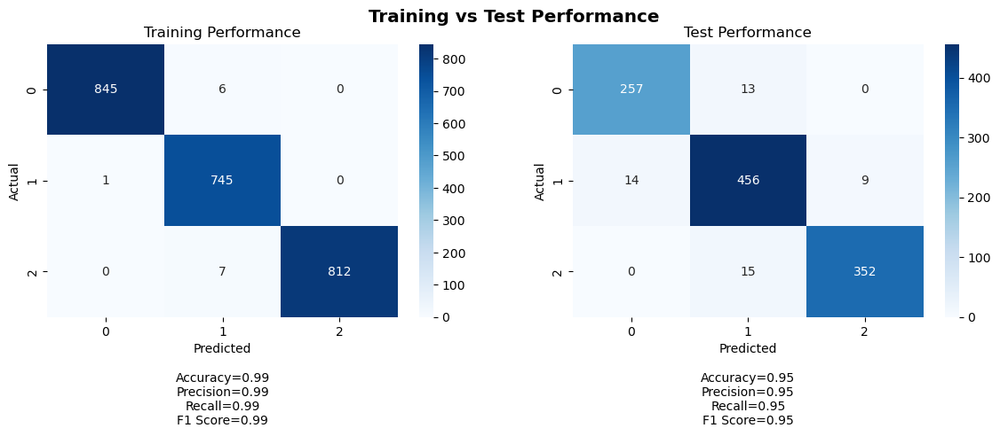

Training Metrics:
Accuracy: 0.9942052980132451
Precision: 0.9942880358376887
Recall: 0.9942052980132451
F1 Score: 0.9942179293413703

Test Metrics:
Accuracy: 0.9543010752688172
Precision: 0.954472519917041
Recall: 0.9543010752688172
F1 Score: 0.9543534511149392

Training Confusion Matrix:
Class 0 - TP: 845, FP: 1, TN: 1564, FN: 6
Class 1 - TP: 745, FP: 13, TN: 1657, FN: 1
Class 2 - TP: 812, FP: 0, TN: 1597, FN: 7

Test Confusion Matrix:
Class 0 - TP: 257, FP: 14, TN: 832, FN: 13
Class 1 - TP: 456, FP: 28, TN: 609, FN: 23
Class 2 - TP: 352, FP: 9, TN: 740, FN: 15
35/35 [==============================] - 0s 1ms/step


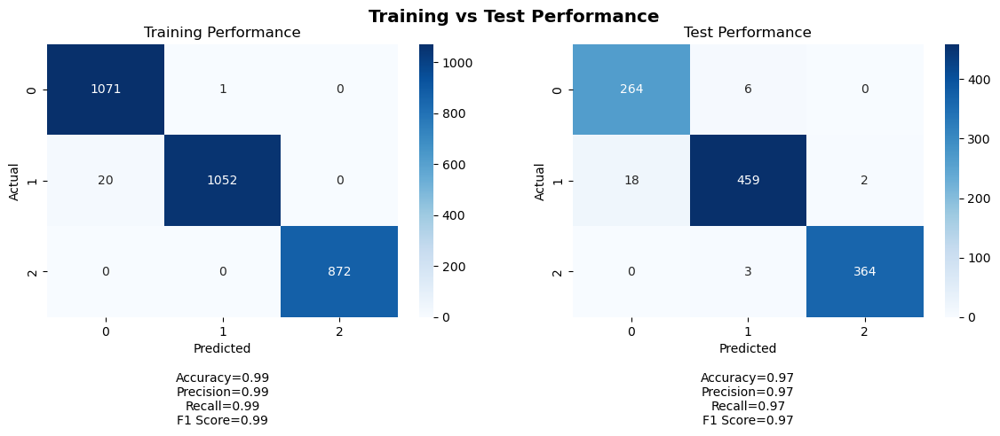

 22%|██▏       | 22/100 [1:54:28<10:43:13, 494.79s/it]

Training Metrics:
Accuracy: 0.9930371352785146
Precision: 0.9931466381376869
Recall: 0.9930371352785146
F1 Score: 0.9930365884140476

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9745062316347631
Recall: 0.9740143369175627
F1 Score: 0.9740941149764054

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 20, TN: 1924, FN: 1
Class 1 - TP: 1052, FP: 1, TN: 1943, FN: 20
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 18, TN: 828, FN: 6
Class 1 - TP: 459, FP: 9, TN: 628, FN: 20
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3
35/35 [==============================] - 0s 2ms/step


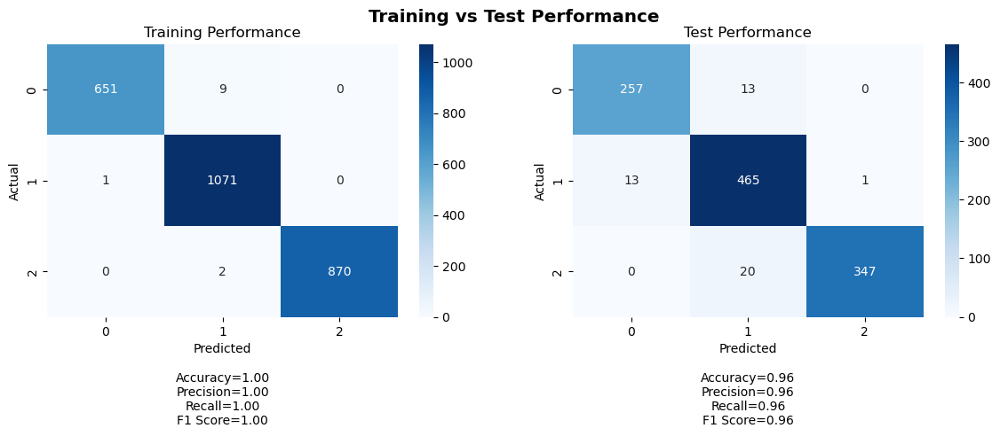

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.9954260344267671
Recall: 0.9953917050691244
F1 Score: 0.9953902531653991

Test Metrics:
Accuracy: 0.9578853046594982
Precision: 0.9589645505765492
Recall: 0.9578853046594982
F1 Score: 0.958044794157648

Training Confusion Matrix:
Class 0 - TP: 651, FP: 1, TN: 1943, FN: 9
Class 1 - TP: 1071, FP: 11, TN: 1521, FN: 1
Class 2 - TP: 870, FP: 0, TN: 1732, FN: 2

Test Confusion Matrix:
Class 0 - TP: 257, FP: 13, TN: 833, FN: 13
Class 1 - TP: 465, FP: 33, TN: 604, FN: 14
Class 2 - TP: 347, FP: 1, TN: 748, FN: 20
35/35 [==============================] - 0s 1ms/step


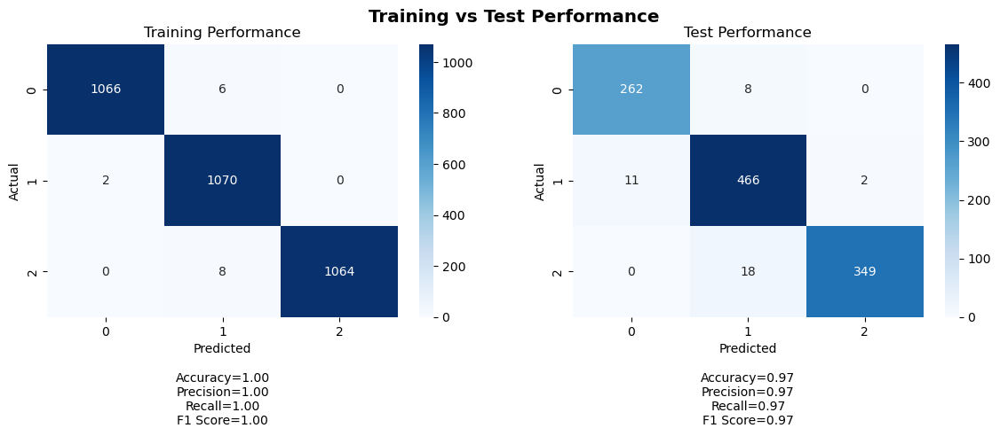

Training Metrics:
Accuracy: 0.9950248756218906
Precision: 0.9950707372242261
Recall: 0.9950248756218906
F1 Score: 0.9950317378708792

Test Metrics:
Accuracy: 0.9650537634408602
Precision: 0.9656959703401701
Recall: 0.9650537634408602
F1 Score: 0.9651350501998034

Training Confusion Matrix:
Class 0 - TP: 1066, FP: 2, TN: 2142, FN: 6
Class 1 - TP: 1070, FP: 14, TN: 2130, FN: 2
Class 2 - TP: 1064, FP: 0, TN: 2144, FN: 8

Test Confusion Matrix:
Class 0 - TP: 262, FP: 11, TN: 835, FN: 8
Class 1 - TP: 466, FP: 26, TN: 611, FN: 13
Class 2 - TP: 349, FP: 2, TN: 747, FN: 18
35/35 [==============================] - 0s 2ms/step


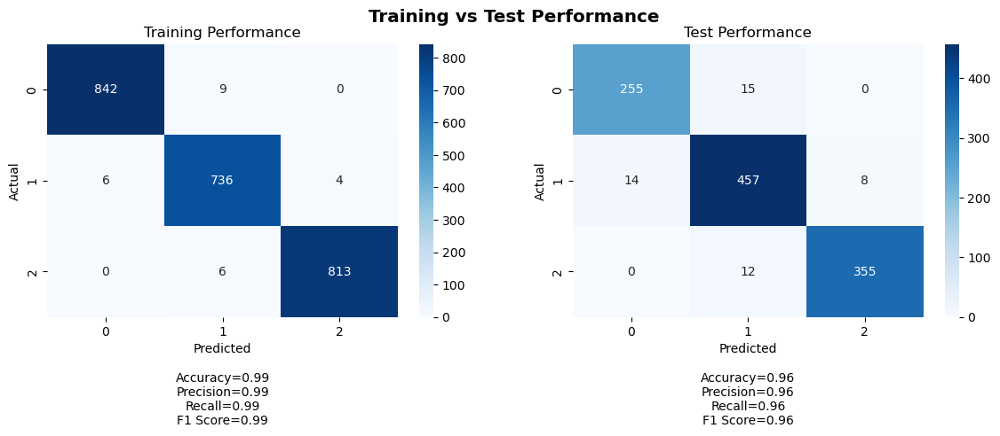

Training Metrics:
Accuracy: 0.9896523178807947
Precision: 0.9896808147795731
Recall: 0.9896523178807947
F1 Score: 0.9896615871744189

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.9562174970790295
Recall: 0.9560931899641577
F1 Score: 0.9561339699422863

Training Confusion Matrix:
Class 0 - TP: 842, FP: 6, TN: 1559, FN: 9
Class 1 - TP: 736, FP: 15, TN: 1655, FN: 10
Class 2 - TP: 813, FP: 4, TN: 1593, FN: 6

Test Confusion Matrix:
Class 0 - TP: 255, FP: 14, TN: 832, FN: 15
Class 1 - TP: 457, FP: 27, TN: 610, FN: 22
Class 2 - TP: 355, FP: 8, TN: 741, FN: 12
35/35 [==============================] - 0s 2ms/step


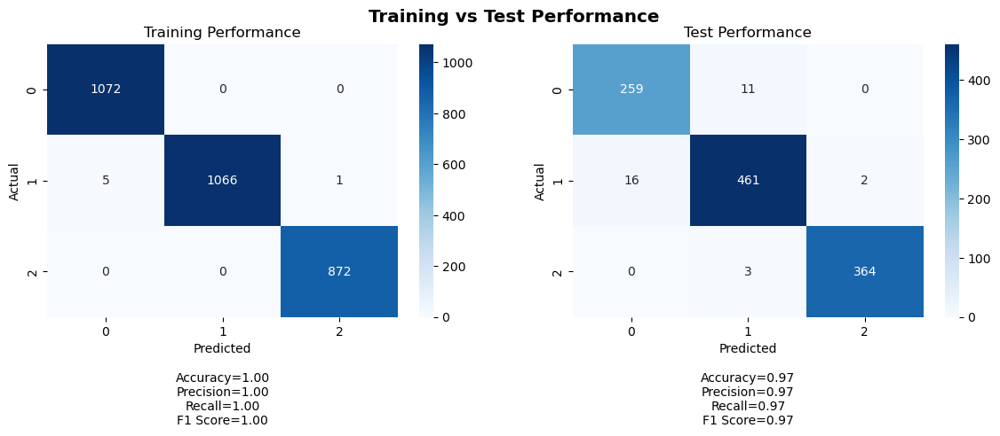

 23%|██▎       | 23/100 [1:56:56<8:21:31, 390.80s/it] 

Training Metrics:
Accuracy: 0.9980106100795756
Precision: 0.9980186863736876
Recall: 0.9980106100795756
F1 Score: 0.9980098422110767

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9714762991695275
Recall: 0.9713261648745519
F1 Score: 0.971373975462303

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 5, TN: 1939, FN: 0
Class 1 - TP: 1066, FP: 0, TN: 1944, FN: 6
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 16, TN: 830, FN: 11
Class 1 - TP: 461, FP: 14, TN: 623, FN: 18
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3
35/35 [==============================] - 0s 2ms/step


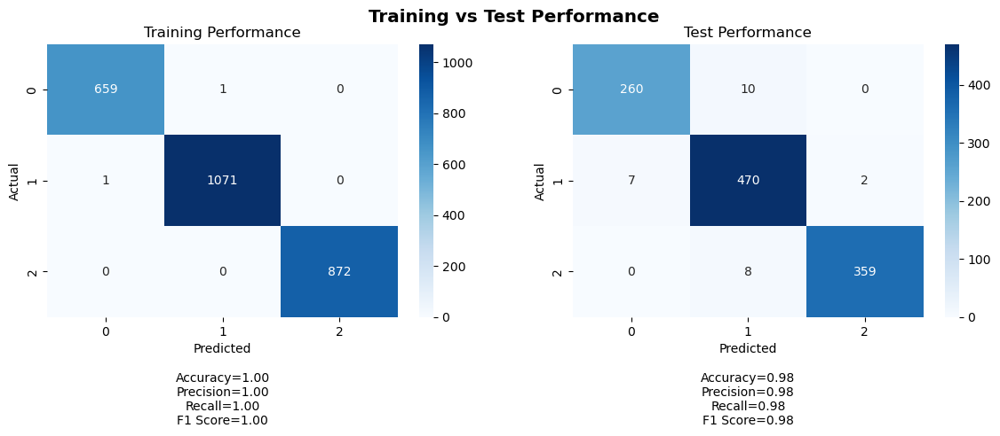

Training Metrics:
Accuracy: 0.999231950844854
Precision: 0.999231950844854
Recall: 0.999231950844854
F1 Score: 0.999231950844854

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9760036510129855
Recall: 0.9758064516129032
F1 Score: 0.9758395622796808

Training Confusion Matrix:
Class 0 - TP: 659, FP: 1, TN: 1943, FN: 1
Class 1 - TP: 1071, FP: 1, TN: 1531, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 7, TN: 839, FN: 10
Class 1 - TP: 470, FP: 18, TN: 619, FN: 9
Class 2 - TP: 359, FP: 2, TN: 747, FN: 8
35/35 [==============================] - 0s 1ms/step


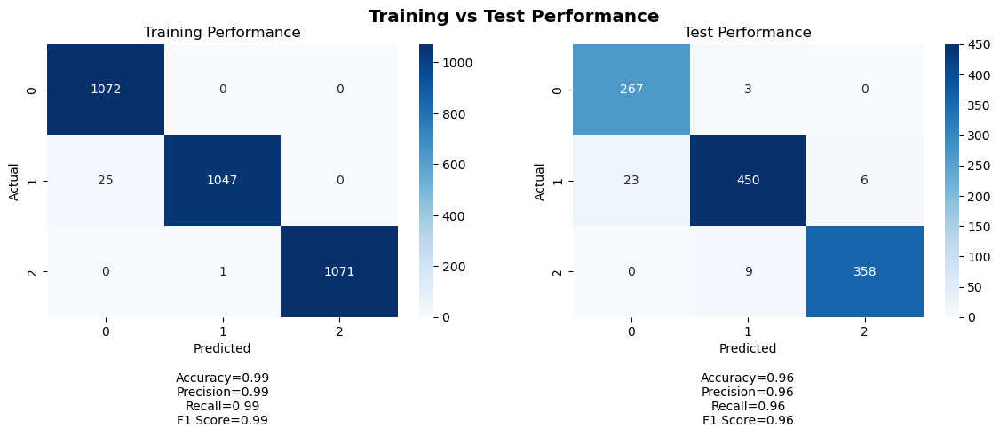

Training Metrics:
Accuracy: 0.9919154228855721
Precision: 0.9920854586067485
Recall: 0.9919154228855721
F1 Score: 0.9919143882095088

Test Metrics:
Accuracy: 0.9632616487455197
Precision: 0.9642430088759342
Recall: 0.9632616487455197
F1 Score: 0.9633182394890405

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 25, TN: 2119, FN: 0
Class 1 - TP: 1047, FP: 1, TN: 2143, FN: 25
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 267, FP: 23, TN: 823, FN: 3
Class 1 - TP: 450, FP: 12, TN: 625, FN: 29
Class 2 - TP: 358, FP: 6, TN: 743, FN: 9
35/35 [==============================] - 0s 2ms/step


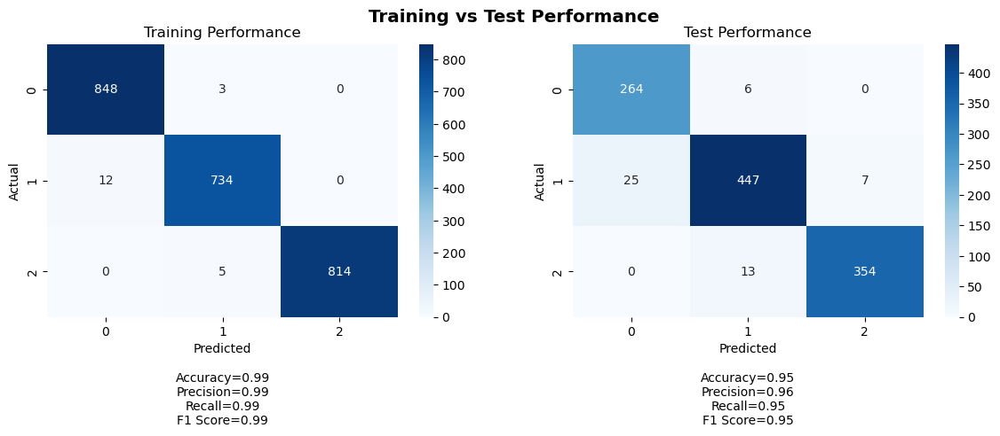

Training Metrics:
Accuracy: 0.9917218543046358
Precision: 0.9917559829100632
Recall: 0.9917218543046358
F1 Score: 0.9917238883567274

Test Metrics:
Accuracy: 0.9543010752688172
Precision: 0.9551946345942268
Recall: 0.9543010752688172
F1 Score: 0.9543849663066967

Training Confusion Matrix:
Class 0 - TP: 848, FP: 12, TN: 1553, FN: 3
Class 1 - TP: 734, FP: 8, TN: 1662, FN: 12
Class 2 - TP: 814, FP: 0, TN: 1597, FN: 5

Test Confusion Matrix:
Class 0 - TP: 264, FP: 25, TN: 821, FN: 6
Class 1 - TP: 447, FP: 19, TN: 618, FN: 32
Class 2 - TP: 354, FP: 7, TN: 742, FN: 13
35/35 [==============================] - 0s 1ms/step


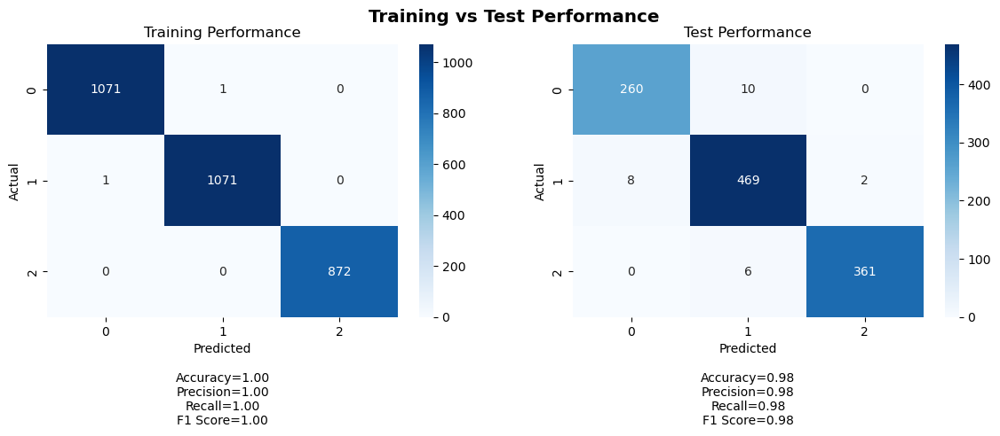

 24%|██▍       | 24/100 [1:59:27<6:43:46, 318.78s/it]

Training Metrics:
Accuracy: 0.9993368700265252
Precision: 0.9993368700265252
Recall: 0.9993368700265252
F1 Score: 0.9993368700265252

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9768066291077951
Recall: 0.9767025089605734
F1 Score: 0.9767253922990866

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 1 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 8, TN: 838, FN: 10
Class 1 - TP: 469, FP: 16, TN: 621, FN: 10
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


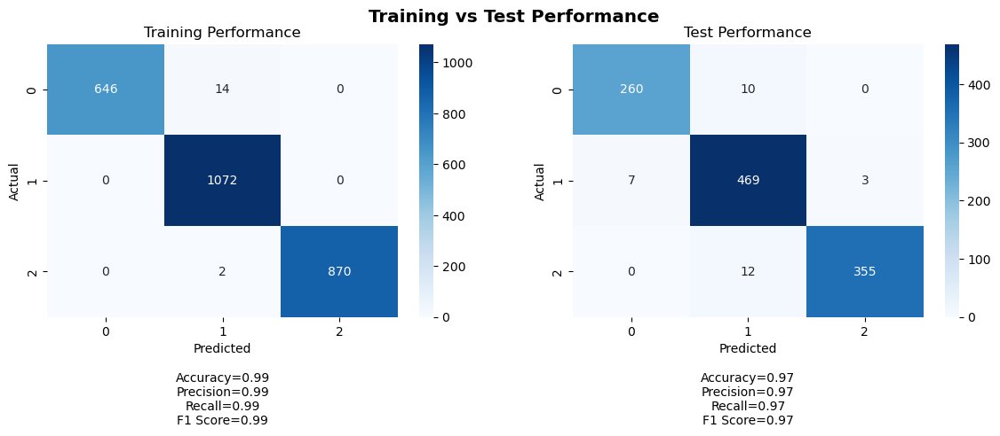

Training Metrics:
Accuracy: 0.9938556067588326
Precision: 0.9939459654829673
Recall: 0.9938556067588326
F1 Score: 0.9938491063244218

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9716698992185776
Recall: 0.9713261648745519
F1 Score: 0.9713775525649953

Training Confusion Matrix:
Class 0 - TP: 646, FP: 0, TN: 1944, FN: 14
Class 1 - TP: 1072, FP: 16, TN: 1516, FN: 0
Class 2 - TP: 870, FP: 0, TN: 1732, FN: 2

Test Confusion Matrix:
Class 0 - TP: 260, FP: 7, TN: 839, FN: 10
Class 1 - TP: 469, FP: 22, TN: 615, FN: 10
Class 2 - TP: 355, FP: 3, TN: 746, FN: 12
35/35 [==============================] - 0s 2ms/step


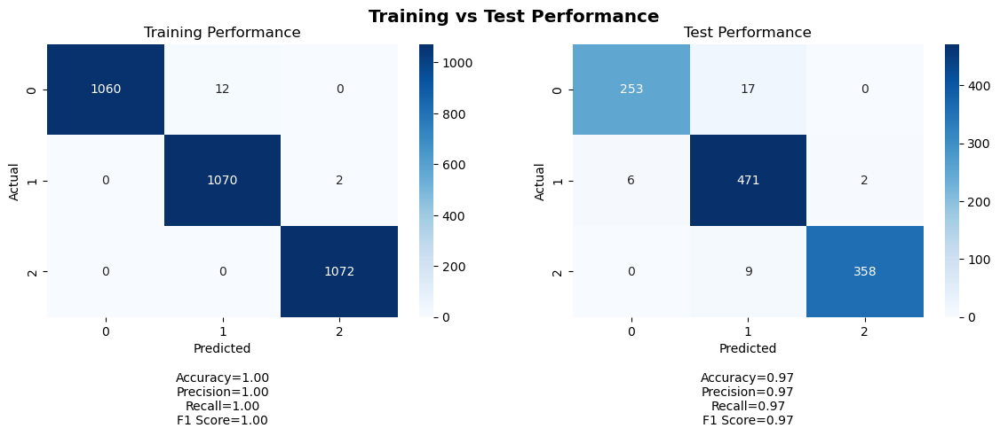

Training Metrics:
Accuracy: 0.9956467661691543
Precision: 0.9956824098647123
Recall: 0.9956467661691543
F1 Score: 0.9956466599932354

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9701146368778506
Recall: 0.9695340501792115
F1 Score: 0.9695532587781109

Training Confusion Matrix:
Class 0 - TP: 1060, FP: 0, TN: 2144, FN: 12
Class 1 - TP: 1070, FP: 12, TN: 2132, FN: 2
Class 2 - TP: 1072, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 253, FP: 6, TN: 840, FN: 17
Class 1 - TP: 471, FP: 26, TN: 611, FN: 8
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 2ms/step


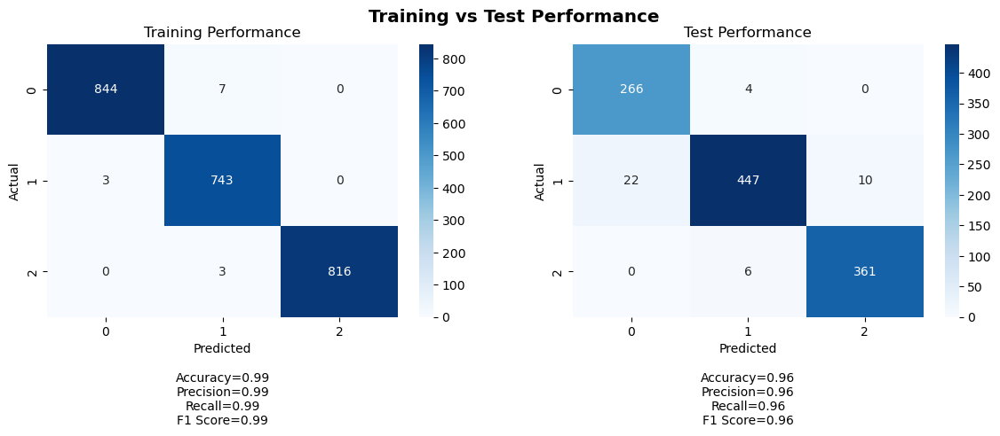

Training Metrics:
Accuracy: 0.9946192052980133
Precision: 0.9946518186410813
Recall: 0.9946192052980133
F1 Score: 0.9946257544339623

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9632629178082021
Recall: 0.9623655913978495
F1 Score: 0.9623379261010075

Training Confusion Matrix:
Class 0 - TP: 844, FP: 3, TN: 1562, FN: 7
Class 1 - TP: 743, FP: 10, TN: 1660, FN: 3
Class 2 - TP: 816, FP: 0, TN: 1597, FN: 3

Test Confusion Matrix:
Class 0 - TP: 266, FP: 22, TN: 824, FN: 4
Class 1 - TP: 447, FP: 10, TN: 627, FN: 32
Class 2 - TP: 361, FP: 10, TN: 739, FN: 6
35/35 [==============================] - 0s 1ms/step


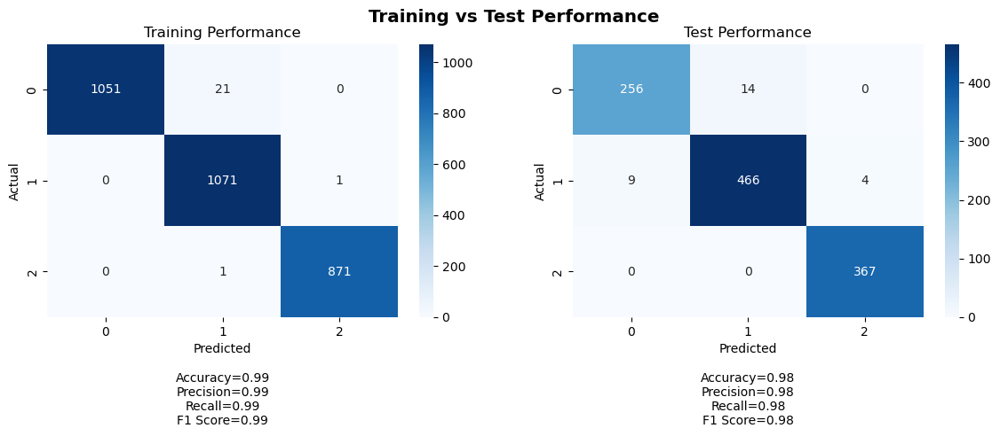

 25%|██▌       | 25/100 [2:01:40<5:29:02, 263.24s/it]

Training Metrics:
Accuracy: 0.9923740053050398
Precision: 0.9925141544577138
Recall: 0.9923740053050398
F1 Score: 0.9923765533439409

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9757190699198459
Recall: 0.9758064516129032
F1 Score: 0.975732473688709

Training Confusion Matrix:
Class 0 - TP: 1051, FP: 0, TN: 1944, FN: 21
Class 1 - TP: 1071, FP: 22, TN: 1922, FN: 1
Class 2 - TP: 871, FP: 1, TN: 2143, FN: 1

Test Confusion Matrix:
Class 0 - TP: 256, FP: 9, TN: 837, FN: 14
Class 1 - TP: 466, FP: 14, TN: 623, FN: 13
Class 2 - TP: 367, FP: 4, TN: 745, FN: 0
35/35 [==============================] - 0s 2ms/step


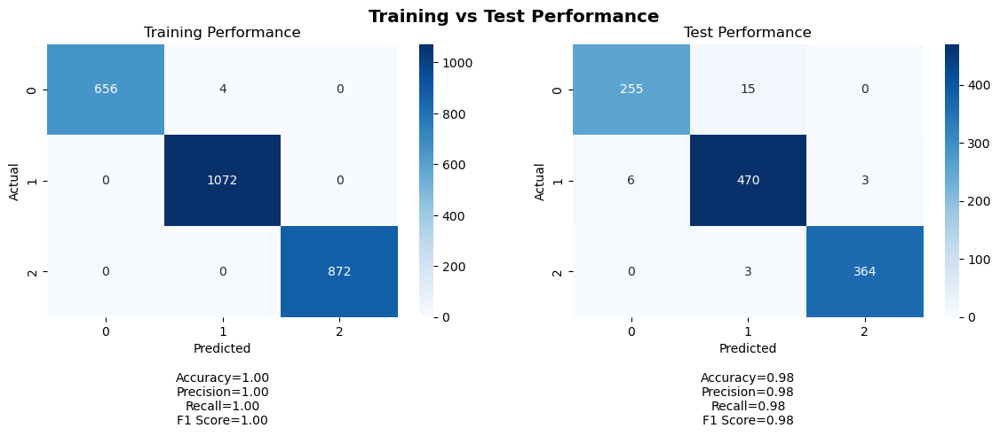

Training Metrics:
Accuracy: 0.9984639016897081
Precision: 0.9984696120923486
Recall: 0.9984639016897081
F1 Score: 0.9984629974529302

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9759185220980202
Recall: 0.9758064516129032
F1 Score: 0.975759570096019

Training Confusion Matrix:
Class 0 - TP: 656, FP: 0, TN: 1944, FN: 4
Class 1 - TP: 1072, FP: 4, TN: 1528, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 255, FP: 6, TN: 840, FN: 15
Class 1 - TP: 470, FP: 18, TN: 619, FN: 9
Class 2 - TP: 364, FP: 3, TN: 746, FN: 3
35/35 [==============================] - 0s 1ms/step


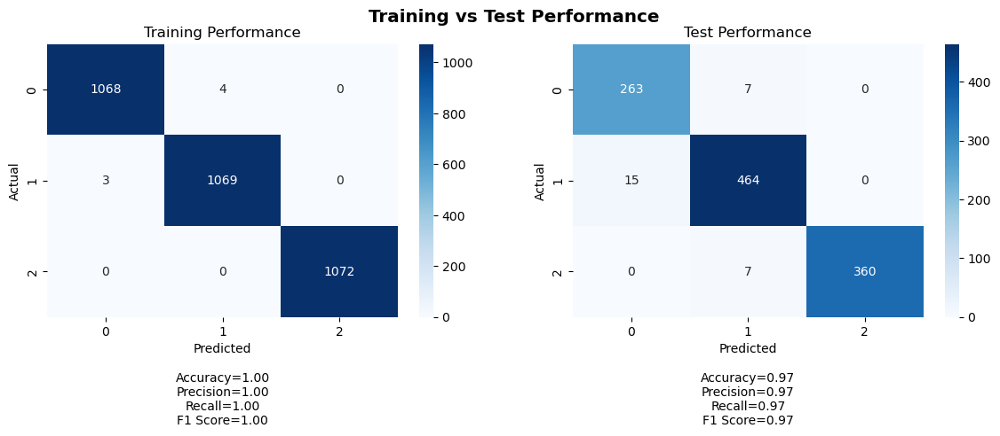

Training Metrics:
Accuracy: 0.9978233830845771
Precision: 0.9978236712516632
Recall: 0.9978233830845771
F1 Score: 0.9978233826110635

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9743748799044177
Recall: 0.9740143369175627
F1 Score: 0.9741144554560062

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 3, TN: 2141, FN: 4
Class 1 - TP: 1069, FP: 4, TN: 2140, FN: 3
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 15, TN: 831, FN: 7
Class 1 - TP: 464, FP: 14, TN: 623, FN: 15
Class 2 - TP: 360, FP: 0, TN: 749, FN: 7
35/35 [==============================] - 0s 2ms/step


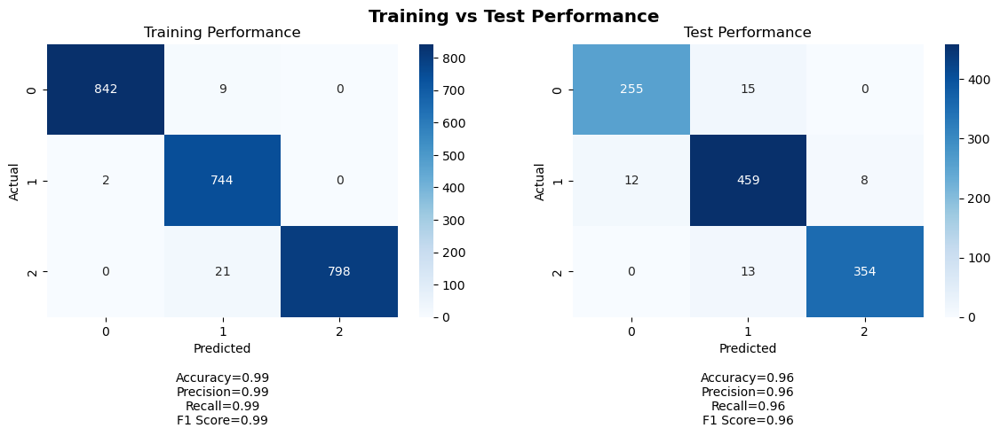

Training Metrics:
Accuracy: 0.9867549668874173
Precision: 0.9871973028311691
Recall: 0.9867549668874173
F1 Score: 0.9868111172770839

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9571815683100313
Recall: 0.956989247311828
F1 Score: 0.9570352350435989

Training Confusion Matrix:
Class 0 - TP: 842, FP: 2, TN: 1563, FN: 9
Class 1 - TP: 744, FP: 30, TN: 1640, FN: 2
Class 2 - TP: 798, FP: 0, TN: 1597, FN: 21

Test Confusion Matrix:
Class 0 - TP: 255, FP: 12, TN: 834, FN: 15
Class 1 - TP: 459, FP: 28, TN: 609, FN: 20
Class 2 - TP: 354, FP: 8, TN: 741, FN: 13
35/35 [==============================] - 0s 2ms/step


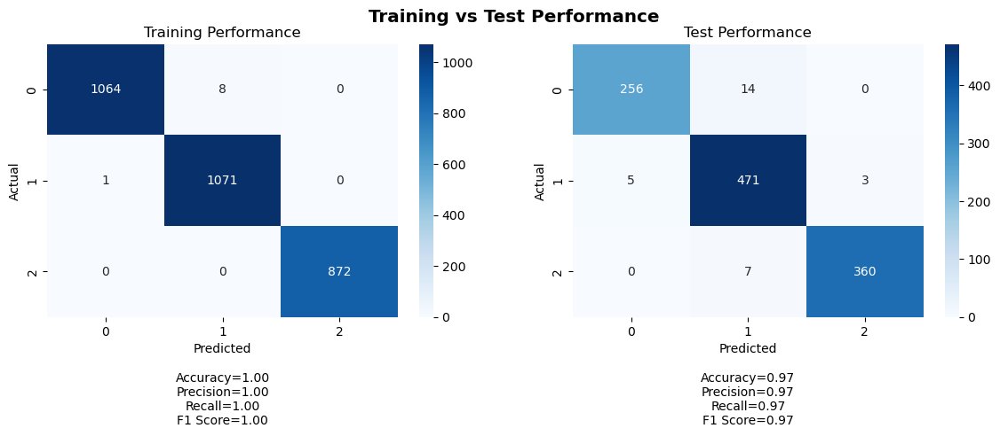

 26%|██▌       | 26/100 [2:03:55<4:36:51, 224.48s/it]

Training Metrics:
Accuracy: 0.9970159151193634
Precision: 0.9970309440110638
Recall: 0.9970159151193634
F1 Score: 0.9970158833094623

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9743274250935818
Recall: 0.9740143369175627
F1 Score: 0.9740194583814554

Training Confusion Matrix:
Class 0 - TP: 1064, FP: 1, TN: 1943, FN: 8
Class 1 - TP: 1071, FP: 8, TN: 1936, FN: 1
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 5, TN: 841, FN: 14
Class 1 - TP: 471, FP: 21, TN: 616, FN: 8
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


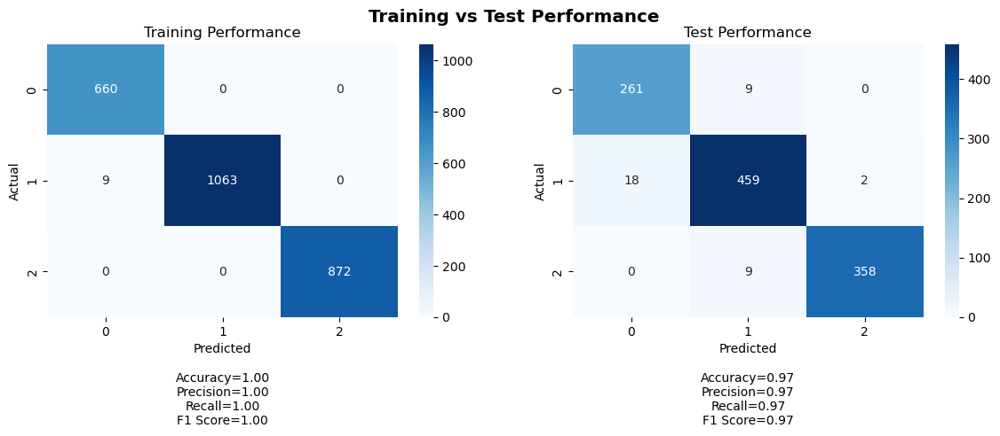

Training Metrics:
Accuracy: 0.9965437788018433
Precision: 0.9965902750511458
Recall: 0.9965437788018433
F1 Score: 0.9965481968070647

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9663676385074267
Recall: 0.9659498207885304
F1 Score: 0.9660650583892698

Training Confusion Matrix:
Class 0 - TP: 660, FP: 9, TN: 1935, FN: 0
Class 1 - TP: 1063, FP: 0, TN: 1532, FN: 9
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 18, TN: 828, FN: 9
Class 1 - TP: 459, FP: 18, TN: 619, FN: 20
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 1ms/step


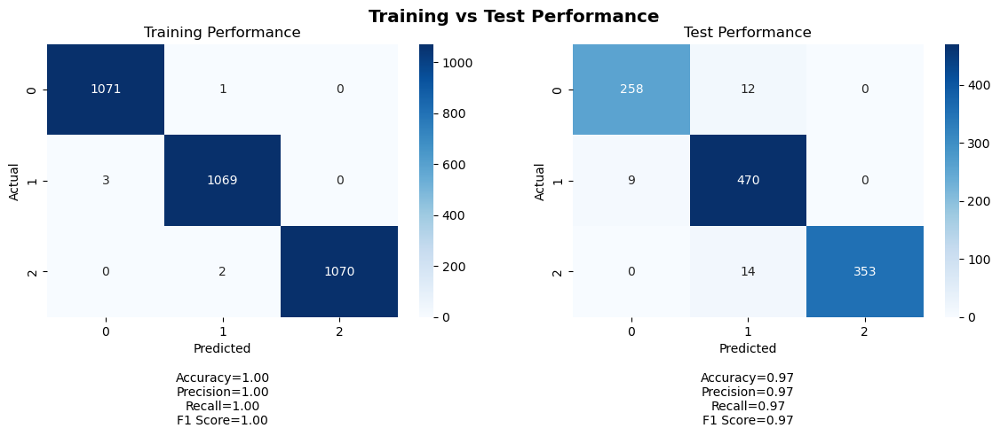

Training Metrics:
Accuracy: 0.9981343283582089
Precision: 0.9981360654826426
Recall: 0.9981343283582089
F1 Score: 0.9981346176076127

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9693458830078426
Recall: 0.9686379928315412
F1 Score: 0.9687368798173297

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 3, TN: 2141, FN: 1
Class 1 - TP: 1069, FP: 3, TN: 2141, FN: 3
Class 2 - TP: 1070, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 258, FP: 9, TN: 837, FN: 12
Class 1 - TP: 470, FP: 26, TN: 611, FN: 9
Class 2 - TP: 353, FP: 0, TN: 749, FN: 14
35/35 [==============================] - 0s 2ms/step


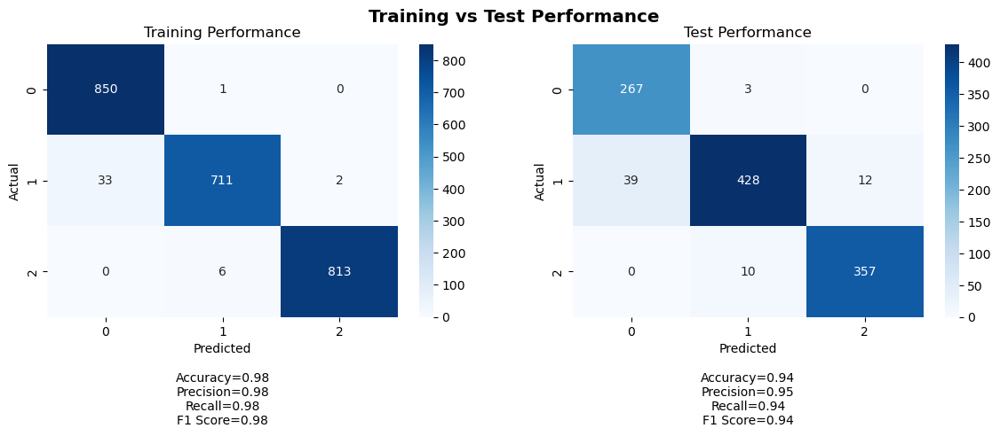

Training Metrics:
Accuracy: 0.9826158940397351
Precision: 0.9829938437655192
Recall: 0.9826158940397351
F1 Score: 0.9825754529073961

Test Metrics:
Accuracy: 0.942652329749104
Precision: 0.9458181850704557
Recall: 0.942652329749104
F1 Score: 0.9426708352812841

Training Confusion Matrix:
Class 0 - TP: 850, FP: 33, TN: 1532, FN: 1
Class 1 - TP: 711, FP: 7, TN: 1663, FN: 35
Class 2 - TP: 813, FP: 2, TN: 1595, FN: 6

Test Confusion Matrix:
Class 0 - TP: 267, FP: 39, TN: 807, FN: 3
Class 1 - TP: 428, FP: 13, TN: 624, FN: 51
Class 2 - TP: 357, FP: 12, TN: 737, FN: 10
35/35 [==============================] - 0s 1ms/step


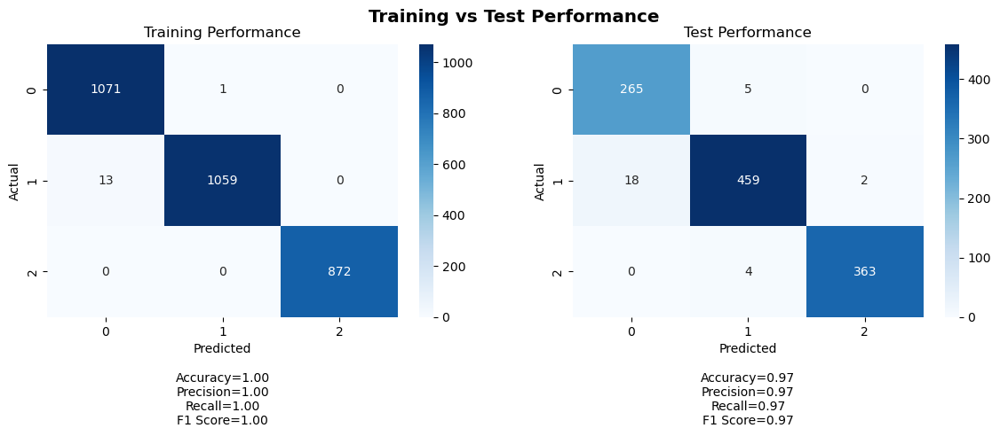

 27%|██▋       | 27/100 [2:06:14<4:01:58, 198.88s/it]

Training Metrics:
Accuracy: 0.9953580901856764
Precision: 0.9954020526141902
Recall: 0.9953580901856764
F1 Score: 0.99535794476598

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.974555876127264
Recall: 0.9740143369175627
F1 Score: 0.9740983156351347

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 13, TN: 1931, FN: 1
Class 1 - TP: 1059, FP: 1, TN: 1943, FN: 13
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 18, TN: 828, FN: 5
Class 1 - TP: 459, FP: 9, TN: 628, FN: 20
Class 2 - TP: 363, FP: 2, TN: 747, FN: 4
35/35 [==============================] - 0s 2ms/step


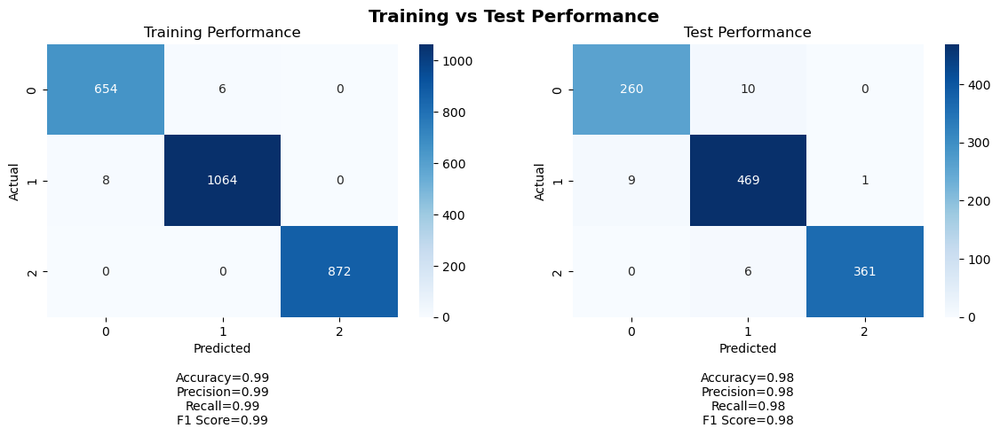

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.9946286306570733
Recall: 0.9946236559139785
F1 Score: 0.9946252127755055

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9768375167926193
Recall: 0.9767025089605734
F1 Score: 0.9767377080145083

Training Confusion Matrix:
Class 0 - TP: 654, FP: 8, TN: 1936, FN: 6
Class 1 - TP: 1064, FP: 6, TN: 1526, FN: 8
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 9, TN: 837, FN: 10
Class 1 - TP: 469, FP: 16, TN: 621, FN: 10
Class 2 - TP: 361, FP: 1, TN: 748, FN: 6
35/35 [==============================] - 0s 2ms/step


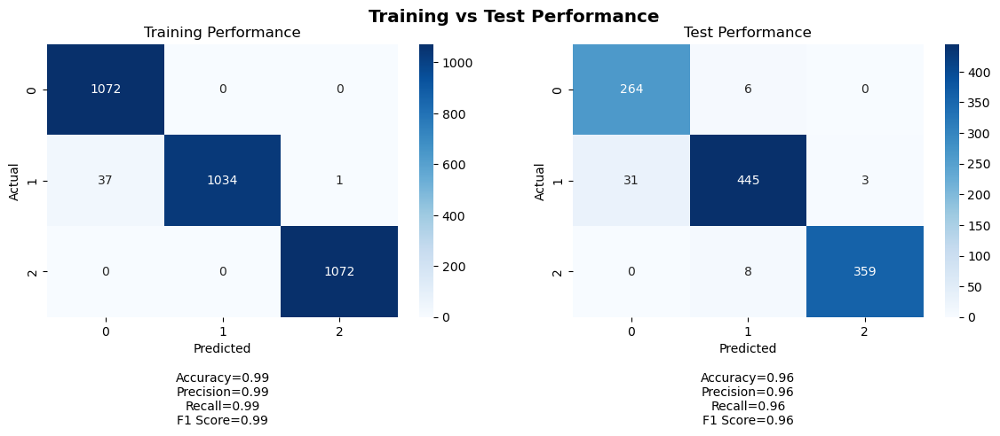

Training Metrics:
Accuracy: 0.9881840796019901
Precision: 0.988568214369651
Recall: 0.9881840796019901
F1 Score: 0.9881751399098183

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9587595523239131
Recall: 0.956989247311828
F1 Score: 0.957230406885136

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 37, TN: 2107, FN: 0
Class 1 - TP: 1034, FP: 0, TN: 2144, FN: 38
Class 2 - TP: 1072, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 31, TN: 815, FN: 6
Class 1 - TP: 445, FP: 14, TN: 623, FN: 34
Class 2 - TP: 359, FP: 3, TN: 746, FN: 8
35/35 [==============================] - 0s 2ms/step


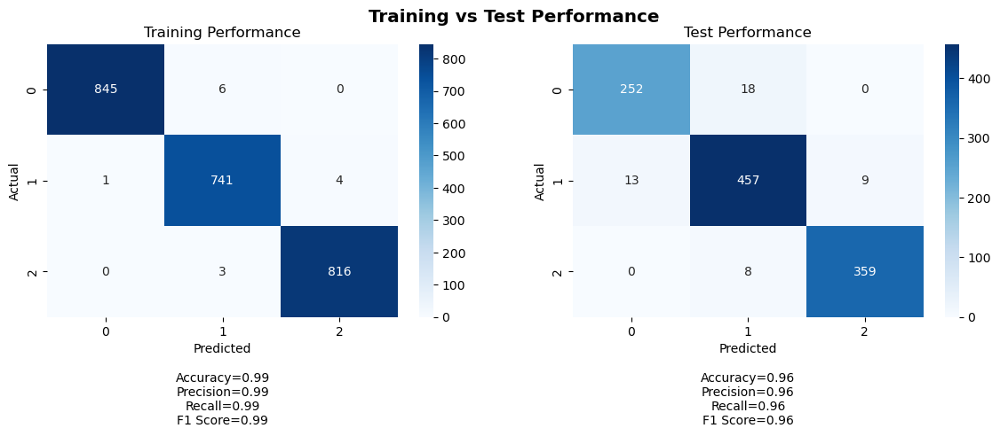

Training Metrics:
Accuracy: 0.9942052980132451
Precision: 0.9942247383622914
Recall: 0.9942052980132451
F1 Score: 0.9942096604760484

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9569843139908999
Recall: 0.956989247311828
F1 Score: 0.9569592266241562

Training Confusion Matrix:
Class 0 - TP: 845, FP: 1, TN: 1564, FN: 6
Class 1 - TP: 741, FP: 9, TN: 1661, FN: 5
Class 2 - TP: 816, FP: 4, TN: 1593, FN: 3

Test Confusion Matrix:
Class 0 - TP: 252, FP: 13, TN: 833, FN: 18
Class 1 - TP: 457, FP: 26, TN: 611, FN: 22
Class 2 - TP: 359, FP: 9, TN: 740, FN: 8
35/35 [==============================] - 0s 2ms/step


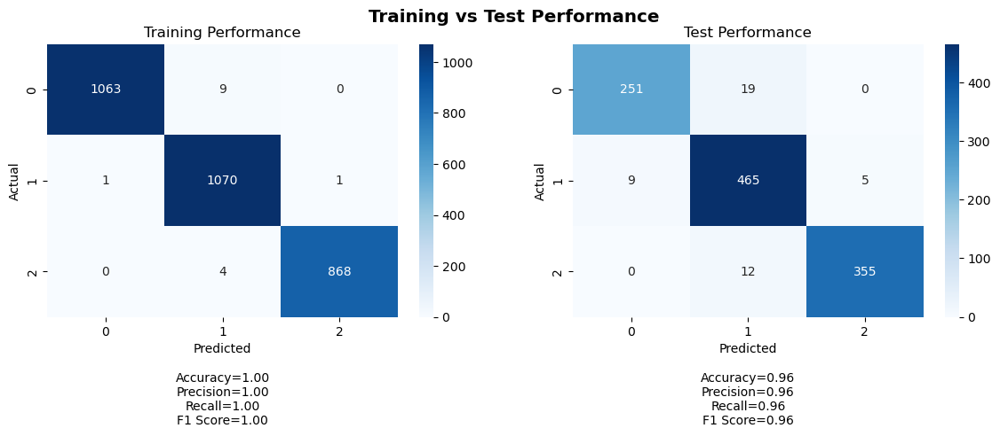

 28%|██▊       | 28/100 [2:08:49<3:43:05, 185.91s/it]

Training Metrics:
Accuracy: 0.995026525198939
Precision: 0.9950666676349252
Recall: 0.995026525198939
F1 Score: 0.9950315811014072

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9602321899028889
Recall: 0.9596774193548387
F1 Score: 0.9597189189585257

Training Confusion Matrix:
Class 0 - TP: 1063, FP: 1, TN: 1943, FN: 9
Class 1 - TP: 1070, FP: 13, TN: 1931, FN: 2
Class 2 - TP: 868, FP: 1, TN: 2143, FN: 4

Test Confusion Matrix:
Class 0 - TP: 251, FP: 9, TN: 837, FN: 19
Class 1 - TP: 465, FP: 31, TN: 606, FN: 14
Class 2 - TP: 355, FP: 5, TN: 744, FN: 12
35/35 [==============================] - 0s 2ms/step


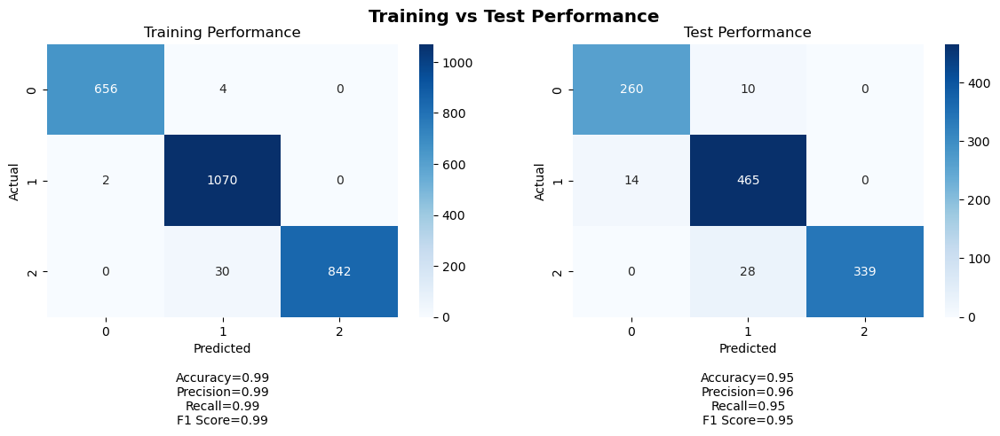

Training Metrics:
Accuracy: 0.9861751152073732
Precision: 0.986551239715446
Recall: 0.9861751152073732
F1 Score: 0.9861741973014637

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9552128143677504
Recall: 0.953405017921147
F1 Score: 0.9535559429953319

Training Confusion Matrix:
Class 0 - TP: 656, FP: 2, TN: 1942, FN: 4
Class 1 - TP: 1070, FP: 34, TN: 1498, FN: 2
Class 2 - TP: 842, FP: 0, TN: 1732, FN: 30

Test Confusion Matrix:
Class 0 - TP: 260, FP: 14, TN: 832, FN: 10
Class 1 - TP: 465, FP: 38, TN: 599, FN: 14
Class 2 - TP: 339, FP: 0, TN: 749, FN: 28
35/35 [==============================] - 0s 2ms/step


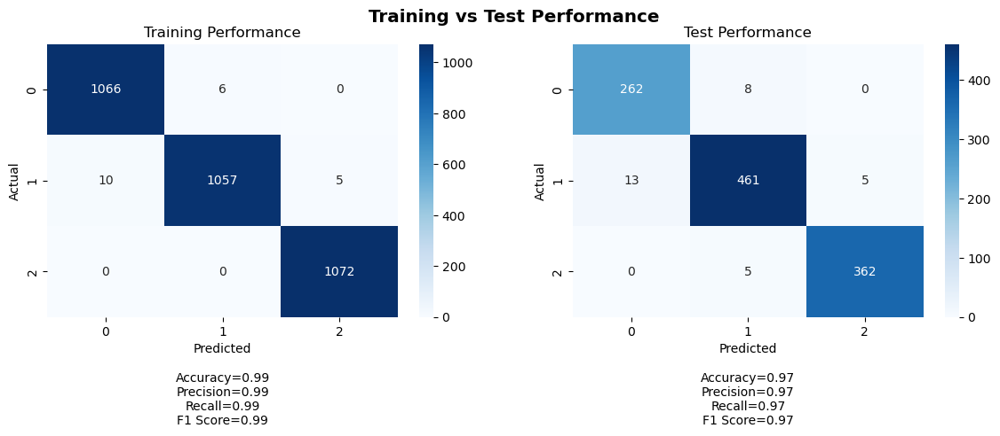

Training Metrics:
Accuracy: 0.9934701492537313
Precision: 0.9934731305115524
Recall: 0.9934701492537313
F1 Score: 0.9934628270966953

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9723111405328636
Recall: 0.9722222222222222
F1 Score: 0.972235670371524

Training Confusion Matrix:
Class 0 - TP: 1066, FP: 10, TN: 2134, FN: 6
Class 1 - TP: 1057, FP: 6, TN: 2138, FN: 15
Class 2 - TP: 1072, FP: 5, TN: 2139, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 13, TN: 833, FN: 8
Class 1 - TP: 461, FP: 13, TN: 624, FN: 18
Class 2 - TP: 362, FP: 5, TN: 744, FN: 5
35/35 [==============================] - 0s 2ms/step


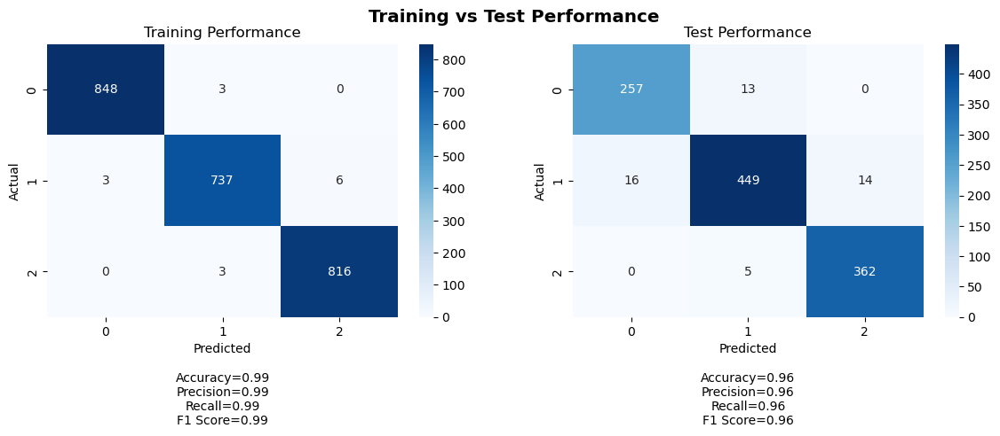

Training Metrics:
Accuracy: 0.9937913907284768
Precision: 0.9937904270280858
Recall: 0.9937913907284768
F1 Score: 0.9937885413404038

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9570326198854907
Recall: 0.956989247311828
F1 Score: 0.9568913483648419

Training Confusion Matrix:
Class 0 - TP: 848, FP: 3, TN: 1562, FN: 3
Class 1 - TP: 737, FP: 6, TN: 1664, FN: 9
Class 2 - TP: 816, FP: 6, TN: 1591, FN: 3

Test Confusion Matrix:
Class 0 - TP: 257, FP: 16, TN: 830, FN: 13
Class 1 - TP: 449, FP: 18, TN: 619, FN: 30
Class 2 - TP: 362, FP: 14, TN: 735, FN: 5
35/35 [==============================] - 0s 1ms/step


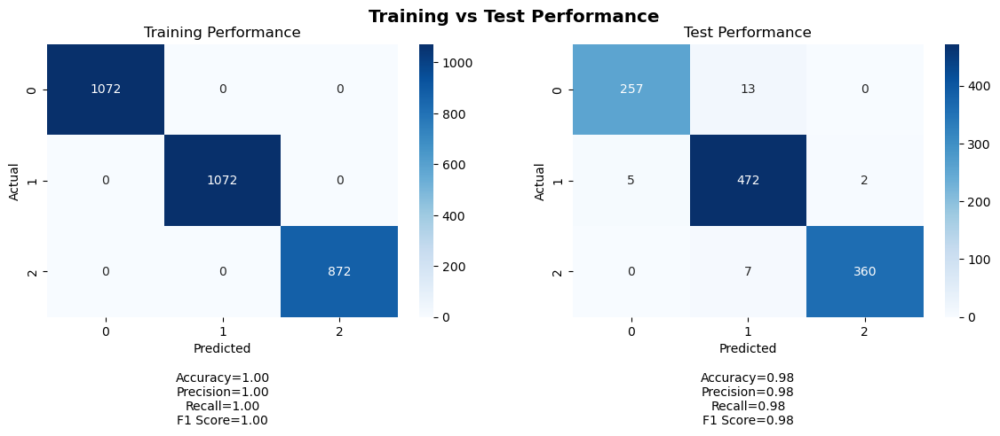

 29%|██▉       | 29/100 [2:11:10<3:24:05, 172.48s/it]

Training Metrics:
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 Score: 1.0

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9761184222396375
Recall: 0.9758064516129032
F1 Score: 0.9758194793550261

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 0, TN: 1944, FN: 0
Class 1 - TP: 1072, FP: 0, TN: 1944, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 5, TN: 841, FN: 13
Class 1 - TP: 472, FP: 20, TN: 617, FN: 7
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


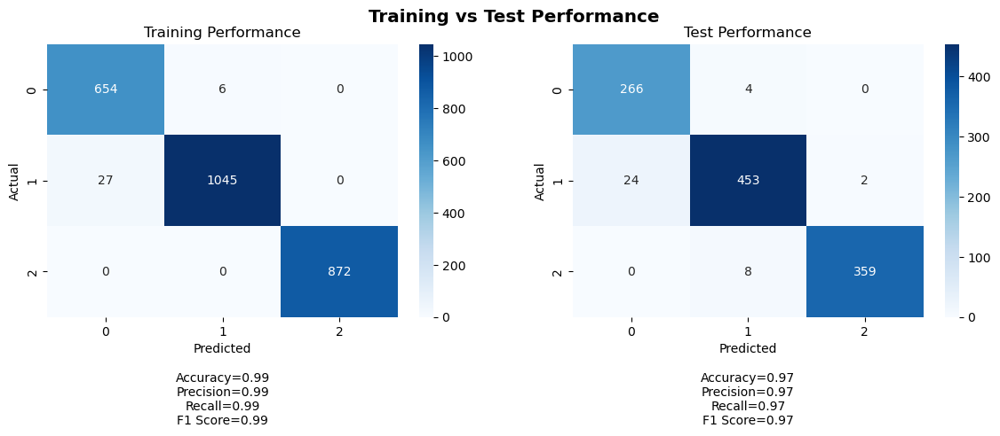

Training Metrics:
Accuracy: 0.9873271889400922
Precision: 0.9876008883624874
Recall: 0.9873271889400922
F1 Score: 0.9873637391806881

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9670794275035686
Recall: 0.9659498207885304
F1 Score: 0.9661084332865362

Training Confusion Matrix:
Class 0 - TP: 654, FP: 27, TN: 1917, FN: 6
Class 1 - TP: 1045, FP: 6, TN: 1526, FN: 27
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 24, TN: 822, FN: 4
Class 1 - TP: 453, FP: 12, TN: 625, FN: 26
Class 2 - TP: 359, FP: 2, TN: 747, FN: 8
35/35 [==============================] - 0s 2ms/step


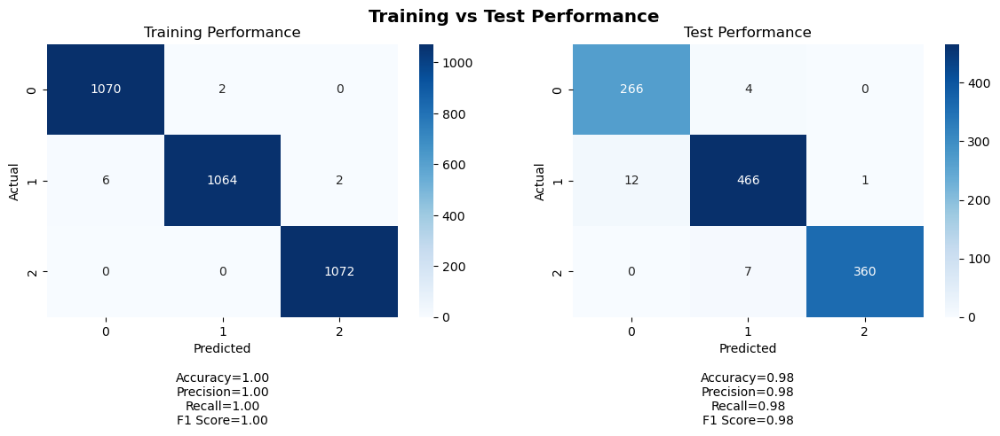

Training Metrics:
Accuracy: 0.9968905472636815
Precision: 0.9968951406069193
Recall: 0.9968905472636815
F1 Score: 0.996888790096578

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9787478330189076
Recall: 0.978494623655914
F1 Score: 0.9785472371735576

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 6, TN: 2138, FN: 2
Class 1 - TP: 1064, FP: 2, TN: 2142, FN: 8
Class 2 - TP: 1072, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 12, TN: 834, FN: 4
Class 1 - TP: 466, FP: 11, TN: 626, FN: 13
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 2ms/step


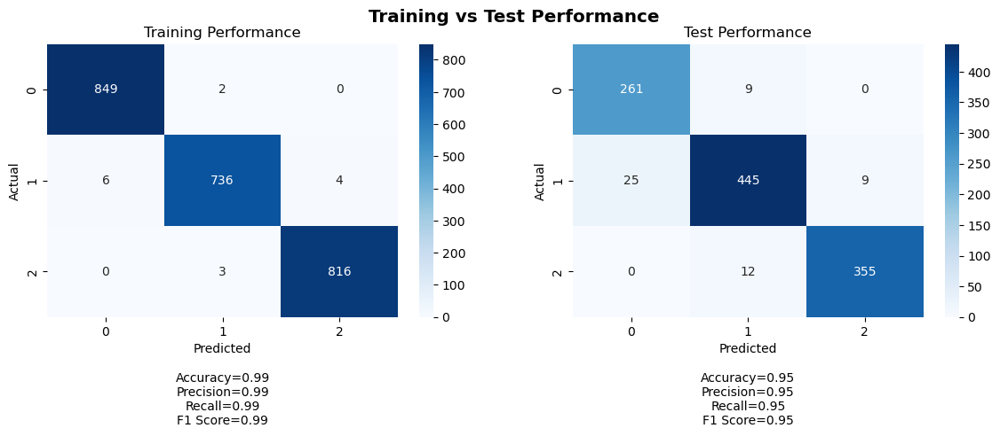

Training Metrics:
Accuracy: 0.9937913907284768
Precision: 0.9937910637552095
Recall: 0.9937913907284768
F1 Score: 0.9937857183572533

Test Metrics:
Accuracy: 0.9507168458781362
Precision: 0.951378663677916
Recall: 0.9507168458781362
F1 Score: 0.9507776076160572

Training Confusion Matrix:
Class 0 - TP: 849, FP: 6, TN: 1559, FN: 2
Class 1 - TP: 736, FP: 5, TN: 1665, FN: 10
Class 2 - TP: 816, FP: 4, TN: 1593, FN: 3

Test Confusion Matrix:
Class 0 - TP: 261, FP: 25, TN: 821, FN: 9
Class 1 - TP: 445, FP: 21, TN: 616, FN: 34
Class 2 - TP: 355, FP: 9, TN: 740, FN: 12
35/35 [==============================] - 0s 2ms/step


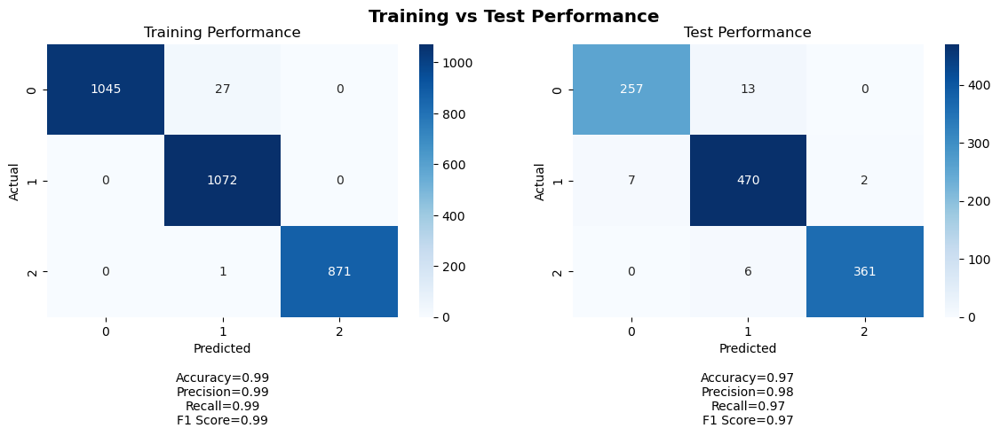

 30%|███       | 30/100 [2:13:33<3:10:49, 163.57s/it]

Training Metrics:
Accuracy: 0.9907161803713528
Precision: 0.990952495780082
Recall: 0.9907161803713528
F1 Score: 0.9907188376491396

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9750962532084908
Recall: 0.974910394265233
F1 Score: 0.9749196691222156

Training Confusion Matrix:
Class 0 - TP: 1045, FP: 0, TN: 1944, FN: 27
Class 1 - TP: 1072, FP: 28, TN: 1916, FN: 0
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 257, FP: 7, TN: 839, FN: 13
Class 1 - TP: 470, FP: 19, TN: 618, FN: 9
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


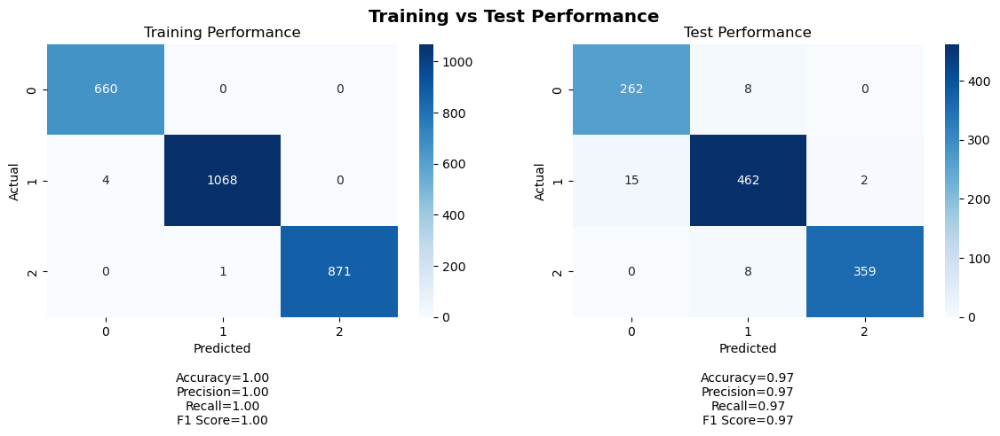

Training Metrics:
Accuracy: 0.9980798771121352
Precision: 0.9980880530047838
Recall: 0.9980798771121352
F1 Score: 0.9980807420884698

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9707099888631399
Recall: 0.9704301075268817
F1 Score: 0.9705096023220925

Training Confusion Matrix:
Class 0 - TP: 660, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1068, FP: 1, TN: 1531, FN: 4
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 262, FP: 15, TN: 831, FN: 8
Class 1 - TP: 462, FP: 16, TN: 621, FN: 17
Class 2 - TP: 359, FP: 2, TN: 747, FN: 8
35/35 [==============================] - 0s 2ms/step


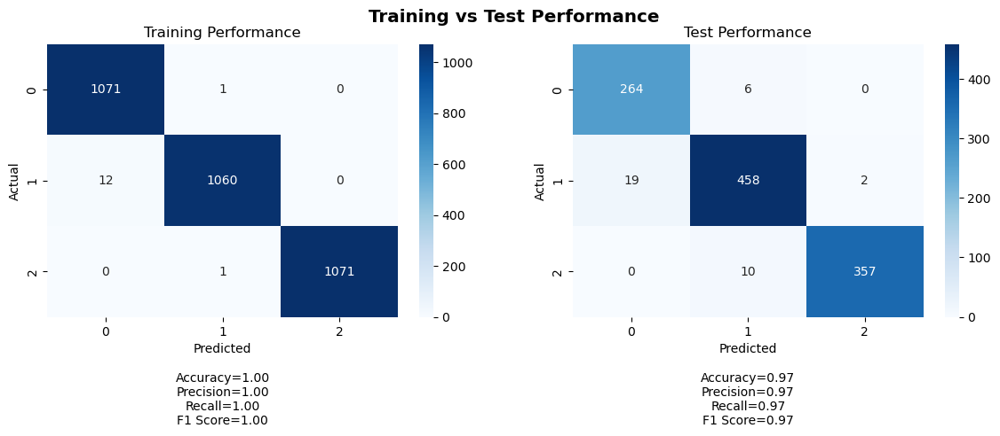

Training Metrics:
Accuracy: 0.9956467661691543
Precision: 0.9956788094728842
Recall: 0.9956467661691543
F1 Score: 0.9956468106614478

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9674367803790334
Recall: 0.9668458781362007
F1 Score: 0.9669629696287315

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 12, TN: 2132, FN: 1
Class 1 - TP: 1060, FP: 2, TN: 2142, FN: 12
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 264, FP: 19, TN: 827, FN: 6
Class 1 - TP: 458, FP: 16, TN: 621, FN: 21
Class 2 - TP: 357, FP: 2, TN: 747, FN: 10
35/35 [==============================] - 0s 2ms/step


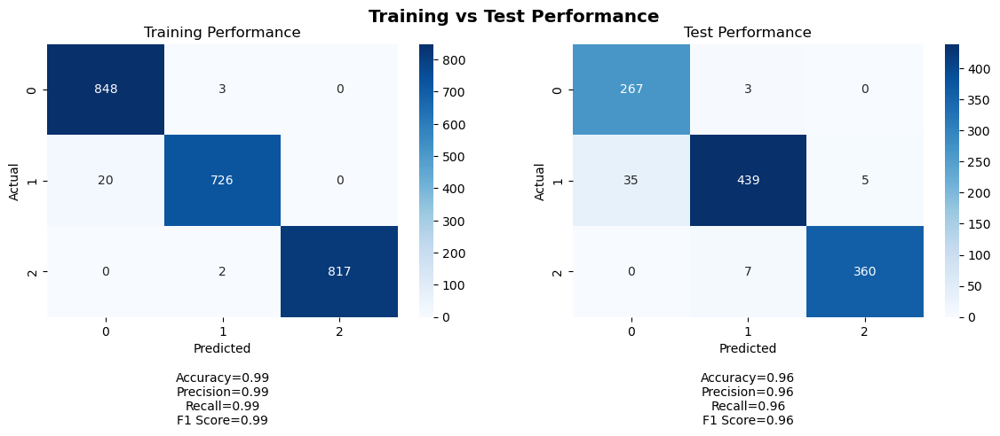

Training Metrics:
Accuracy: 0.9896523178807947
Precision: 0.989771980914701
Recall: 0.9896523178807947
F1 Score: 0.9896463410203096

Test Metrics:
Accuracy: 0.9551971326164874
Precision: 0.9578970076734656
Recall: 0.9551971326164874
F1 Score: 0.9554107114382989

Training Confusion Matrix:
Class 0 - TP: 848, FP: 20, TN: 1545, FN: 3
Class 1 - TP: 726, FP: 5, TN: 1665, FN: 20
Class 2 - TP: 817, FP: 0, TN: 1597, FN: 2

Test Confusion Matrix:
Class 0 - TP: 267, FP: 35, TN: 811, FN: 3
Class 1 - TP: 439, FP: 10, TN: 627, FN: 40
Class 2 - TP: 360, FP: 5, TN: 744, FN: 7
35/35 [==============================] - 0s 2ms/step


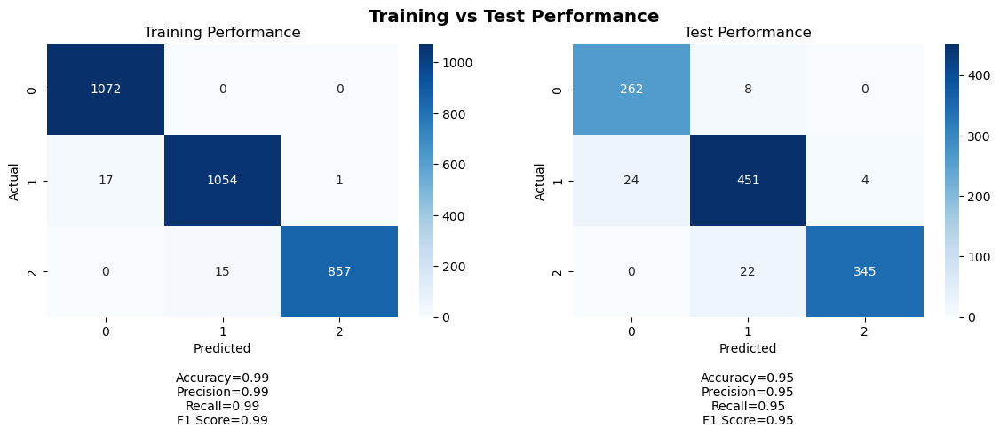

 31%|███       | 31/100 [2:16:00<3:02:17, 158.52s/it]

Training Metrics:
Accuracy: 0.9890583554376657
Precision: 0.9891269789956795
Recall: 0.9890583554376657
F1 Score: 0.9890513949832085

Test Metrics:
Accuracy: 0.9480286738351255
Precision: 0.9491586861491658
Recall: 0.9480286738351255
F1 Score: 0.9482025382427284

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 17, TN: 1927, FN: 0
Class 1 - TP: 1054, FP: 15, TN: 1929, FN: 18
Class 2 - TP: 857, FP: 1, TN: 2143, FN: 15

Test Confusion Matrix:
Class 0 - TP: 262, FP: 24, TN: 822, FN: 8
Class 1 - TP: 451, FP: 30, TN: 607, FN: 28
Class 2 - TP: 345, FP: 4, TN: 745, FN: 22
35/35 [==============================] - 0s 2ms/step


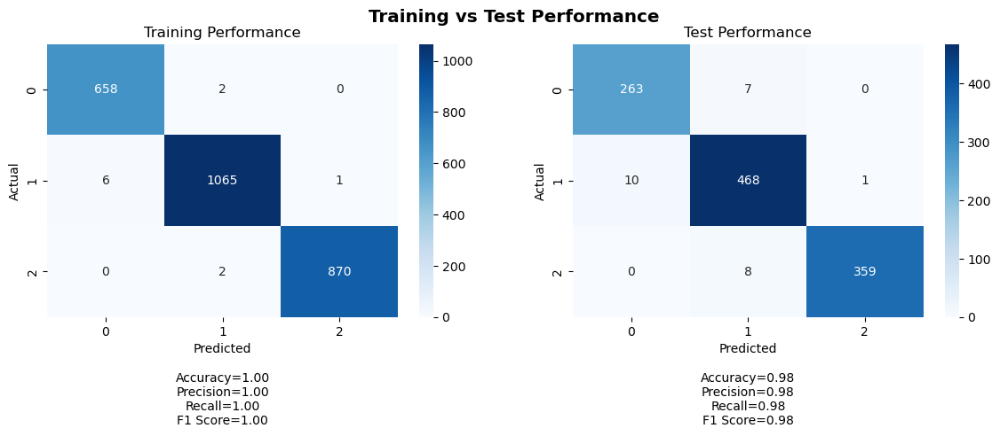

Training Metrics:
Accuracy: 0.9957757296466974
Precision: 0.9957848583058169
Recall: 0.9957757296466974
F1 Score: 0.9957770803870298

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9768948649354214
Recall: 0.9767025089605734
F1 Score: 0.9767541994908068

Training Confusion Matrix:
Class 0 - TP: 658, FP: 6, TN: 1938, FN: 2
Class 1 - TP: 1065, FP: 4, TN: 1528, FN: 7
Class 2 - TP: 870, FP: 1, TN: 1731, FN: 2

Test Confusion Matrix:
Class 0 - TP: 263, FP: 10, TN: 836, FN: 7
Class 1 - TP: 468, FP: 15, TN: 622, FN: 11
Class 2 - TP: 359, FP: 1, TN: 748, FN: 8
35/35 [==============================] - 0s 2ms/step


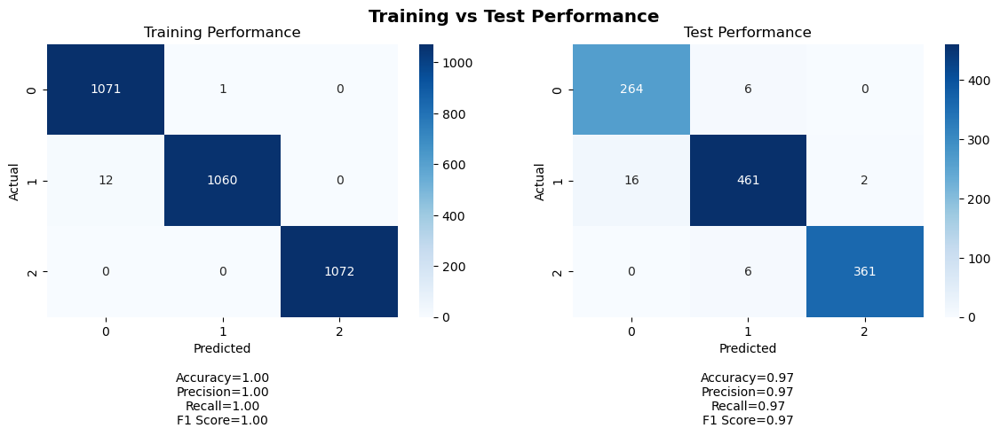

Training Metrics:
Accuracy: 0.9959577114427861
Precision: 0.9959923868404083
Recall: 0.9959577114427861
F1 Score: 0.9959576050347194

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9734741667838578
Recall: 0.9731182795698925
F1 Score: 0.9731931401224505

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 12, TN: 2132, FN: 1
Class 1 - TP: 1060, FP: 1, TN: 2143, FN: 12
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 16, TN: 830, FN: 6
Class 1 - TP: 461, FP: 12, TN: 625, FN: 18
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


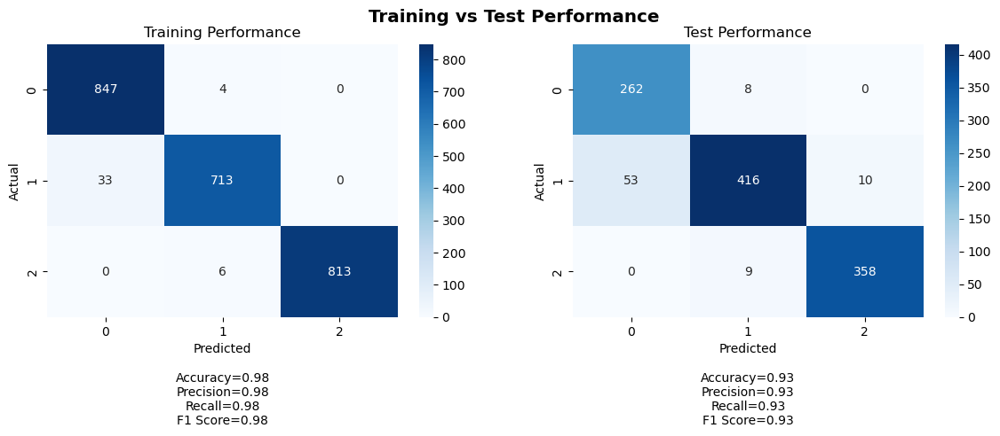

Training Metrics:
Accuracy: 0.9822019867549668
Precision: 0.9825204391768111
Recall: 0.9822019867549668
F1 Score: 0.9821863756157763

Test Metrics:
Accuracy: 0.9283154121863799
Precision: 0.9335059120658911
Recall: 0.9283154121863799
F1 Score: 0.9286214472729146

Training Confusion Matrix:
Class 0 - TP: 847, FP: 33, TN: 1532, FN: 4
Class 1 - TP: 713, FP: 10, TN: 1660, FN: 33
Class 2 - TP: 813, FP: 0, TN: 1597, FN: 6

Test Confusion Matrix:
Class 0 - TP: 262, FP: 53, TN: 793, FN: 8
Class 1 - TP: 416, FP: 17, TN: 620, FN: 63
Class 2 - TP: 358, FP: 10, TN: 739, FN: 9
35/35 [==============================] - 0s 1ms/step


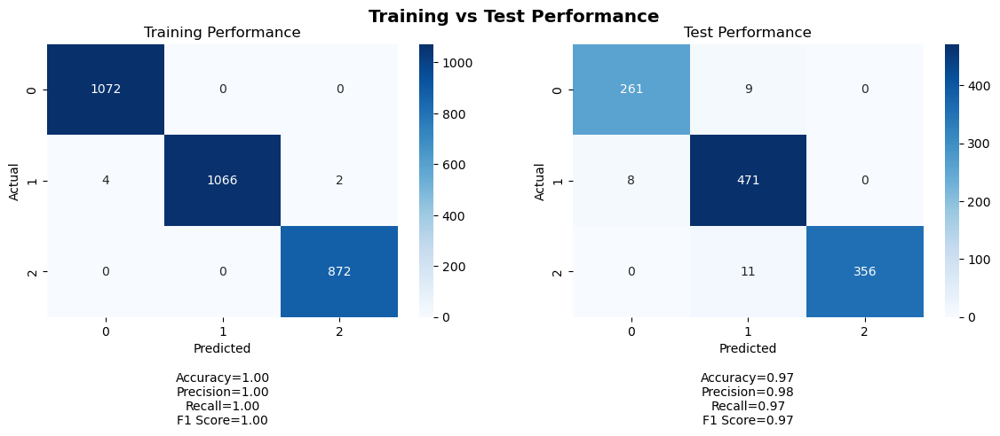

 32%|███▏      | 32/100 [2:18:31<2:56:57, 156.14s/it]

Training Metrics:
Accuracy: 0.9980106100795756
Precision: 0.9980170578738444
Recall: 0.9980106100795756
F1 Score: 0.9980094332847821

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9753217370911472
Recall: 0.974910394265233
F1 Score: 0.9749764756426056

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1066, FP: 0, TN: 1944, FN: 6
Class 2 - TP: 872, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 8, TN: 838, FN: 9
Class 1 - TP: 471, FP: 20, TN: 617, FN: 8
Class 2 - TP: 356, FP: 0, TN: 749, FN: 11
35/35 [==============================] - 0s 2ms/step


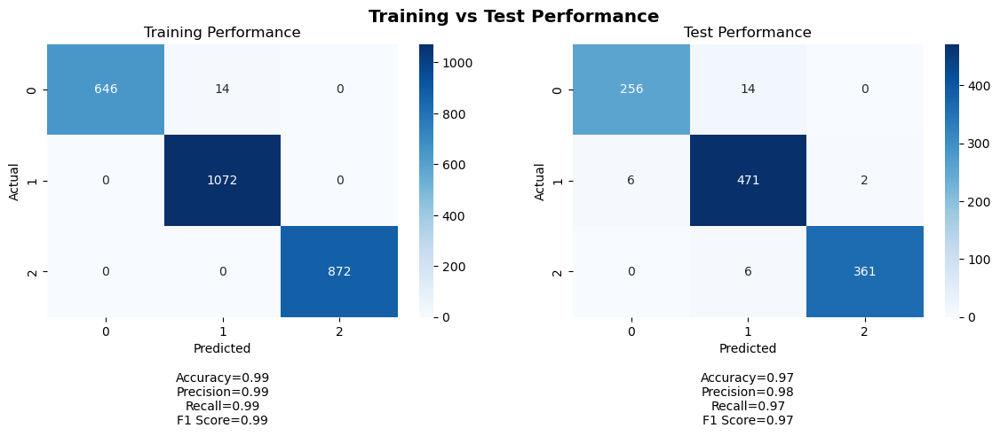

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.9946929642171133
Recall: 0.9946236559139785
F1 Score: 0.9946122788533285

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9751644746382694
Recall: 0.974910394265233
F1 Score: 0.9749112026238529

Training Confusion Matrix:
Class 0 - TP: 646, FP: 0, TN: 1944, FN: 14
Class 1 - TP: 1072, FP: 14, TN: 1518, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 6, TN: 840, FN: 14
Class 1 - TP: 471, FP: 20, TN: 617, FN: 8
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


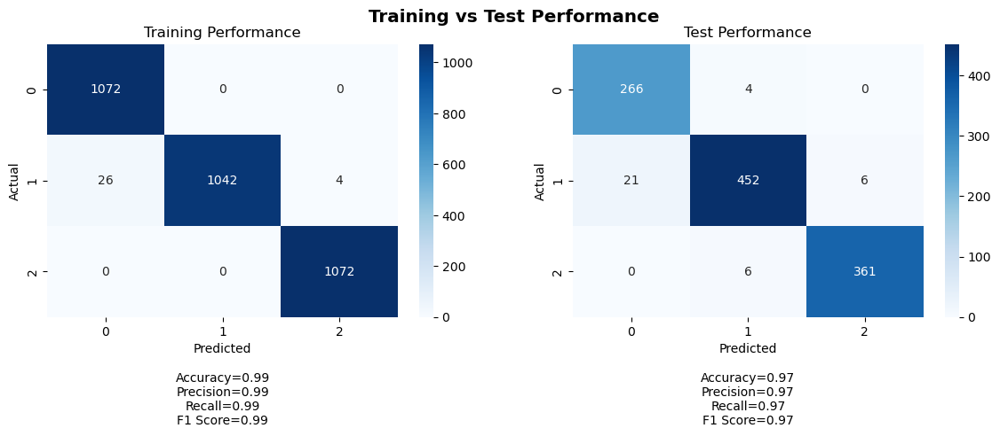

Training Metrics:
Accuracy: 0.9906716417910447
Precision: 0.9908677035863337
Recall: 0.9906716417910447
F1 Score: 0.9906550429601536

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.96763076798482
Recall: 0.9668458781362007
F1 Score: 0.9668882519381253

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 26, TN: 2118, FN: 0
Class 1 - TP: 1042, FP: 0, TN: 2144, FN: 30
Class 2 - TP: 1072, FP: 4, TN: 2140, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 21, TN: 825, FN: 4
Class 1 - TP: 452, FP: 10, TN: 627, FN: 27
Class 2 - TP: 361, FP: 6, TN: 743, FN: 6
35/35 [==============================] - 0s 2ms/step


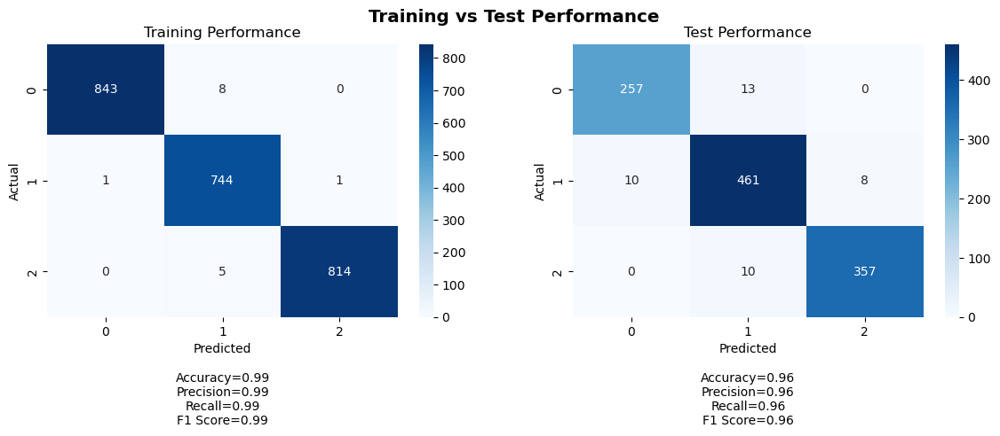

Training Metrics:
Accuracy: 0.9937913907284768
Precision: 0.9938641149637367
Recall: 0.9937913907284768
F1 Score: 0.9938033783971507

Test Metrics:
Accuracy: 0.9632616487455197
Precision: 0.9633345951064382
Recall: 0.9632616487455197
F1 Score: 0.9632774213619396

Training Confusion Matrix:
Class 0 - TP: 843, FP: 1, TN: 1564, FN: 8
Class 1 - TP: 744, FP: 13, TN: 1657, FN: 2
Class 2 - TP: 814, FP: 1, TN: 1596, FN: 5

Test Confusion Matrix:
Class 0 - TP: 257, FP: 10, TN: 836, FN: 13
Class 1 - TP: 461, FP: 23, TN: 614, FN: 18
Class 2 - TP: 357, FP: 8, TN: 741, FN: 10
35/35 [==============================] - 0s 2ms/step


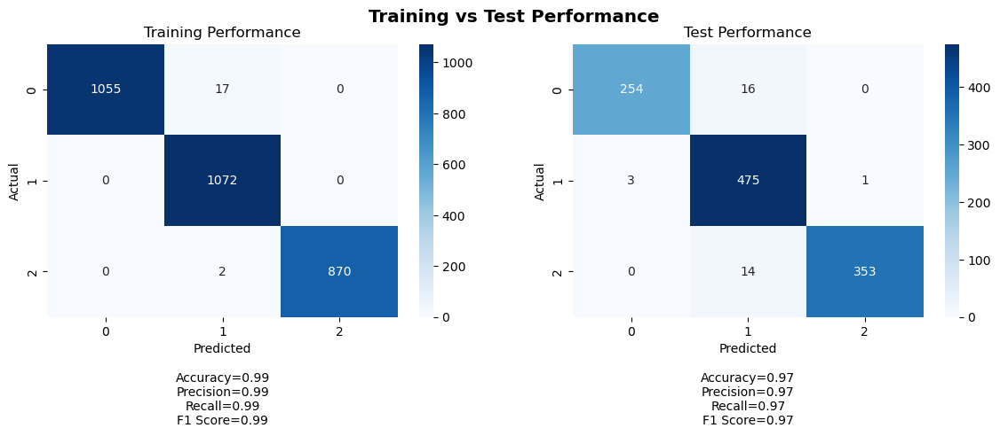

 33%|███▎      | 33/100 [2:20:56<2:50:45, 152.91s/it]

Training Metrics:
Accuracy: 0.9937002652519894
Precision: 0.9938099764895807
Recall: 0.9937002652519894
F1 Score: 0.9937050280993839

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9707491759129401
Recall: 0.9695340501792115
F1 Score: 0.9696053878064561

Training Confusion Matrix:
Class 0 - TP: 1055, FP: 0, TN: 1944, FN: 17
Class 1 - TP: 1072, FP: 19, TN: 1925, FN: 0
Class 2 - TP: 870, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 254, FP: 3, TN: 843, FN: 16
Class 1 - TP: 475, FP: 30, TN: 607, FN: 4
Class 2 - TP: 353, FP: 1, TN: 748, FN: 14
35/35 [==============================] - 0s 1ms/step


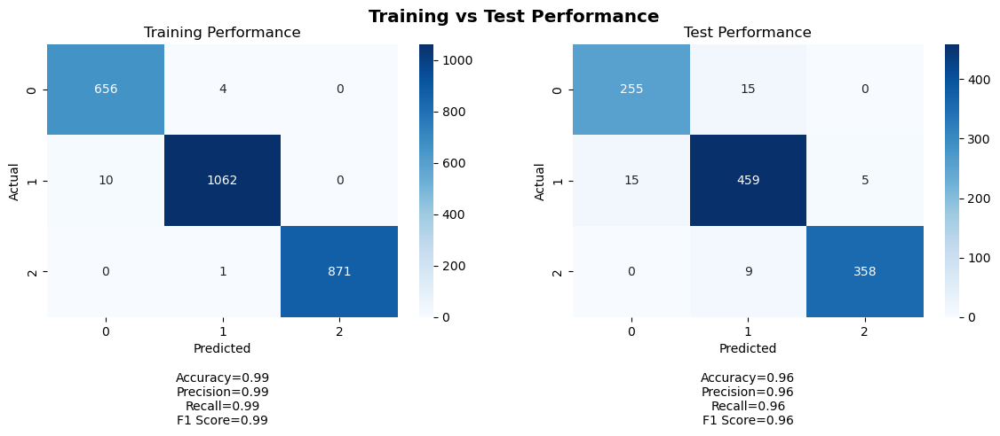

Training Metrics:
Accuracy: 0.9942396313364056
Precision: 0.9942652303809603
Recall: 0.9942396313364056
F1 Score: 0.9942449523001574

Test Metrics:
Accuracy: 0.9605734767025089
Precision: 0.9607022055064897
Recall: 0.9605734767025089
F1 Score: 0.960621075203488

Training Confusion Matrix:
Class 0 - TP: 656, FP: 10, TN: 1934, FN: 4
Class 1 - TP: 1062, FP: 5, TN: 1527, FN: 10
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 255, FP: 15, TN: 831, FN: 15
Class 1 - TP: 459, FP: 24, TN: 613, FN: 20
Class 2 - TP: 358, FP: 5, TN: 744, FN: 9
35/35 [==============================] - 0s 1ms/step


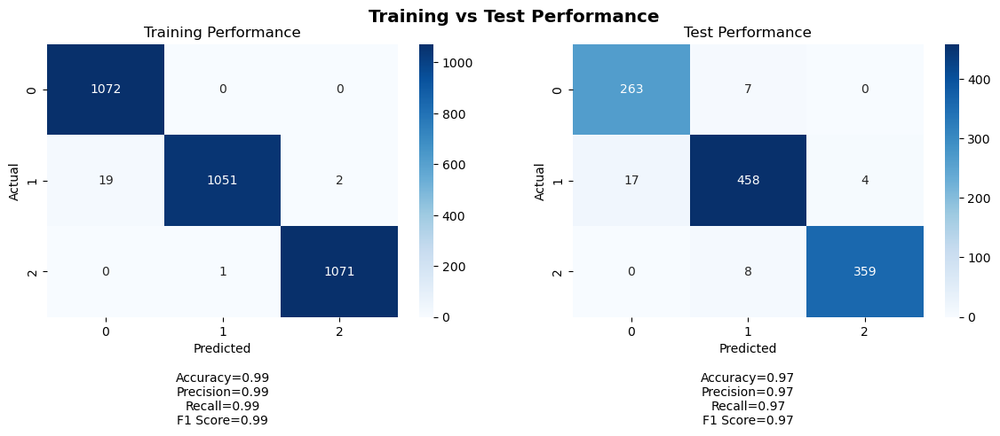

Training Metrics:
Accuracy: 0.9931592039800995
Precision: 0.9932567604535542
Recall: 0.9931592039800995
F1 Score: 0.9931531623320335

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9680759774916836
Recall: 0.967741935483871
F1 Score: 0.9678063259208798

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 19, TN: 2125, FN: 0
Class 1 - TP: 1051, FP: 1, TN: 2143, FN: 21
Class 2 - TP: 1071, FP: 2, TN: 2142, FN: 1

Test Confusion Matrix:
Class 0 - TP: 263, FP: 17, TN: 829, FN: 7
Class 1 - TP: 458, FP: 15, TN: 622, FN: 21
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 2ms/step


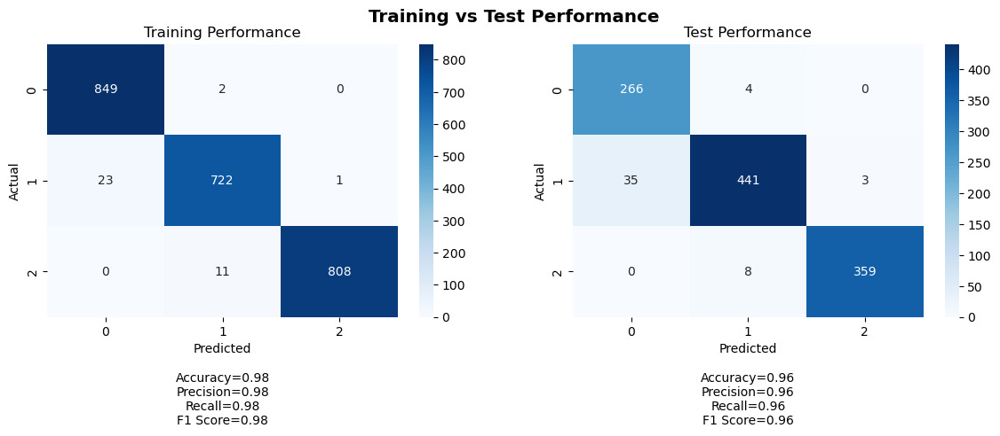

Training Metrics:
Accuracy: 0.9846854304635762
Precision: 0.9848290481456988
Recall: 0.9846854304635762
F1 Score: 0.9846763610749929

Test Metrics:
Accuracy: 0.9551971326164874
Precision: 0.9577728252480717
Recall: 0.9551971326164874
F1 Score: 0.9554870261657294

Training Confusion Matrix:
Class 0 - TP: 849, FP: 23, TN: 1542, FN: 2
Class 1 - TP: 722, FP: 13, TN: 1657, FN: 24
Class 2 - TP: 808, FP: 1, TN: 1596, FN: 11

Test Confusion Matrix:
Class 0 - TP: 266, FP: 35, TN: 811, FN: 4
Class 1 - TP: 441, FP: 12, TN: 625, FN: 38
Class 2 - TP: 359, FP: 3, TN: 746, FN: 8
35/35 [==============================] - 0s 1ms/step


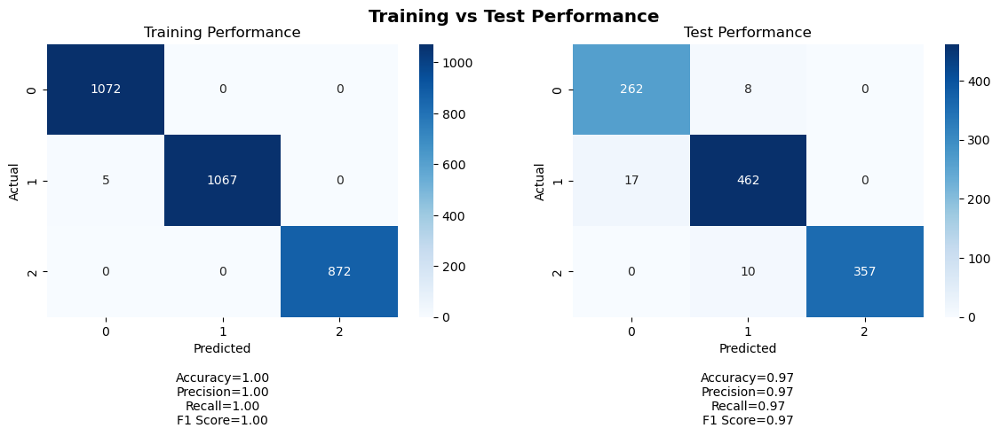

 34%|███▍      | 34/100 [2:23:24<2:46:31, 151.39s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983498715608984
Recall: 0.998342175066313
F1 Score: 0.9983421660499482

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9691629812695108
Recall: 0.9686379928315412
F1 Score: 0.9687760801384308

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 5, TN: 1939, FN: 0
Class 1 - TP: 1067, FP: 0, TN: 1944, FN: 5
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 17, TN: 829, FN: 8
Class 1 - TP: 462, FP: 18, TN: 619, FN: 17
Class 2 - TP: 357, FP: 0, TN: 749, FN: 10
35/35 [==============================] - 0s 2ms/step


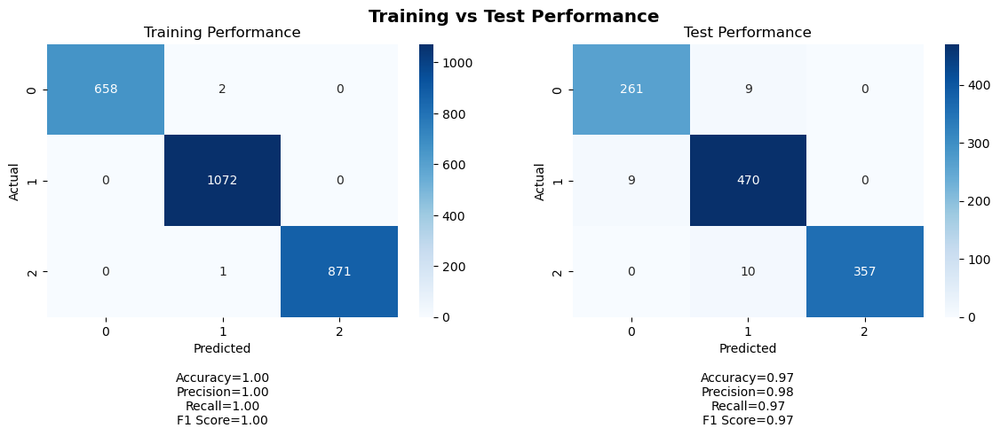

Training Metrics:
Accuracy: 0.9988479262672811
Precision: 0.9988511413567678
Recall: 0.9988479262672811
F1 Score: 0.9988480382624496

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9752585556068637
Recall: 0.974910394265233
F1 Score: 0.9749781069226638

Training Confusion Matrix:
Class 0 - TP: 658, FP: 0, TN: 1944, FN: 2
Class 1 - TP: 1072, FP: 3, TN: 1529, FN: 0
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 261, FP: 9, TN: 837, FN: 9
Class 1 - TP: 470, FP: 19, TN: 618, FN: 9
Class 2 - TP: 357, FP: 0, TN: 749, FN: 10
35/35 [==============================] - 0s 2ms/step


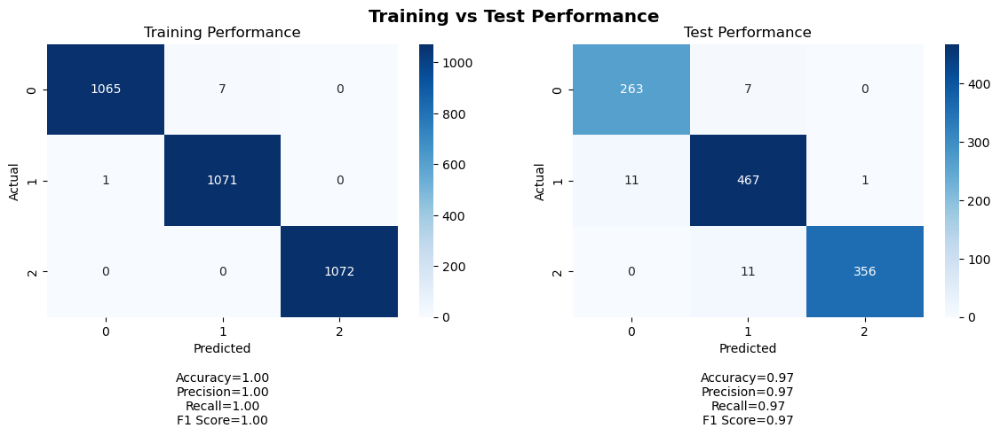

Training Metrics:
Accuracy: 0.9975124378109452
Precision: 0.9975228024008512
Recall: 0.9975124378109452
F1 Score: 0.9975124183290911

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9734366067647806
Recall: 0.9731182795698925
F1 Score: 0.9731869753927079

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 1, TN: 2143, FN: 7
Class 1 - TP: 1071, FP: 7, TN: 2137, FN: 1
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 11, TN: 835, FN: 7
Class 1 - TP: 467, FP: 18, TN: 619, FN: 12
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 1ms/step


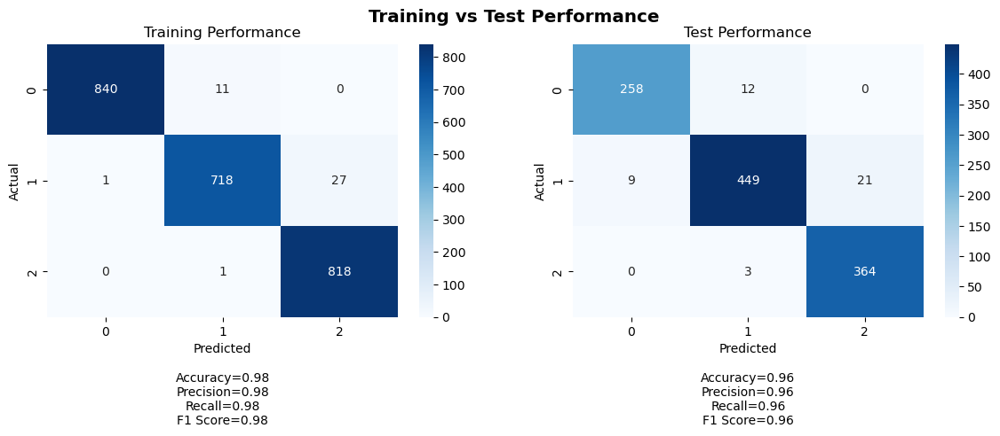

Training Metrics:
Accuracy: 0.9834437086092715
Precision: 0.9836737851513734
Recall: 0.9834437086092715
F1 Score: 0.9834298372678272

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9600320616426604
Recall: 0.9596774193548387
F1 Score: 0.9595615362961849

Training Confusion Matrix:
Class 0 - TP: 840, FP: 1, TN: 1564, FN: 11
Class 1 - TP: 718, FP: 12, TN: 1658, FN: 28
Class 2 - TP: 818, FP: 27, TN: 1570, FN: 1

Test Confusion Matrix:
Class 0 - TP: 258, FP: 9, TN: 837, FN: 12
Class 1 - TP: 449, FP: 15, TN: 622, FN: 30
Class 2 - TP: 364, FP: 21, TN: 728, FN: 3
35/35 [==============================] - 0s 1ms/step


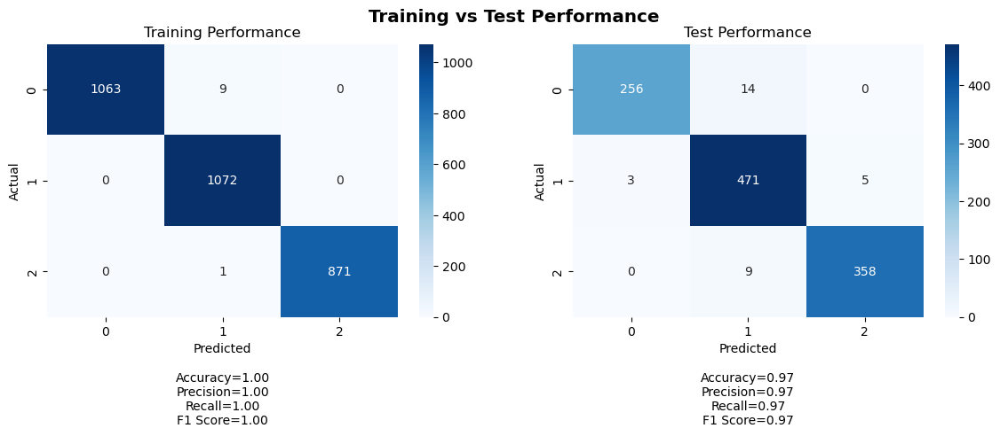

 35%|███▌      | 35/100 [2:25:53<2:43:15, 150.70s/it]

Training Metrics:
Accuracy: 0.996684350132626
Precision: 0.9967149938467422
Recall: 0.996684350132626
F1 Score: 0.9966856618736412

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9726844722407308
Recall: 0.9722222222222222
F1 Score: 0.9722435904562472

Training Confusion Matrix:
Class 0 - TP: 1063, FP: 0, TN: 1944, FN: 9
Class 1 - TP: 1072, FP: 10, TN: 1934, FN: 0
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 256, FP: 3, TN: 843, FN: 14
Class 1 - TP: 471, FP: 23, TN: 614, FN: 8
Class 2 - TP: 358, FP: 5, TN: 744, FN: 9
35/35 [==============================] - 0s 1ms/step


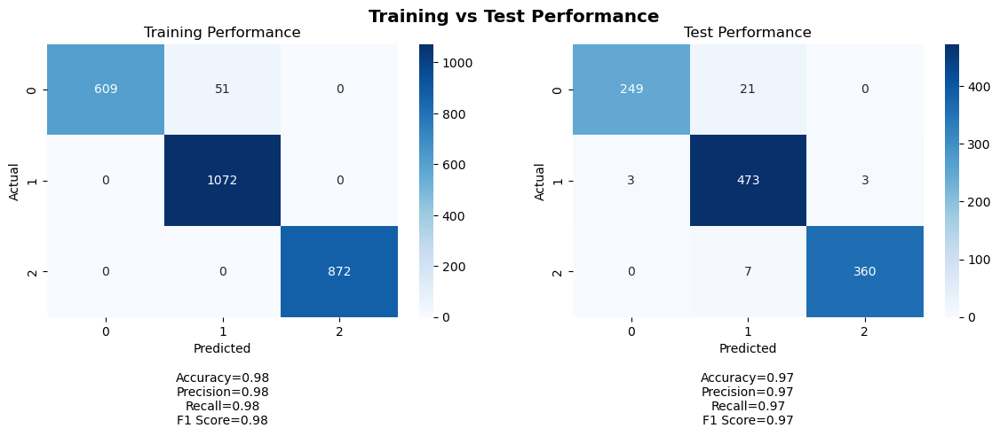

Training Metrics:
Accuracy: 0.9804147465437788
Precision: 0.9813041926045689
Recall: 0.9804147465437788
F1 Score: 0.9802487174426583

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9704141553339052
Recall: 0.9695340501792115
F1 Score: 0.9694806830549633

Training Confusion Matrix:
Class 0 - TP: 609, FP: 0, TN: 1944, FN: 51
Class 1 - TP: 1072, FP: 51, TN: 1481, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 249, FP: 3, TN: 843, FN: 21
Class 1 - TP: 473, FP: 28, TN: 609, FN: 6
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


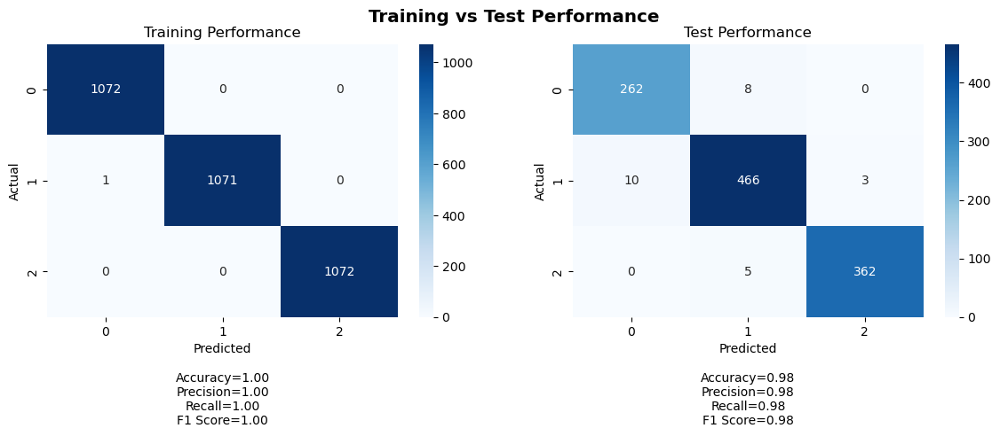

Training Metrics:
Accuracy: 0.9996890547263682
Precision: 0.9996893445169308
Recall: 0.9996890547263682
F1 Score: 0.9996890546587234

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9767536658204303
Recall: 0.9767025089605734
F1 Score: 0.976722474346196

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 1, TN: 2143, FN: 0
Class 1 - TP: 1071, FP: 0, TN: 2144, FN: 1
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 10, TN: 836, FN: 8
Class 1 - TP: 466, FP: 13, TN: 624, FN: 13
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 2ms/step


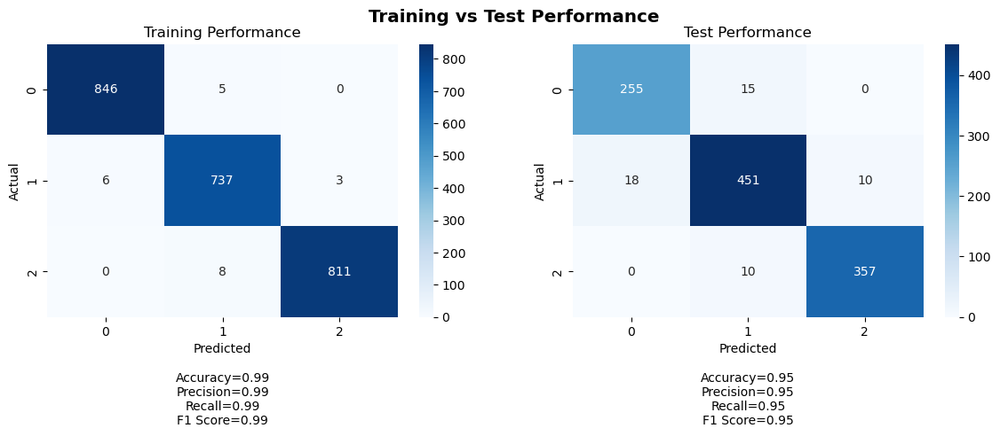

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9909180248627595
Recall: 0.9908940397350994
F1 Score: 0.9909005799619515

Test Metrics:
Accuracy: 0.9525089605734767
Precision: 0.9525450171797419
Recall: 0.9525089605734767
F1 Score: 0.9525160521036701

Training Confusion Matrix:
Class 0 - TP: 846, FP: 6, TN: 1559, FN: 5
Class 1 - TP: 737, FP: 13, TN: 1657, FN: 9
Class 2 - TP: 811, FP: 3, TN: 1594, FN: 8

Test Confusion Matrix:
Class 0 - TP: 255, FP: 18, TN: 828, FN: 15
Class 1 - TP: 451, FP: 25, TN: 612, FN: 28
Class 2 - TP: 357, FP: 10, TN: 739, FN: 10
35/35 [==============================] - 0s 2ms/step


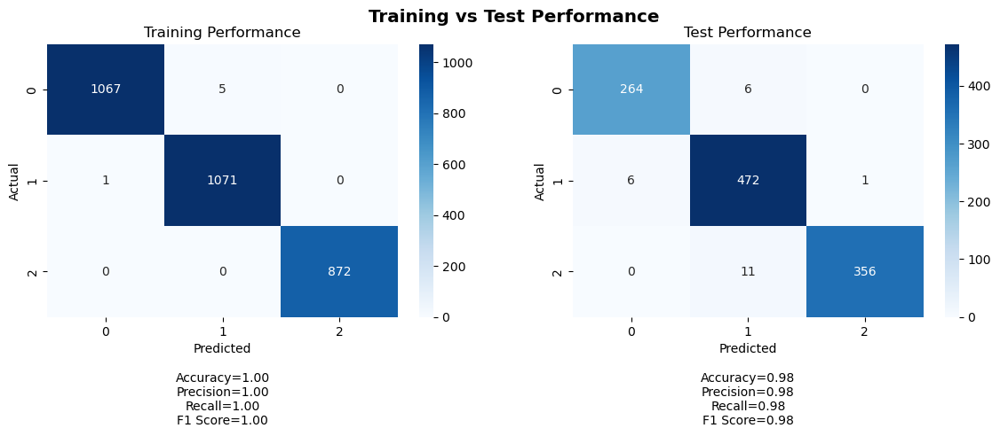

 36%|███▌      | 36/100 [2:28:15<2:37:58, 148.10s/it]

Training Metrics:
Accuracy: 0.9980106100795756
Precision: 0.998015531181115
Recall: 0.9980106100795756
F1 Score: 0.998010603155021

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9787810367896747
Recall: 0.978494623655914
F1 Score: 0.9785314462490787

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 1, TN: 1943, FN: 5
Class 1 - TP: 1071, FP: 5, TN: 1939, FN: 1
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 6, TN: 840, FN: 6
Class 1 - TP: 472, FP: 17, TN: 620, FN: 7
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 2ms/step


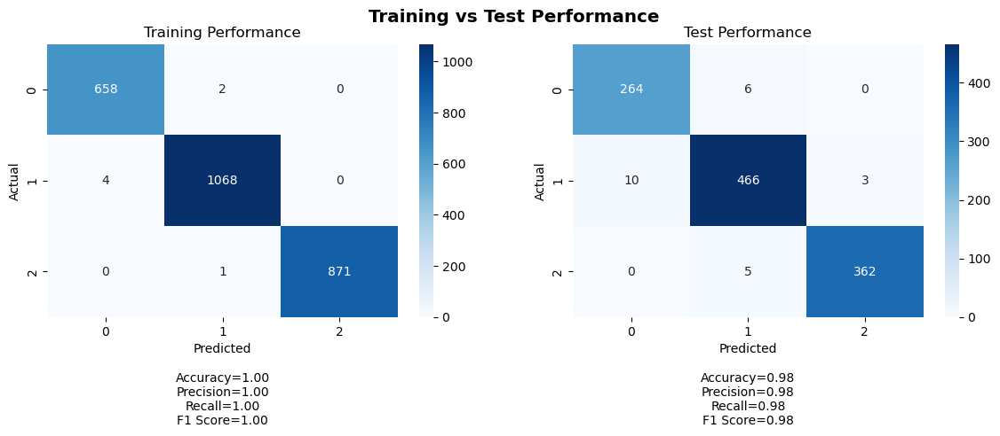

Training Metrics:
Accuracy: 0.9973118279569892
Precision: 0.9973153930382861
Recall: 0.9973118279569892
F1 Score: 0.997312833522169

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9785693776451649
Recall: 0.978494623655914
F1 Score: 0.9785150447716422

Training Confusion Matrix:
Class 0 - TP: 658, FP: 4, TN: 1940, FN: 2
Class 1 - TP: 1068, FP: 3, TN: 1529, FN: 4
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 264, FP: 10, TN: 836, FN: 6
Class 1 - TP: 466, FP: 11, TN: 626, FN: 13
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 1ms/step


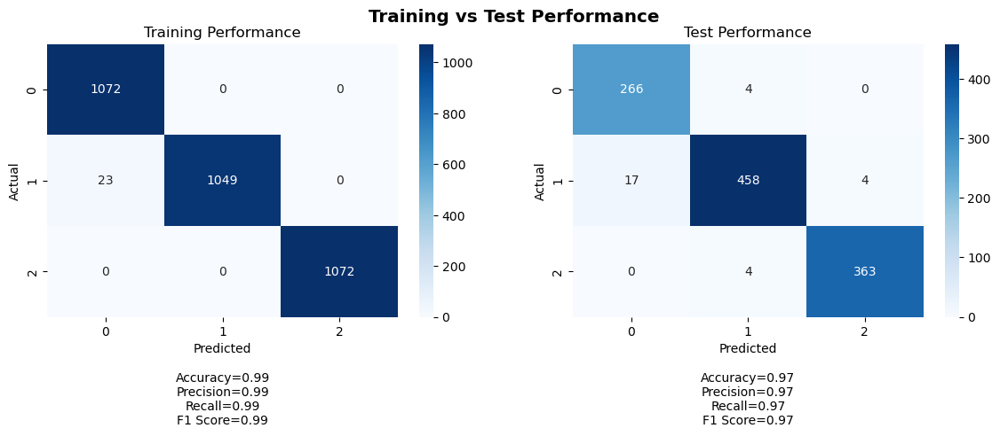

Training Metrics:
Accuracy: 0.9928482587064676
Precision: 0.9929984779299849
Recall: 0.9928482587064676
F1 Score: 0.9928474355774953

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9745141064177867
Recall: 0.9740143369175627
F1 Score: 0.974056778264845

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 23, TN: 2121, FN: 0
Class 1 - TP: 1049, FP: 0, TN: 2144, FN: 23
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 17, TN: 829, FN: 4
Class 1 - TP: 458, FP: 8, TN: 629, FN: 21
Class 2 - TP: 363, FP: 4, TN: 745, FN: 4
35/35 [==============================] - 0s 1ms/step


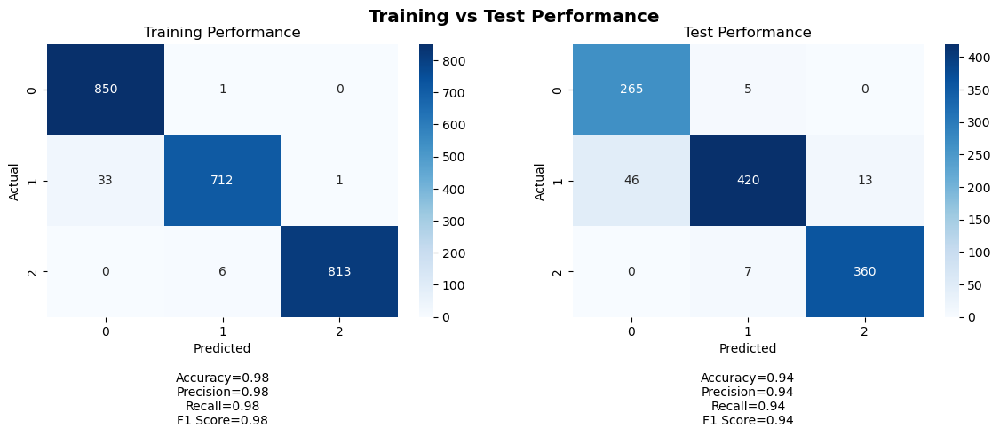

Training Metrics:
Accuracy: 0.9830298013245033
Precision: 0.983413458358138
Recall: 0.9830298013245033
F1 Score: 0.9829988382937864

Test Metrics:
Accuracy: 0.9363799283154122
Precision: 0.9408314233043171
Recall: 0.9363799283154122
F1 Score: 0.9364238896846151

Training Confusion Matrix:
Class 0 - TP: 850, FP: 33, TN: 1532, FN: 1
Class 1 - TP: 712, FP: 7, TN: 1663, FN: 34
Class 2 - TP: 813, FP: 1, TN: 1596, FN: 6

Test Confusion Matrix:
Class 0 - TP: 265, FP: 46, TN: 800, FN: 5
Class 1 - TP: 420, FP: 12, TN: 625, FN: 59
Class 2 - TP: 360, FP: 13, TN: 736, FN: 7
35/35 [==============================] - 0s 1ms/step


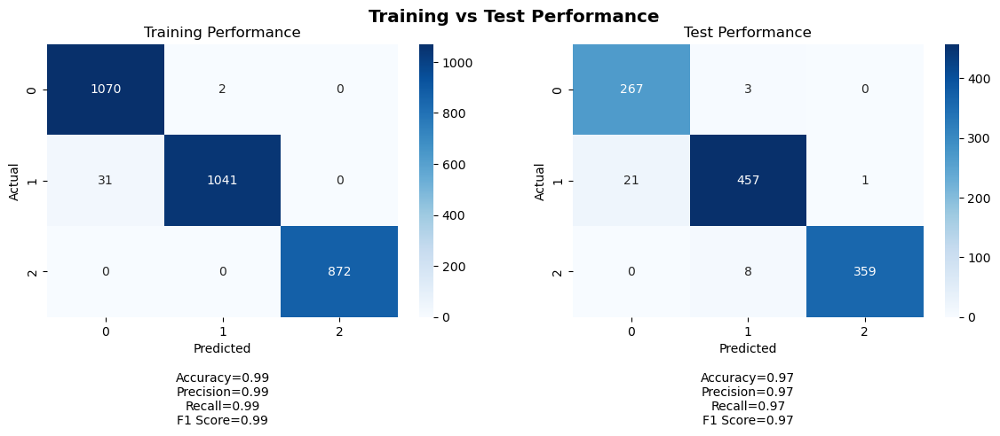

 37%|███▋      | 37/100 [2:30:33<2:32:26, 145.19s/it]

Training Metrics:
Accuracy: 0.9890583554376657
Precision: 0.9893106503999254
Recall: 0.9890583554376657
F1 Score: 0.9890563532328555

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9713570865116563
Recall: 0.9704301075268817
F1 Score: 0.9705664069524773

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 31, TN: 1913, FN: 2
Class 1 - TP: 1041, FP: 2, TN: 1942, FN: 31
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 267, FP: 21, TN: 825, FN: 3
Class 1 - TP: 457, FP: 11, TN: 626, FN: 22
Class 2 - TP: 359, FP: 1, TN: 748, FN: 8
35/35 [==============================] - 0s 1ms/step


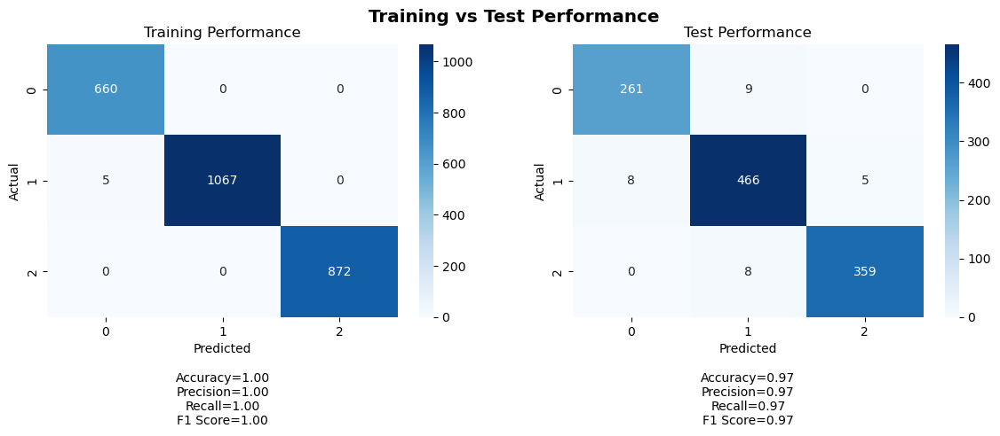

Training Metrics:
Accuracy: 0.9980798771121352
Precision: 0.9980943141263297
Recall: 0.9980798771121352
F1 Score: 0.9980812558026102

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9731808585854139
Recall: 0.9731182795698925
F1 Score: 0.9731361329134722

Training Confusion Matrix:
Class 0 - TP: 660, FP: 5, TN: 1939, FN: 0
Class 1 - TP: 1067, FP: 0, TN: 1532, FN: 5
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 8, TN: 838, FN: 9
Class 1 - TP: 466, FP: 17, TN: 620, FN: 13
Class 2 - TP: 359, FP: 5, TN: 744, FN: 8
35/35 [==============================] - 0s 3ms/step


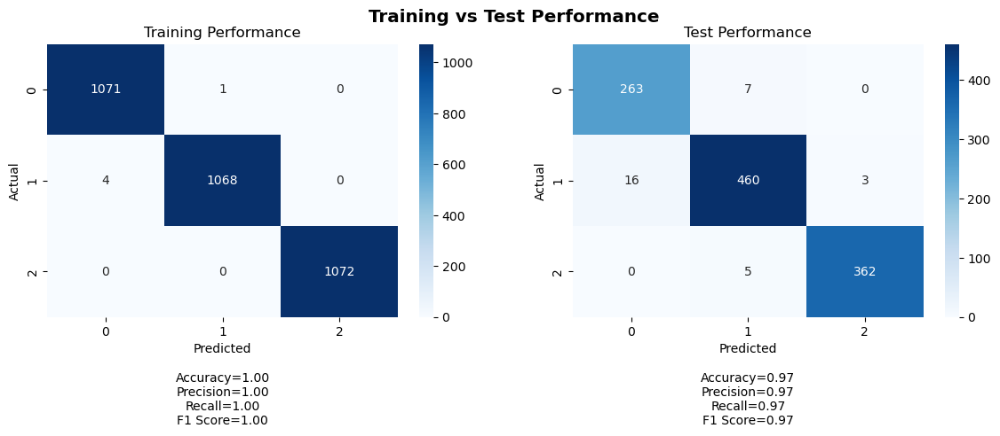

Training Metrics:
Accuracy: 0.9984452736318408
Precision: 0.9984478720241333
Recall: 0.9984452736318408
F1 Score: 0.9984452705878191

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9725105058910384
Recall: 0.9722222222222222
F1 Score: 0.9722791265208693

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 4, TN: 2140, FN: 1
Class 1 - TP: 1068, FP: 1, TN: 2143, FN: 4
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 16, TN: 830, FN: 7
Class 1 - TP: 460, FP: 12, TN: 625, FN: 19
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 3ms/step


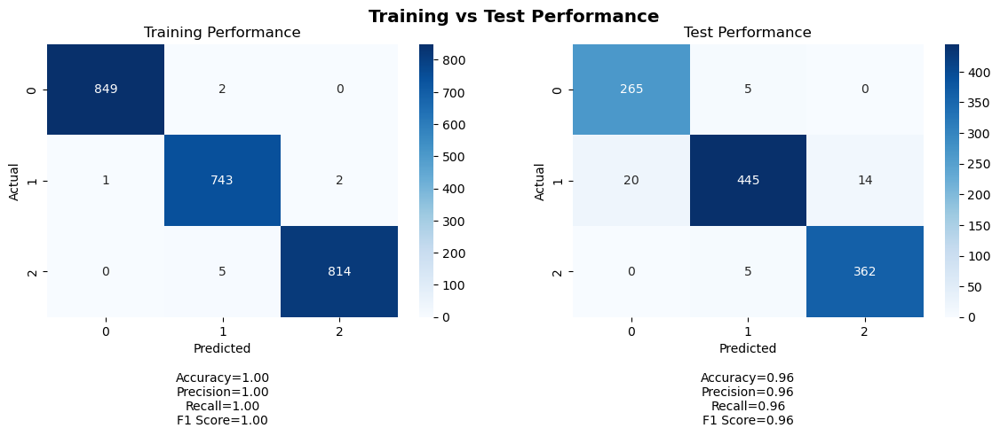

Training Metrics:
Accuracy: 0.9958609271523179
Precision: 0.995872849305285
Recall: 0.9958609271523179
F1 Score: 0.9958634375543847

Test Metrics:
Accuracy: 0.9605734767025089
Precision: 0.9613443238659979
Recall: 0.9605734767025089
F1 Score: 0.9604727610838338

Training Confusion Matrix:
Class 0 - TP: 849, FP: 1, TN: 1564, FN: 2
Class 1 - TP: 743, FP: 7, TN: 1663, FN: 3
Class 2 - TP: 814, FP: 2, TN: 1595, FN: 5

Test Confusion Matrix:
Class 0 - TP: 265, FP: 20, TN: 826, FN: 5
Class 1 - TP: 445, FP: 10, TN: 627, FN: 34
Class 2 - TP: 362, FP: 14, TN: 735, FN: 5
35/35 [==============================] - 0s 1ms/step


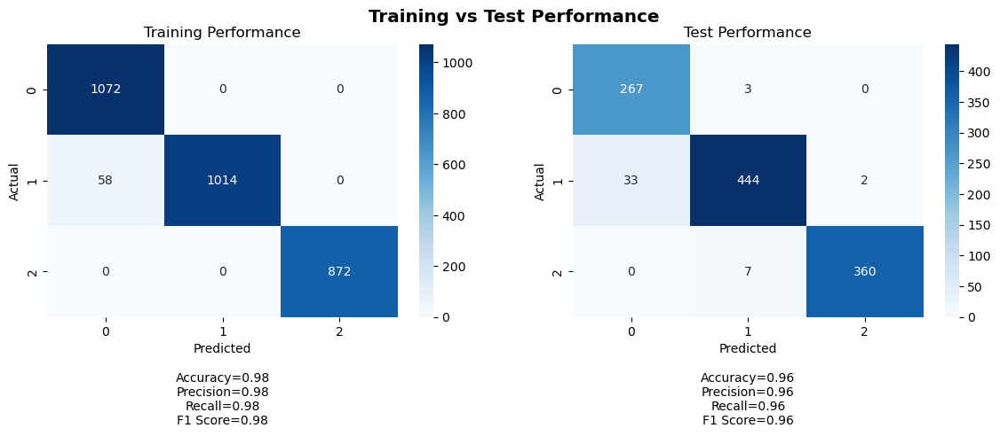

 38%|███▊      | 38/100 [2:32:57<2:29:38, 144.81s/it]

Training Metrics:
Accuracy: 0.9807692307692307
Precision: 0.9817562968005447
Recall: 0.9807692307692307
F1 Score: 0.9807551469311067

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9621162319871472
Recall: 0.9596774193548387
F1 Score: 0.9599584321978912

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 58, TN: 1886, FN: 0
Class 1 - TP: 1014, FP: 0, TN: 1944, FN: 58
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 267, FP: 33, TN: 813, FN: 3
Class 1 - TP: 444, FP: 10, TN: 627, FN: 35
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


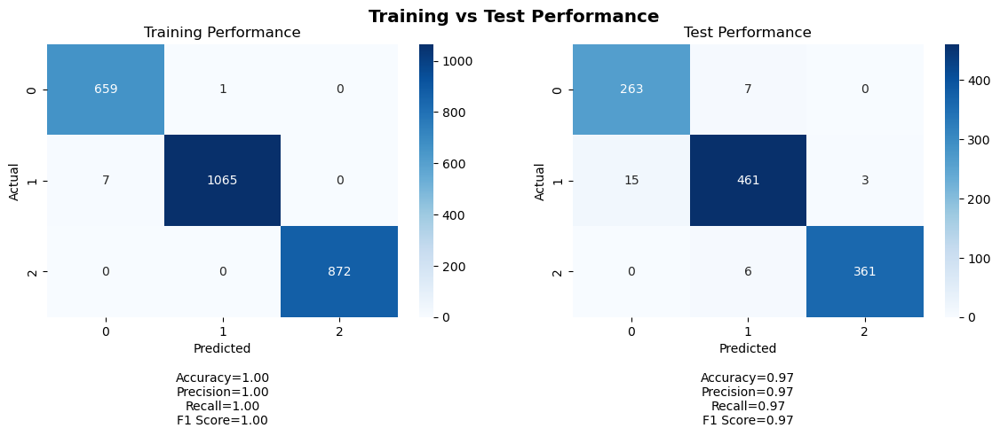

Training Metrics:
Accuracy: 0.9969278033794163
Precision: 0.99694985965639
Recall: 0.9969278033794163
F1 Score: 0.9969304432039827

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9724639772400054
Recall: 0.9722222222222222
F1 Score: 0.9722766970866847

Training Confusion Matrix:
Class 0 - TP: 659, FP: 7, TN: 1937, FN: 1
Class 1 - TP: 1065, FP: 1, TN: 1531, FN: 7
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 15, TN: 831, FN: 7
Class 1 - TP: 461, FP: 13, TN: 624, FN: 18
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 1ms/step


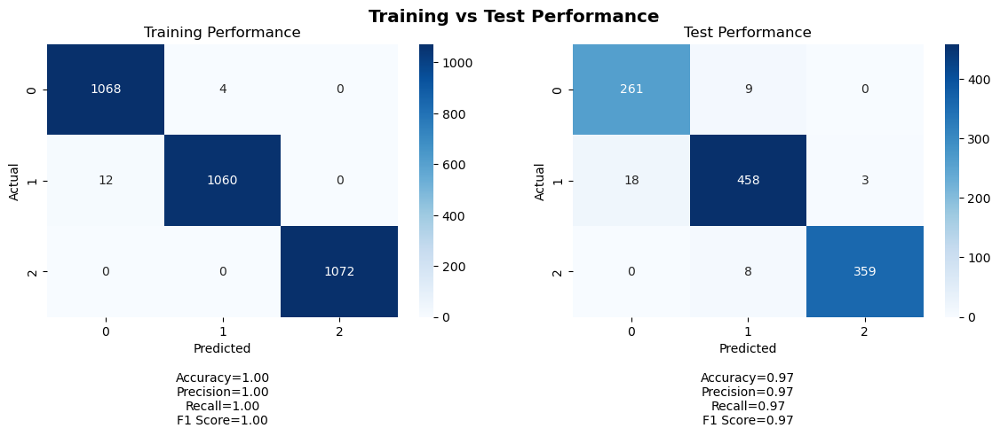

Training Metrics:
Accuracy: 0.9950248756218906
Precision: 0.9950431634642161
Recall: 0.9950248756218906
F1 Score: 0.995024806352654

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9663047050201301
Recall: 0.9659498207885304
F1 Score: 0.9660429426497186

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 12, TN: 2132, FN: 4
Class 1 - TP: 1060, FP: 4, TN: 2140, FN: 12
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 18, TN: 828, FN: 9
Class 1 - TP: 458, FP: 17, TN: 620, FN: 21
Class 2 - TP: 359, FP: 3, TN: 746, FN: 8
35/35 [==============================] - 0s 2ms/step


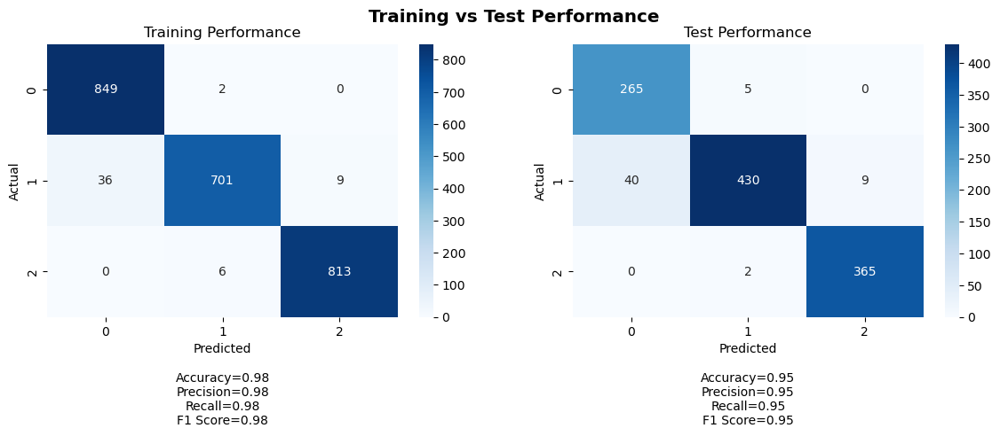

Training Metrics:
Accuracy: 0.9780629139072847
Precision: 0.9784761623100435
Recall: 0.9780629139072847
F1 Score: 0.9779436870057502

Test Metrics:
Accuracy: 0.9498207885304659
Precision: 0.9534819392953124
Recall: 0.9498207885304659
F1 Score: 0.94994415702307

Training Confusion Matrix:
Class 0 - TP: 849, FP: 36, TN: 1529, FN: 2
Class 1 - TP: 701, FP: 8, TN: 1662, FN: 45
Class 2 - TP: 813, FP: 9, TN: 1588, FN: 6

Test Confusion Matrix:
Class 0 - TP: 265, FP: 40, TN: 806, FN: 5
Class 1 - TP: 430, FP: 7, TN: 630, FN: 49
Class 2 - TP: 365, FP: 9, TN: 740, FN: 2
35/35 [==============================] - 0s 1ms/step


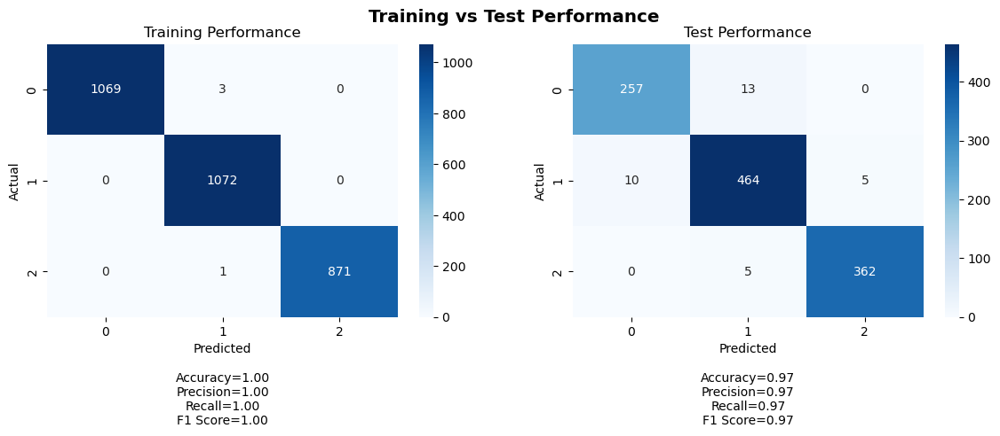

 39%|███▉      | 39/100 [2:35:22<2:27:11, 144.79s/it]

Training Metrics:
Accuracy: 0.9986737400530504
Precision: 0.9986786703874257
Recall: 0.9986737400530504
F1 Score: 0.9986741829282078

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9704298150936014
Recall: 0.9704301075268817
F1 Score: 0.9704186944757144

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 0, TN: 1944, FN: 3
Class 1 - TP: 1072, FP: 4, TN: 1940, FN: 0
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 257, FP: 10, TN: 836, FN: 13
Class 1 - TP: 464, FP: 18, TN: 619, FN: 15
Class 2 - TP: 362, FP: 5, TN: 744, FN: 5
35/35 [==============================] - 0s 2ms/step


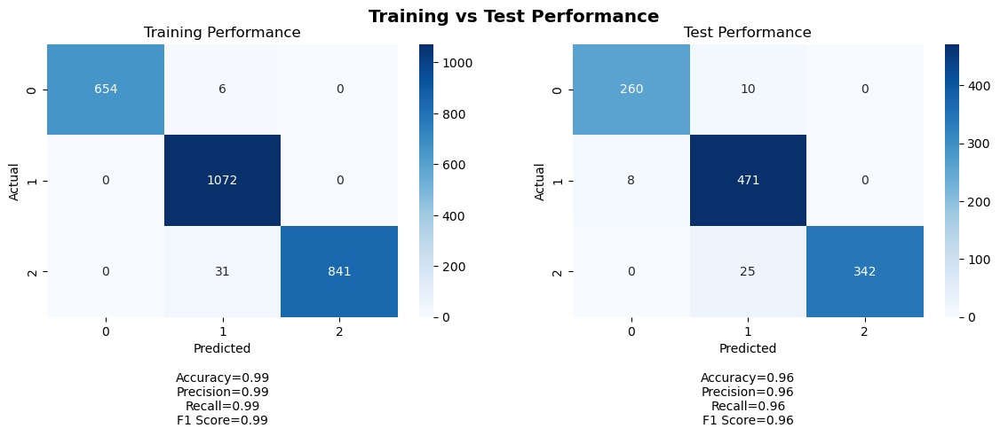

Training Metrics:
Accuracy: 0.9857910906298003
Precision: 0.9862651480208711
Recall: 0.9857910906298003
F1 Score: 0.9857986352480427

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9630895048747931
Recall: 0.9614695340501792
F1 Score: 0.9615726892619578

Training Confusion Matrix:
Class 0 - TP: 654, FP: 0, TN: 1944, FN: 6
Class 1 - TP: 1072, FP: 37, TN: 1495, FN: 0
Class 2 - TP: 841, FP: 0, TN: 1732, FN: 31

Test Confusion Matrix:
Class 0 - TP: 260, FP: 8, TN: 838, FN: 10
Class 1 - TP: 471, FP: 35, TN: 602, FN: 8
Class 2 - TP: 342, FP: 0, TN: 749, FN: 25
35/35 [==============================] - 0s 2ms/step


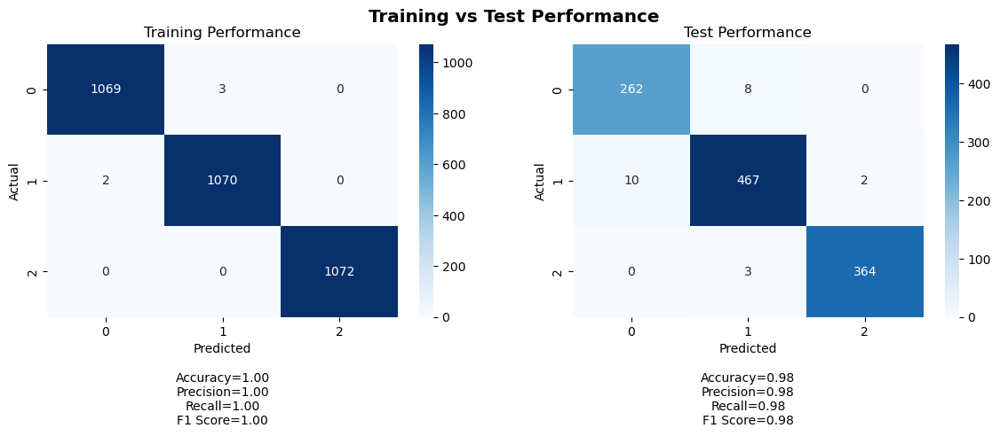

Training Metrics:
Accuracy: 0.9984452736318408
Precision: 0.9984455623400855
Recall: 0.9984452736318408
F1 Score: 0.9984452732936168

Test Metrics:
Accuracy: 0.9793906810035843
Precision: 0.979431050518449
Recall: 0.9793906810035843
F1 Score: 0.9794066155662989

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 2, TN: 2142, FN: 3
Class 1 - TP: 1070, FP: 3, TN: 2141, FN: 2
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 10, TN: 836, FN: 8
Class 1 - TP: 467, FP: 11, TN: 626, FN: 12
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3
35/35 [==============================] - 0s 1ms/step


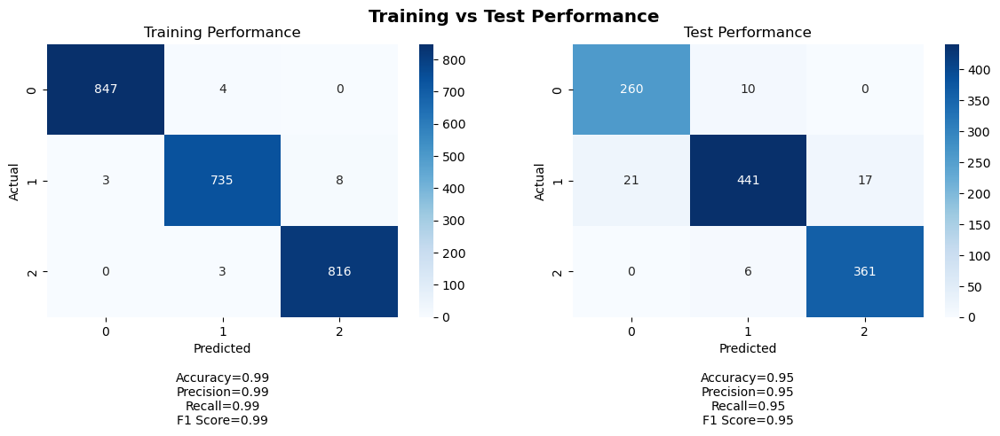

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9925526814687495
Recall: 0.9925496688741722
F1 Score: 0.9925457311727769

Test Metrics:
Accuracy: 0.9516129032258065
Precision: 0.9521026275550444
Recall: 0.9516129032258065
F1 Score: 0.9514736744262301

Training Confusion Matrix:
Class 0 - TP: 847, FP: 3, TN: 1562, FN: 4
Class 1 - TP: 735, FP: 7, TN: 1663, FN: 11
Class 2 - TP: 816, FP: 8, TN: 1589, FN: 3

Test Confusion Matrix:
Class 0 - TP: 260, FP: 21, TN: 825, FN: 10
Class 1 - TP: 441, FP: 16, TN: 621, FN: 38
Class 2 - TP: 361, FP: 17, TN: 732, FN: 6
35/35 [==============================] - 0s 1ms/step


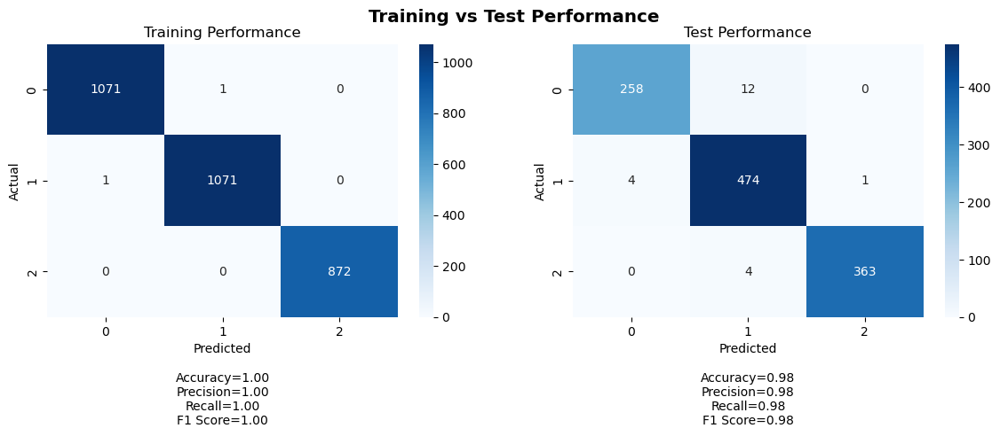

 40%|████      | 40/100 [2:37:47<2:24:45, 144.75s/it]

Training Metrics:
Accuracy: 0.9993368700265252
Precision: 0.9993368700265252
Recall: 0.9993368700265252
F1 Score: 0.9993368700265252

Test Metrics:
Accuracy: 0.9811827956989247
Precision: 0.9813878176618706
Recall: 0.9811827956989247
F1 Score: 0.9811726114486016

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 1 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 258, FP: 4, TN: 842, FN: 12
Class 1 - TP: 474, FP: 16, TN: 621, FN: 5
Class 2 - TP: 363, FP: 1, TN: 748, FN: 4
35/35 [==============================] - 0s 2ms/step


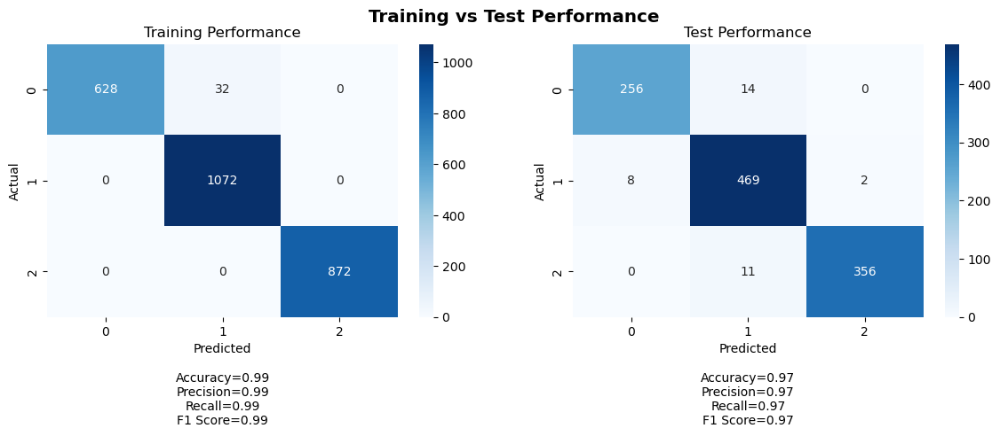

Training Metrics:
Accuracy: 0.9877112135176651
Precision: 0.988067410227298
Recall: 0.9877112135176651
F1 Score: 0.9876489165091001

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9691102256275214
Recall: 0.9686379928315412
F1 Score: 0.9686966837023938

Training Confusion Matrix:
Class 0 - TP: 628, FP: 0, TN: 1944, FN: 32
Class 1 - TP: 1072, FP: 32, TN: 1500, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 8, TN: 838, FN: 14
Class 1 - TP: 469, FP: 25, TN: 612, FN: 10
Class 2 - TP: 356, FP: 2, TN: 747, FN: 11
35/35 [==============================] - 0s 1ms/step


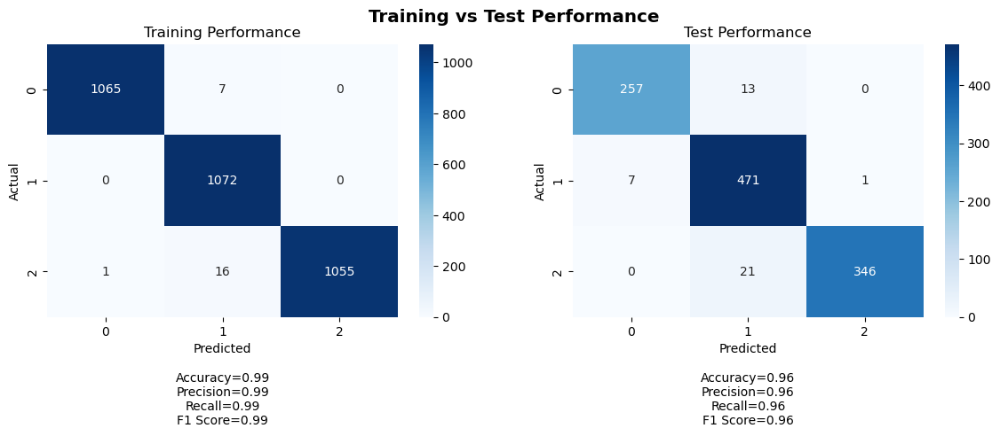

Training Metrics:
Accuracy: 0.9925373134328358
Precision: 0.9926857824953381
Recall: 0.9925373134328358
F1 Score: 0.9925506519404171

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9637399348143423
Recall: 0.9623655913978495
F1 Score: 0.9624860172481353

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 1, TN: 2143, FN: 7
Class 1 - TP: 1072, FP: 23, TN: 2121, FN: 0
Class 2 - TP: 1055, FP: 0, TN: 2144, FN: 17

Test Confusion Matrix:
Class 0 - TP: 257, FP: 7, TN: 839, FN: 13
Class 1 - TP: 471, FP: 34, TN: 603, FN: 8
Class 2 - TP: 346, FP: 1, TN: 748, FN: 21
35/35 [==============================] - 0s 2ms/step


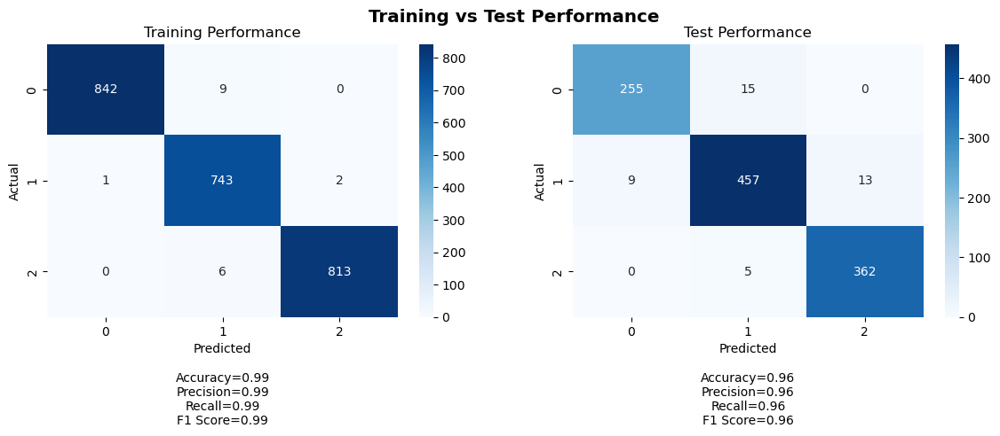

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9926399673636532
Recall: 0.9925496688741722
F1 Score: 0.9925655645025199

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9623556724340859
Recall: 0.9623655913978495
F1 Score: 0.9622923571015805

Training Confusion Matrix:
Class 0 - TP: 842, FP: 1, TN: 1564, FN: 9
Class 1 - TP: 743, FP: 15, TN: 1655, FN: 3
Class 2 - TP: 813, FP: 2, TN: 1595, FN: 6

Test Confusion Matrix:
Class 0 - TP: 255, FP: 9, TN: 837, FN: 15
Class 1 - TP: 457, FP: 20, TN: 617, FN: 22
Class 2 - TP: 362, FP: 13, TN: 736, FN: 5
35/35 [==============================] - 0s 2ms/step


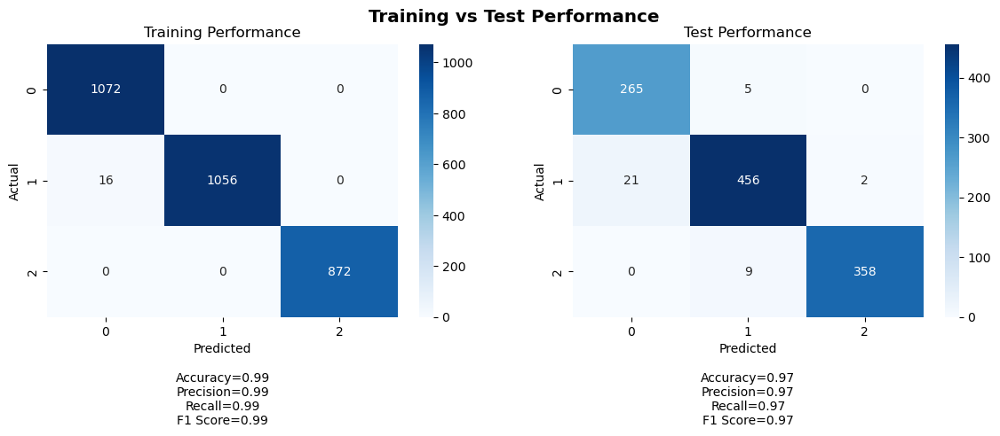

 41%|████      | 41/100 [2:40:09<2:21:41, 144.09s/it]

Training Metrics:
Accuracy: 0.9946949602122016
Precision: 0.9947729755031985
Recall: 0.9946949602122016
F1 Score: 0.9946946647491112

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9676235225623238
Recall: 0.9668458781362007
F1 Score: 0.9669764296779423

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 16, TN: 1928, FN: 0
Class 1 - TP: 1056, FP: 0, TN: 1944, FN: 16
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 21, TN: 825, FN: 5
Class 1 - TP: 456, FP: 14, TN: 623, FN: 23
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 3ms/step


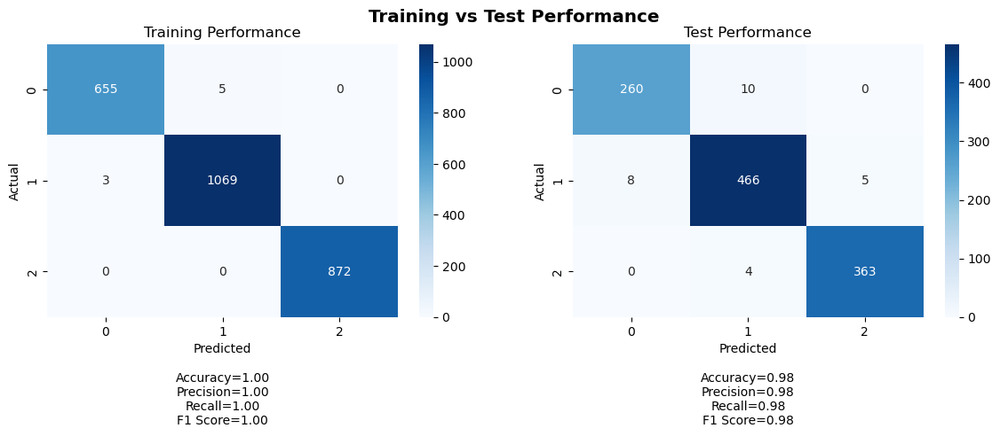

Training Metrics:
Accuracy: 0.9969278033794163
Precision: 0.9969278772833837
Recall: 0.9969278033794163
F1 Score: 0.9969269040180742

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9757912653500457
Recall: 0.9758064516129032
F1 Score: 0.9757945720104131

Training Confusion Matrix:
Class 0 - TP: 655, FP: 3, TN: 1941, FN: 5
Class 1 - TP: 1069, FP: 5, TN: 1527, FN: 3
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 8, TN: 838, FN: 10
Class 1 - TP: 466, FP: 14, TN: 623, FN: 13
Class 2 - TP: 363, FP: 5, TN: 744, FN: 4
35/35 [==============================] - 0s 2ms/step


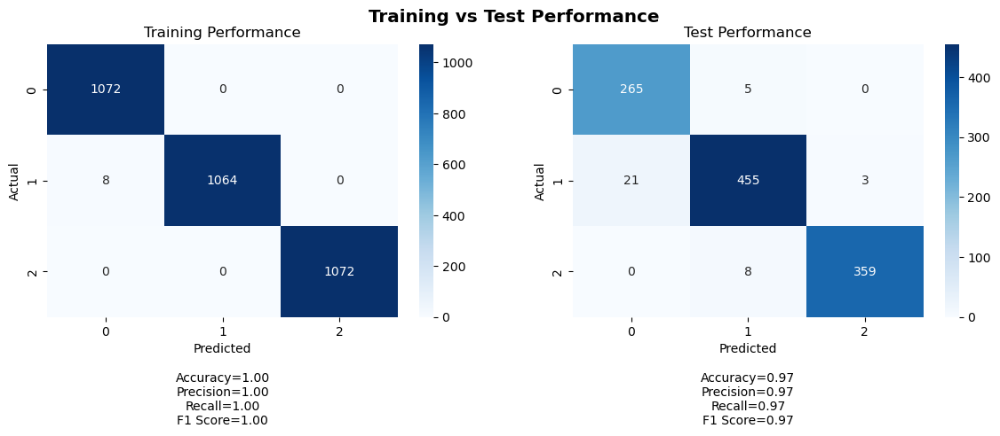

Training Metrics:
Accuracy: 0.9975124378109452
Precision: 0.9975308641975309
Recall: 0.9975124378109452
F1 Score: 0.9975124031763271

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9675876641175459
Recall: 0.9668458781362007
F1 Score: 0.9669547389675474

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 8, TN: 2136, FN: 0
Class 1 - TP: 1064, FP: 0, TN: 2144, FN: 8
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 21, TN: 825, FN: 5
Class 1 - TP: 455, FP: 13, TN: 624, FN: 24
Class 2 - TP: 359, FP: 3, TN: 746, FN: 8
35/35 [==============================] - 0s 3ms/step


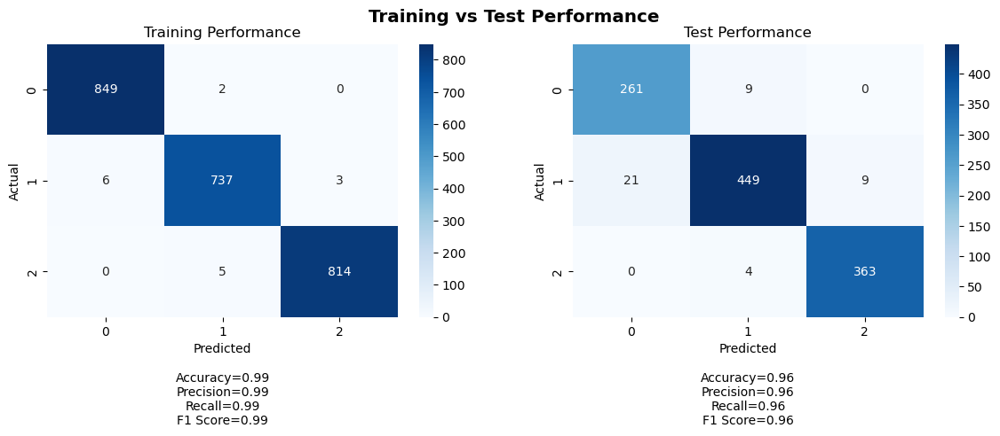

Training Metrics:
Accuracy: 0.9933774834437086
Precision: 0.9933782736050865
Recall: 0.9933774834437086
F1 Score: 0.9933748967023828

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9619500266889401
Recall: 0.9614695340501792
F1 Score: 0.9614530902576468

Training Confusion Matrix:
Class 0 - TP: 849, FP: 6, TN: 1559, FN: 2
Class 1 - TP: 737, FP: 7, TN: 1663, FN: 9
Class 2 - TP: 814, FP: 3, TN: 1594, FN: 5

Test Confusion Matrix:
Class 0 - TP: 261, FP: 21, TN: 825, FN: 9
Class 1 - TP: 449, FP: 13, TN: 624, FN: 30
Class 2 - TP: 363, FP: 9, TN: 740, FN: 4
35/35 [==============================] - 0s 1ms/step


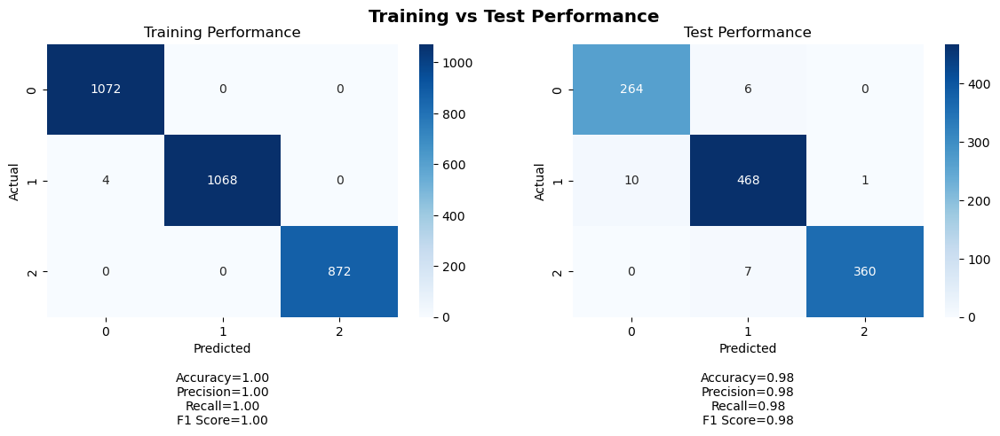

 42%|████▏     | 42/100 [2:42:37<2:20:16, 145.11s/it]

Training Metrics:
Accuracy: 0.9986737400530504
Precision: 0.9986786703874257
Recall: 0.9986737400530504
F1 Score: 0.9986737354366807

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9786589775599454
Recall: 0.978494623655914
F1 Score: 0.9785401939932301

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1068, FP: 0, TN: 1944, FN: 4
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 10, TN: 836, FN: 6
Class 1 - TP: 468, FP: 13, TN: 624, FN: 11
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 2ms/step


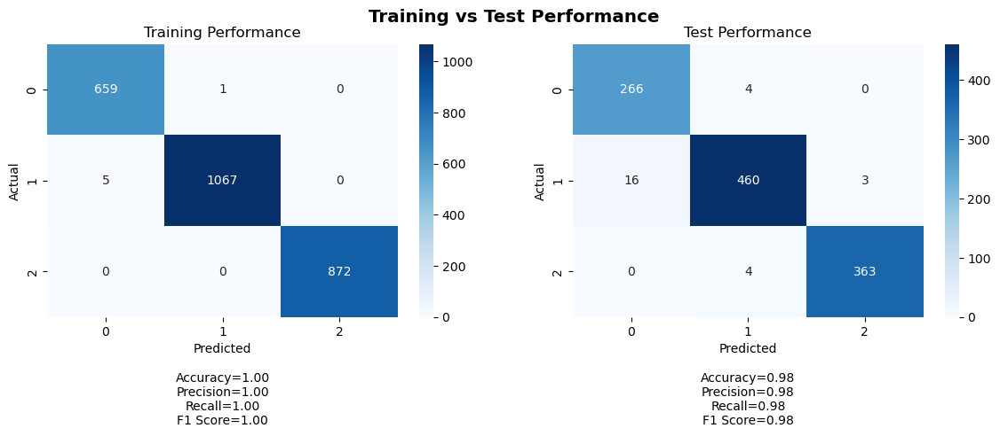

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.9977059812456128
Recall: 0.9976958525345622
F1 Score: 0.9976971797110112

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9762406990631579
Recall: 0.9758064516129032
F1 Score: 0.9758564564736725

Training Confusion Matrix:
Class 0 - TP: 659, FP: 5, TN: 1939, FN: 1
Class 1 - TP: 1067, FP: 1, TN: 1531, FN: 5
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 16, TN: 830, FN: 4
Class 1 - TP: 460, FP: 8, TN: 629, FN: 19
Class 2 - TP: 363, FP: 3, TN: 746, FN: 4
35/35 [==============================] - 0s 2ms/step


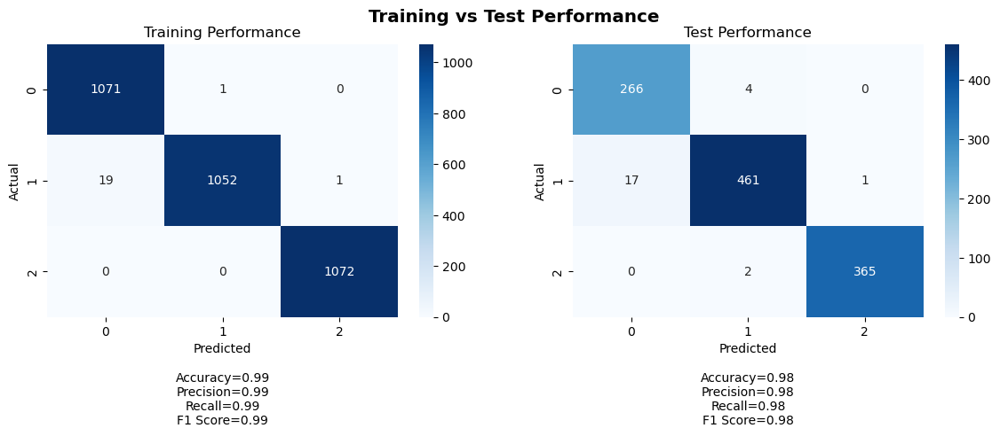

Training Metrics:
Accuracy: 0.9934701492537313
Precision: 0.9935623910913026
Recall: 0.9934701492537313
F1 Score: 0.9934669175968627

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9790537732066426
Recall: 0.978494623655914
F1 Score: 0.9785775709544512

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 19, TN: 2125, FN: 1
Class 1 - TP: 1052, FP: 1, TN: 2143, FN: 20
Class 2 - TP: 1072, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 17, TN: 829, FN: 4
Class 1 - TP: 461, FP: 6, TN: 631, FN: 18
Class 2 - TP: 365, FP: 1, TN: 748, FN: 2
35/35 [==============================] - 0s 1ms/step


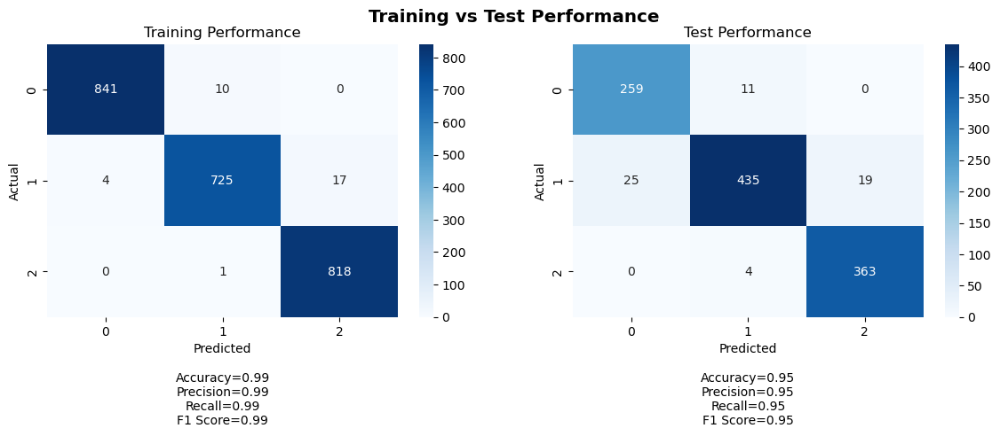

Training Metrics:
Accuracy: 0.9867549668874173
Precision: 0.9868161794761552
Recall: 0.9867549668874173
F1 Score: 0.9867360659372986

Test Metrics:
Accuracy: 0.9471326164874552
Precision: 0.9480392482060572
Recall: 0.9471326164874552
F1 Score: 0.9469214140257829

Training Confusion Matrix:
Class 0 - TP: 841, FP: 4, TN: 1561, FN: 10
Class 1 - TP: 725, FP: 11, TN: 1659, FN: 21
Class 2 - TP: 818, FP: 17, TN: 1580, FN: 1

Test Confusion Matrix:
Class 0 - TP: 259, FP: 25, TN: 821, FN: 11
Class 1 - TP: 435, FP: 15, TN: 622, FN: 44
Class 2 - TP: 363, FP: 19, TN: 730, FN: 4
35/35 [==============================] - 0s 2ms/step


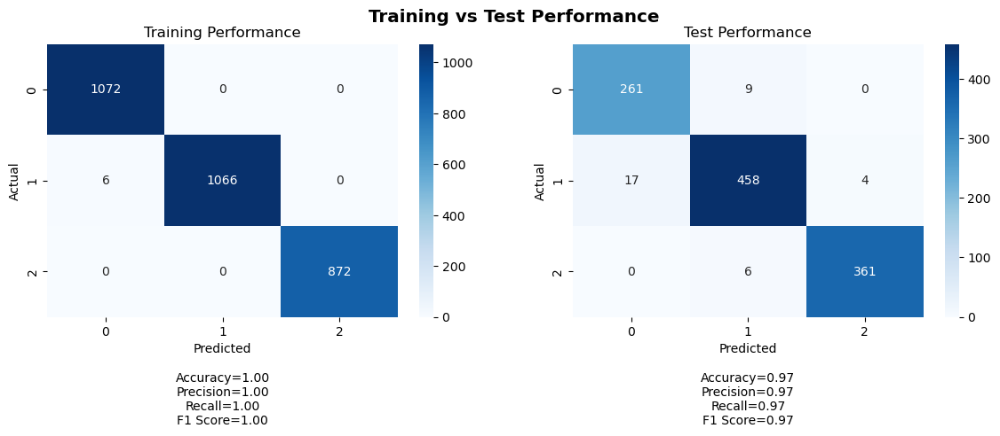

 43%|████▎     | 43/100 [2:45:00<2:17:24, 144.65s/it]

Training Metrics:
Accuracy: 0.9980106100795756
Precision: 0.9980216827507468
Recall: 0.9980106100795756
F1 Score: 0.9980105944992598

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9679901576912515
Recall: 0.967741935483871
F1 Score: 0.9677980953777426

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 6, TN: 1938, FN: 0
Class 1 - TP: 1066, FP: 0, TN: 1944, FN: 6
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 17, TN: 829, FN: 9
Class 1 - TP: 458, FP: 15, TN: 622, FN: 21
Class 2 - TP: 361, FP: 4, TN: 745, FN: 6
35/35 [==============================] - 0s 2ms/step


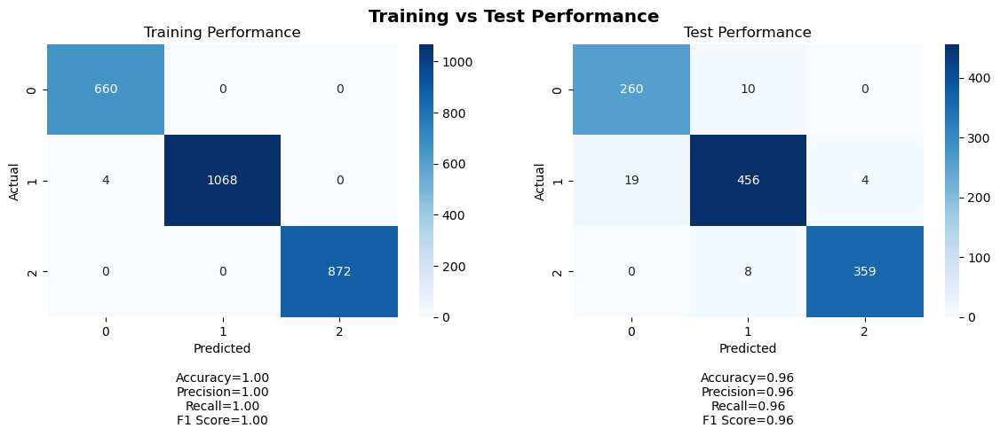

Training Metrics:
Accuracy: 0.9984639016897081
Precision: 0.9984731552939871
Recall: 0.9984639016897081
F1 Score: 0.9984647864740075

Test Metrics:
Accuracy: 0.9632616487455197
Precision: 0.963601212072669
Recall: 0.9632616487455197
F1 Score: 0.9633488110363011

Training Confusion Matrix:
Class 0 - TP: 660, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1068, FP: 0, TN: 1532, FN: 4
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 19, TN: 827, FN: 10
Class 1 - TP: 456, FP: 18, TN: 619, FN: 23
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 1ms/step


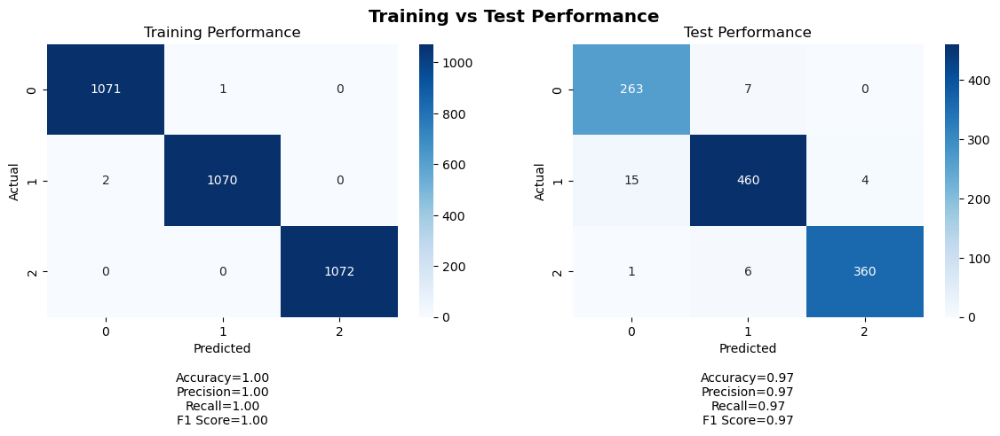

Training Metrics:
Accuracy: 0.9990671641791045
Precision: 0.9990674534285082
Recall: 0.9990671641791045
F1 Score: 0.9990671639761701

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9707152841726809
Recall: 0.9704301075268817
F1 Score: 0.9704884520023335

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 2, TN: 2142, FN: 1
Class 1 - TP: 1070, FP: 1, TN: 2143, FN: 2
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 16, TN: 830, FN: 7
Class 1 - TP: 460, FP: 13, TN: 624, FN: 19
Class 2 - TP: 360, FP: 4, TN: 745, FN: 7
35/35 [==============================] - 0s 2ms/step


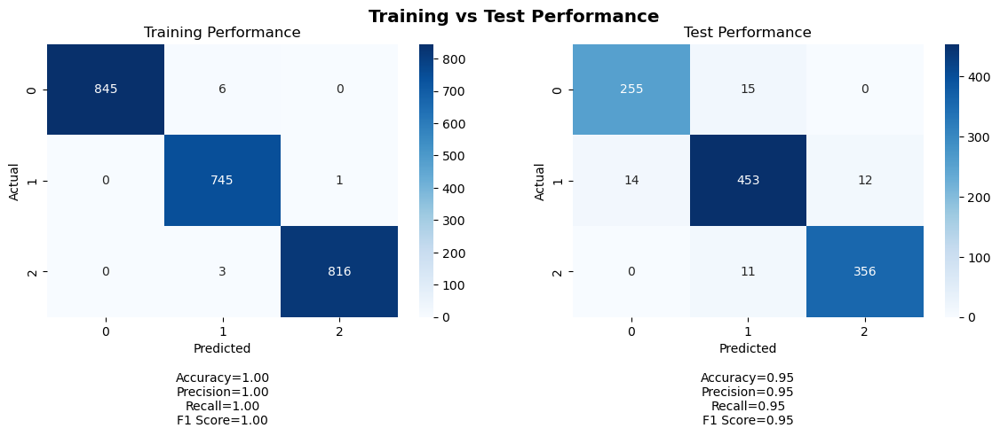

Training Metrics:
Accuracy: 0.9958609271523179
Precision: 0.9958994382184455
Recall: 0.9958609271523179
F1 Score: 0.995866559797742

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9533876022275867
Recall: 0.953405017921147
F1 Score: 0.9533949324271904

Training Confusion Matrix:
Class 0 - TP: 845, FP: 0, TN: 1565, FN: 6
Class 1 - TP: 745, FP: 9, TN: 1661, FN: 1
Class 2 - TP: 816, FP: 1, TN: 1596, FN: 3

Test Confusion Matrix:
Class 0 - TP: 255, FP: 14, TN: 832, FN: 15
Class 1 - TP: 453, FP: 26, TN: 611, FN: 26
Class 2 - TP: 356, FP: 12, TN: 737, FN: 11
35/35 [==============================] - 0s 1ms/step


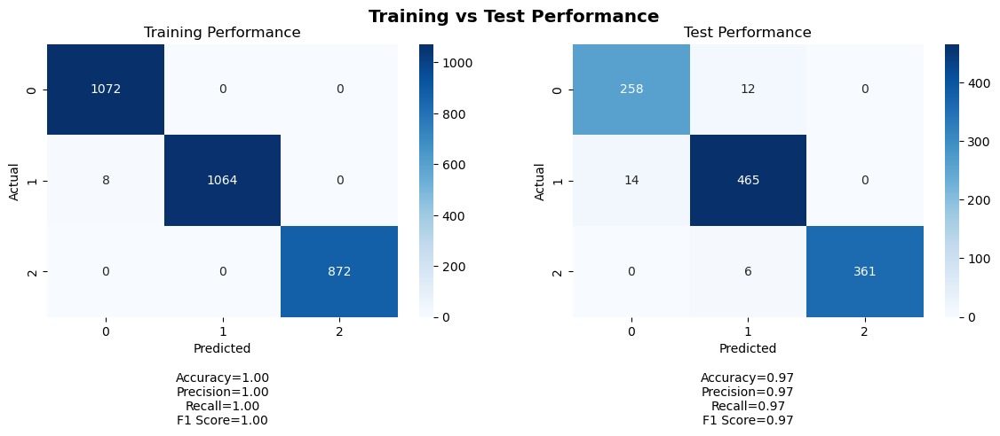

 44%|████▍     | 44/100 [2:47:22<2:14:14, 143.83s/it]

Training Metrics:
Accuracy: 0.9973474801061007
Precision: 0.9973671284016111
Recall: 0.9973474801061007
F1 Score: 0.9973474431747572

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9715519798382186
Recall: 0.9713261648745519
F1 Score: 0.9714066068741106

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 8, TN: 1936, FN: 0
Class 1 - TP: 1064, FP: 0, TN: 1944, FN: 8
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 258, FP: 14, TN: 832, FN: 12
Class 1 - TP: 465, FP: 18, TN: 619, FN: 14
Class 2 - TP: 361, FP: 0, TN: 749, FN: 6
35/35 [==============================] - 0s 1ms/step


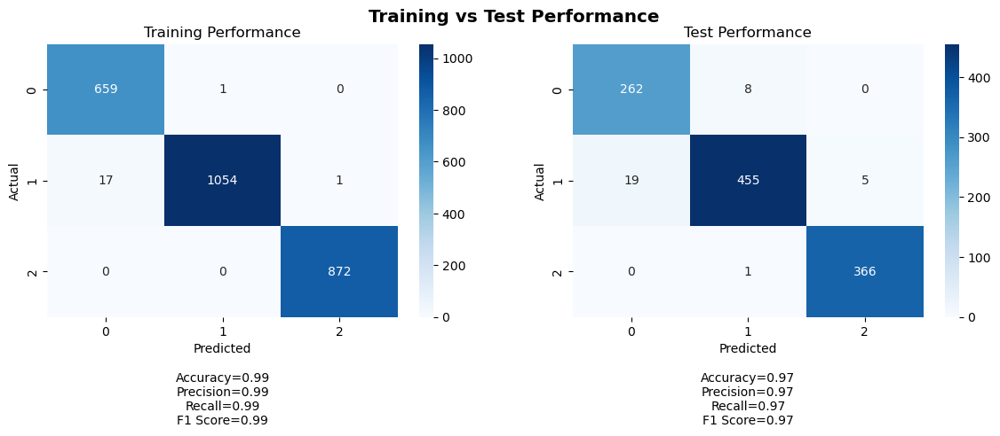

Training Metrics:
Accuracy: 0.9927035330261137
Precision: 0.9928523036079884
Recall: 0.9927035330261137
F1 Score: 0.9927158765077734

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9708841687472455
Recall: 0.9704301075268817
F1 Score: 0.9704509945440456

Training Confusion Matrix:
Class 0 - TP: 659, FP: 17, TN: 1927, FN: 1
Class 1 - TP: 1054, FP: 1, TN: 1531, FN: 18
Class 2 - TP: 872, FP: 1, TN: 1731, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 19, TN: 827, FN: 8
Class 1 - TP: 455, FP: 9, TN: 628, FN: 24
Class 2 - TP: 366, FP: 5, TN: 744, FN: 1
35/35 [==============================] - 0s 2ms/step


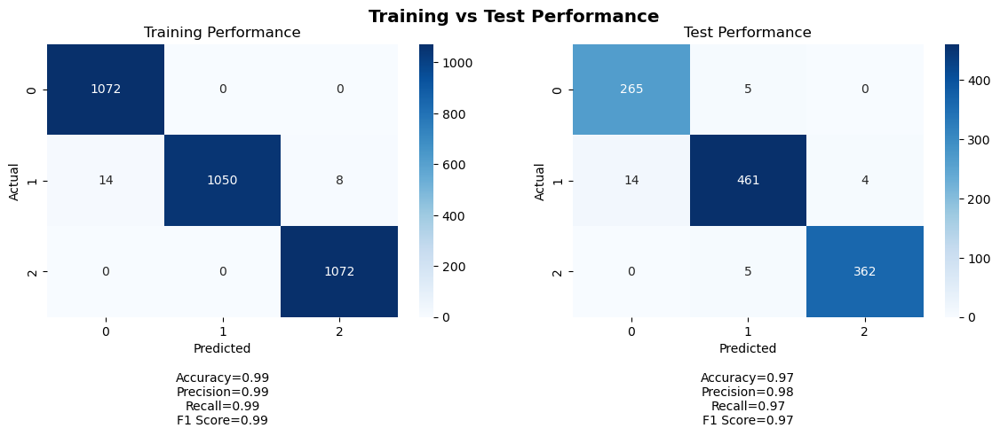

Training Metrics:
Accuracy: 0.9931592039800995
Precision: 0.9932337494031785
Recall: 0.9931592039800995
F1 Score: 0.993142487236336

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.975153075771895
Recall: 0.974910394265233
F1 Score: 0.9749388027006406

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 14, TN: 2130, FN: 0
Class 1 - TP: 1050, FP: 0, TN: 2144, FN: 22
Class 2 - TP: 1072, FP: 8, TN: 2136, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 14, TN: 832, FN: 5
Class 1 - TP: 461, FP: 10, TN: 627, FN: 18
Class 2 - TP: 362, FP: 4, TN: 745, FN: 5
35/35 [==============================] - 0s 3ms/step


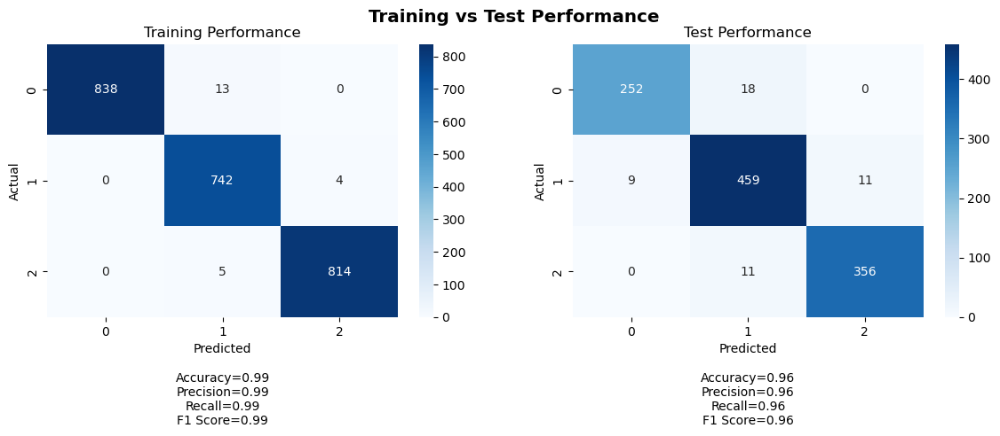

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9910292586803884
Recall: 0.9908940397350994
F1 Score: 0.9909145194957928

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.956294346987444
Recall: 0.9560931899641577
F1 Score: 0.9560924832076219

Training Confusion Matrix:
Class 0 - TP: 838, FP: 0, TN: 1565, FN: 13
Class 1 - TP: 742, FP: 18, TN: 1652, FN: 4
Class 2 - TP: 814, FP: 4, TN: 1593, FN: 5

Test Confusion Matrix:
Class 0 - TP: 252, FP: 9, TN: 837, FN: 18
Class 1 - TP: 459, FP: 29, TN: 608, FN: 20
Class 2 - TP: 356, FP: 11, TN: 738, FN: 11
35/35 [==============================] - 0s 2ms/step


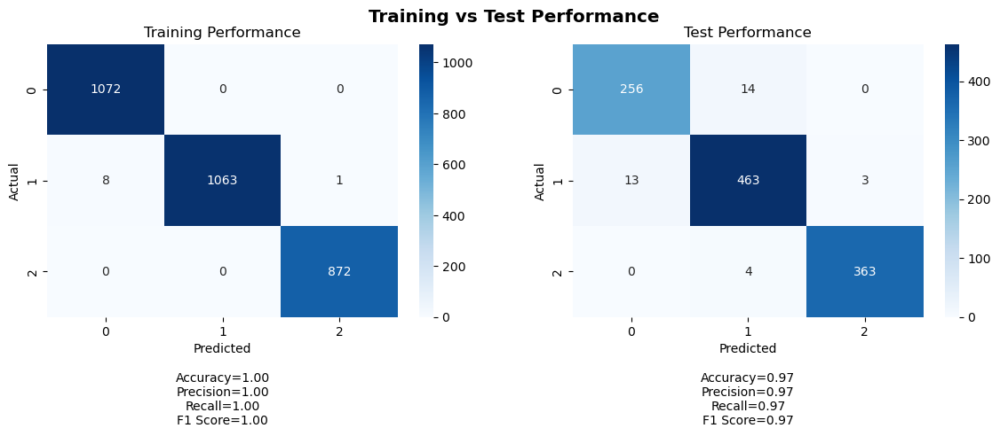

 45%|████▌     | 45/100 [2:49:47<2:12:00, 144.00s/it]

Training Metrics:
Accuracy: 0.9970159151193634
Precision: 0.9970359432144004
Recall: 0.9970159151193634
F1 Score: 0.9970146508177693

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9695504661433566
Recall: 0.9695340501792115
F1 Score: 0.9695390639666636

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 8, TN: 1936, FN: 0
Class 1 - TP: 1063, FP: 0, TN: 1944, FN: 9
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 13, TN: 833, FN: 14
Class 1 - TP: 463, FP: 18, TN: 619, FN: 16
Class 2 - TP: 363, FP: 3, TN: 746, FN: 4
35/35 [==============================] - 0s 1ms/step


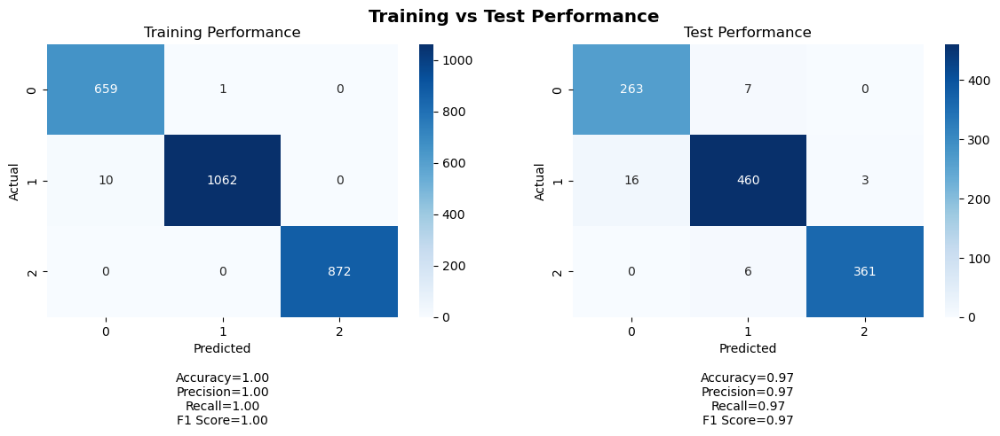

Training Metrics:
Accuracy: 0.9957757296466974
Precision: 0.9958241407619166
Recall: 0.9957757296466974
F1 Score: 0.9957811294308571

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9716187266083813
Recall: 0.9713261648745519
F1 Score: 0.9713881867399393

Training Confusion Matrix:
Class 0 - TP: 659, FP: 10, TN: 1934, FN: 1
Class 1 - TP: 1062, FP: 1, TN: 1531, FN: 10
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 16, TN: 830, FN: 7
Class 1 - TP: 460, FP: 13, TN: 624, FN: 19
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 1ms/step


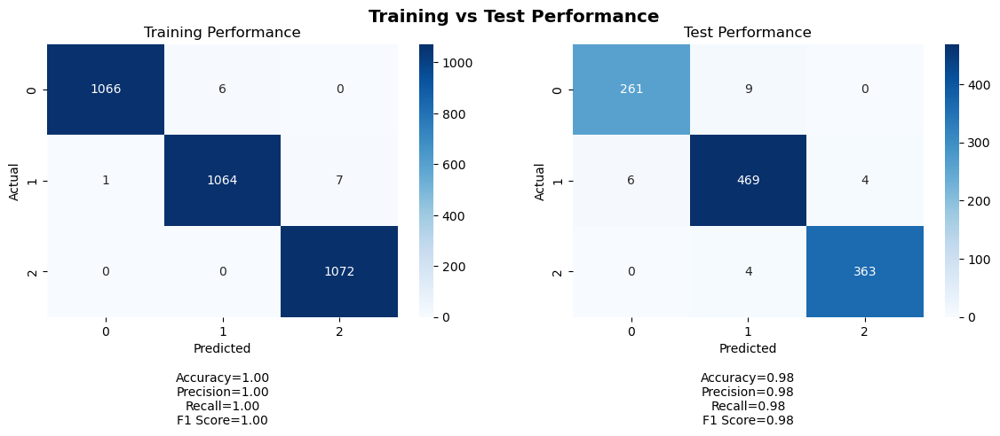

Training Metrics:
Accuracy: 0.9956467661691543
Precision: 0.9956559426088375
Recall: 0.9956467661691543
F1 Score: 0.995645731564133

Test Metrics:
Accuracy: 0.9793906810035843
Precision: 0.9794027752085425
Recall: 0.9793906810035843
F1 Score: 0.9793853052533311

Training Confusion Matrix:
Class 0 - TP: 1066, FP: 1, TN: 2143, FN: 6
Class 1 - TP: 1064, FP: 6, TN: 2138, FN: 8
Class 2 - TP: 1072, FP: 7, TN: 2137, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 6, TN: 840, FN: 9
Class 1 - TP: 469, FP: 13, TN: 624, FN: 10
Class 2 - TP: 363, FP: 4, TN: 745, FN: 4
35/35 [==============================] - 0s 1ms/step


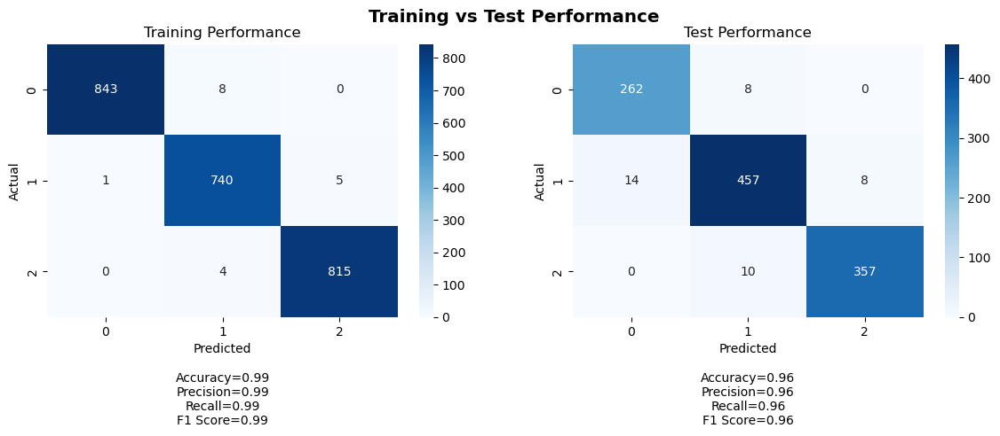

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9925883892396375
Recall: 0.9925496688741722
F1 Score: 0.9925580337623593

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9642553165432617
Recall: 0.96415770609319
F1 Score: 0.964168845443187

Training Confusion Matrix:
Class 0 - TP: 843, FP: 1, TN: 1564, FN: 8
Class 1 - TP: 740, FP: 12, TN: 1658, FN: 6
Class 2 - TP: 815, FP: 5, TN: 1592, FN: 4

Test Confusion Matrix:
Class 0 - TP: 262, FP: 14, TN: 832, FN: 8
Class 1 - TP: 457, FP: 18, TN: 619, FN: 22
Class 2 - TP: 357, FP: 8, TN: 741, FN: 10
35/35 [==============================] - 0s 2ms/step


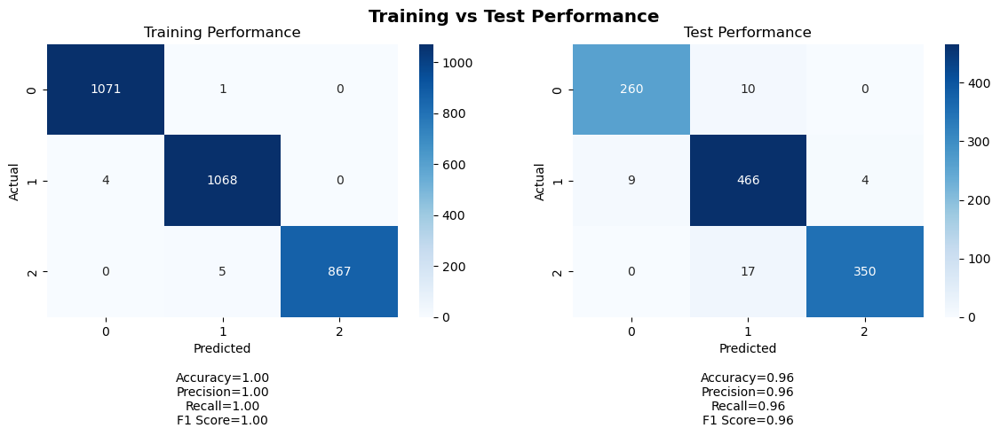

 46%|████▌     | 46/100 [2:52:14<2:10:39, 145.17s/it]

Training Metrics:
Accuracy: 0.996684350132626
Precision: 0.996691755959899
Recall: 0.996684350132626
F1 Score: 0.9966846701059462

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9646831401213988
Recall: 0.96415770609319
F1 Score: 0.9642303944653771

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 4, TN: 1940, FN: 1
Class 1 - TP: 1068, FP: 6, TN: 1938, FN: 4
Class 2 - TP: 867, FP: 0, TN: 2144, FN: 5

Test Confusion Matrix:
Class 0 - TP: 260, FP: 9, TN: 837, FN: 10
Class 1 - TP: 466, FP: 27, TN: 610, FN: 13
Class 2 - TP: 350, FP: 4, TN: 745, FN: 17
35/35 [==============================] - 0s 2ms/step


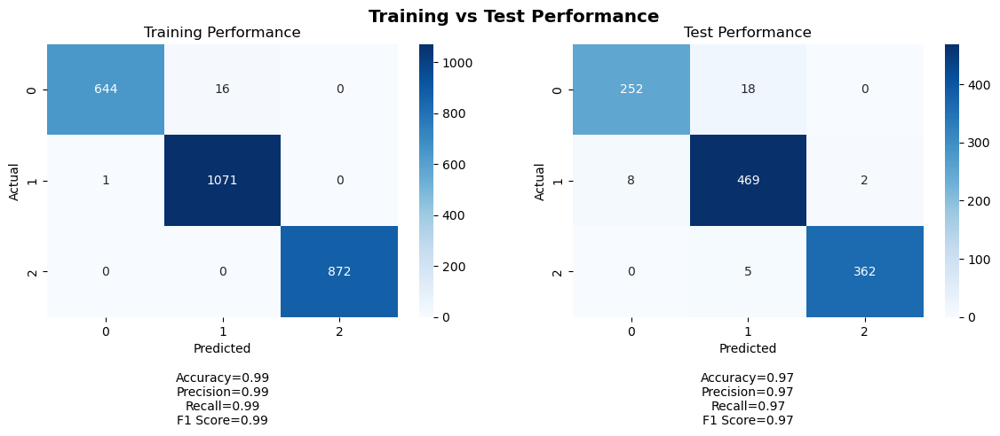

Training Metrics:
Accuracy: 0.9934715821812596
Precision: 0.9935474406122887
Recall: 0.9934715821812596
F1 Score: 0.993456741155409

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9706841825744266
Recall: 0.9704301075268817
F1 Score: 0.9703953937080882

Training Confusion Matrix:
Class 0 - TP: 644, FP: 1, TN: 1943, FN: 16
Class 1 - TP: 1071, FP: 16, TN: 1516, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 252, FP: 8, TN: 838, FN: 18
Class 1 - TP: 469, FP: 23, TN: 614, FN: 10
Class 2 - TP: 362, FP: 2, TN: 747, FN: 5
35/35 [==============================] - 0s 2ms/step


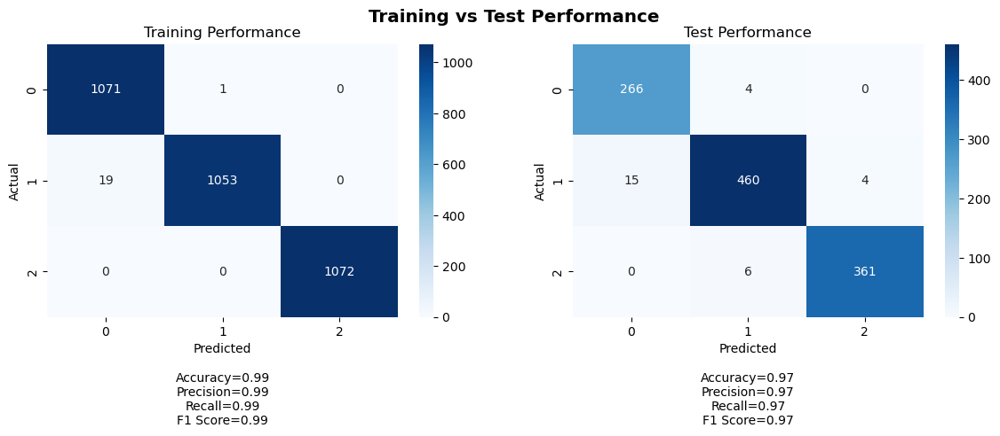

Training Metrics:
Accuracy: 0.9937810945273632
Precision: 0.9938733469120113
Recall: 0.9937810945273632
F1 Score: 0.9937806561581801

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9743492665252494
Recall: 0.9740143369175627
F1 Score: 0.9740488179197745

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 19, TN: 2125, FN: 1
Class 1 - TP: 1053, FP: 1, TN: 2143, FN: 19
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 15, TN: 831, FN: 4
Class 1 - TP: 460, FP: 10, TN: 627, FN: 19
Class 2 - TP: 361, FP: 4, TN: 745, FN: 6
35/35 [==============================] - 0s 1ms/step


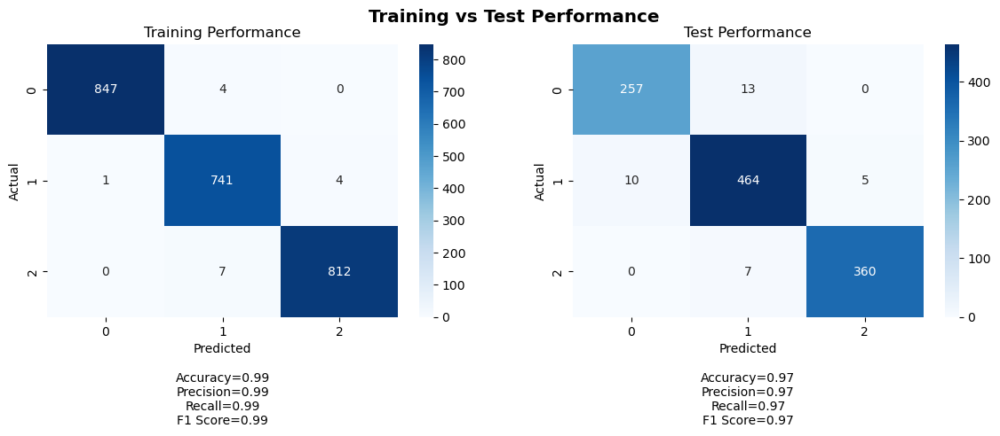

Training Metrics:
Accuracy: 0.9933774834437086
Precision: 0.9934062592463763
Recall: 0.9933774834437086
F1 Score: 0.993384741978114

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9686978985299391
Recall: 0.9686379928315412
F1 Score: 0.9686471529007603

Training Confusion Matrix:
Class 0 - TP: 847, FP: 1, TN: 1564, FN: 4
Class 1 - TP: 741, FP: 11, TN: 1659, FN: 5
Class 2 - TP: 812, FP: 4, TN: 1593, FN: 7

Test Confusion Matrix:
Class 0 - TP: 257, FP: 10, TN: 836, FN: 13
Class 1 - TP: 464, FP: 20, TN: 617, FN: 15
Class 2 - TP: 360, FP: 5, TN: 744, FN: 7
35/35 [==============================] - 0s 1ms/step


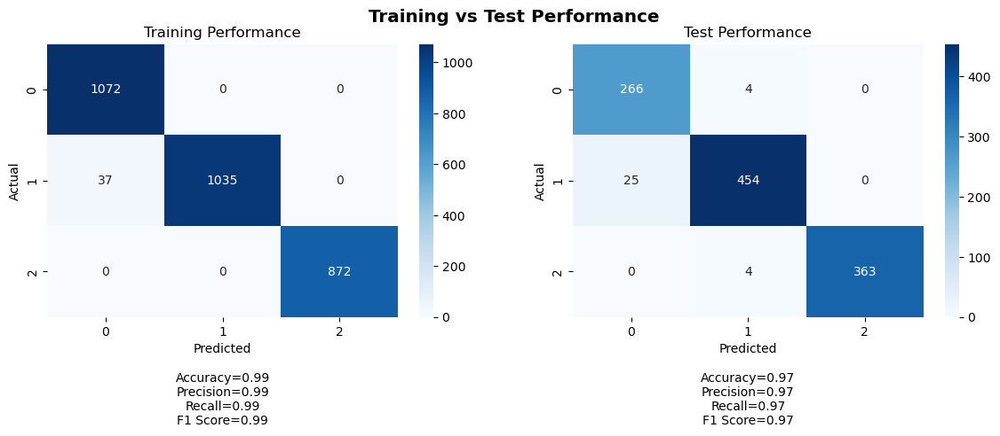

 47%|████▋     | 47/100 [2:54:36<2:07:12, 144.01s/it]

Training Metrics:
Accuracy: 0.9877320954907162
Precision: 0.9881413943787627
Recall: 0.9877320954907162
F1 Score: 0.9877284407747222

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9717829313772114
Recall: 0.9704301075268817
F1 Score: 0.9706395472251025

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 37, TN: 1907, FN: 0
Class 1 - TP: 1035, FP: 0, TN: 1944, FN: 37
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 25, TN: 821, FN: 4
Class 1 - TP: 454, FP: 8, TN: 629, FN: 25
Class 2 - TP: 363, FP: 0, TN: 749, FN: 4
35/35 [==============================] - 0s 2ms/step


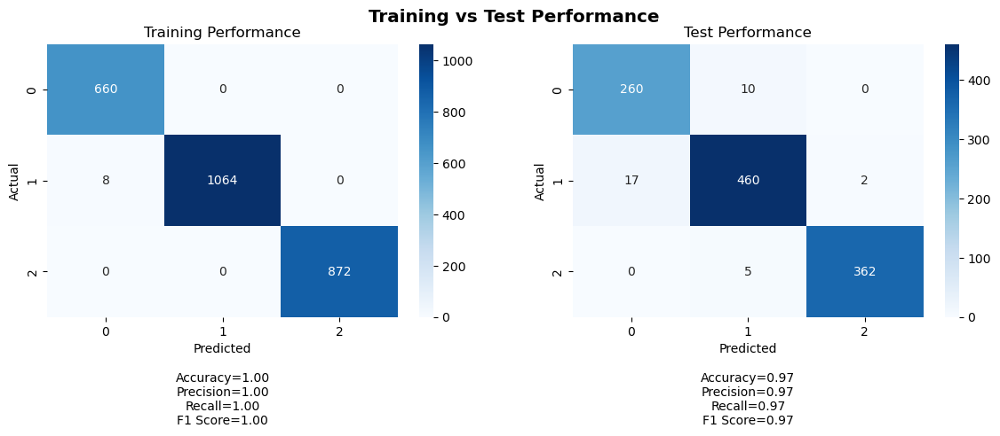

Training Metrics:
Accuracy: 0.9969278033794163
Precision: 0.9969645961533156
Recall: 0.9969278033794163
F1 Score: 0.996931303806503

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9697910426363165
Recall: 0.9695340501792115
F1 Score: 0.9696121127247297

Training Confusion Matrix:
Class 0 - TP: 660, FP: 8, TN: 1936, FN: 0
Class 1 - TP: 1064, FP: 0, TN: 1532, FN: 8
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 17, TN: 829, FN: 10
Class 1 - TP: 460, FP: 15, TN: 622, FN: 19
Class 2 - TP: 362, FP: 2, TN: 747, FN: 5
35/35 [==============================] - 0s 2ms/step


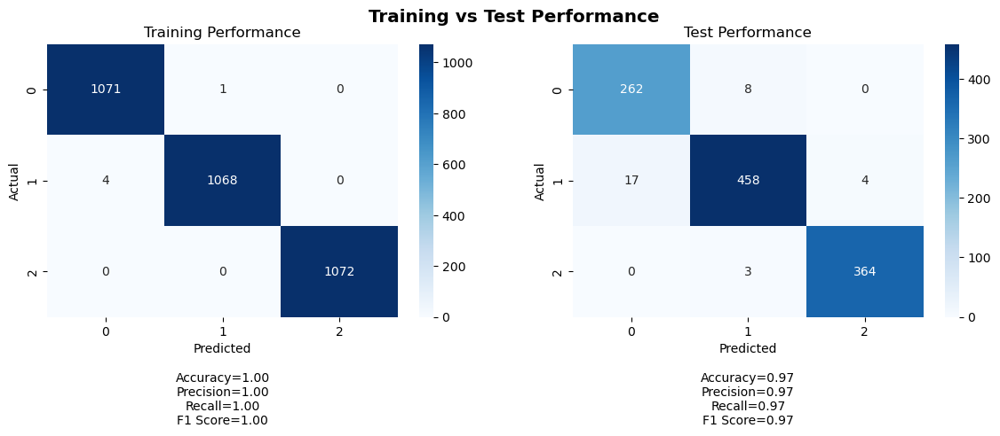

Training Metrics:
Accuracy: 0.9984452736318408
Precision: 0.9984478720241333
Recall: 0.9984452736318408
F1 Score: 0.9984452705878191

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9716171282116186
Recall: 0.9713261648745519
F1 Score: 0.971362816815628

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 4, TN: 2140, FN: 1
Class 1 - TP: 1068, FP: 1, TN: 2143, FN: 4
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 17, TN: 829, FN: 8
Class 1 - TP: 458, FP: 11, TN: 626, FN: 21
Class 2 - TP: 364, FP: 4, TN: 745, FN: 3
35/35 [==============================] - 0s 3ms/step


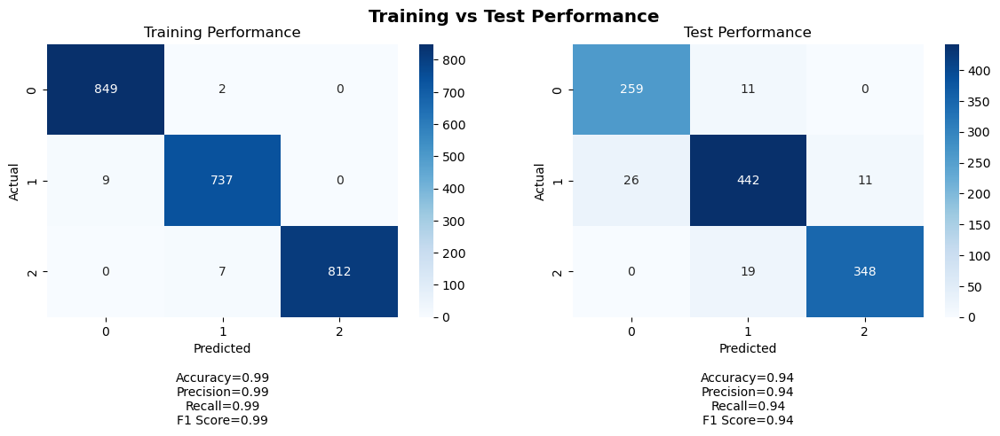

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9925800606678089
Recall: 0.9925496688741722
F1 Score: 0.9925527758008295

Test Metrics:
Accuracy: 0.9399641577060932
Precision: 0.9405720254930152
Recall: 0.9399641577060932
F1 Score: 0.9400431256264443

Training Confusion Matrix:
Class 0 - TP: 849, FP: 9, TN: 1556, FN: 2
Class 1 - TP: 737, FP: 9, TN: 1661, FN: 9
Class 2 - TP: 812, FP: 0, TN: 1597, FN: 7

Test Confusion Matrix:
Class 0 - TP: 259, FP: 26, TN: 820, FN: 11
Class 1 - TP: 442, FP: 30, TN: 607, FN: 37
Class 2 - TP: 348, FP: 11, TN: 738, FN: 19
35/35 [==============================] - 0s 2ms/step


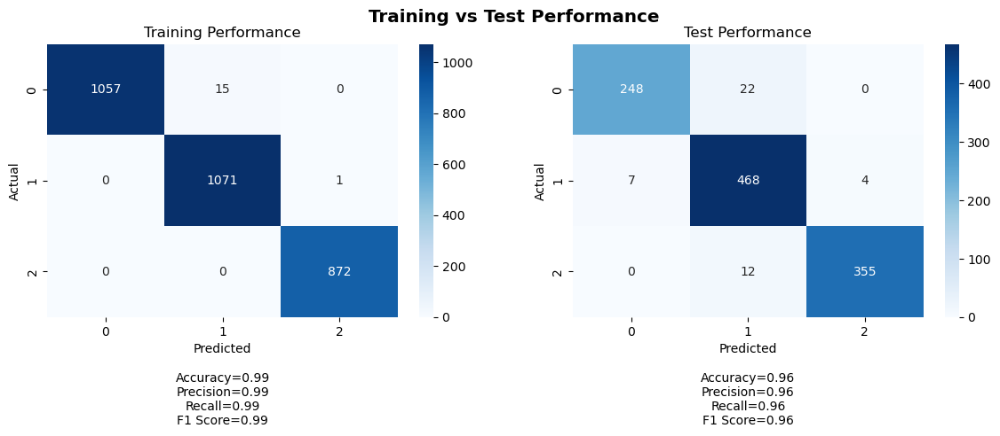

 48%|████▊     | 48/100 [2:56:58<2:04:22, 143.50s/it]

Training Metrics:
Accuracy: 0.9946949602122016
Precision: 0.9947594547881691
Recall: 0.9946949602122016
F1 Score: 0.9946947429477953

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9606244334481807
Recall: 0.9596774193548387
F1 Score: 0.9596998951178509

Training Confusion Matrix:
Class 0 - TP: 1057, FP: 0, TN: 1944, FN: 15
Class 1 - TP: 1071, FP: 15, TN: 1929, FN: 1
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 248, FP: 7, TN: 839, FN: 22
Class 1 - TP: 468, FP: 34, TN: 603, FN: 11
Class 2 - TP: 355, FP: 4, TN: 745, FN: 12
35/35 [==============================] - 0s 1ms/step


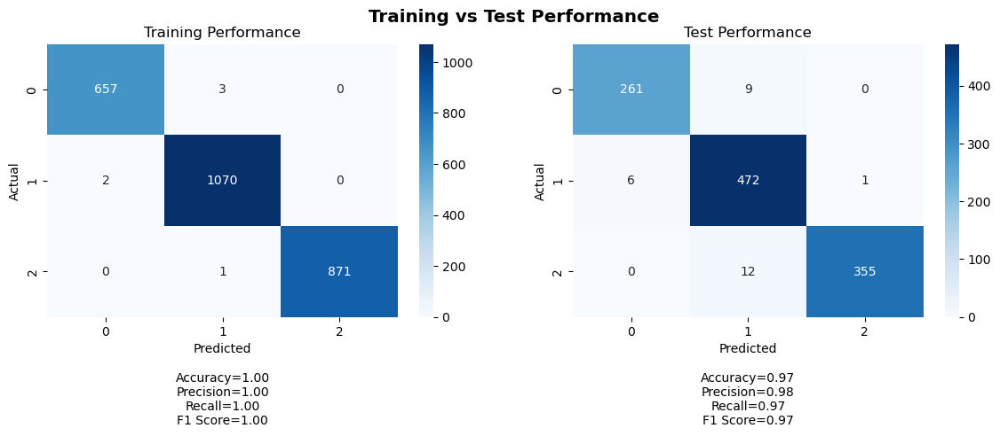

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.997697547576116
Recall: 0.9976958525345622
F1 Score: 0.9976960881959794

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9753566615391038
Recall: 0.974910394265233
F1 Score: 0.9749649221773168

Training Confusion Matrix:
Class 0 - TP: 657, FP: 2, TN: 1942, FN: 3
Class 1 - TP: 1070, FP: 4, TN: 1528, FN: 2
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 261, FP: 6, TN: 840, FN: 9
Class 1 - TP: 472, FP: 21, TN: 616, FN: 7
Class 2 - TP: 355, FP: 1, TN: 748, FN: 12
35/35 [==============================] - 0s 2ms/step


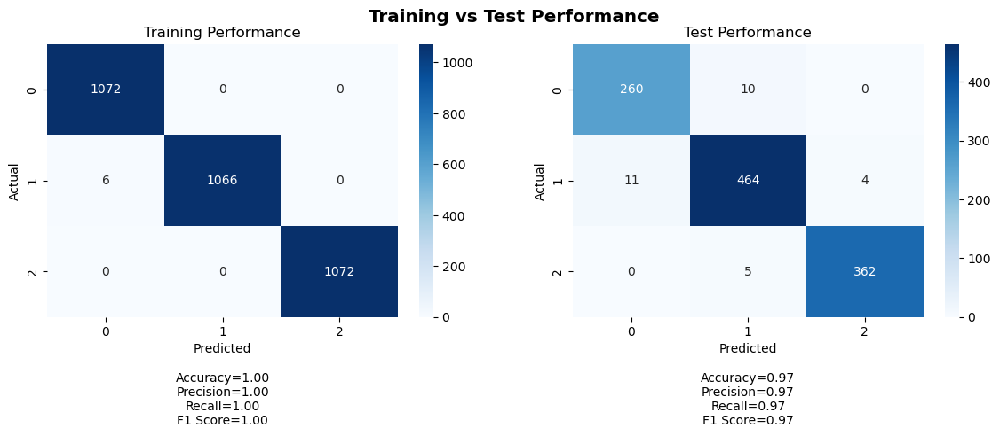

Training Metrics:
Accuracy: 0.9981343283582089
Precision: 0.9981447124304267
Recall: 0.9981343283582089
F1 Score: 0.9981343137468183

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9731448579248705
Recall: 0.9731182795698925
F1 Score: 0.9731301696672148

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 6, TN: 2138, FN: 0
Class 1 - TP: 1066, FP: 0, TN: 2144, FN: 6
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 11, TN: 835, FN: 10
Class 1 - TP: 464, FP: 15, TN: 622, FN: 15
Class 2 - TP: 362, FP: 4, TN: 745, FN: 5
35/35 [==============================] - 0s 1ms/step


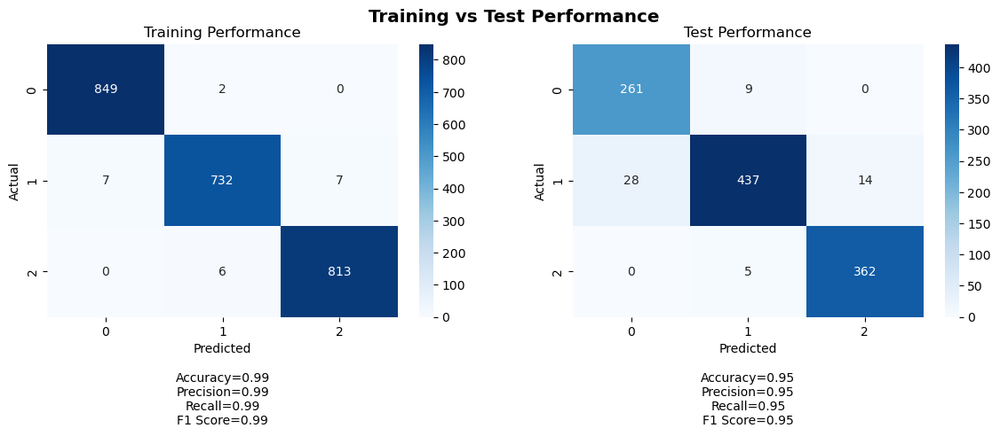

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9908876488290432
Recall: 0.9908940397350994
F1 Score: 0.9908827534422563

Test Metrics:
Accuracy: 0.9498207885304659
Precision: 0.9509917179497479
Recall: 0.9498207885304659
F1 Score: 0.9497319576188753

Training Confusion Matrix:
Class 0 - TP: 849, FP: 7, TN: 1558, FN: 2
Class 1 - TP: 732, FP: 8, TN: 1662, FN: 14
Class 2 - TP: 813, FP: 7, TN: 1590, FN: 6

Test Confusion Matrix:
Class 0 - TP: 261, FP: 28, TN: 818, FN: 9
Class 1 - TP: 437, FP: 14, TN: 623, FN: 42
Class 2 - TP: 362, FP: 14, TN: 735, FN: 5
35/35 [==============================] - 0s 2ms/step


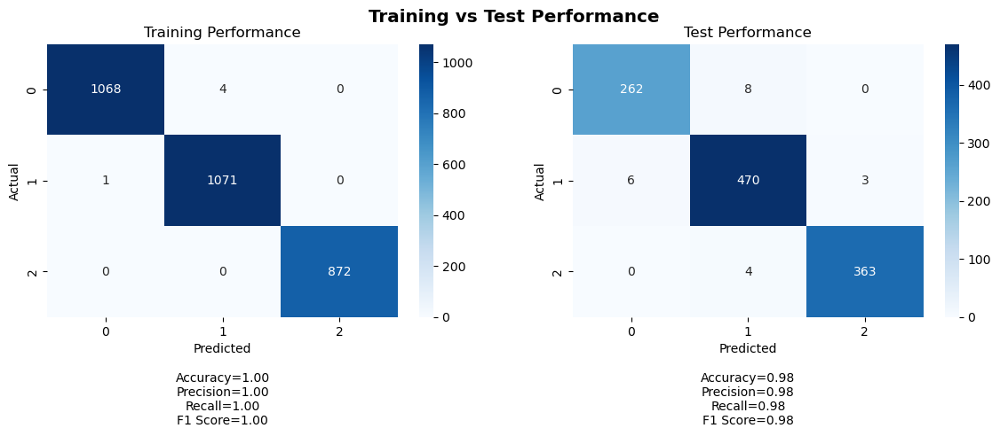

 49%|████▉     | 49/100 [2:59:26<2:03:00, 144.72s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983449457657867
Recall: 0.998342175066313
F1 Score: 0.998342171820433

Test Metrics:
Accuracy: 0.9811827956989247
Precision: 0.9812022544408299
Recall: 0.9811827956989247
F1 Score: 0.9811845709259551

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 1, TN: 1943, FN: 4
Class 1 - TP: 1071, FP: 4, TN: 1940, FN: 1
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 6, TN: 840, FN: 8
Class 1 - TP: 470, FP: 12, TN: 625, FN: 9
Class 2 - TP: 363, FP: 3, TN: 746, FN: 4
35/35 [==============================] - 0s 2ms/step


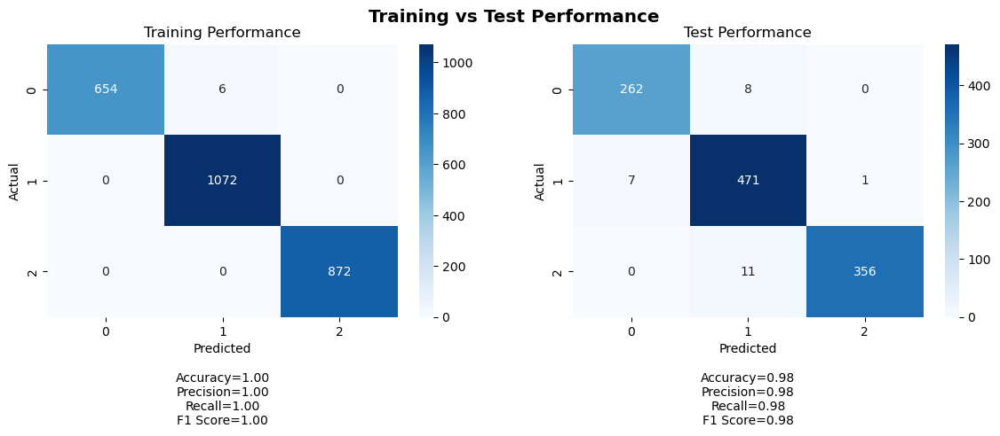

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.9977086771030155
Recall: 0.9976958525345622
F1 Score: 0.9976938070133972

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.97614023037897
Recall: 0.9758064516129032
F1 Score: 0.9758570458683201

Training Confusion Matrix:
Class 0 - TP: 654, FP: 0, TN: 1944, FN: 6
Class 1 - TP: 1072, FP: 6, TN: 1526, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 7, TN: 839, FN: 8
Class 1 - TP: 471, FP: 19, TN: 618, FN: 8
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 4ms/step


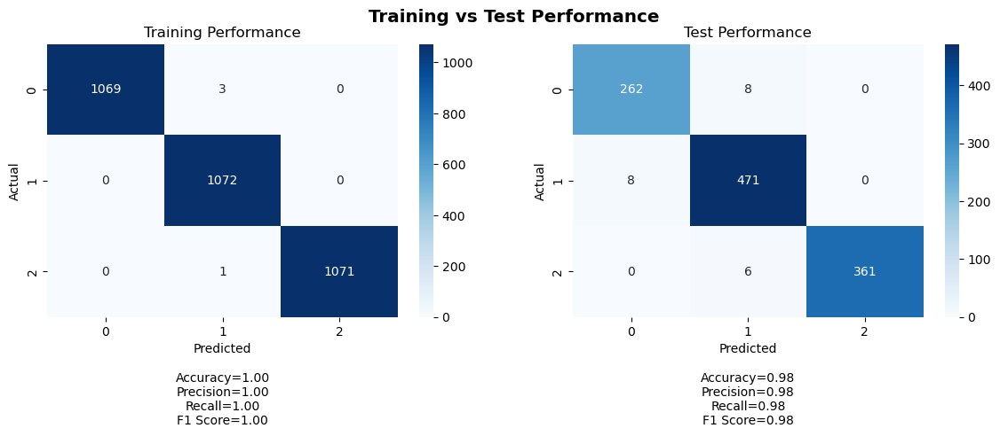

Training Metrics:
Accuracy: 0.9987562189054726
Precision: 0.9987608426270137
Recall: 0.9987562189054726
F1 Score: 0.9987566508878818

Test Metrics:
Accuracy: 0.9802867383512545
Precision: 0.9804419317887891
Recall: 0.9802867383512545
F1 Score: 0.9803259314117968

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 0, TN: 2144, FN: 3
Class 1 - TP: 1072, FP: 4, TN: 2140, FN: 0
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 262, FP: 8, TN: 838, FN: 8
Class 1 - TP: 471, FP: 14, TN: 623, FN: 8
Class 2 - TP: 361, FP: 0, TN: 749, FN: 6
35/35 [==============================] - 0s 2ms/step


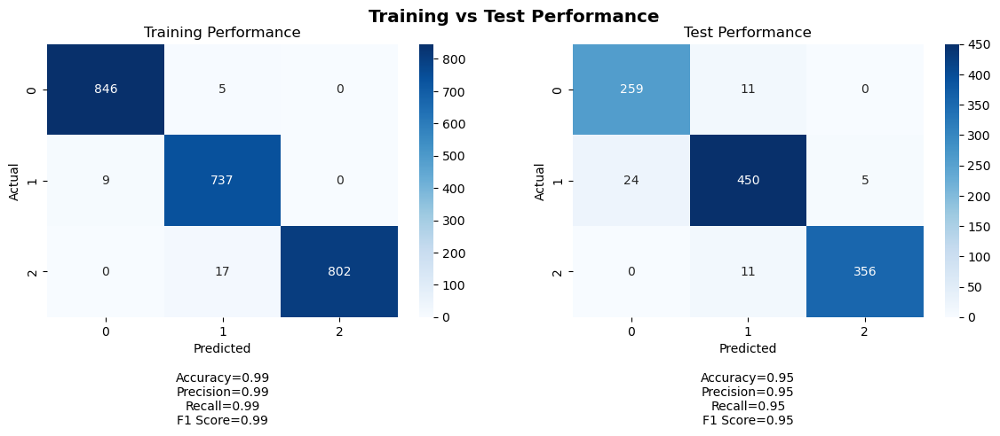

Training Metrics:
Accuracy: 0.9871688741721855
Precision: 0.9873422669111592
Recall: 0.9871688741721855
F1 Score: 0.9871941875826813

Test Metrics:
Accuracy: 0.9543010752688172
Precision: 0.9549221324540481
Recall: 0.9543010752688172
F1 Score: 0.9544424383317618

Training Confusion Matrix:
Class 0 - TP: 846, FP: 9, TN: 1556, FN: 5
Class 1 - TP: 737, FP: 22, TN: 1648, FN: 9
Class 2 - TP: 802, FP: 0, TN: 1597, FN: 17

Test Confusion Matrix:
Class 0 - TP: 259, FP: 24, TN: 822, FN: 11
Class 1 - TP: 450, FP: 22, TN: 615, FN: 29
Class 2 - TP: 356, FP: 5, TN: 744, FN: 11
35/35 [==============================] - 0s 2ms/step


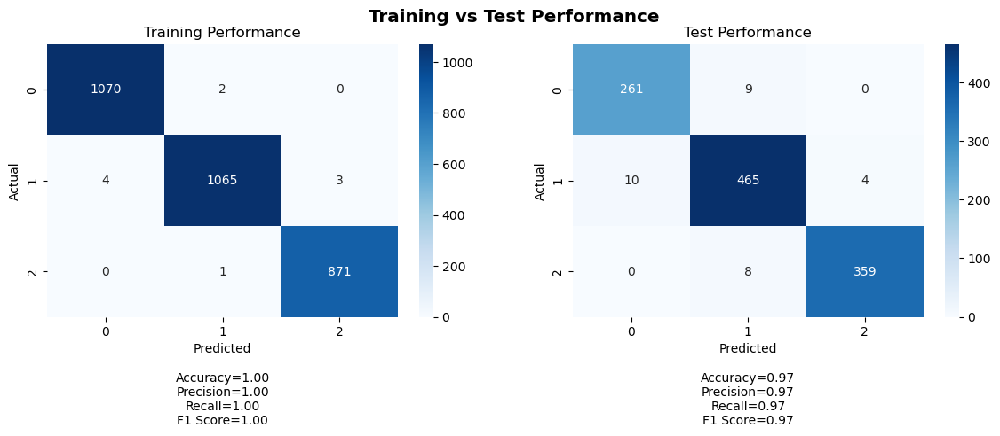

 50%|█████     | 50/100 [3:02:09<2:05:16, 150.33s/it]

Training Metrics:
Accuracy: 0.996684350132626
Precision: 0.9966853706309927
Recall: 0.996684350132626
F1 Score: 0.9966829380158156

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9723106024754911
Recall: 0.9722222222222222
F1 Score: 0.9722518552494467

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 4, TN: 1940, FN: 2
Class 1 - TP: 1065, FP: 3, TN: 1941, FN: 7
Class 2 - TP: 871, FP: 3, TN: 2141, FN: 1

Test Confusion Matrix:
Class 0 - TP: 261, FP: 10, TN: 836, FN: 9
Class 1 - TP: 465, FP: 17, TN: 620, FN: 14
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 2ms/step


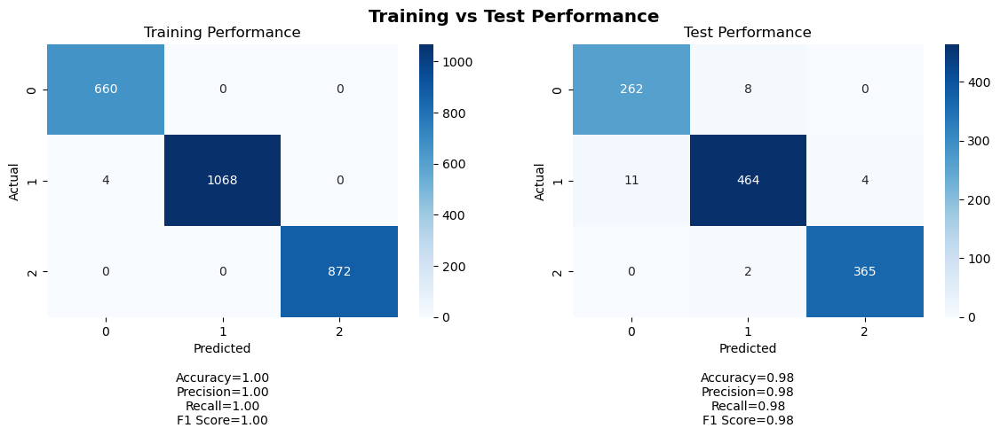

Training Metrics:
Accuracy: 0.9984639016897081
Precision: 0.9984731552939871
Recall: 0.9984639016897081
F1 Score: 0.9984647864740075

Test Metrics:
Accuracy: 0.9775985663082437
Precision: 0.9776317868329872
Recall: 0.9775985663082437
F1 Score: 0.9775941361920248

Training Confusion Matrix:
Class 0 - TP: 660, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1068, FP: 0, TN: 1532, FN: 4
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 11, TN: 835, FN: 8
Class 1 - TP: 464, FP: 10, TN: 627, FN: 15
Class 2 - TP: 365, FP: 4, TN: 745, FN: 2
35/35 [==============================] - 0s 2ms/step


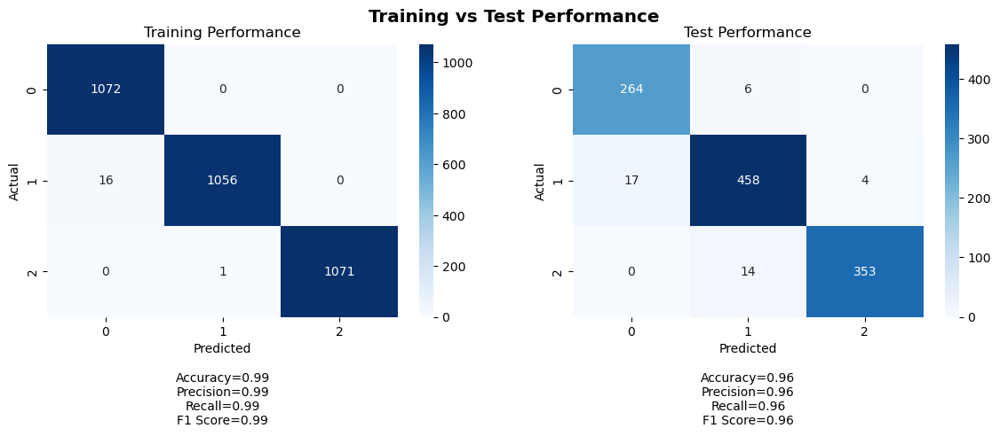

Training Metrics:
Accuracy: 0.9947139303482587
Precision: 0.9947826812844344
Recall: 0.9947139303482587
F1 Score: 0.9947136625219096

Test Metrics:
Accuracy: 0.9632616487455197
Precision: 0.9637200668503002
Recall: 0.9632616487455197
F1 Score: 0.9633367850154474

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 16, TN: 2128, FN: 0
Class 1 - TP: 1056, FP: 1, TN: 2143, FN: 16
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 264, FP: 17, TN: 829, FN: 6
Class 1 - TP: 458, FP: 20, TN: 617, FN: 21
Class 2 - TP: 353, FP: 4, TN: 745, FN: 14
35/35 [==============================] - 0s 2ms/step


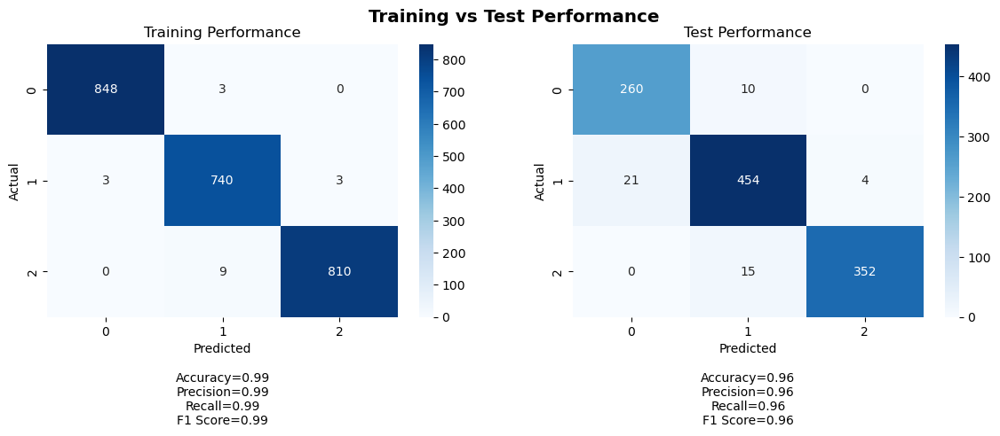

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9925801342961295
Recall: 0.9925496688741722
F1 Score: 0.9925554591227467

Test Metrics:
Accuracy: 0.9551971326164874
Precision: 0.9558230004940158
Recall: 0.9551971326164874
F1 Score: 0.9553448931305866

Training Confusion Matrix:
Class 0 - TP: 848, FP: 3, TN: 1562, FN: 3
Class 1 - TP: 740, FP: 12, TN: 1658, FN: 6
Class 2 - TP: 810, FP: 3, TN: 1594, FN: 9

Test Confusion Matrix:
Class 0 - TP: 260, FP: 21, TN: 825, FN: 10
Class 1 - TP: 454, FP: 25, TN: 612, FN: 25
Class 2 - TP: 352, FP: 4, TN: 745, FN: 15
35/35 [==============================] - 0s 2ms/step


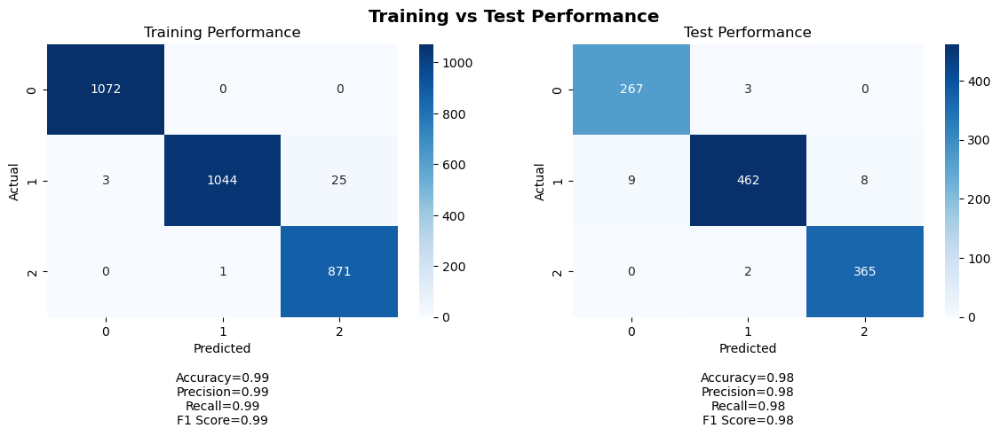

 51%|█████     | 51/100 [3:04:42<2:03:21, 151.05s/it]

Training Metrics:
Accuracy: 0.9903846153846154
Precision: 0.9906008546517215
Recall: 0.9903846153846154
F1 Score: 0.9903825049831632

Test Metrics:
Accuracy: 0.9802867383512545
Precision: 0.9804622391071713
Recall: 0.9802867383512545
F1 Score: 0.980257114446912

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 3, TN: 1941, FN: 0
Class 1 - TP: 1044, FP: 1, TN: 1943, FN: 28
Class 2 - TP: 871, FP: 25, TN: 2119, FN: 1

Test Confusion Matrix:
Class 0 - TP: 267, FP: 9, TN: 837, FN: 3
Class 1 - TP: 462, FP: 5, TN: 632, FN: 17
Class 2 - TP: 365, FP: 8, TN: 741, FN: 2
35/35 [==============================] - 0s 2ms/step


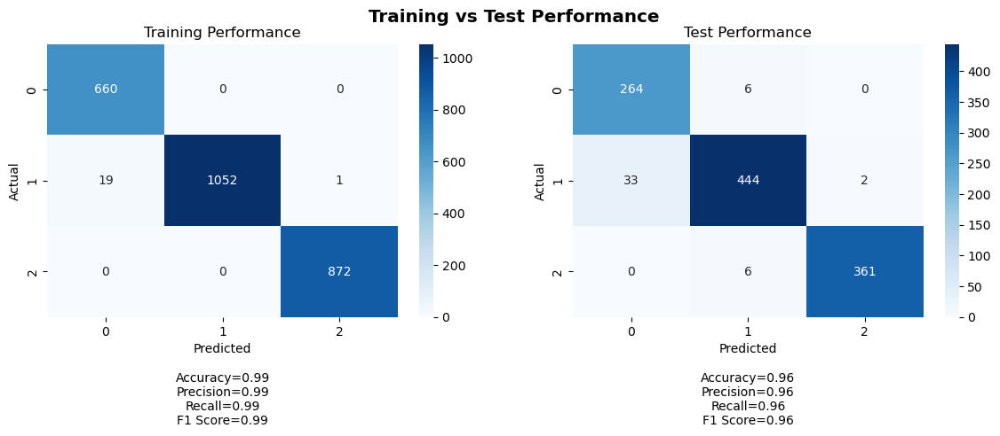

Training Metrics:
Accuracy: 0.9923195084485407
Precision: 0.99252412046369
Recall: 0.9923195084485407
F1 Score: 0.9923352252939689

Test Metrics:
Accuracy: 0.9578853046594982
Precision: 0.9600113783822689
Recall: 0.9578853046594982
F1 Score: 0.958179730066346

Training Confusion Matrix:
Class 0 - TP: 660, FP: 19, TN: 1925, FN: 0
Class 1 - TP: 1052, FP: 0, TN: 1532, FN: 20
Class 2 - TP: 872, FP: 1, TN: 1731, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 33, TN: 813, FN: 6
Class 1 - TP: 444, FP: 12, TN: 625, FN: 35
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


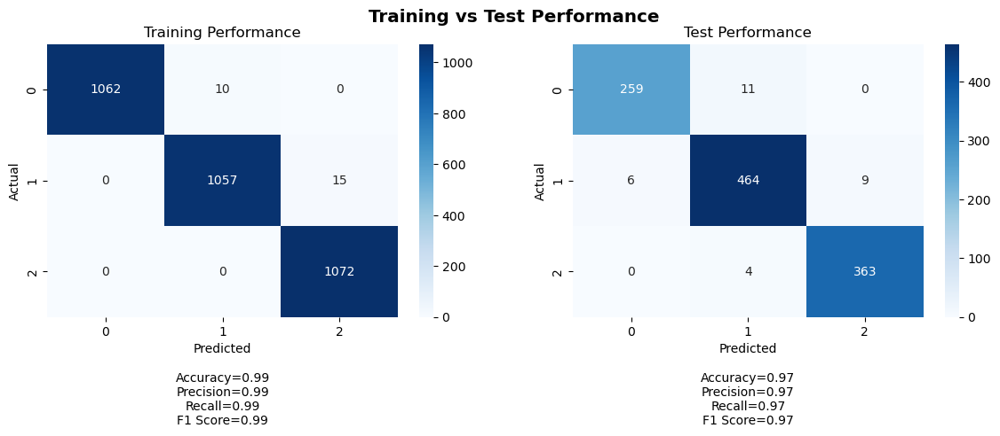

Training Metrics:
Accuracy: 0.992226368159204
Precision: 0.9922761602500599
Recall: 0.992226368159204
F1 Score: 0.9922261996323849

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9731252331494314
Recall: 0.9731182795698925
F1 Score: 0.9730865045670107

Training Confusion Matrix:
Class 0 - TP: 1062, FP: 0, TN: 2144, FN: 10
Class 1 - TP: 1057, FP: 10, TN: 2134, FN: 15
Class 2 - TP: 1072, FP: 15, TN: 2129, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 6, TN: 840, FN: 11
Class 1 - TP: 464, FP: 15, TN: 622, FN: 15
Class 2 - TP: 363, FP: 9, TN: 740, FN: 4
35/35 [==============================] - 0s 2ms/step


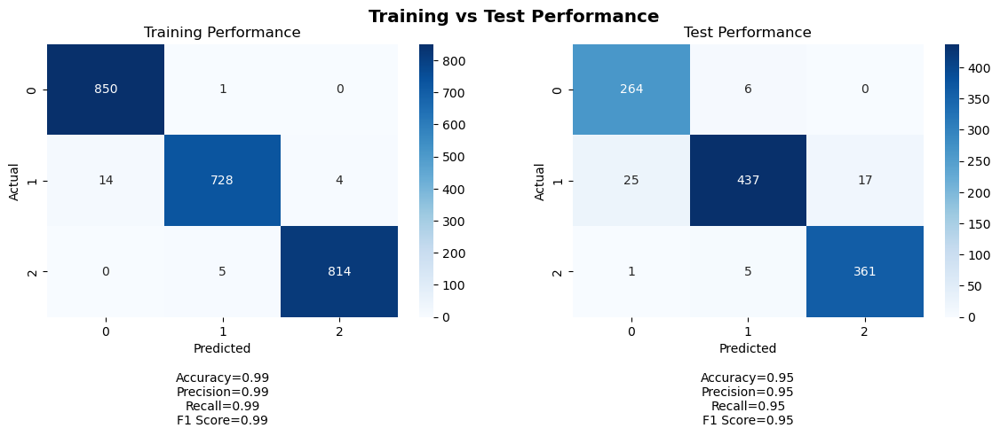

Training Metrics:
Accuracy: 0.9900662251655629
Precision: 0.9901107887125604
Recall: 0.9900662251655629
F1 Score: 0.990048346475035

Test Metrics:
Accuracy: 0.9516129032258065
Precision: 0.9529808707246408
Recall: 0.9516129032258065
F1 Score: 0.951483006462264

Training Confusion Matrix:
Class 0 - TP: 850, FP: 14, TN: 1551, FN: 1
Class 1 - TP: 728, FP: 6, TN: 1664, FN: 18
Class 2 - TP: 814, FP: 4, TN: 1593, FN: 5

Test Confusion Matrix:
Class 0 - TP: 264, FP: 26, TN: 820, FN: 6
Class 1 - TP: 437, FP: 11, TN: 626, FN: 42
Class 2 - TP: 361, FP: 17, TN: 732, FN: 6
35/35 [==============================] - 0s 2ms/step


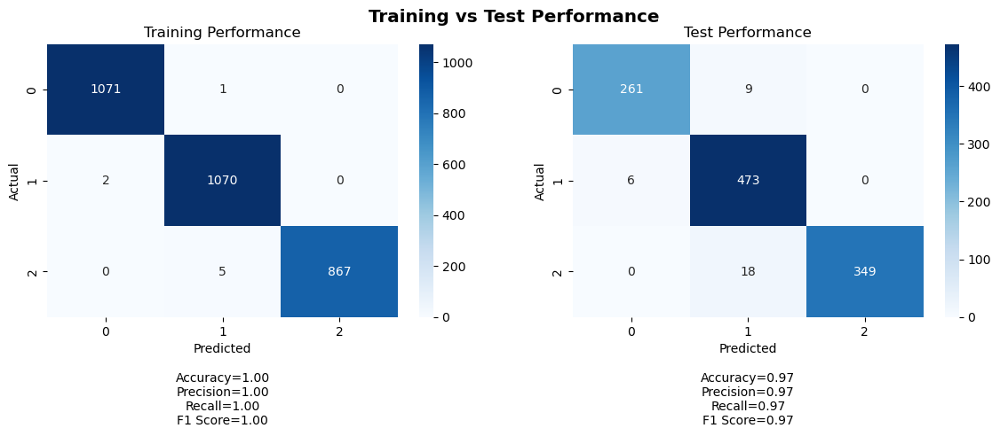

 52%|█████▏    | 52/100 [3:07:12<2:00:33, 150.69s/it]

Training Metrics:
Accuracy: 0.9973474801061007
Precision: 0.9973554936225506
Recall: 0.9973474801061007
F1 Score: 0.9973477984254536

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9713858281986226
Recall: 0.9704301075268817
F1 Score: 0.9705069678850256

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 2, TN: 1942, FN: 1
Class 1 - TP: 1070, FP: 6, TN: 1938, FN: 2
Class 2 - TP: 867, FP: 0, TN: 2144, FN: 5

Test Confusion Matrix:
Class 0 - TP: 261, FP: 6, TN: 840, FN: 9
Class 1 - TP: 473, FP: 27, TN: 610, FN: 6
Class 2 - TP: 349, FP: 0, TN: 749, FN: 18
35/35 [==============================] - 0s 2ms/step


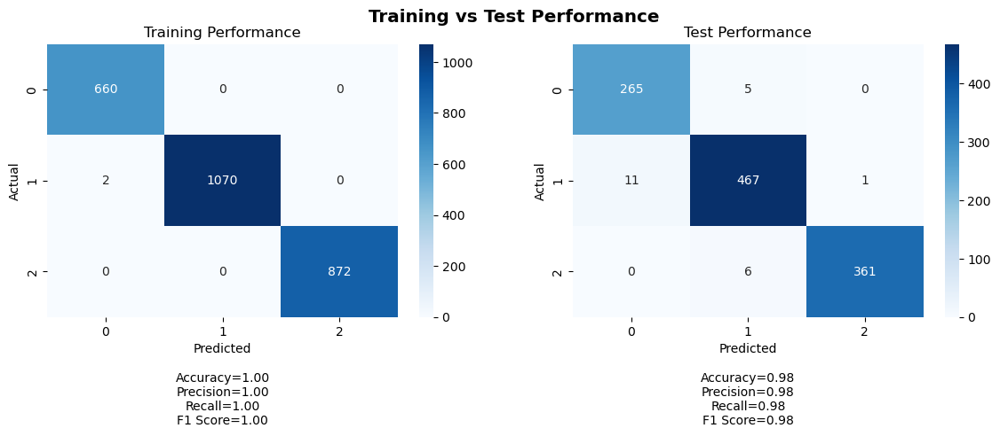

Training Metrics:
Accuracy: 0.999231950844854
Precision: 0.9992342712350508
Recall: 0.999231950844854
F1 Score: 0.9992321732536437

Test Metrics:
Accuracy: 0.9793906810035843
Precision: 0.979571958537442
Recall: 0.9793906810035843
F1 Score: 0.9794371773136474

Training Confusion Matrix:
Class 0 - TP: 660, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1070, FP: 0, TN: 1532, FN: 2
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 11, TN: 835, FN: 5
Class 1 - TP: 467, FP: 11, TN: 626, FN: 12
Class 2 - TP: 361, FP: 1, TN: 748, FN: 6
35/35 [==============================] - 0s 2ms/step


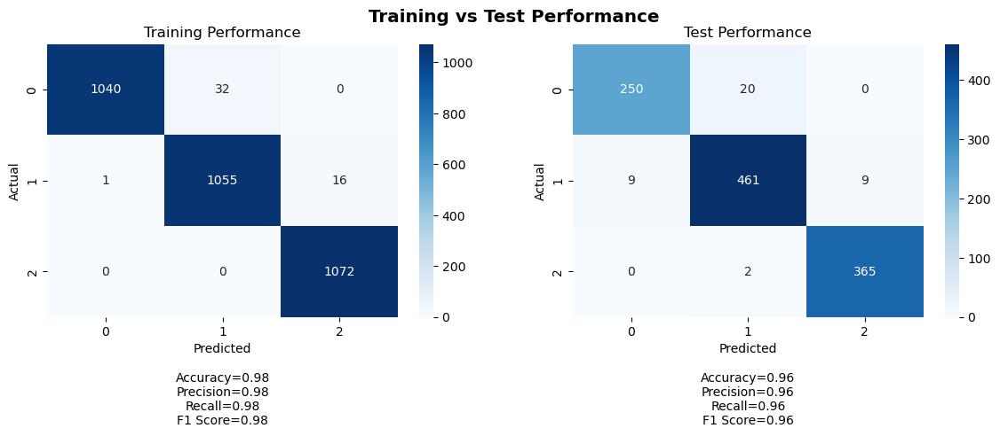

Training Metrics:
Accuracy: 0.9847636815920398
Precision: 0.9849648934688295
Recall: 0.9847636815920398
F1 Score: 0.984759764947288

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9641293946528664
Recall: 0.96415770609319
F1 Score: 0.9640086062822043

Training Confusion Matrix:
Class 0 - TP: 1040, FP: 1, TN: 2143, FN: 32
Class 1 - TP: 1055, FP: 32, TN: 2112, FN: 17
Class 2 - TP: 1072, FP: 16, TN: 2128, FN: 0

Test Confusion Matrix:
Class 0 - TP: 250, FP: 9, TN: 837, FN: 20
Class 1 - TP: 461, FP: 22, TN: 615, FN: 18
Class 2 - TP: 365, FP: 9, TN: 740, FN: 2
35/35 [==============================] - 0s 2ms/step


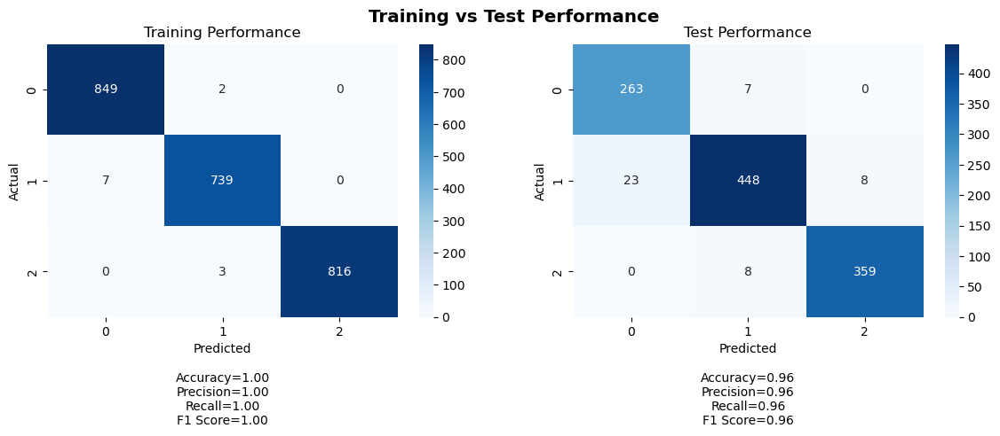

Training Metrics:
Accuracy: 0.9950331125827815
Precision: 0.995044473091992
Recall: 0.9950331125827815
F1 Score: 0.9950340956268539

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9594698519313584
Recall: 0.9587813620071685
F1 Score: 0.9588180972241589

Training Confusion Matrix:
Class 0 - TP: 849, FP: 7, TN: 1558, FN: 2
Class 1 - TP: 739, FP: 5, TN: 1665, FN: 7
Class 2 - TP: 816, FP: 0, TN: 1597, FN: 3

Test Confusion Matrix:
Class 0 - TP: 263, FP: 23, TN: 823, FN: 7
Class 1 - TP: 448, FP: 15, TN: 622, FN: 31
Class 2 - TP: 359, FP: 8, TN: 741, FN: 8
35/35 [==============================] - 0s 2ms/step


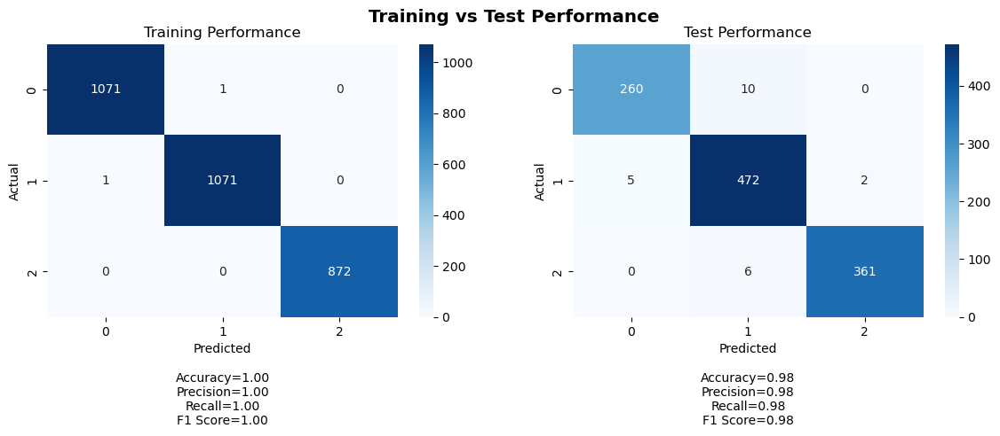

 53%|█████▎    | 53/100 [3:09:47<1:59:02, 151.96s/it]

Training Metrics:
Accuracy: 0.9993368700265252
Precision: 0.9993368700265252
Recall: 0.9993368700265252
F1 Score: 0.9993368700265252

Test Metrics:
Accuracy: 0.9793906810035843
Precision: 0.9795508098360918
Recall: 0.9793906810035843
F1 Score: 0.9794041404943978

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 1 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 5, TN: 841, FN: 10
Class 1 - TP: 472, FP: 16, TN: 621, FN: 7
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 3ms/step


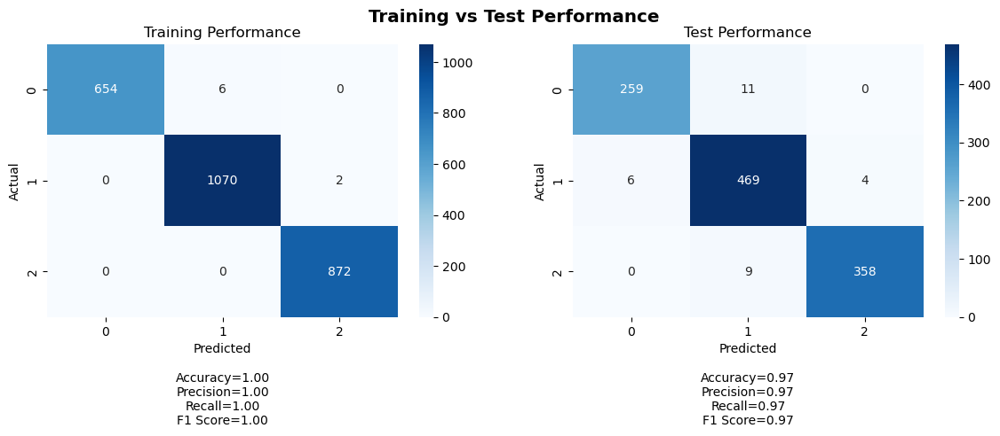

Training Metrics:
Accuracy: 0.9969278033794163
Precision: 0.9969381265329311
Recall: 0.9969278033794163
F1 Score: 0.9969258431777293

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9733338188073978
Recall: 0.9731182795698925
F1 Score: 0.9731460016189013

Training Confusion Matrix:
Class 0 - TP: 654, FP: 0, TN: 1944, FN: 6
Class 1 - TP: 1070, FP: 6, TN: 1526, FN: 2
Class 2 - TP: 872, FP: 2, TN: 1730, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 6, TN: 840, FN: 11
Class 1 - TP: 469, FP: 20, TN: 617, FN: 10
Class 2 - TP: 358, FP: 4, TN: 745, FN: 9
35/35 [==============================] - 0s 1ms/step


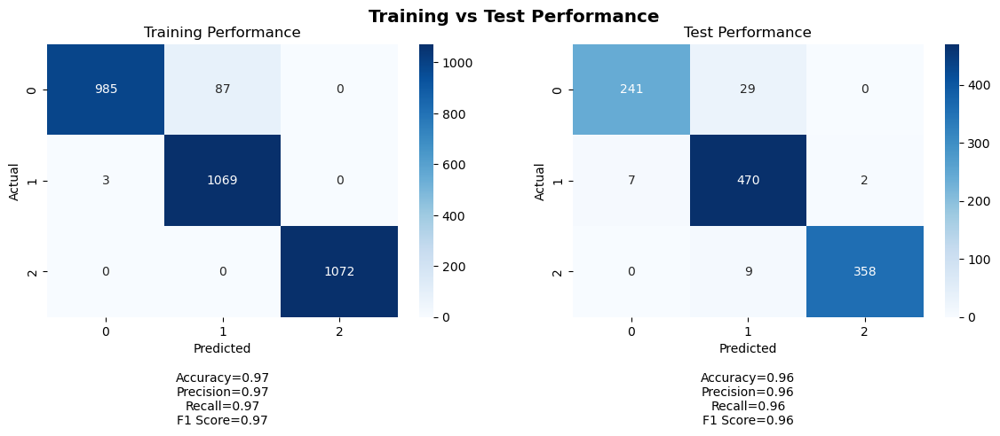

Training Metrics:
Accuracy: 0.9720149253731343
Precision: 0.9739013490607007
Recall: 0.9720149253731343
F1 Score: 0.9719719021805443

Test Metrics:
Accuracy: 0.9578853046594982
Precision: 0.9592378447202136
Recall: 0.9578853046594982
F1 Score: 0.9577715412786629

Training Confusion Matrix:
Class 0 - TP: 985, FP: 3, TN: 2141, FN: 87
Class 1 - TP: 1069, FP: 87, TN: 2057, FN: 3
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 241, FP: 7, TN: 839, FN: 29
Class 1 - TP: 470, FP: 38, TN: 599, FN: 9
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 2ms/step


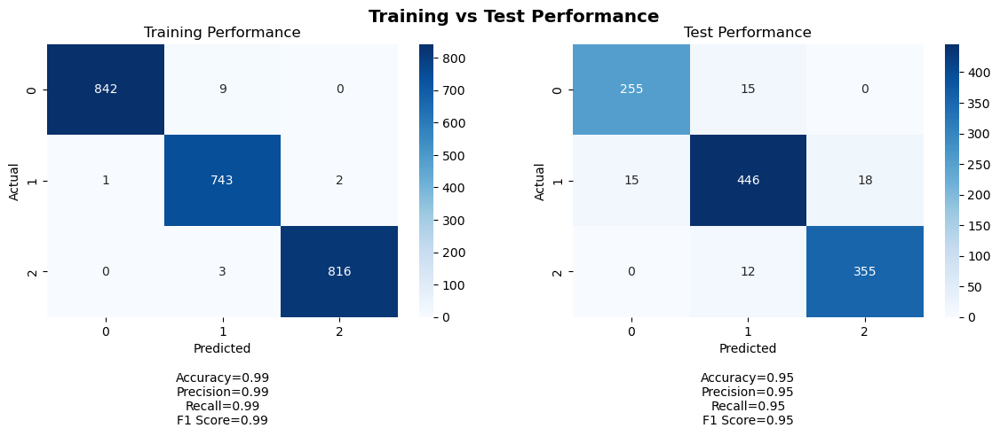

Training Metrics:
Accuracy: 0.9937913907284768
Precision: 0.9938456587139394
Recall: 0.9937913907284768
F1 Score: 0.9937995985452105

Test Metrics:
Accuracy: 0.946236559139785
Precision: 0.9461891124743166
Recall: 0.946236559139785
F1 Score: 0.9461761164797219

Training Confusion Matrix:
Class 0 - TP: 842, FP: 1, TN: 1564, FN: 9
Class 1 - TP: 743, FP: 12, TN: 1658, FN: 3
Class 2 - TP: 816, FP: 2, TN: 1595, FN: 3

Test Confusion Matrix:
Class 0 - TP: 255, FP: 15, TN: 831, FN: 15
Class 1 - TP: 446, FP: 27, TN: 610, FN: 33
Class 2 - TP: 355, FP: 18, TN: 731, FN: 12
35/35 [==============================] - 0s 1ms/step


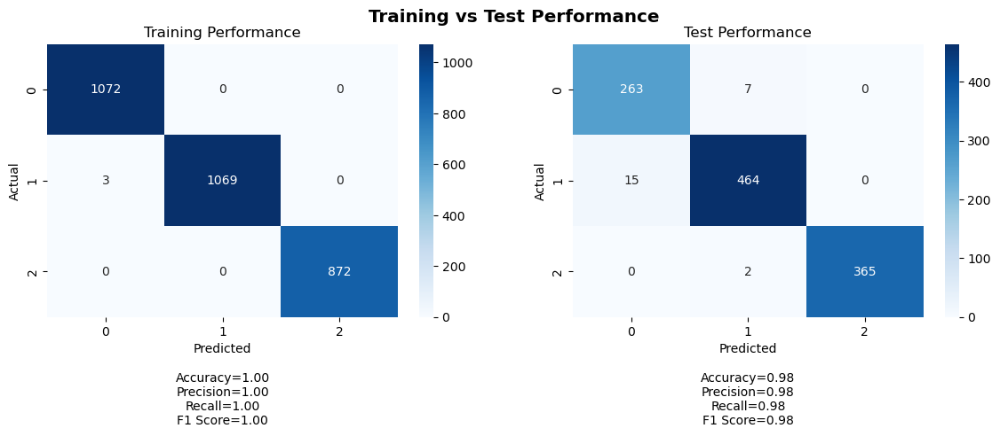

 54%|█████▍    | 54/100 [3:12:15<1:55:44, 150.97s/it]

Training Metrics:
Accuracy: 0.9990053050397878
Precision: 0.9990080809327001
Recall: 0.9990053050397878
F1 Score: 0.9990053030922598

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.978779112698384
Recall: 0.978494623655914
F1 Score: 0.9785682987894874

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 3, TN: 1941, FN: 0
Class 1 - TP: 1069, FP: 0, TN: 1944, FN: 3
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 15, TN: 831, FN: 7
Class 1 - TP: 464, FP: 9, TN: 628, FN: 15
Class 2 - TP: 365, FP: 0, TN: 749, FN: 2
35/35 [==============================] - 0s 3ms/step


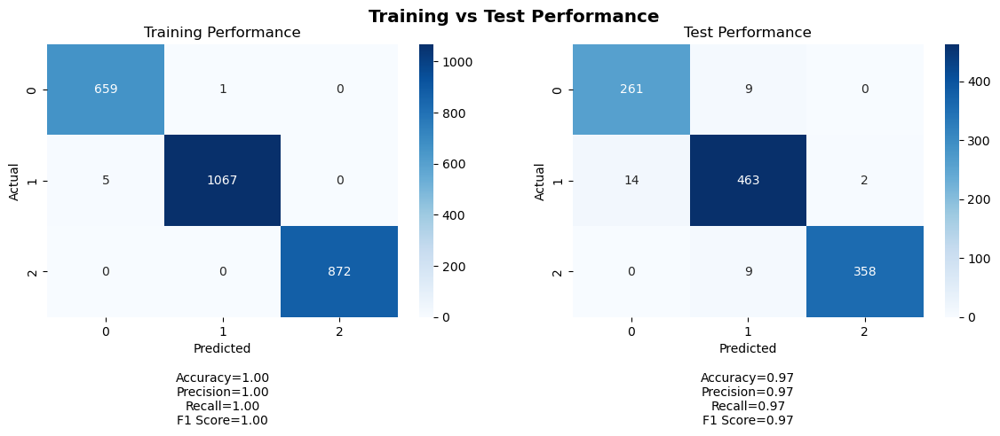

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.9977059812456128
Recall: 0.9976958525345622
F1 Score: 0.9976971797110112

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9697943554126351
Recall: 0.9695340501792115
F1 Score: 0.9696128708734885

Training Confusion Matrix:
Class 0 - TP: 659, FP: 5, TN: 1939, FN: 1
Class 1 - TP: 1067, FP: 1, TN: 1531, FN: 5
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 14, TN: 832, FN: 9
Class 1 - TP: 463, FP: 18, TN: 619, FN: 16
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 1ms/step


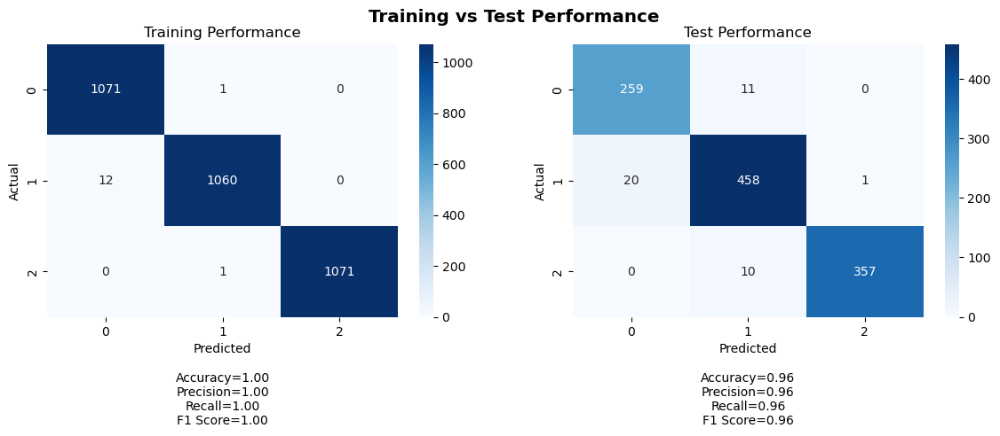

Training Metrics:
Accuracy: 0.9956467661691543
Precision: 0.9956788094728842
Recall: 0.9956467661691543
F1 Score: 0.9956468106614478

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9629211663311095
Recall: 0.9623655913978495
F1 Score: 0.9625320990130706

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 12, TN: 2132, FN: 1
Class 1 - TP: 1060, FP: 2, TN: 2142, FN: 12
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 259, FP: 20, TN: 826, FN: 11
Class 1 - TP: 458, FP: 21, TN: 616, FN: 21
Class 2 - TP: 357, FP: 1, TN: 748, FN: 10
35/35 [==============================] - 0s 3ms/step


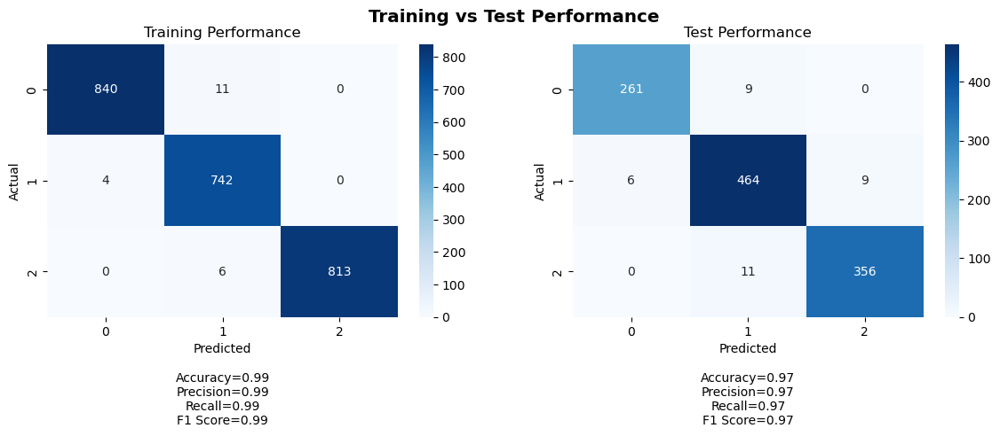

Training Metrics:
Accuracy: 0.9913079470198676
Precision: 0.9914147339569825
Recall: 0.9913079470198676
F1 Score: 0.9913281021570061

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9687185311571843
Recall: 0.9686379928315412
F1 Score: 0.968657383552164

Training Confusion Matrix:
Class 0 - TP: 840, FP: 4, TN: 1561, FN: 11
Class 1 - TP: 742, FP: 17, TN: 1653, FN: 4
Class 2 - TP: 813, FP: 0, TN: 1597, FN: 6

Test Confusion Matrix:
Class 0 - TP: 261, FP: 6, TN: 840, FN: 9
Class 1 - TP: 464, FP: 20, TN: 617, FN: 15
Class 2 - TP: 356, FP: 9, TN: 740, FN: 11
35/35 [==============================] - 0s 2ms/step


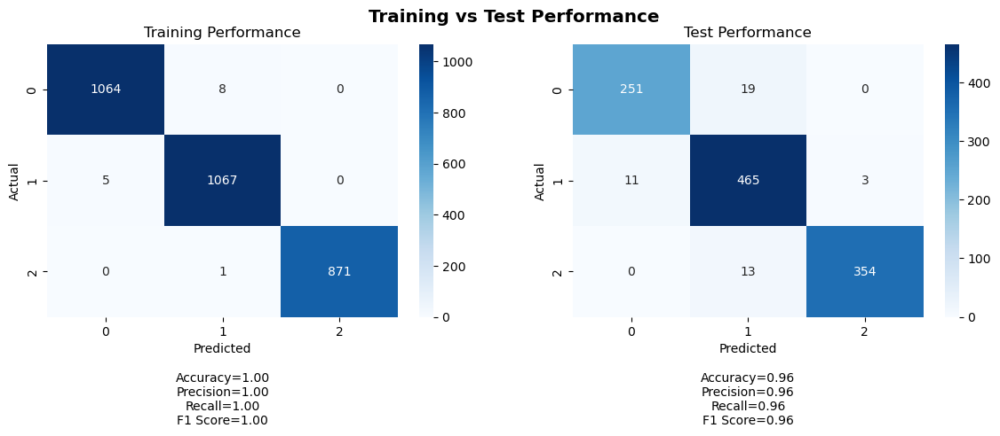

 55%|█████▌    | 55/100 [3:14:50<1:53:58, 151.96s/it]

Training Metrics:
Accuracy: 0.9953580901856764
Precision: 0.9953645309826408
Recall: 0.9953580901856764
F1 Score: 0.995359297289957

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9594435862421982
Recall: 0.9587813620071685
F1 Score: 0.958860321846349

Training Confusion Matrix:
Class 0 - TP: 1064, FP: 5, TN: 1939, FN: 8
Class 1 - TP: 1067, FP: 9, TN: 1935, FN: 5
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 251, FP: 11, TN: 835, FN: 19
Class 1 - TP: 465, FP: 32, TN: 605, FN: 14
Class 2 - TP: 354, FP: 3, TN: 746, FN: 13
35/35 [==============================] - 0s 2ms/step


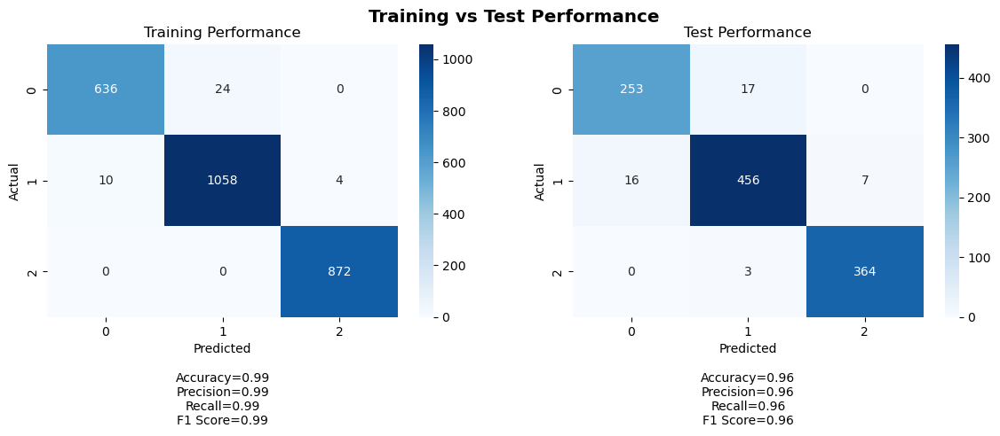

Training Metrics:
Accuracy: 0.9854070660522274
Precision: 0.9854160361114391
Recall: 0.9854070660522274
F1 Score: 0.9853727145966104

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.961370915523335
Recall: 0.9614695340501792
F1 Score: 0.9614058680636999

Training Confusion Matrix:
Class 0 - TP: 636, FP: 10, TN: 1934, FN: 24
Class 1 - TP: 1058, FP: 24, TN: 1508, FN: 14
Class 2 - TP: 872, FP: 4, TN: 1728, FN: 0

Test Confusion Matrix:
Class 0 - TP: 253, FP: 16, TN: 830, FN: 17
Class 1 - TP: 456, FP: 20, TN: 617, FN: 23
Class 2 - TP: 364, FP: 7, TN: 742, FN: 3
35/35 [==============================] - 0s 2ms/step


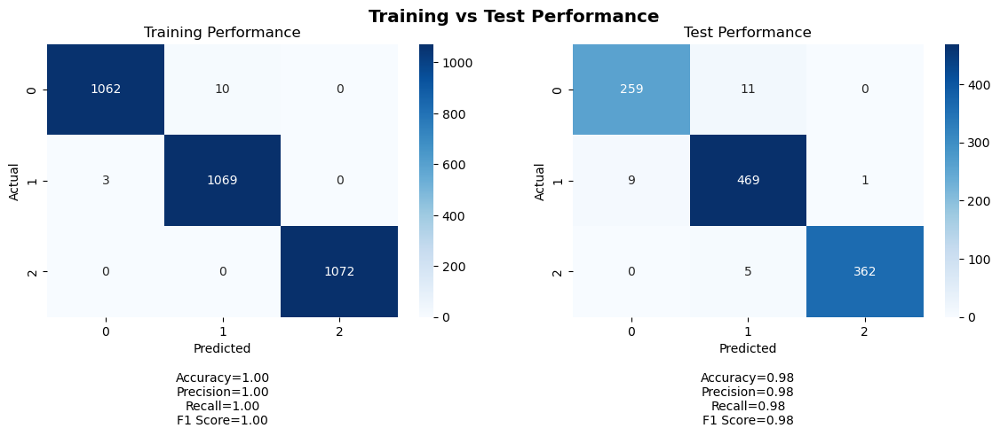

Training Metrics:
Accuracy: 0.9959577114427861
Precision: 0.9959717526661358
Recall: 0.9959577114427861
F1 Score: 0.9959576683525911

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9768098160228305
Recall: 0.9767025089605734
F1 Score: 0.9767269711341547

Training Confusion Matrix:
Class 0 - TP: 1062, FP: 3, TN: 2141, FN: 10
Class 1 - TP: 1069, FP: 10, TN: 2134, FN: 3
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 9, TN: 837, FN: 11
Class 1 - TP: 469, FP: 16, TN: 621, FN: 10
Class 2 - TP: 362, FP: 1, TN: 748, FN: 5
35/35 [==============================] - 0s 2ms/step


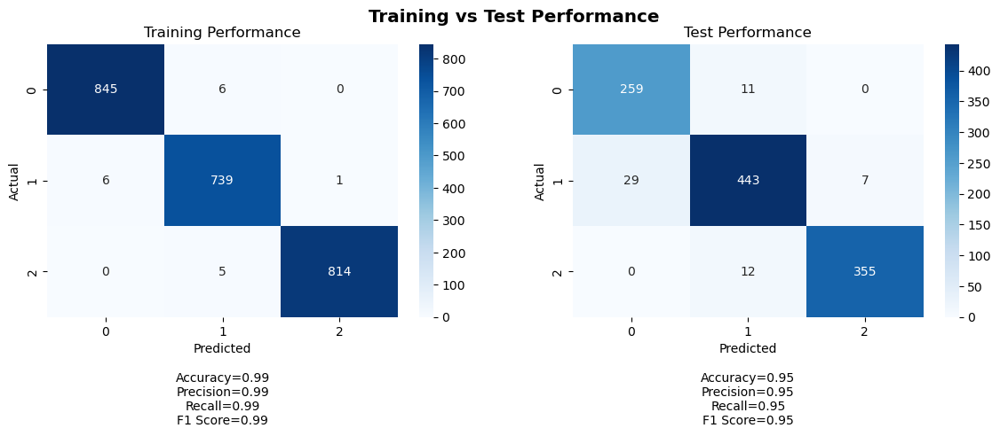

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9925719199880824
Recall: 0.9925496688741722
F1 Score: 0.9925565894991202

Test Metrics:
Accuracy: 0.9471326164874552
Precision: 0.9480951469675982
Recall: 0.9471326164874552
F1 Score: 0.9472886948334764

Training Confusion Matrix:
Class 0 - TP: 845, FP: 6, TN: 1559, FN: 6
Class 1 - TP: 739, FP: 11, TN: 1659, FN: 7
Class 2 - TP: 814, FP: 1, TN: 1596, FN: 5

Test Confusion Matrix:
Class 0 - TP: 259, FP: 29, TN: 817, FN: 11
Class 1 - TP: 443, FP: 23, TN: 614, FN: 36
Class 2 - TP: 355, FP: 7, TN: 742, FN: 12
35/35 [==============================] - 0s 2ms/step


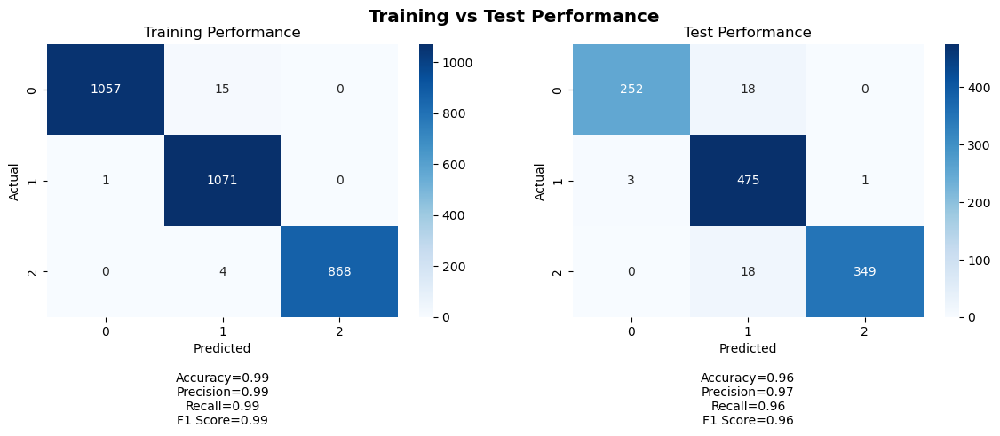

 56%|█████▌    | 56/100 [3:17:26<1:52:24, 153.29s/it]

Training Metrics:
Accuracy: 0.993368700265252
Precision: 0.9934683451438038
Recall: 0.993368700265252
F1 Score: 0.9933773462809831

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9659761300307427
Recall: 0.96415770609319
F1 Score: 0.9642663266791579

Training Confusion Matrix:
Class 0 - TP: 1057, FP: 1, TN: 1943, FN: 15
Class 1 - TP: 1071, FP: 19, TN: 1925, FN: 1
Class 2 - TP: 868, FP: 0, TN: 2144, FN: 4

Test Confusion Matrix:
Class 0 - TP: 252, FP: 3, TN: 843, FN: 18
Class 1 - TP: 475, FP: 36, TN: 601, FN: 4
Class 2 - TP: 349, FP: 1, TN: 748, FN: 18
35/35 [==============================] - 0s 2ms/step


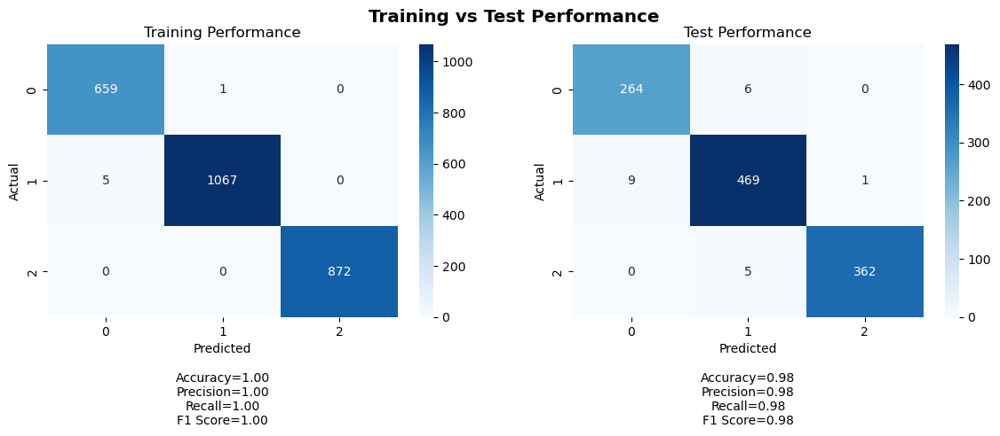

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.9977059812456128
Recall: 0.9976958525345622
F1 Score: 0.9976971797110112

Test Metrics:
Accuracy: 0.9811827956989247
Precision: 0.9812820774926715
Recall: 0.9811827956989247
F1 Score: 0.9812150062840801

Training Confusion Matrix:
Class 0 - TP: 659, FP: 5, TN: 1939, FN: 1
Class 1 - TP: 1067, FP: 1, TN: 1531, FN: 5
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 9, TN: 837, FN: 6
Class 1 - TP: 469, FP: 11, TN: 626, FN: 10
Class 2 - TP: 362, FP: 1, TN: 748, FN: 5
35/35 [==============================] - 0s 2ms/step


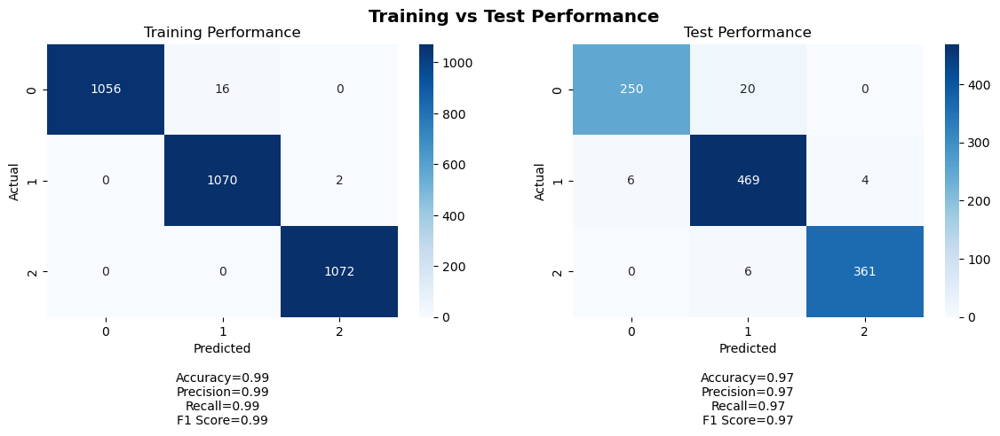

Training Metrics:
Accuracy: 0.9944029850746269
Precision: 0.9944682791992895
Recall: 0.9944029850746269
F1 Score: 0.9944027266748279

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.968181327268983
Recall: 0.967741935483871
F1 Score: 0.9676846049088367

Training Confusion Matrix:
Class 0 - TP: 1056, FP: 0, TN: 2144, FN: 16
Class 1 - TP: 1070, FP: 16, TN: 2128, FN: 2
Class 2 - TP: 1072, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 250, FP: 6, TN: 840, FN: 20
Class 1 - TP: 469, FP: 26, TN: 611, FN: 10
Class 2 - TP: 361, FP: 4, TN: 745, FN: 6
35/35 [==============================] - 0s 2ms/step


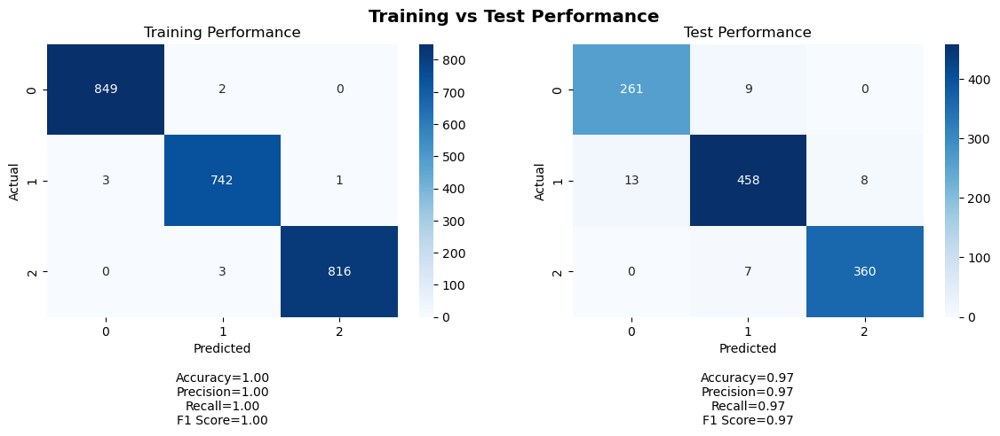

Training Metrics:
Accuracy: 0.9962748344370861
Precision: 0.9962780490839293
Recall: 0.9962748344370861
F1 Score: 0.9962756775974816

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9668841790152551
Recall: 0.9668458781362007
F1 Score: 0.9668405237677556

Training Confusion Matrix:
Class 0 - TP: 849, FP: 3, TN: 1562, FN: 2
Class 1 - TP: 742, FP: 5, TN: 1665, FN: 4
Class 2 - TP: 816, FP: 1, TN: 1596, FN: 3

Test Confusion Matrix:
Class 0 - TP: 261, FP: 13, TN: 833, FN: 9
Class 1 - TP: 458, FP: 16, TN: 621, FN: 21
Class 2 - TP: 360, FP: 8, TN: 741, FN: 7
35/35 [==============================] - 0s 2ms/step


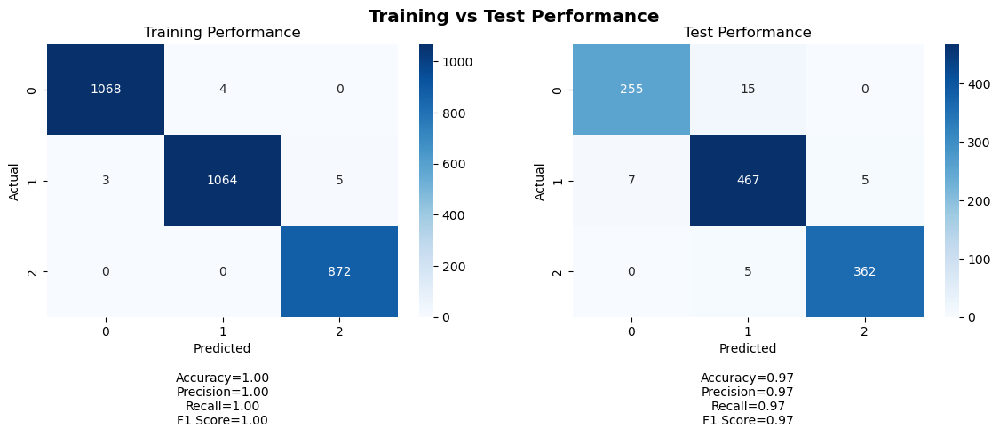

 57%|█████▋    | 57/100 [3:20:06<1:51:19, 155.34s/it]

Training Metrics:
Accuracy: 0.9960212201591512
Precision: 0.9960247758214599
Recall: 0.9960212201591512
F1 Score: 0.996019329828709

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.971429033724409
Recall: 0.9713261648745519
F1 Score: 0.9712966770986998

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 3, TN: 1941, FN: 4
Class 1 - TP: 1064, FP: 4, TN: 1940, FN: 8
Class 2 - TP: 872, FP: 5, TN: 2139, FN: 0

Test Confusion Matrix:
Class 0 - TP: 255, FP: 7, TN: 839, FN: 15
Class 1 - TP: 467, FP: 20, TN: 617, FN: 12
Class 2 - TP: 362, FP: 5, TN: 744, FN: 5
35/35 [==============================] - 0s 2ms/step


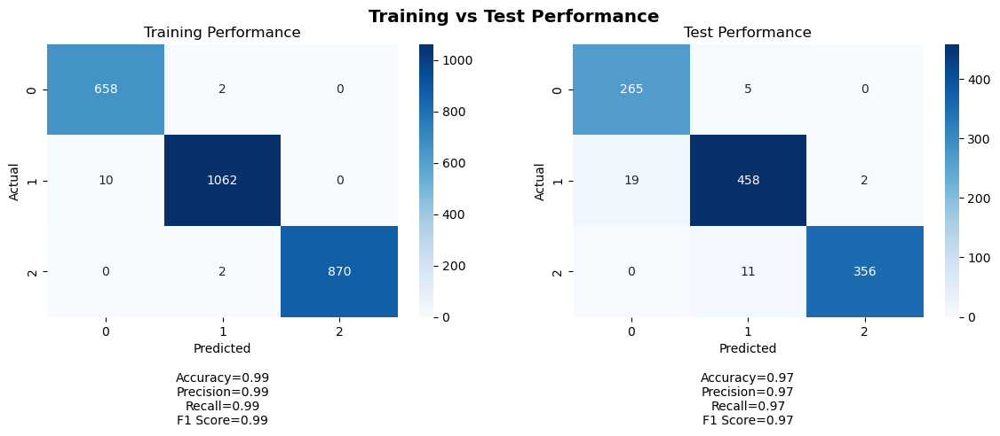

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.994661000924634
Recall: 0.9946236559139785
F1 Score: 0.9946295514382072

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9674888566464095
Recall: 0.9668458781362007
F1 Score: 0.9669583311223494

Training Confusion Matrix:
Class 0 - TP: 658, FP: 10, TN: 1934, FN: 2
Class 1 - TP: 1062, FP: 4, TN: 1528, FN: 10
Class 2 - TP: 870, FP: 0, TN: 1732, FN: 2

Test Confusion Matrix:
Class 0 - TP: 265, FP: 19, TN: 827, FN: 5
Class 1 - TP: 458, FP: 16, TN: 621, FN: 21
Class 2 - TP: 356, FP: 2, TN: 747, FN: 11
35/35 [==============================] - 0s 2ms/step


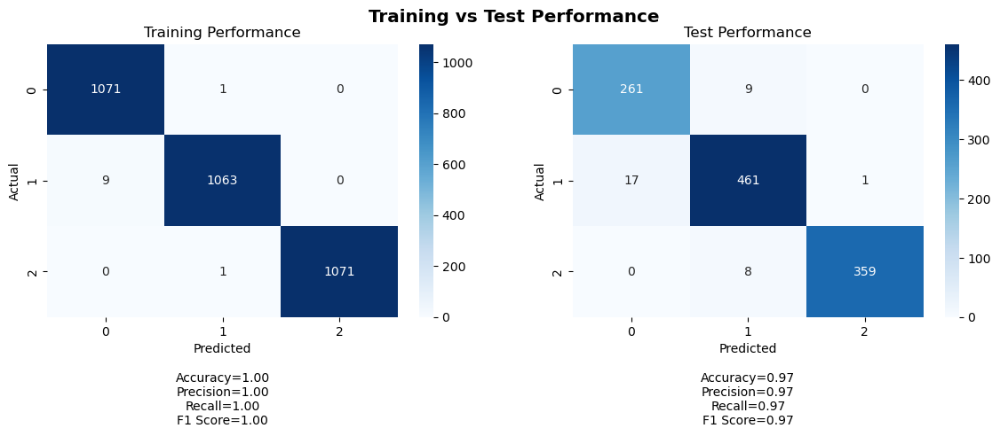

Training Metrics:
Accuracy: 0.9965796019900498
Precision: 0.9965962441314554
Recall: 0.9965796019900498
F1 Score: 0.9965797071308027

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9690270603361045
Recall: 0.9686379928315412
F1 Score: 0.9687528368837164

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 9, TN: 2135, FN: 1
Class 1 - TP: 1063, FP: 2, TN: 2142, FN: 9
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 261, FP: 17, TN: 829, FN: 9
Class 1 - TP: 461, FP: 17, TN: 620, FN: 18
Class 2 - TP: 359, FP: 1, TN: 748, FN: 8
35/35 [==============================] - 0s 2ms/step


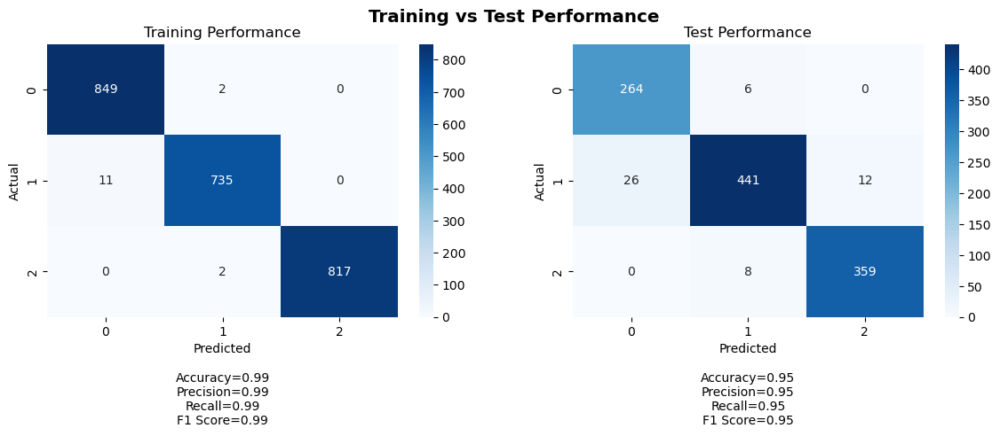

Training Metrics:
Accuracy: 0.9937913907284768
Precision: 0.993823355645624
Recall: 0.9937913907284768
F1 Score: 0.99379040335373

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9544659695015436
Recall: 0.953405017921147
F1 Score: 0.9533669667518088

Training Confusion Matrix:
Class 0 - TP: 849, FP: 11, TN: 1554, FN: 2
Class 1 - TP: 735, FP: 4, TN: 1666, FN: 11
Class 2 - TP: 817, FP: 0, TN: 1597, FN: 2

Test Confusion Matrix:
Class 0 - TP: 264, FP: 26, TN: 820, FN: 6
Class 1 - TP: 441, FP: 14, TN: 623, FN: 38
Class 2 - TP: 359, FP: 12, TN: 737, FN: 8
35/35 [==============================] - 0s 2ms/step


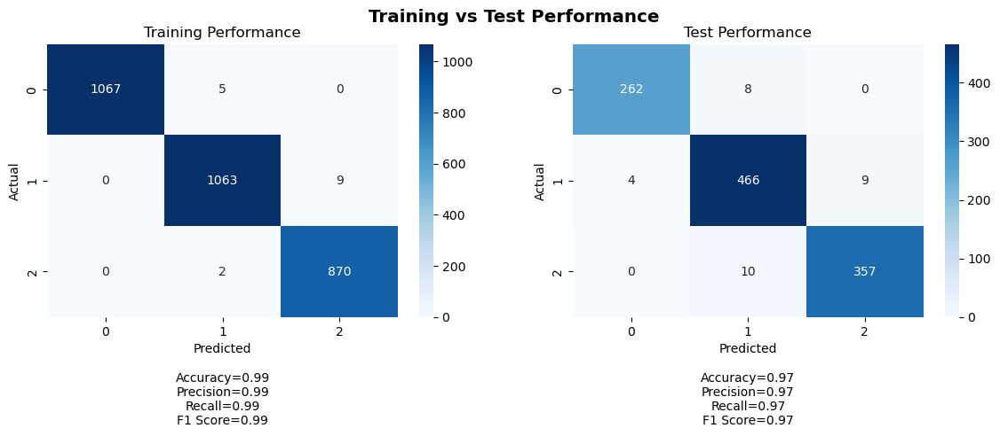

 58%|█████▊    | 58/100 [3:22:41<1:48:43, 155.32s/it]

Training Metrics:
Accuracy: 0.9946949602122016
Precision: 0.9947143860221483
Recall: 0.9946949602122016
F1 Score: 0.9946978361833405

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9723129120728934
Recall: 0.9722222222222222
F1 Score: 0.972242599568074

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 0, TN: 1944, FN: 5
Class 1 - TP: 1063, FP: 7, TN: 1937, FN: 9
Class 2 - TP: 870, FP: 9, TN: 2135, FN: 2

Test Confusion Matrix:
Class 0 - TP: 262, FP: 4, TN: 842, FN: 8
Class 1 - TP: 466, FP: 18, TN: 619, FN: 13
Class 2 - TP: 357, FP: 9, TN: 740, FN: 10
35/35 [==============================] - 0s 2ms/step


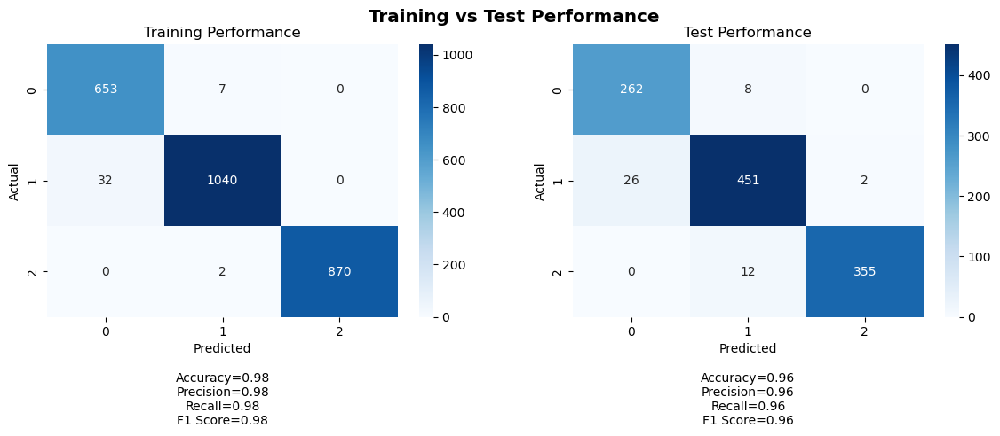

Training Metrics:
Accuracy: 0.9842549923195084
Precision: 0.9846277083027839
Recall: 0.9842549923195084
F1 Score: 0.984308373511699

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9580907480564081
Recall: 0.956989247311828
F1 Score: 0.9572129003142862

Training Confusion Matrix:
Class 0 - TP: 653, FP: 32, TN: 1912, FN: 7
Class 1 - TP: 1040, FP: 9, TN: 1523, FN: 32
Class 2 - TP: 870, FP: 0, TN: 1732, FN: 2

Test Confusion Matrix:
Class 0 - TP: 262, FP: 26, TN: 820, FN: 8
Class 1 - TP: 451, FP: 20, TN: 617, FN: 28
Class 2 - TP: 355, FP: 2, TN: 747, FN: 12
35/35 [==============================] - 0s 2ms/step


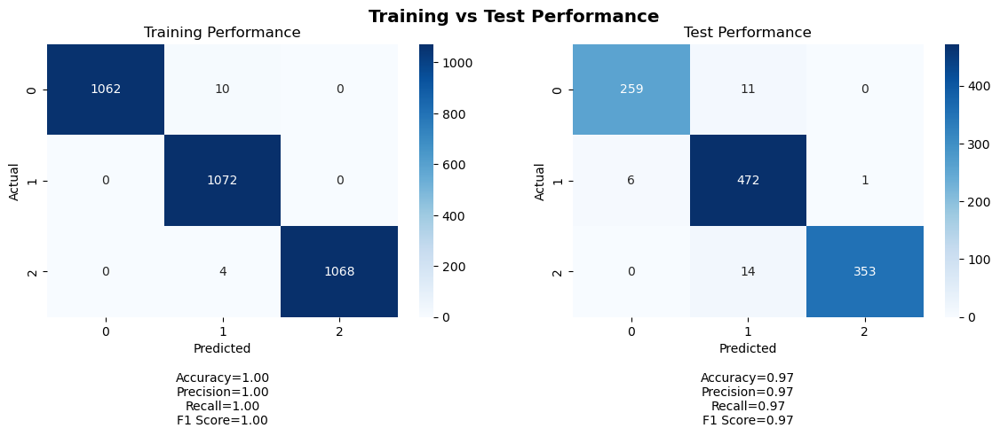

Training Metrics:
Accuracy: 0.9956467661691543
Precision: 0.9957028852056478
Recall: 0.9956467661691543
F1 Score: 0.9956524390308086

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9720031378893924
Recall: 0.9713261648745519
F1 Score: 0.9713982203100856

Training Confusion Matrix:
Class 0 - TP: 1062, FP: 0, TN: 2144, FN: 10
Class 1 - TP: 1072, FP: 14, TN: 2130, FN: 0
Class 2 - TP: 1068, FP: 0, TN: 2144, FN: 4

Test Confusion Matrix:
Class 0 - TP: 259, FP: 6, TN: 840, FN: 11
Class 1 - TP: 472, FP: 25, TN: 612, FN: 7
Class 2 - TP: 353, FP: 1, TN: 748, FN: 14
35/35 [==============================] - 0s 2ms/step


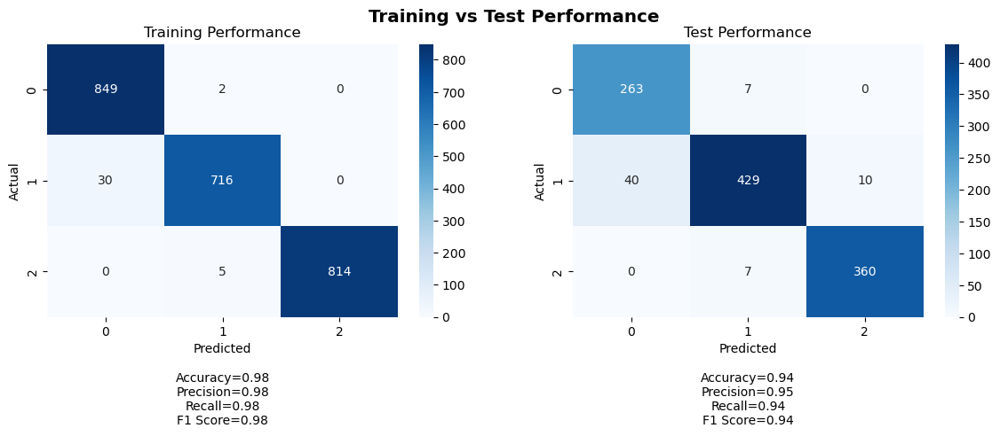

Training Metrics:
Accuracy: 0.9846854304635762
Precision: 0.9849888030360681
Recall: 0.9846854304635762
F1 Score: 0.9846695579839109

Test Metrics:
Accuracy: 0.942652329749104
Precision: 0.9456091569961608
Recall: 0.942652329749104
F1 Score: 0.9427764741660755

Training Confusion Matrix:
Class 0 - TP: 849, FP: 30, TN: 1535, FN: 2
Class 1 - TP: 716, FP: 7, TN: 1663, FN: 30
Class 2 - TP: 814, FP: 0, TN: 1597, FN: 5

Test Confusion Matrix:
Class 0 - TP: 263, FP: 40, TN: 806, FN: 7
Class 1 - TP: 429, FP: 14, TN: 623, FN: 50
Class 2 - TP: 360, FP: 10, TN: 739, FN: 7
35/35 [==============================] - 0s 2ms/step


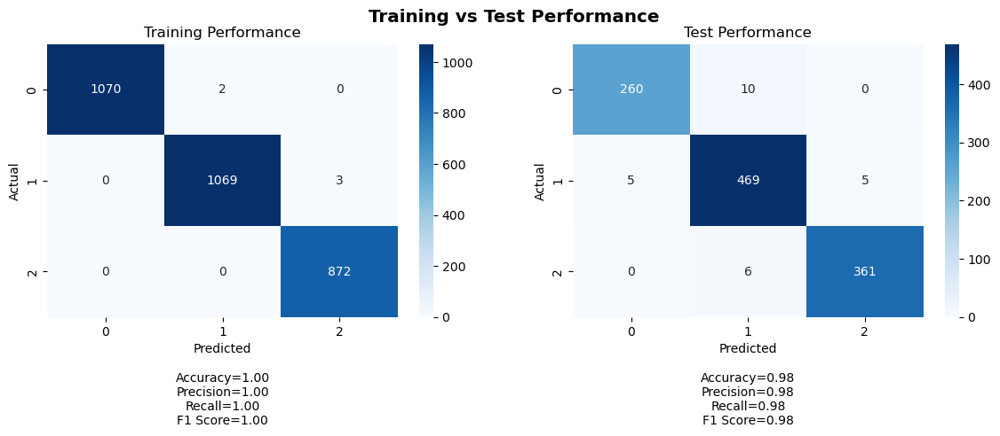

 59%|█████▉    | 59/100 [3:25:17<1:46:11, 155.40s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983449662800575
Recall: 0.998342175066313
F1 Score: 0.9983423327415764

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9767830979565435
Recall: 0.9767025089605734
F1 Score: 0.9767054802817969

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 0, TN: 1944, FN: 2
Class 1 - TP: 1069, FP: 2, TN: 1942, FN: 3
Class 2 - TP: 872, FP: 3, TN: 2141, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 5, TN: 841, FN: 10
Class 1 - TP: 469, FP: 16, TN: 621, FN: 10
Class 2 - TP: 361, FP: 5, TN: 744, FN: 6
35/35 [==============================] - 0s 2ms/step


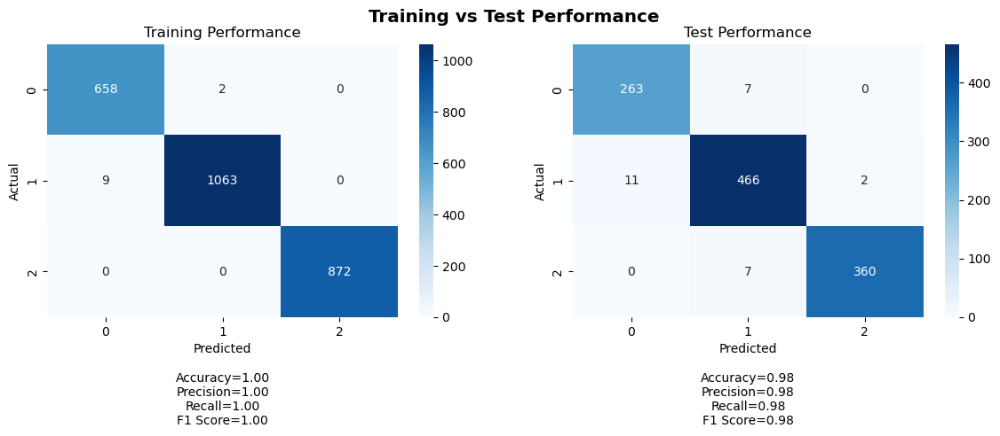

Training Metrics:
Accuracy: 0.9957757296466974
Precision: 0.9958069536227755
Recall: 0.9957757296466974
F1 Score: 0.9957799527268422

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9759517260742656
Recall: 0.9758064516129032
F1 Score: 0.975850707380618

Training Confusion Matrix:
Class 0 - TP: 658, FP: 9, TN: 1935, FN: 2
Class 1 - TP: 1063, FP: 2, TN: 1530, FN: 9
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 11, TN: 835, FN: 7
Class 1 - TP: 466, FP: 14, TN: 623, FN: 13
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


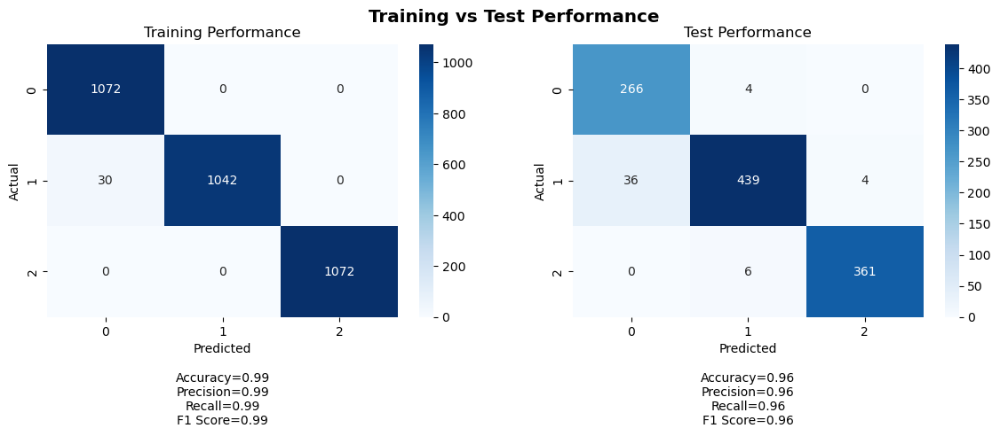

Training Metrics:
Accuracy: 0.9906716417910447
Precision: 0.9909255898366606
Recall: 0.9906716417910447
F1 Score: 0.9906698150238608

Test Metrics:
Accuracy: 0.9551971326164874
Precision: 0.9579968640506659
Recall: 0.9551971326164874
F1 Score: 0.9554632887648055

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 30, TN: 2114, FN: 0
Class 1 - TP: 1042, FP: 0, TN: 2144, FN: 30
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 36, TN: 810, FN: 4
Class 1 - TP: 439, FP: 10, TN: 627, FN: 40
Class 2 - TP: 361, FP: 4, TN: 745, FN: 6
35/35 [==============================] - 0s 2ms/step


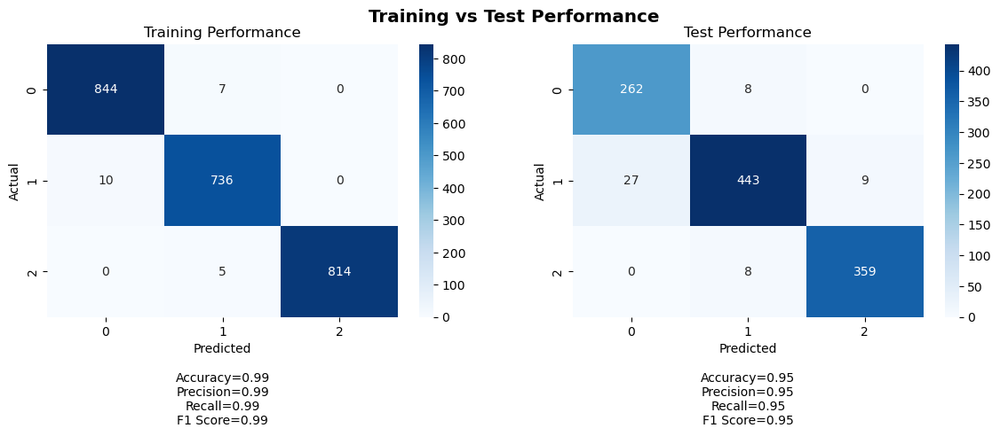

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9909218602512906
Recall: 0.9908940397350994
F1 Score: 0.9909031568531789

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9543928093825609
Recall: 0.953405017921147
F1 Score: 0.9534516180898726

Training Confusion Matrix:
Class 0 - TP: 844, FP: 10, TN: 1555, FN: 7
Class 1 - TP: 736, FP: 12, TN: 1658, FN: 10
Class 2 - TP: 814, FP: 0, TN: 1597, FN: 5

Test Confusion Matrix:
Class 0 - TP: 262, FP: 27, TN: 819, FN: 8
Class 1 - TP: 443, FP: 16, TN: 621, FN: 36
Class 2 - TP: 359, FP: 9, TN: 740, FN: 8
35/35 [==============================] - 0s 2ms/step


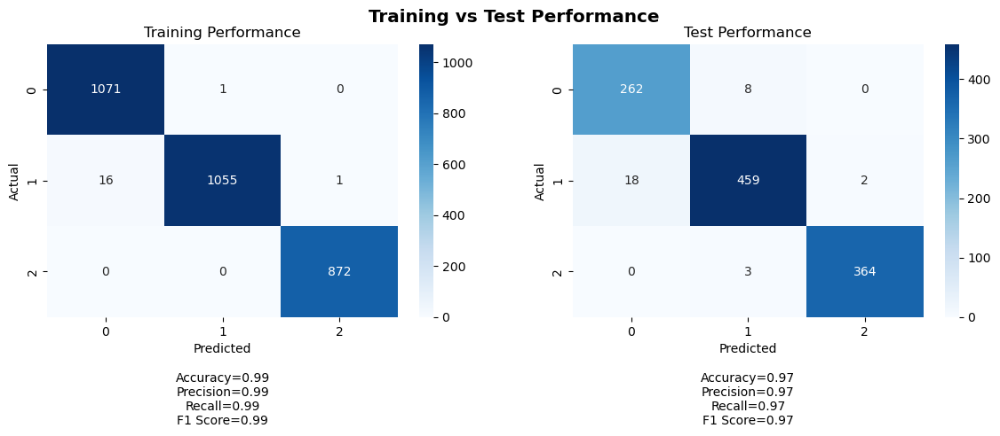

 60%|██████    | 60/100 [3:27:55<1:44:13, 156.35s/it]

Training Metrics:
Accuracy: 0.9940318302387268
Precision: 0.9941003929471398
Recall: 0.9940318302387268
F1 Score: 0.9940290691240483

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9726046186058339
Recall: 0.9722222222222222
F1 Score: 0.9722992438677287

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 16, TN: 1928, FN: 1
Class 1 - TP: 1055, FP: 1, TN: 1943, FN: 17
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 18, TN: 828, FN: 8
Class 1 - TP: 459, FP: 11, TN: 626, FN: 20
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3
35/35 [==============================] - 0s 2ms/step


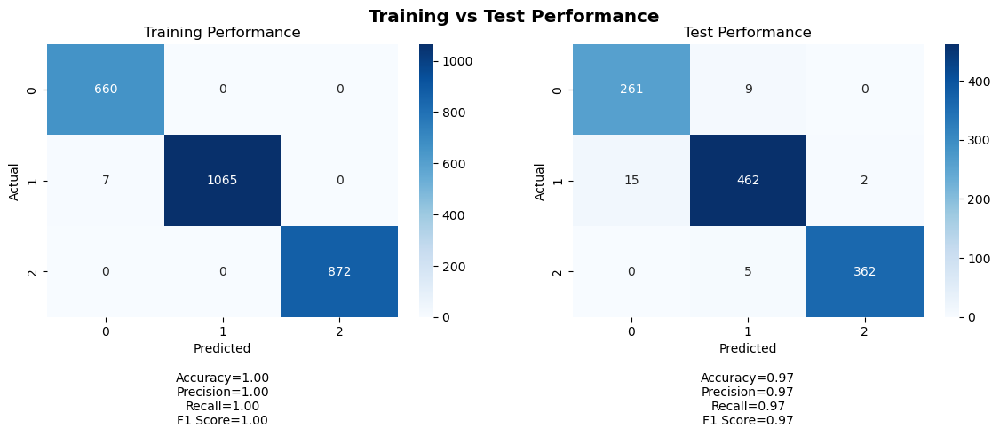

Training Metrics:
Accuracy: 0.9973118279569892
Precision: 0.9973400396575905
Recall: 0.9973118279569892
F1 Score: 0.9973145153716269

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9724205807759145
Recall: 0.9722222222222222
F1 Score: 0.9722838827484792

Training Confusion Matrix:
Class 0 - TP: 660, FP: 7, TN: 1937, FN: 0
Class 1 - TP: 1065, FP: 0, TN: 1532, FN: 7
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 15, TN: 831, FN: 9
Class 1 - TP: 462, FP: 14, TN: 623, FN: 17
Class 2 - TP: 362, FP: 2, TN: 747, FN: 5
35/35 [==============================] - 0s 2ms/step


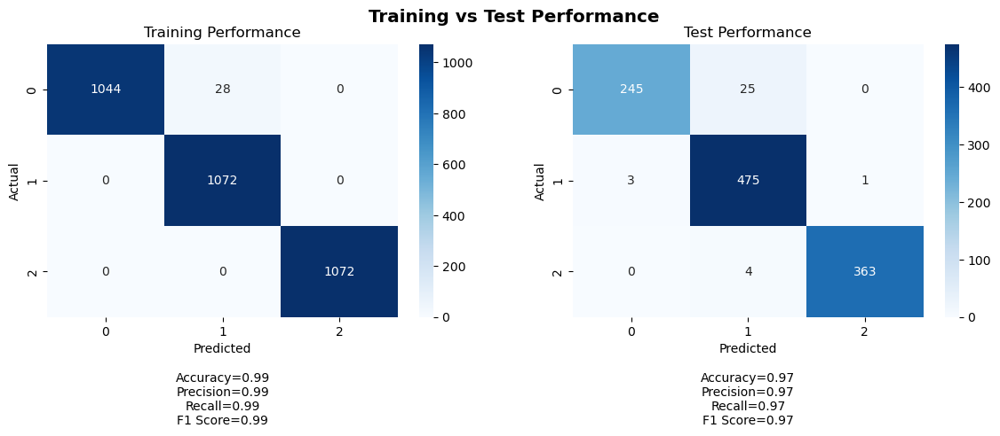

Training Metrics:
Accuracy: 0.9912935323383084
Precision: 0.9915151515151516
Recall: 0.9912935323383084
F1 Score: 0.9912920471464163

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9714732269471258
Recall: 0.9704301075268817
F1 Score: 0.9702641391233383

Training Confusion Matrix:
Class 0 - TP: 1044, FP: 0, TN: 2144, FN: 28
Class 1 - TP: 1072, FP: 28, TN: 2116, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 245, FP: 3, TN: 843, FN: 25
Class 1 - TP: 475, FP: 29, TN: 608, FN: 4
Class 2 - TP: 363, FP: 1, TN: 748, FN: 4
35/35 [==============================] - 0s 2ms/step


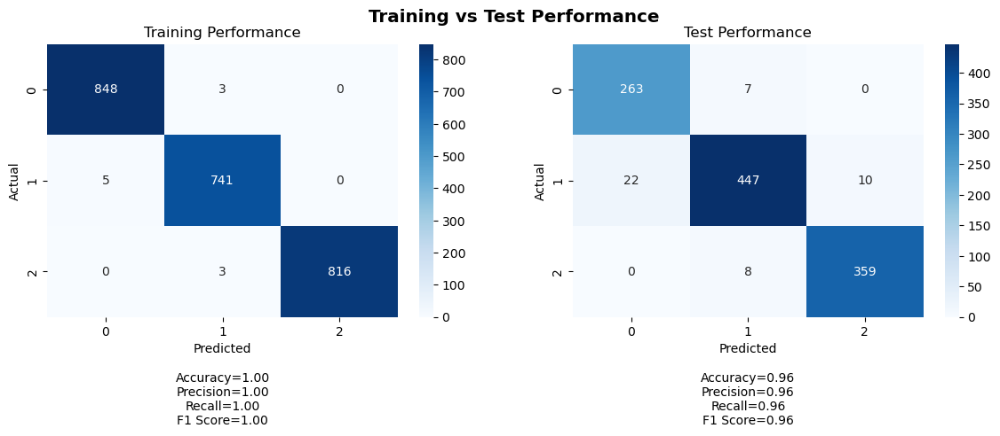

Training Metrics:
Accuracy: 0.9954470198675497
Precision: 0.995455196795505
Recall: 0.9954470198675497
F1 Score: 0.9954493486755409

Test Metrics:
Accuracy: 0.9578853046594982
Precision: 0.9584768344327056
Recall: 0.9578853046594982
F1 Score: 0.957877957043741

Training Confusion Matrix:
Class 0 - TP: 848, FP: 5, TN: 1560, FN: 3
Class 1 - TP: 741, FP: 6, TN: 1664, FN: 5
Class 2 - TP: 816, FP: 0, TN: 1597, FN: 3

Test Confusion Matrix:
Class 0 - TP: 263, FP: 22, TN: 824, FN: 7
Class 1 - TP: 447, FP: 15, TN: 622, FN: 32
Class 2 - TP: 359, FP: 10, TN: 739, FN: 8
35/35 [==============================] - 0s 2ms/step


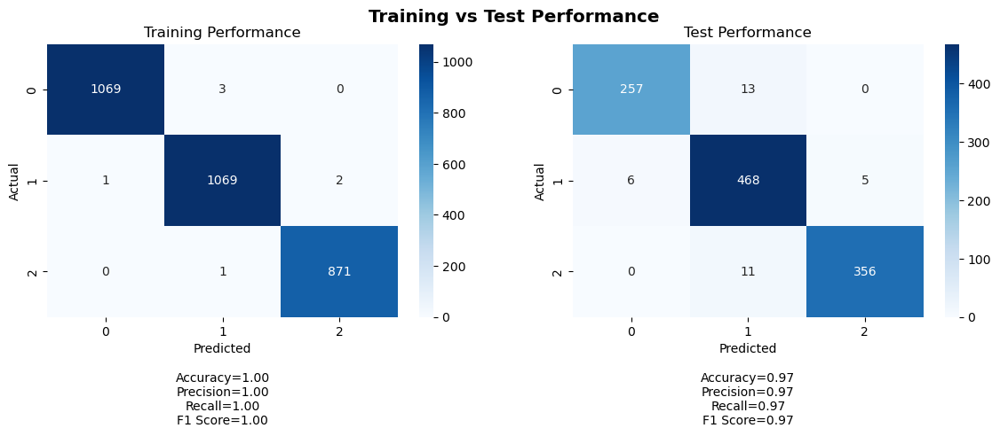

 61%|██████    | 61/100 [3:30:47<1:44:35, 160.91s/it]

Training Metrics:
Accuracy: 0.9976790450928382
Precision: 0.9976804209740263
Recall: 0.9976790450928382
F1 Score: 0.9976792519518746

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9689886631101238
Recall: 0.9686379928315412
F1 Score: 0.9686770564492398

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 1, TN: 1943, FN: 3
Class 1 - TP: 1069, FP: 4, TN: 1940, FN: 3
Class 2 - TP: 871, FP: 2, TN: 2142, FN: 1

Test Confusion Matrix:
Class 0 - TP: 257, FP: 6, TN: 840, FN: 13
Class 1 - TP: 468, FP: 24, TN: 613, FN: 11
Class 2 - TP: 356, FP: 5, TN: 744, FN: 11
35/35 [==============================] - 0s 2ms/step


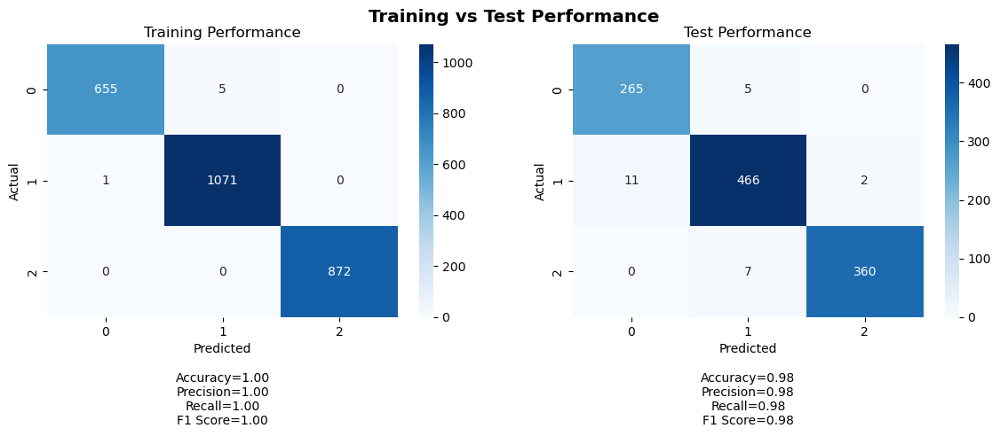

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.997700648924585
Recall: 0.9976958525345622
F1 Score: 0.9976944961793952

Test Metrics:
Accuracy: 0.9775985663082437
Precision: 0.9777655927624374
Recall: 0.9775985663082437
F1 Score: 0.9776379805012444

Training Confusion Matrix:
Class 0 - TP: 655, FP: 1, TN: 1943, FN: 5
Class 1 - TP: 1071, FP: 5, TN: 1527, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 11, TN: 835, FN: 5
Class 1 - TP: 466, FP: 12, TN: 625, FN: 13
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


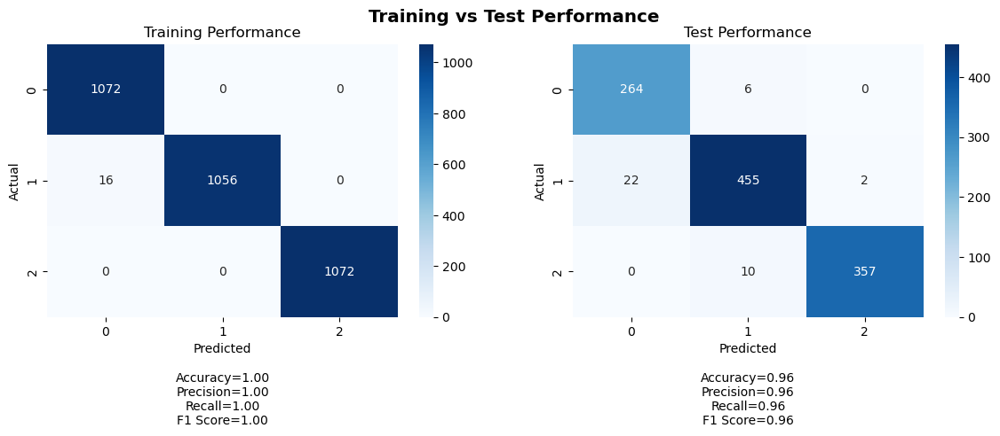

Training Metrics:
Accuracy: 0.9950248756218906
Precision: 0.9950980392156862
Recall: 0.9950248756218906
F1 Score: 0.9950245985333704

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9649770956788315
Recall: 0.96415770609319
F1 Score: 0.9643085492318378

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 16, TN: 2128, FN: 0
Class 1 - TP: 1056, FP: 0, TN: 2144, FN: 16
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 22, TN: 824, FN: 6
Class 1 - TP: 455, FP: 16, TN: 621, FN: 24
Class 2 - TP: 357, FP: 2, TN: 747, FN: 10
35/35 [==============================] - 0s 2ms/step


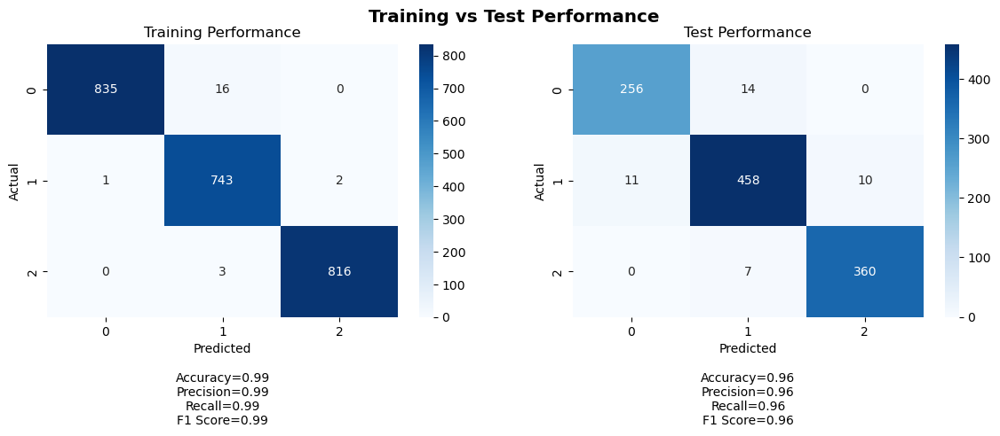

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9910507295363107
Recall: 0.9908940397350994
F1 Score: 0.9909104328404126

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9623274960353613
Recall: 0.9623655913978495
F1 Score: 0.9623340209017877

Training Confusion Matrix:
Class 0 - TP: 835, FP: 1, TN: 1564, FN: 16
Class 1 - TP: 743, FP: 19, TN: 1651, FN: 3
Class 2 - TP: 816, FP: 2, TN: 1595, FN: 3

Test Confusion Matrix:
Class 0 - TP: 256, FP: 11, TN: 835, FN: 14
Class 1 - TP: 458, FP: 21, TN: 616, FN: 21
Class 2 - TP: 360, FP: 10, TN: 739, FN: 7
35/35 [==============================] - 0s 1ms/step


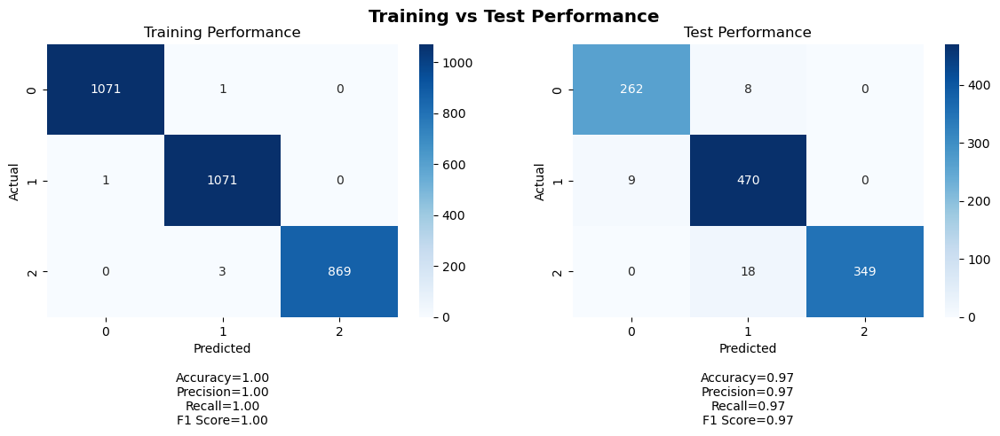

 62%|██████▏   | 62/100 [3:33:28<1:41:51, 160.83s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983458762568627
Recall: 0.998342175066313
F1 Score: 0.9983424763013812

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9694662539107182
Recall: 0.9686379928315412
F1 Score: 0.968722744504471

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 1 - TP: 1071, FP: 4, TN: 1940, FN: 1
Class 2 - TP: 869, FP: 0, TN: 2144, FN: 3

Test Confusion Matrix:
Class 0 - TP: 262, FP: 9, TN: 837, FN: 8
Class 1 - TP: 470, FP: 26, TN: 611, FN: 9
Class 2 - TP: 349, FP: 0, TN: 749, FN: 18
35/35 [==============================] - 0s 2ms/step


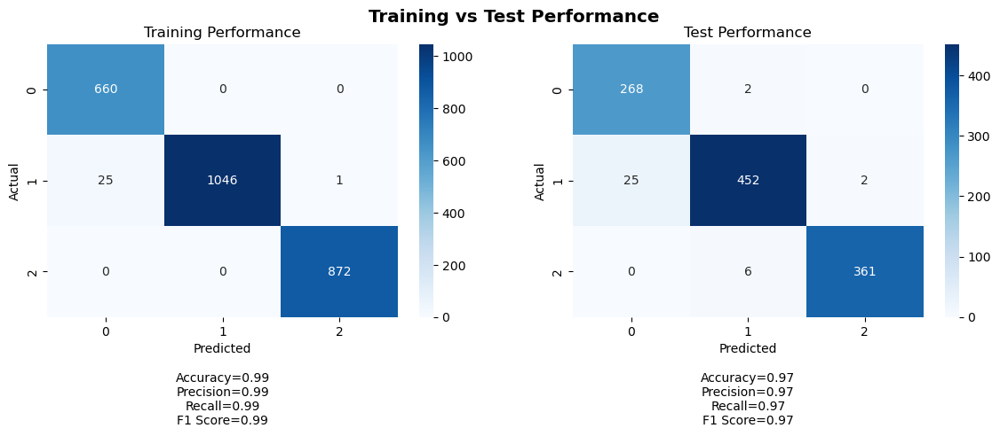

Training Metrics:
Accuracy: 0.9900153609831029
Precision: 0.9903661882620953
Recall: 0.9900153609831029
F1 Score: 0.9900434116845984

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.970080630813425
Recall: 0.9686379928315412
F1 Score: 0.9687952435971134

Training Confusion Matrix:
Class 0 - TP: 660, FP: 25, TN: 1919, FN: 0
Class 1 - TP: 1046, FP: 0, TN: 1532, FN: 26
Class 2 - TP: 872, FP: 1, TN: 1731, FN: 0

Test Confusion Matrix:
Class 0 - TP: 268, FP: 25, TN: 821, FN: 2
Class 1 - TP: 452, FP: 8, TN: 629, FN: 27
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


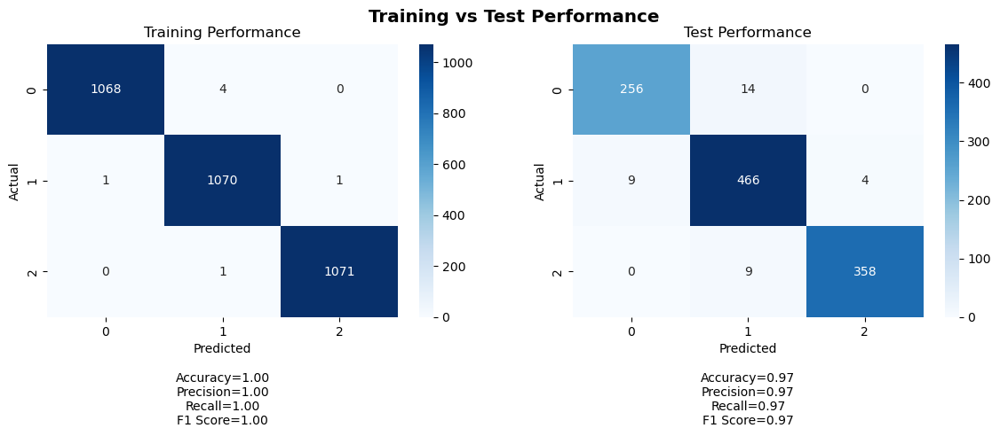

Training Metrics:
Accuracy: 0.9978233830845771
Precision: 0.9978268492311216
Recall: 0.9978233830845771
F1 Score: 0.9978238145239372

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.967961727337565
Recall: 0.967741935483871
F1 Score: 0.9677723048020193

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 1, TN: 2143, FN: 4
Class 1 - TP: 1070, FP: 5, TN: 2139, FN: 2
Class 2 - TP: 1071, FP: 1, TN: 2143, FN: 1

Test Confusion Matrix:
Class 0 - TP: 256, FP: 9, TN: 837, FN: 14
Class 1 - TP: 466, FP: 23, TN: 614, FN: 13
Class 2 - TP: 358, FP: 4, TN: 745, FN: 9
35/35 [==============================] - 0s 2ms/step


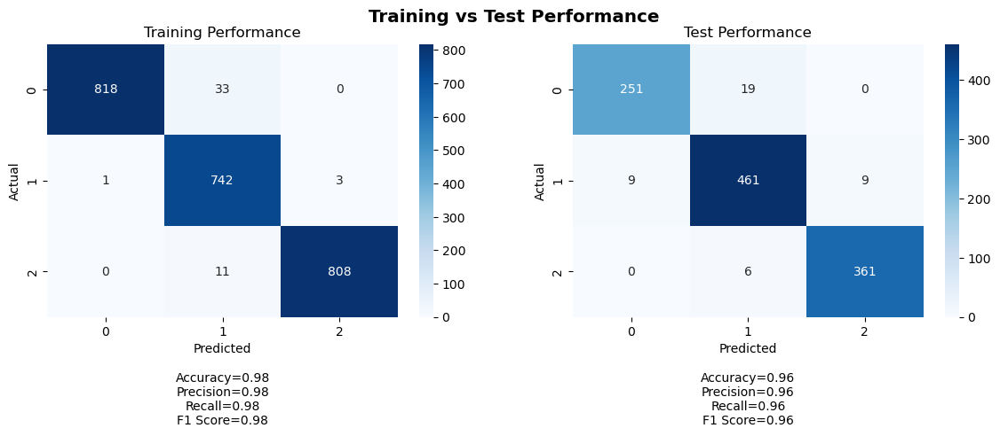

Training Metrics:
Accuracy: 0.9801324503311258
Precision: 0.9810308446260841
Recall: 0.9801324503311258
F1 Score: 0.9802427680143091

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9615474027162598
Recall: 0.9614695340501792
F1 Score: 0.9613999433495938

Training Confusion Matrix:
Class 0 - TP: 818, FP: 1, TN: 1564, FN: 33
Class 1 - TP: 742, FP: 44, TN: 1626, FN: 4
Class 2 - TP: 808, FP: 3, TN: 1594, FN: 11

Test Confusion Matrix:
Class 0 - TP: 251, FP: 9, TN: 837, FN: 19
Class 1 - TP: 461, FP: 25, TN: 612, FN: 18
Class 2 - TP: 361, FP: 9, TN: 740, FN: 6
35/35 [==============================] - 0s 2ms/step


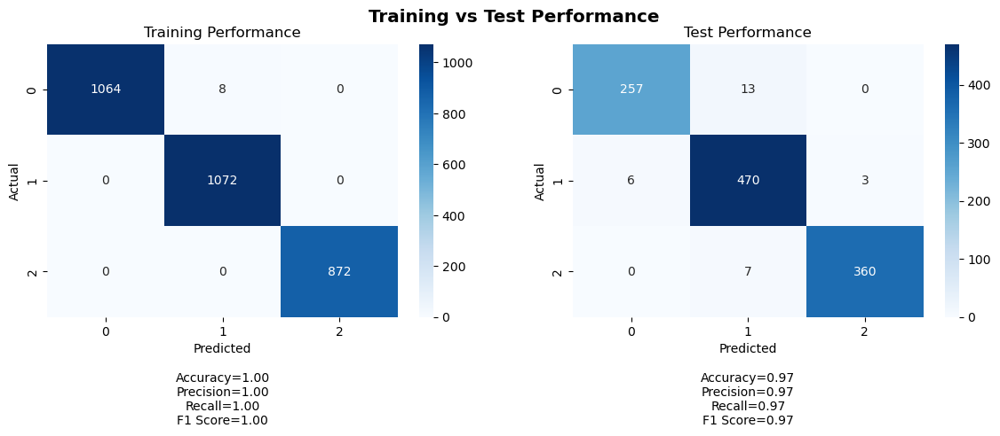

 63%|██████▎   | 63/100 [3:36:09<1:39:15, 160.97s/it]

Training Metrics:
Accuracy: 0.9973474801061007
Precision: 0.9973671284016111
Recall: 0.9973474801061007
F1 Score: 0.9973474431747572

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9742439300386259
Recall: 0.9740143369175627
F1 Score: 0.9740254838212191

Training Confusion Matrix:
Class 0 - TP: 1064, FP: 0, TN: 1944, FN: 8
Class 1 - TP: 1072, FP: 8, TN: 1936, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 6, TN: 840, FN: 13
Class 1 - TP: 470, FP: 20, TN: 617, FN: 9
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


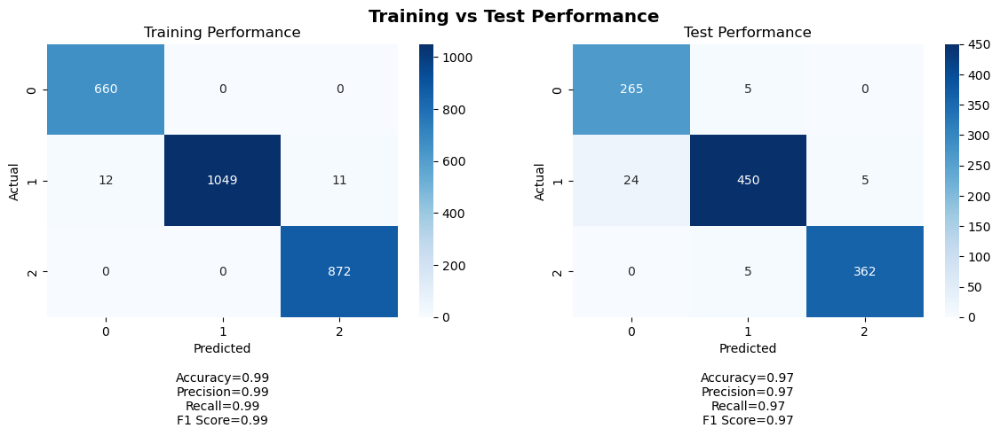

Training Metrics:
Accuracy: 0.9911674347158218
Precision: 0.9913023496762167
Recall: 0.9911674347158218
F1 Score: 0.991153541344413

Test Metrics:
Accuracy: 0.9650537634408602
Precision: 0.9660975010690138
Recall: 0.9650537634408602
F1 Score: 0.9651418240813994

Training Confusion Matrix:
Class 0 - TP: 660, FP: 12, TN: 1932, FN: 0
Class 1 - TP: 1049, FP: 0, TN: 1532, FN: 23
Class 2 - TP: 872, FP: 11, TN: 1721, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 24, TN: 822, FN: 5
Class 1 - TP: 450, FP: 10, TN: 627, FN: 29
Class 2 - TP: 362, FP: 5, TN: 744, FN: 5
35/35 [==============================] - 0s 2ms/step


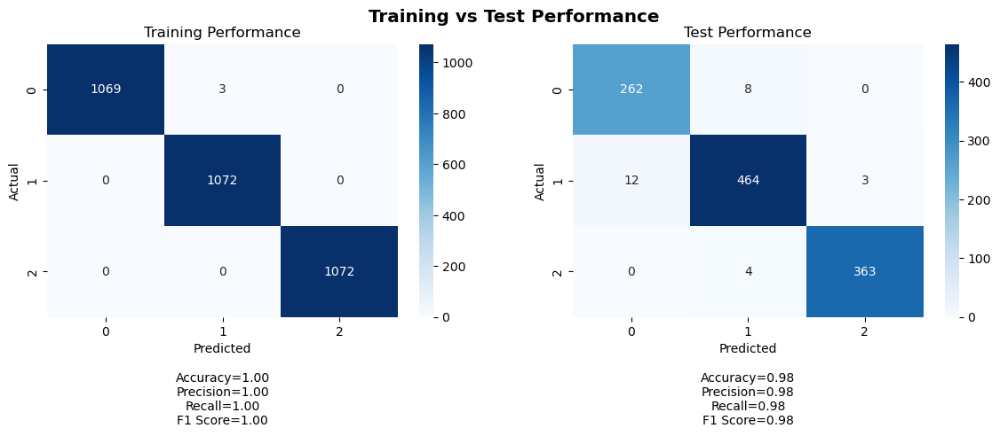

Training Metrics:
Accuracy: 0.9990671641791045
Precision: 0.9990697674418605
Recall: 0.9990671641791045
F1 Score: 0.9990671623526913

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9758883113874008
Recall: 0.9758064516129032
F1 Score: 0.9758300592626528

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 0, TN: 2144, FN: 3
Class 1 - TP: 1072, FP: 3, TN: 2141, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 12, TN: 834, FN: 8
Class 1 - TP: 464, FP: 12, TN: 625, FN: 15
Class 2 - TP: 363, FP: 3, TN: 746, FN: 4
35/35 [==============================] - 0s 2ms/step


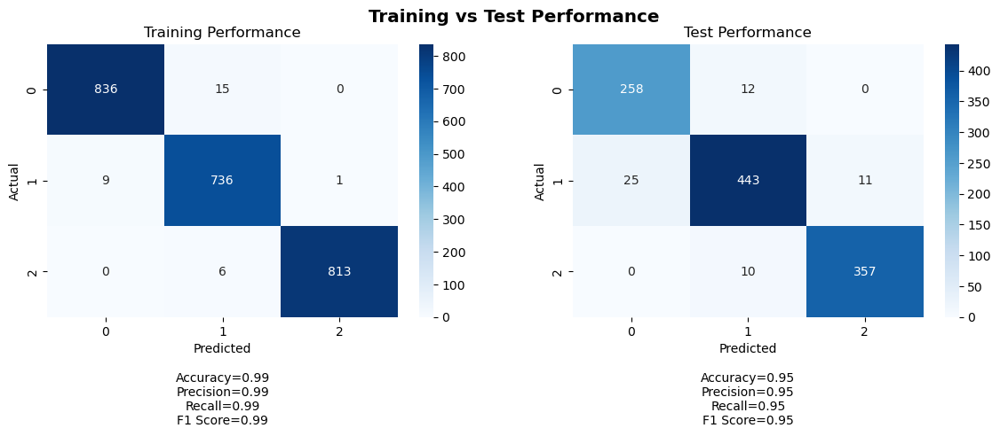

Training Metrics:
Accuracy: 0.9871688741721855
Precision: 0.9872661854651777
Recall: 0.9871688741721855
F1 Score: 0.9871938205646335

Test Metrics:
Accuracy: 0.9480286738351255
Precision: 0.9484909817266512
Recall: 0.9480286738351255
F1 Score: 0.9480457898844252

Training Confusion Matrix:
Class 0 - TP: 836, FP: 9, TN: 1556, FN: 15
Class 1 - TP: 736, FP: 21, TN: 1649, FN: 10
Class 2 - TP: 813, FP: 1, TN: 1596, FN: 6

Test Confusion Matrix:
Class 0 - TP: 258, FP: 25, TN: 821, FN: 12
Class 1 - TP: 443, FP: 22, TN: 615, FN: 36
Class 2 - TP: 357, FP: 11, TN: 738, FN: 10
35/35 [==============================] - 0s 2ms/step


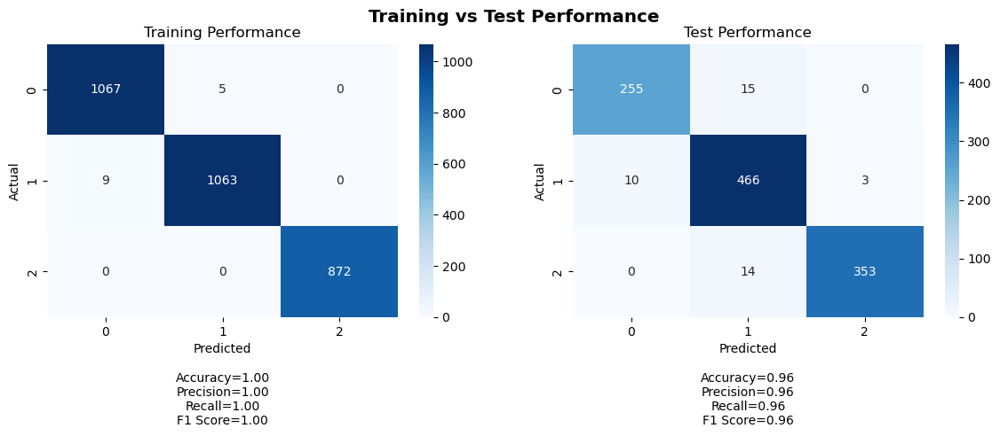

 64%|██████▍   | 64/100 [3:38:51<1:36:49, 161.38s/it]

Training Metrics:
Accuracy: 0.9953580901856764
Precision: 0.9953629743558722
Recall: 0.9953580901856764
F1 Score: 0.9953580740283824

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9629534031029364
Recall: 0.9623655913978495
F1 Score: 0.9624541438180517

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 9, TN: 1935, FN: 5
Class 1 - TP: 1063, FP: 5, TN: 1939, FN: 9
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 255, FP: 10, TN: 836, FN: 15
Class 1 - TP: 466, FP: 29, TN: 608, FN: 13
Class 2 - TP: 353, FP: 3, TN: 746, FN: 14
35/35 [==============================] - 0s 2ms/step


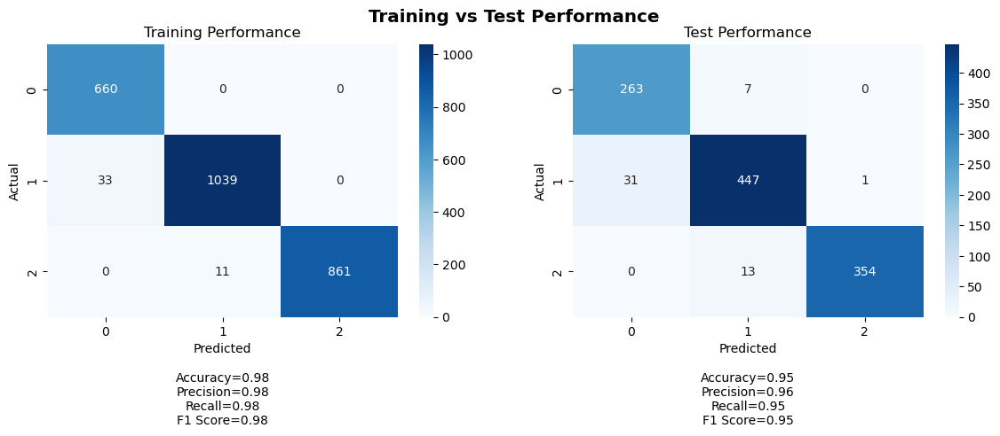

Training Metrics:
Accuracy: 0.9831029185867896
Precision: 0.9836178772584302
Recall: 0.9831029185867896
F1 Score: 0.9831564676474719

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9551818017907225
Recall: 0.953405017921147
F1 Score: 0.9537297109523607

Training Confusion Matrix:
Class 0 - TP: 660, FP: 33, TN: 1911, FN: 0
Class 1 - TP: 1039, FP: 11, TN: 1521, FN: 33
Class 2 - TP: 861, FP: 0, TN: 1732, FN: 11

Test Confusion Matrix:
Class 0 - TP: 263, FP: 31, TN: 815, FN: 7
Class 1 - TP: 447, FP: 20, TN: 617, FN: 32
Class 2 - TP: 354, FP: 1, TN: 748, FN: 13
35/35 [==============================] - 0s 4ms/step


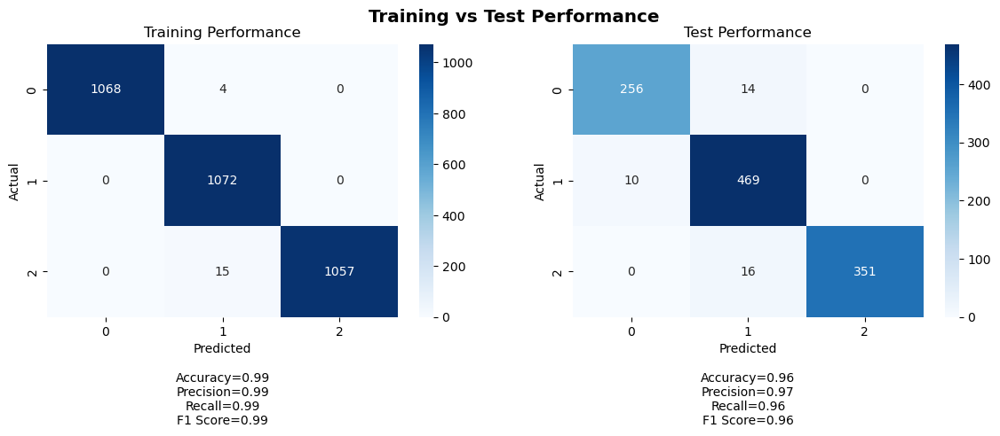

Training Metrics:
Accuracy: 0.994092039800995
Precision: 0.9941949282004277
Recall: 0.994092039800995
F1 Score: 0.994100394554125

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9651003842919083
Recall: 0.96415770609319
F1 Score: 0.9642842049603072

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 0, TN: 2144, FN: 4
Class 1 - TP: 1072, FP: 19, TN: 2125, FN: 0
Class 2 - TP: 1057, FP: 0, TN: 2144, FN: 15

Test Confusion Matrix:
Class 0 - TP: 256, FP: 10, TN: 836, FN: 14
Class 1 - TP: 469, FP: 30, TN: 607, FN: 10
Class 2 - TP: 351, FP: 0, TN: 749, FN: 16
35/35 [==============================] - 0s 3ms/step


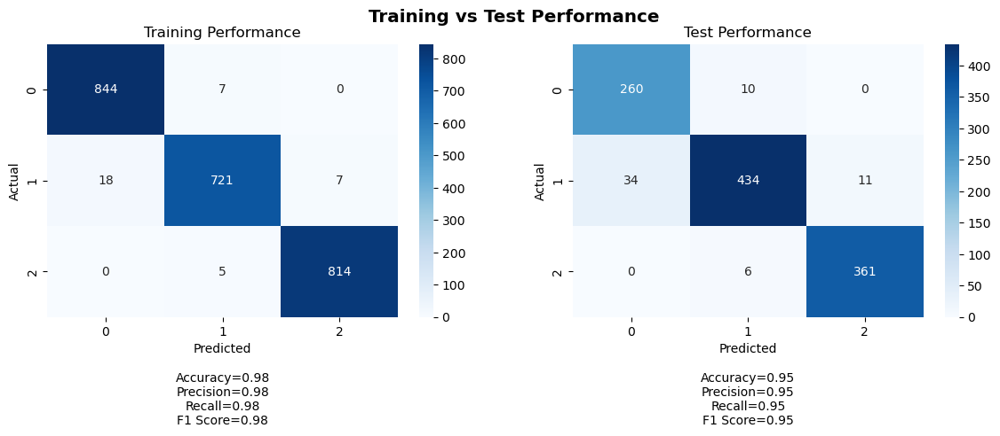

Training Metrics:
Accuracy: 0.9846854304635762
Precision: 0.9846994729884554
Recall: 0.9846854304635762
F1 Score: 0.9846543773743255

Test Metrics:
Accuracy: 0.9453405017921147
Precision: 0.9470360650137422
Recall: 0.9453405017921147
F1 Score: 0.9453777610487449

Training Confusion Matrix:
Class 0 - TP: 844, FP: 18, TN: 1547, FN: 7
Class 1 - TP: 721, FP: 12, TN: 1658, FN: 25
Class 2 - TP: 814, FP: 7, TN: 1590, FN: 5

Test Confusion Matrix:
Class 0 - TP: 260, FP: 34, TN: 812, FN: 10
Class 1 - TP: 434, FP: 16, TN: 621, FN: 45
Class 2 - TP: 361, FP: 11, TN: 738, FN: 6
35/35 [==============================] - 0s 2ms/step


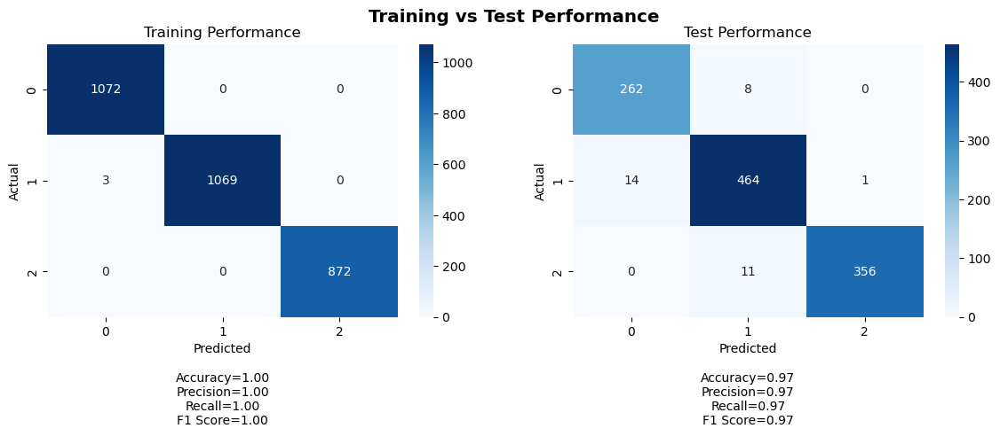

 65%|██████▌   | 65/100 [3:41:35<1:34:37, 162.22s/it]

Training Metrics:
Accuracy: 0.9990053050397878
Precision: 0.9990080809327001
Recall: 0.9990053050397878
F1 Score: 0.9990053030922598

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9699226581703275
Recall: 0.9695340501792115
F1 Score: 0.9696314446804555

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 3, TN: 1941, FN: 0
Class 1 - TP: 1069, FP: 0, TN: 1944, FN: 3
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 14, TN: 832, FN: 8
Class 1 - TP: 464, FP: 19, TN: 618, FN: 15
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 2ms/step


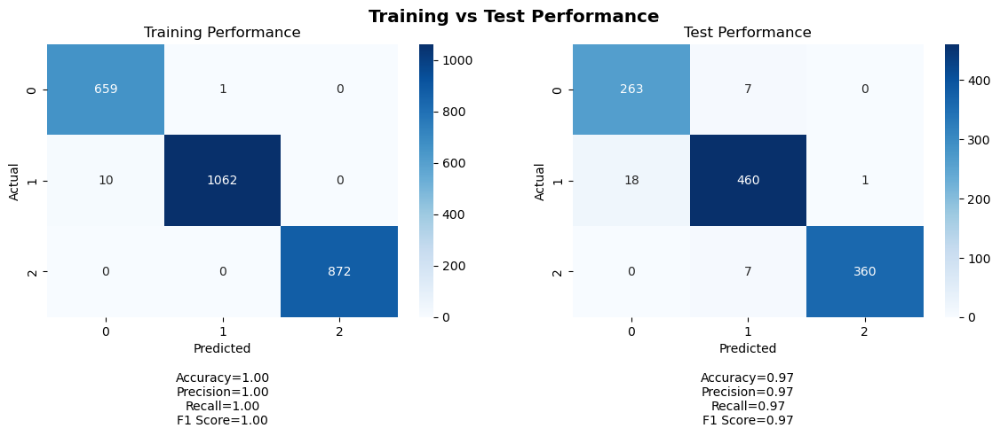

Training Metrics:
Accuracy: 0.9957757296466974
Precision: 0.9958241407619166
Recall: 0.9957757296466974
F1 Score: 0.9957811294308571

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9709142710672134
Recall: 0.9704301075268817
F1 Score: 0.9705466044051967

Training Confusion Matrix:
Class 0 - TP: 659, FP: 10, TN: 1934, FN: 1
Class 1 - TP: 1062, FP: 1, TN: 1531, FN: 10
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 18, TN: 828, FN: 7
Class 1 - TP: 460, FP: 14, TN: 623, FN: 19
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 2ms/step


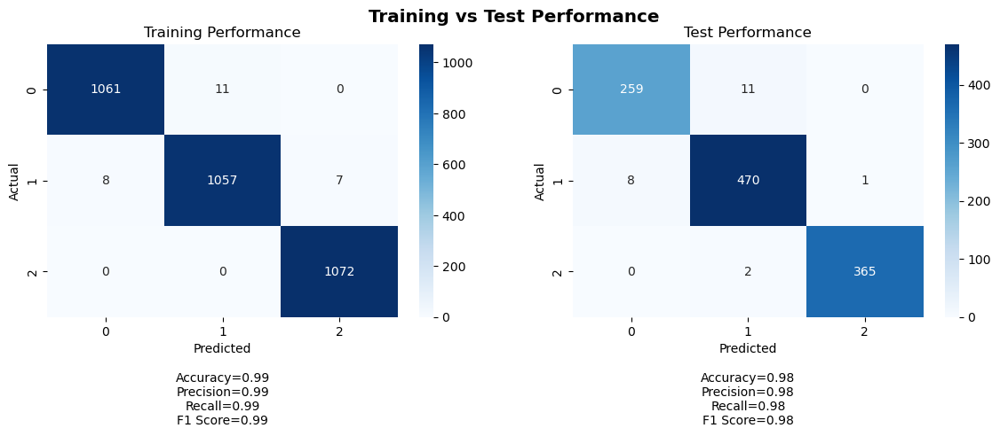

Training Metrics:
Accuracy: 0.9919154228855721
Precision: 0.991909752185433
Recall: 0.9919154228855721
F1 Score: 0.9919072697291831

Test Metrics:
Accuracy: 0.9802867383512545
Precision: 0.9803002155686379
Recall: 0.9802867383512545
F1 Score: 0.9802783324689243

Training Confusion Matrix:
Class 0 - TP: 1061, FP: 8, TN: 2136, FN: 11
Class 1 - TP: 1057, FP: 11, TN: 2133, FN: 15
Class 2 - TP: 1072, FP: 7, TN: 2137, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 8, TN: 838, FN: 11
Class 1 - TP: 470, FP: 13, TN: 624, FN: 9
Class 2 - TP: 365, FP: 1, TN: 748, FN: 2
35/35 [==============================] - 0s 2ms/step


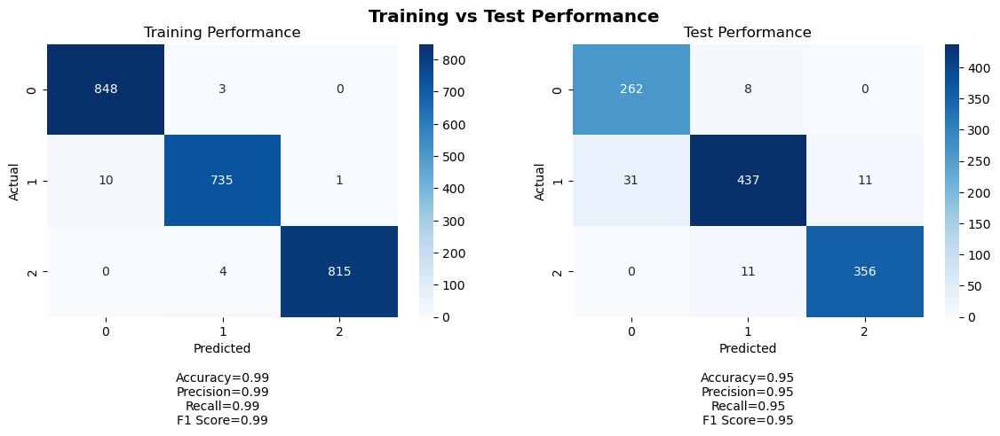

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9925662966729885
Recall: 0.9925496688741722
F1 Score: 0.9925487760977783

Test Metrics:
Accuracy: 0.9453405017921147
Precision: 0.9466622883204685
Recall: 0.9453405017921147
F1 Score: 0.9453820410773708

Training Confusion Matrix:
Class 0 - TP: 848, FP: 10, TN: 1555, FN: 3
Class 1 - TP: 735, FP: 7, TN: 1663, FN: 11
Class 2 - TP: 815, FP: 1, TN: 1596, FN: 4

Test Confusion Matrix:
Class 0 - TP: 262, FP: 31, TN: 815, FN: 8
Class 1 - TP: 437, FP: 19, TN: 618, FN: 42
Class 2 - TP: 356, FP: 11, TN: 738, FN: 11
35/35 [==============================] - 0s 1ms/step


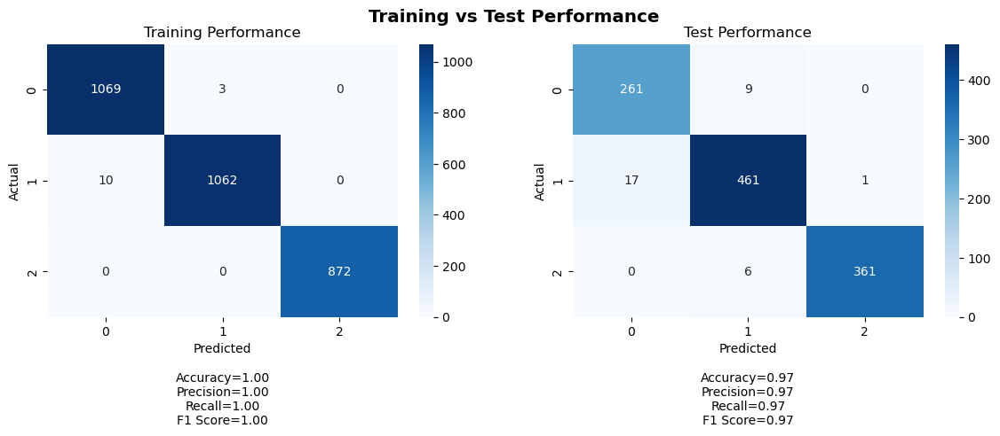

 66%|██████▌   | 66/100 [3:44:21<1:32:33, 163.35s/it]

Training Metrics:
Accuracy: 0.9956896551724138
Precision: 0.9957046275113703
Recall: 0.9956896551724138
F1 Score: 0.9956896092247789

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9707713787305299
Recall: 0.9704301075268817
F1 Score: 0.9705322070557315

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 10, TN: 1934, FN: 3
Class 1 - TP: 1062, FP: 3, TN: 1941, FN: 10
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 17, TN: 829, FN: 9
Class 1 - TP: 461, FP: 15, TN: 622, FN: 18
Class 2 - TP: 361, FP: 1, TN: 748, FN: 6
35/35 [==============================] - 0s 2ms/step


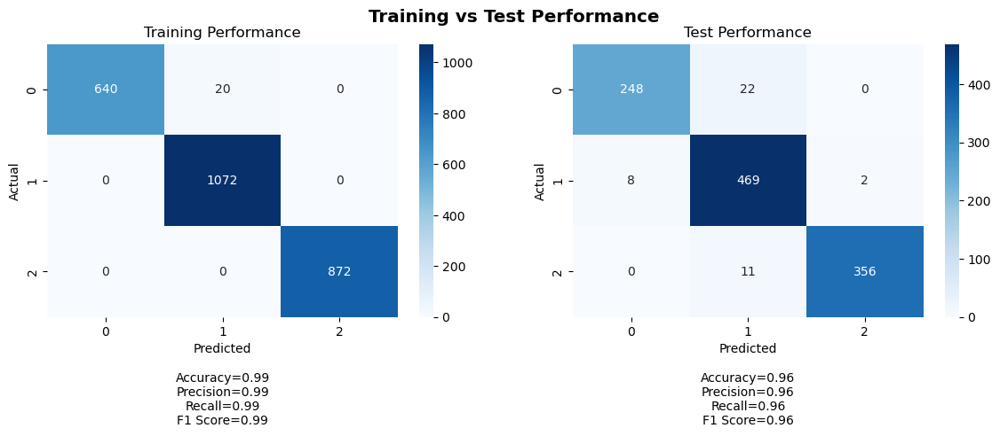

Training Metrics:
Accuracy: 0.9923195084485407
Precision: 0.9924601767919741
Recall: 0.9923195084485407
F1 Score: 0.9922959198494349

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9623872516681238
Recall: 0.9614695340501792
F1 Score: 0.961491172287696

Training Confusion Matrix:
Class 0 - TP: 640, FP: 0, TN: 1944, FN: 20
Class 1 - TP: 1072, FP: 20, TN: 1512, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 248, FP: 8, TN: 838, FN: 22
Class 1 - TP: 469, FP: 33, TN: 604, FN: 10
Class 2 - TP: 356, FP: 2, TN: 747, FN: 11
35/35 [==============================] - 0s 2ms/step


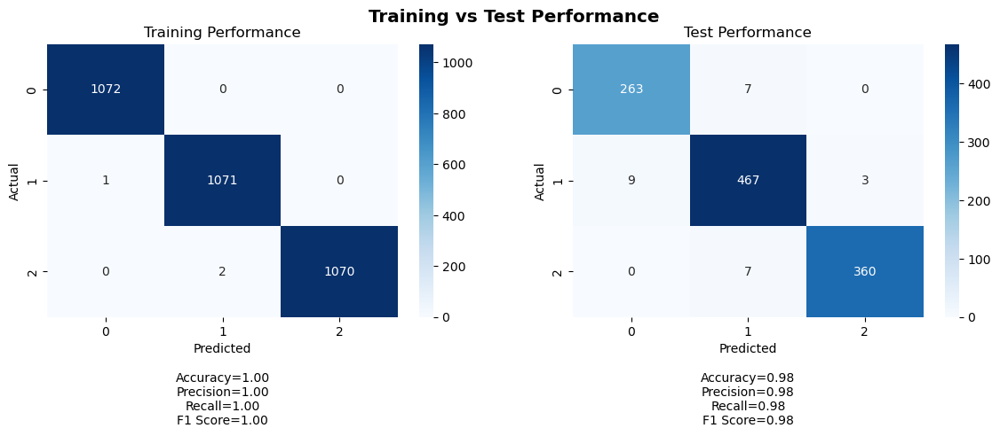

Training Metrics:
Accuracy: 0.9990671641791045
Precision: 0.9990680335507922
Recall: 0.9990671641791045
F1 Score: 0.9990671637730462

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9767843464852694
Recall: 0.9767025089605734
F1 Score: 0.9767286795414537

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 1, TN: 2143, FN: 0
Class 1 - TP: 1071, FP: 2, TN: 2142, FN: 1
Class 2 - TP: 1070, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 263, FP: 9, TN: 837, FN: 7
Class 1 - TP: 467, FP: 14, TN: 623, FN: 12
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 4ms/step


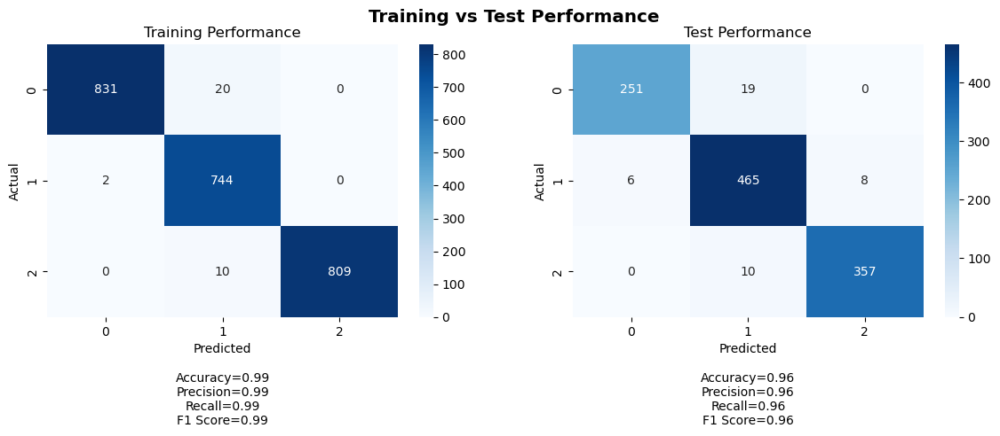

Training Metrics:
Accuracy: 0.9867549668874173
Precision: 0.9871862806419349
Recall: 0.9867549668874173
F1 Score: 0.9868155824148357

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9619473380283654
Recall: 0.9614695340501792
F1 Score: 0.961468198760187

Training Confusion Matrix:
Class 0 - TP: 831, FP: 2, TN: 1563, FN: 20
Class 1 - TP: 744, FP: 30, TN: 1640, FN: 2
Class 2 - TP: 809, FP: 0, TN: 1597, FN: 10

Test Confusion Matrix:
Class 0 - TP: 251, FP: 6, TN: 840, FN: 19
Class 1 - TP: 465, FP: 29, TN: 608, FN: 14
Class 2 - TP: 357, FP: 8, TN: 741, FN: 10
35/35 [==============================] - 0s 2ms/step


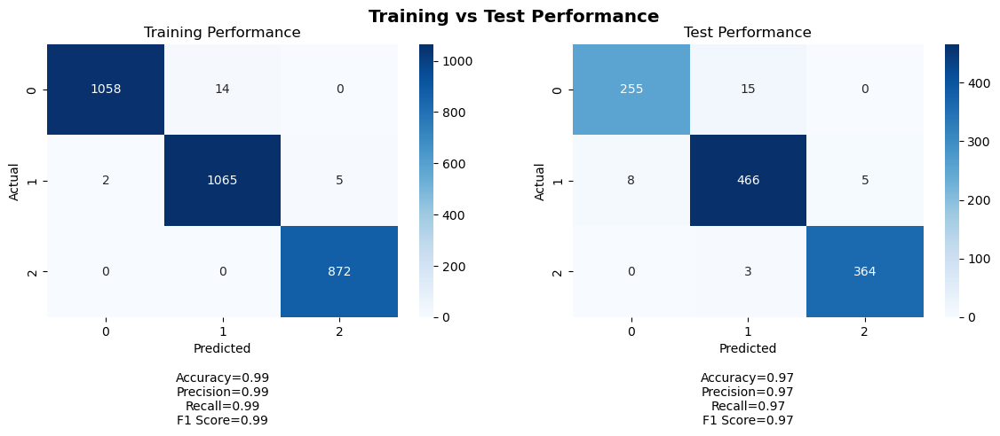

 67%|██████▋   | 67/100 [3:47:54<1:37:55, 178.04s/it]

Training Metrics:
Accuracy: 0.9930371352785146
Precision: 0.9930691941643761
Recall: 0.9930371352785146
F1 Score: 0.9930359048249128

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9722223323723761
Recall: 0.9722222222222222
F1 Score: 0.9721687413478661

Training Confusion Matrix:
Class 0 - TP: 1058, FP: 2, TN: 1942, FN: 14
Class 1 - TP: 1065, FP: 14, TN: 1930, FN: 7
Class 2 - TP: 872, FP: 5, TN: 2139, FN: 0

Test Confusion Matrix:
Class 0 - TP: 255, FP: 8, TN: 838, FN: 15
Class 1 - TP: 466, FP: 18, TN: 619, FN: 13
Class 2 - TP: 364, FP: 5, TN: 744, FN: 3
35/35 [==============================] - 0s 2ms/step


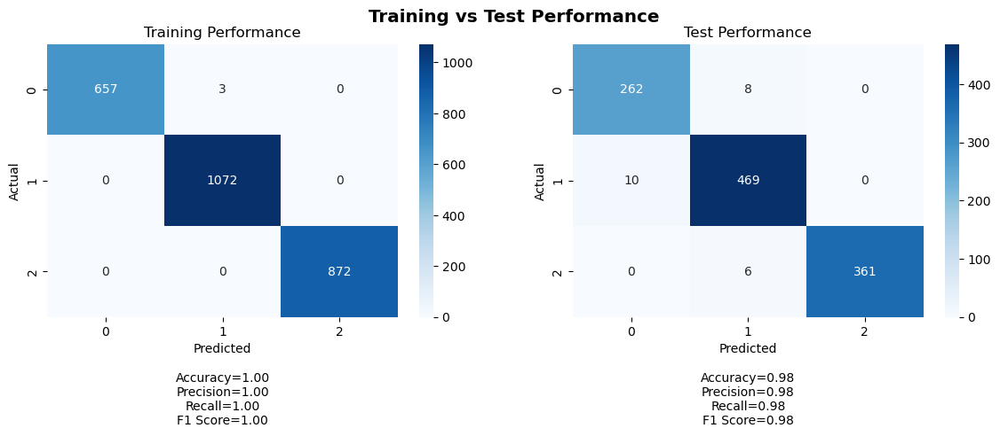

Training Metrics:
Accuracy: 0.9988479262672811
Precision: 0.9988511413567678
Recall: 0.9988479262672811
F1 Score: 0.9988474190058918

Test Metrics:
Accuracy: 0.978494623655914
Precision: 0.9786644009325718
Recall: 0.978494623655914
F1 Score: 0.9785469364760521

Training Confusion Matrix:
Class 0 - TP: 657, FP: 0, TN: 1944, FN: 3
Class 1 - TP: 1072, FP: 3, TN: 1529, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 10, TN: 836, FN: 8
Class 1 - TP: 469, FP: 14, TN: 623, FN: 10
Class 2 - TP: 361, FP: 0, TN: 749, FN: 6
35/35 [==============================] - 0s 2ms/step


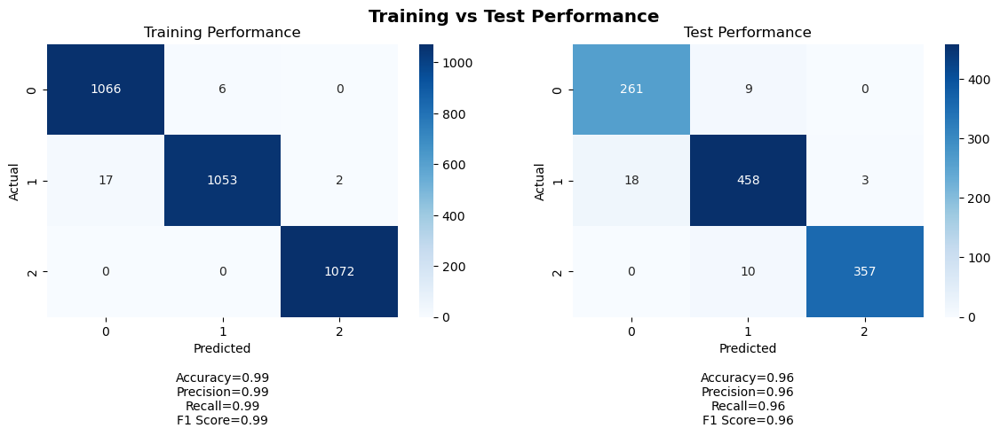

Training Metrics:
Accuracy: 0.992226368159204
Precision: 0.9922583142155597
Recall: 0.992226368159204
F1 Score: 0.9922211994351037

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9645543434209017
Recall: 0.96415770609319
F1 Score: 0.9642624413095762

Training Confusion Matrix:
Class 0 - TP: 1066, FP: 17, TN: 2127, FN: 6
Class 1 - TP: 1053, FP: 6, TN: 2138, FN: 19
Class 2 - TP: 1072, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 18, TN: 828, FN: 9
Class 1 - TP: 458, FP: 19, TN: 618, FN: 21
Class 2 - TP: 357, FP: 3, TN: 746, FN: 10
35/35 [==============================] - 0s 1ms/step


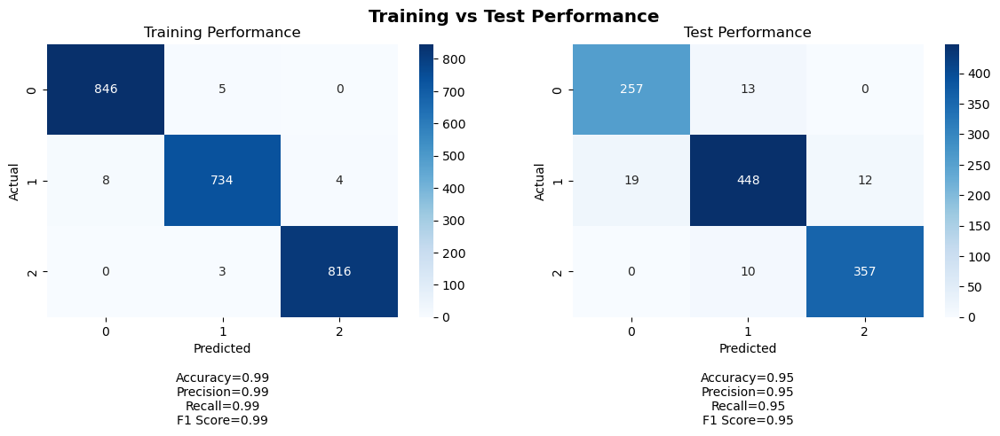

Training Metrics:
Accuracy: 0.9917218543046358
Precision: 0.9917176549704639
Recall: 0.9917218543046358
F1 Score: 0.9917163454793712

Test Metrics:
Accuracy: 0.9516129032258065
Precision: 0.9516912418947757
Recall: 0.9516129032258065
F1 Score: 0.9515935009490317

Training Confusion Matrix:
Class 0 - TP: 846, FP: 8, TN: 1557, FN: 5
Class 1 - TP: 734, FP: 8, TN: 1662, FN: 12
Class 2 - TP: 816, FP: 4, TN: 1593, FN: 3

Test Confusion Matrix:
Class 0 - TP: 257, FP: 19, TN: 827, FN: 13
Class 1 - TP: 448, FP: 23, TN: 614, FN: 31
Class 2 - TP: 357, FP: 12, TN: 737, FN: 10
35/35 [==============================] - 0s 2ms/step


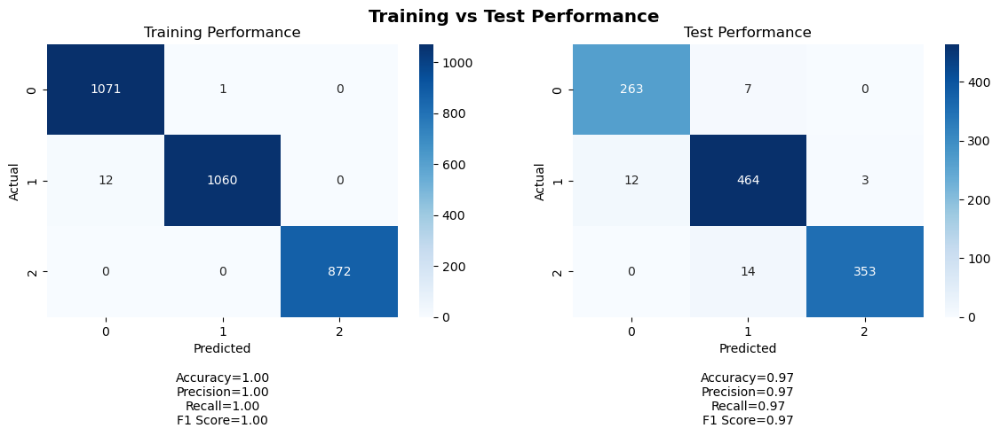

 68%|██████▊   | 68/100 [3:50:34<1:32:04, 172.63s/it]

Training Metrics:
Accuracy: 0.9956896551724138
Precision: 0.9957266299995866
Recall: 0.9956896551724138
F1 Score: 0.9956895417081093

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9680871675657718
Recall: 0.967741935483871
F1 Score: 0.9678045402240119

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 12, TN: 1932, FN: 1
Class 1 - TP: 1060, FP: 1, TN: 1943, FN: 12
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 12, TN: 834, FN: 7
Class 1 - TP: 464, FP: 21, TN: 616, FN: 15
Class 2 - TP: 353, FP: 3, TN: 746, FN: 14
35/35 [==============================] - 0s 2ms/step


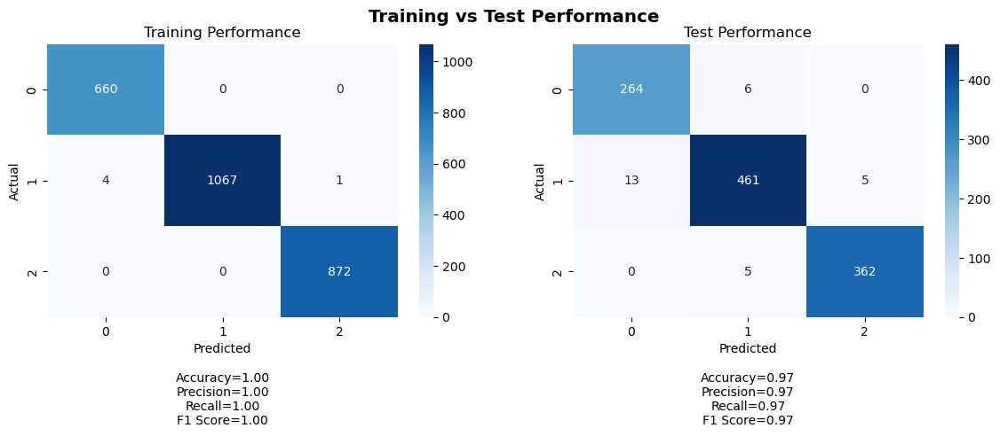

Training Metrics:
Accuracy: 0.9980798771121352
Precision: 0.9980895706071099
Recall: 0.9980798771121352
F1 Score: 0.9980800633551292

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9741625307010531
Recall: 0.9740143369175627
F1 Score: 0.9740276366074522

Training Confusion Matrix:
Class 0 - TP: 660, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1067, FP: 0, TN: 1532, FN: 5
Class 2 - TP: 872, FP: 1, TN: 1731, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 13, TN: 833, FN: 6
Class 1 - TP: 461, FP: 11, TN: 626, FN: 18
Class 2 - TP: 362, FP: 5, TN: 744, FN: 5
35/35 [==============================] - 0s 2ms/step


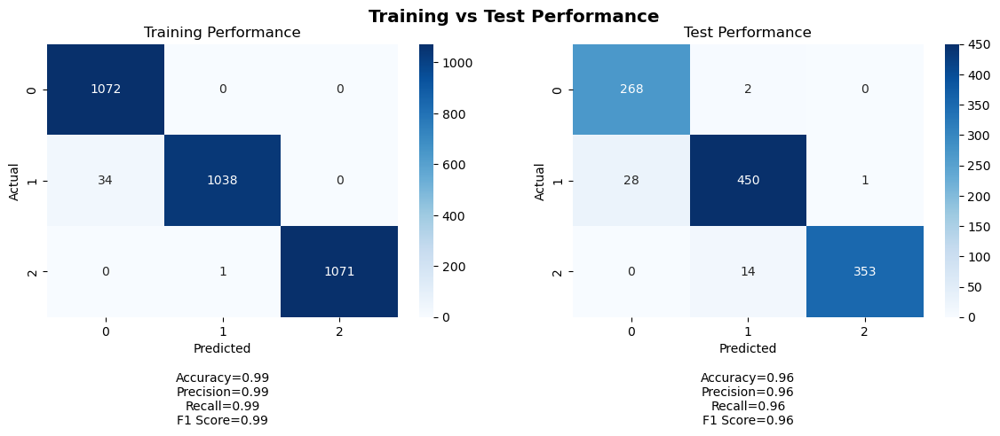

Training Metrics:
Accuracy: 0.9891169154228856
Precision: 0.9894320418680501
Recall: 0.9891169154228856
F1 Score: 0.9891142974925188

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9614483730862788
Recall: 0.9596774193548387
F1 Score: 0.9598963201416227

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 34, TN: 2110, FN: 0
Class 1 - TP: 1038, FP: 1, TN: 2143, FN: 34
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 268, FP: 28, TN: 818, FN: 2
Class 1 - TP: 450, FP: 16, TN: 621, FN: 29
Class 2 - TP: 353, FP: 1, TN: 748, FN: 14
35/35 [==============================] - 0s 2ms/step


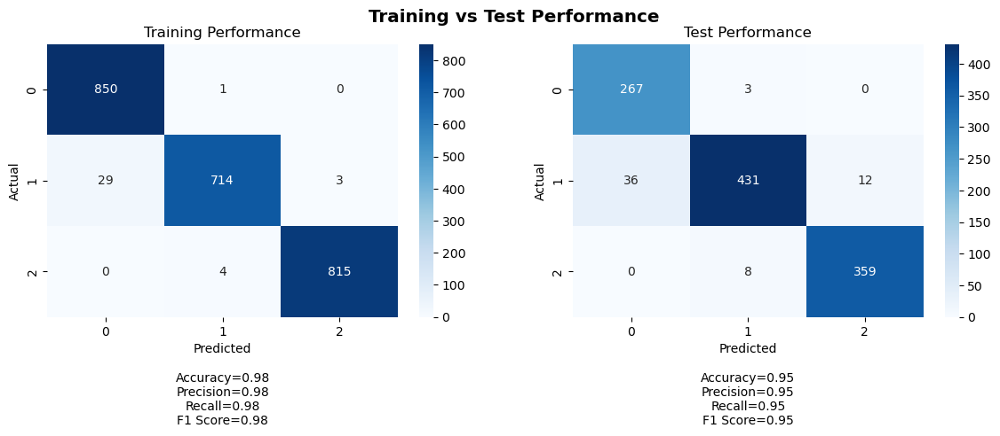

Training Metrics:
Accuracy: 0.9846854304635762
Precision: 0.9849885549498419
Recall: 0.9846854304635762
F1 Score: 0.9846439076480351

Test Metrics:
Accuracy: 0.9471326164874552
Precision: 0.9499367004063424
Recall: 0.9471326164874552
F1 Score: 0.9471255486800556

Training Confusion Matrix:
Class 0 - TP: 850, FP: 29, TN: 1536, FN: 1
Class 1 - TP: 714, FP: 5, TN: 1665, FN: 32
Class 2 - TP: 815, FP: 3, TN: 1594, FN: 4

Test Confusion Matrix:
Class 0 - TP: 267, FP: 36, TN: 810, FN: 3
Class 1 - TP: 431, FP: 11, TN: 626, FN: 48
Class 2 - TP: 359, FP: 12, TN: 737, FN: 8
35/35 [==============================] - 0s 2ms/step


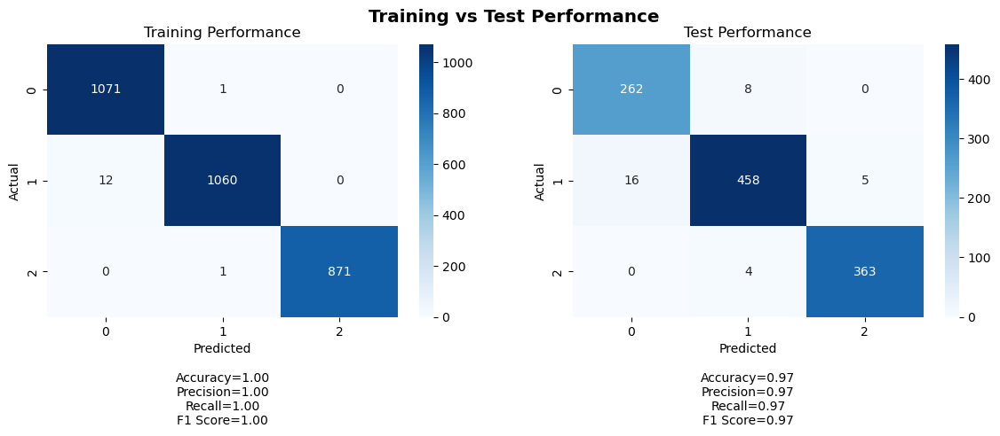

 69%|██████▉   | 69/100 [3:53:13<1:27:06, 168.60s/it]

Training Metrics:
Accuracy: 0.9953580901856764
Precision: 0.9953922583769217
Recall: 0.9953580901856764
F1 Score: 0.995358119875087

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9706489528469133
Recall: 0.9704301075268817
F1 Score: 0.9704523516352471

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 12, TN: 1932, FN: 1
Class 1 - TP: 1060, FP: 2, TN: 1942, FN: 12
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 262, FP: 16, TN: 830, FN: 8
Class 1 - TP: 458, FP: 12, TN: 625, FN: 21
Class 2 - TP: 363, FP: 5, TN: 744, FN: 4
35/35 [==============================] - 0s 2ms/step


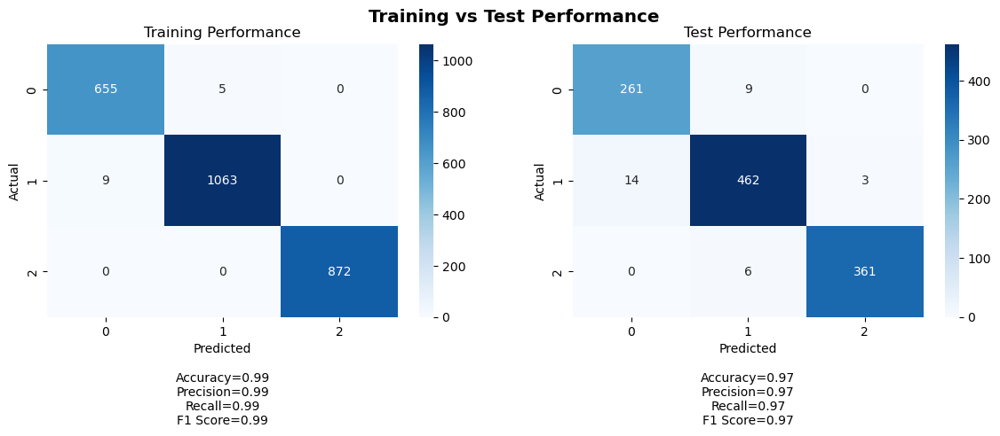

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.9946372850521159
Recall: 0.9946236559139785
F1 Score: 0.9946267526590263

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9714757411272932
Recall: 0.9713261648745519
F1 Score: 0.9713741612289888

Training Confusion Matrix:
Class 0 - TP: 655, FP: 9, TN: 1935, FN: 5
Class 1 - TP: 1063, FP: 5, TN: 1527, FN: 9
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 14, TN: 832, FN: 9
Class 1 - TP: 462, FP: 15, TN: 622, FN: 17
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 2ms/step


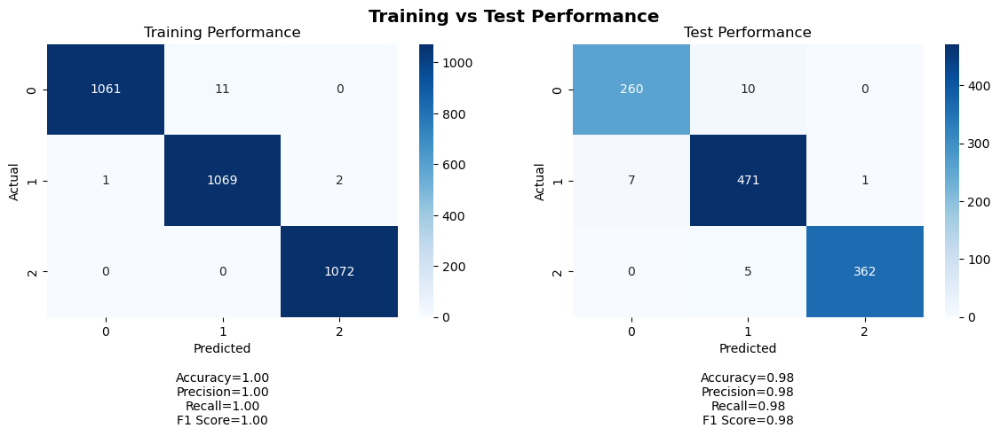

Training Metrics:
Accuracy: 0.9956467661691543
Precision: 0.9956703326120678
Recall: 0.9956467661691543
F1 Score: 0.9956464048686563

Test Metrics:
Accuracy: 0.9793906810035843
Precision: 0.9795039233096562
Recall: 0.9793906810035843
F1 Score: 0.9794081499098882

Training Confusion Matrix:
Class 0 - TP: 1061, FP: 1, TN: 2143, FN: 11
Class 1 - TP: 1069, FP: 11, TN: 2133, FN: 3
Class 2 - TP: 1072, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 7, TN: 839, FN: 10
Class 1 - TP: 471, FP: 15, TN: 622, FN: 8
Class 2 - TP: 362, FP: 1, TN: 748, FN: 5
35/35 [==============================] - 0s 2ms/step


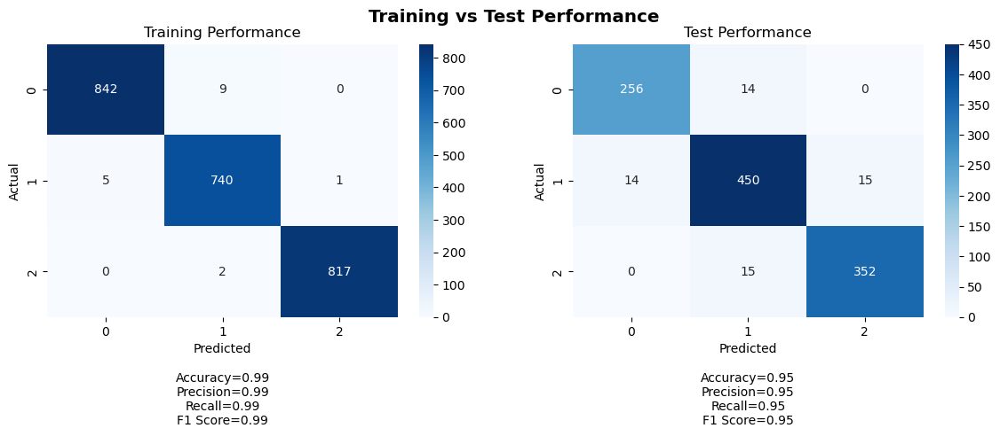

Training Metrics:
Accuracy: 0.9929635761589404
Precision: 0.9929836094540476
Recall: 0.9929635761589404
F1 Score: 0.9929681224399897

Test Metrics:
Accuracy: 0.9480286738351255
Precision: 0.9480286738351255
Recall: 0.9480286738351255
F1 Score: 0.9480286738351255

Training Confusion Matrix:
Class 0 - TP: 842, FP: 5, TN: 1560, FN: 9
Class 1 - TP: 740, FP: 11, TN: 1659, FN: 6
Class 2 - TP: 817, FP: 1, TN: 1596, FN: 2

Test Confusion Matrix:
Class 0 - TP: 256, FP: 14, TN: 832, FN: 14
Class 1 - TP: 450, FP: 29, TN: 608, FN: 29
Class 2 - TP: 352, FP: 15, TN: 734, FN: 15
35/35 [==============================] - 0s 2ms/step


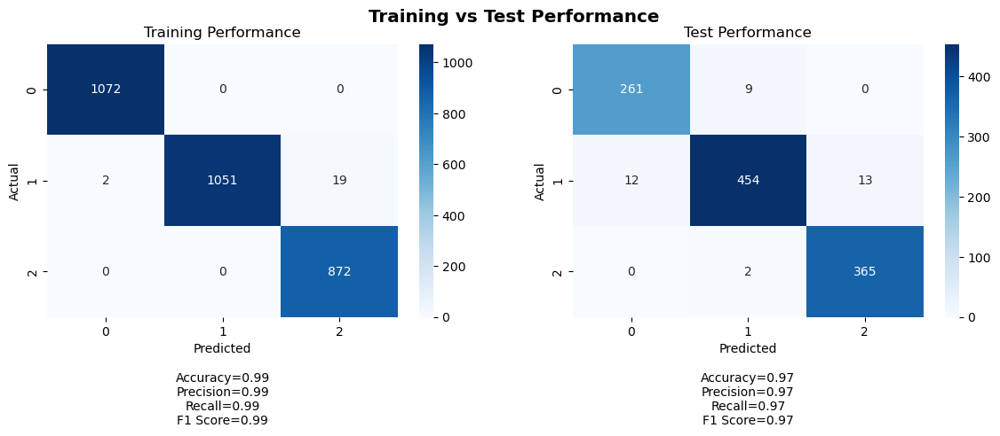

 70%|███████   | 70/100 [3:55:49<1:22:25, 164.85s/it]

Training Metrics:
Accuracy: 0.9930371352785146
Precision: 0.9931727079354383
Recall: 0.9930371352785146
F1 Score: 0.9930369535180893

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.967902322772828
Recall: 0.967741935483871
F1 Score: 0.9676539427887231

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1051, FP: 0, TN: 1944, FN: 21
Class 2 - TP: 872, FP: 19, TN: 2125, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 12, TN: 834, FN: 9
Class 1 - TP: 454, FP: 11, TN: 626, FN: 25
Class 2 - TP: 365, FP: 13, TN: 736, FN: 2
35/35 [==============================] - 0s 2ms/step


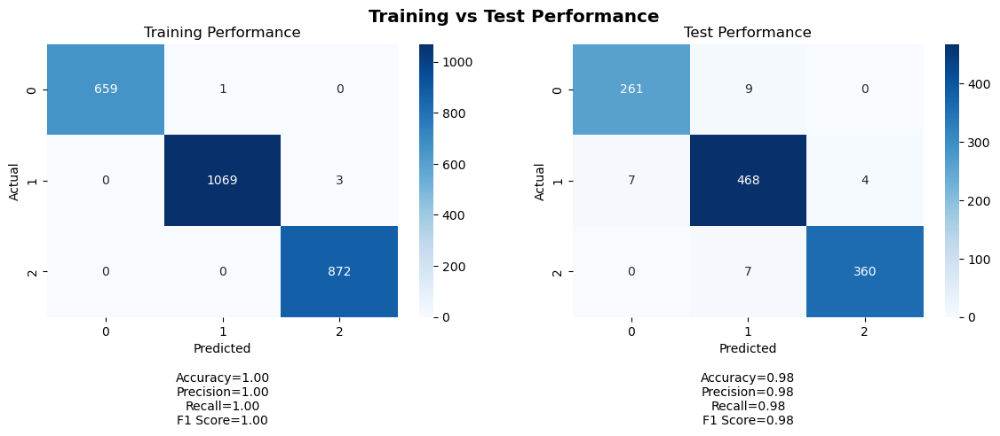

Training Metrics:
Accuracy: 0.9984639016897081
Precision: 0.998467133853843
Recall: 0.9984639016897081
F1 Score: 0.9984640281703593

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9758782109473667
Recall: 0.9758064516129032
F1 Score: 0.9758223851806155

Training Confusion Matrix:
Class 0 - TP: 659, FP: 0, TN: 1944, FN: 1
Class 1 - TP: 1069, FP: 1, TN: 1531, FN: 3
Class 2 - TP: 872, FP: 3, TN: 1729, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 7, TN: 839, FN: 9
Class 1 - TP: 468, FP: 16, TN: 621, FN: 11
Class 2 - TP: 360, FP: 4, TN: 745, FN: 7
35/35 [==============================] - 0s 2ms/step


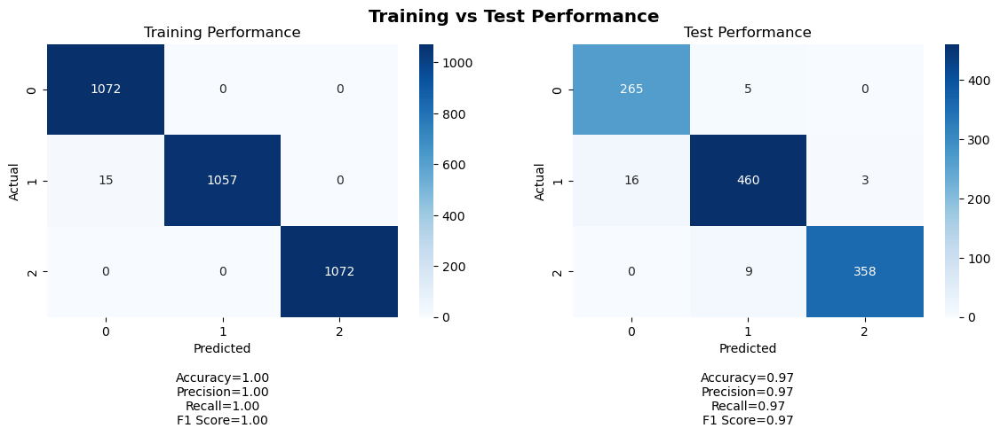

Training Metrics:
Accuracy: 0.9953358208955224
Precision: 0.9954001839926403
Recall: 0.9953358208955224
F1 Score: 0.9953355925831571

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9708143312713562
Recall: 0.9704301075268817
F1 Score: 0.9704960569847647

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 15, TN: 2129, FN: 0
Class 1 - TP: 1057, FP: 0, TN: 2144, FN: 15
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 16, TN: 830, FN: 5
Class 1 - TP: 460, FP: 14, TN: 623, FN: 19
Class 2 - TP: 358, FP: 3, TN: 746, FN: 9
35/35 [==============================] - 0s 3ms/step


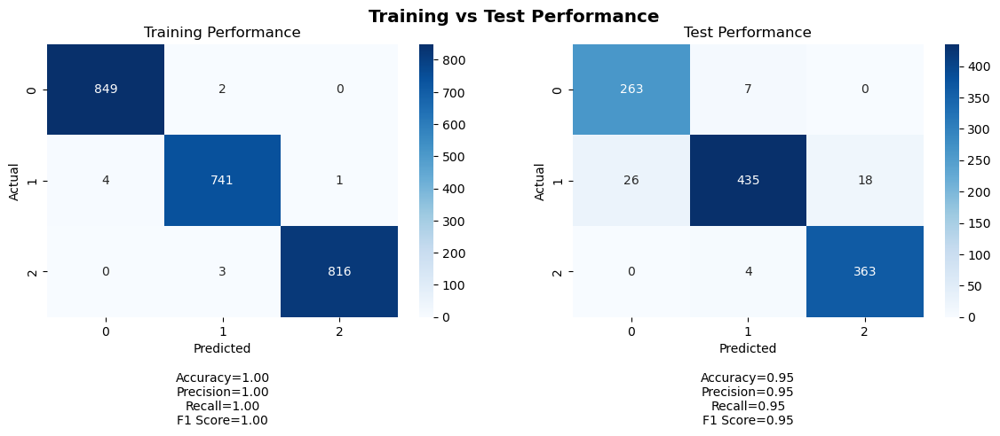

Training Metrics:
Accuracy: 0.9958609271523179
Precision: 0.9958637958125515
Recall: 0.9958609271523179
F1 Score: 0.9958613725740834

Test Metrics:
Accuracy: 0.9507168458781362
Precision: 0.952111880410481
Recall: 0.9507168458781362
F1 Score: 0.9505247528404053

Training Confusion Matrix:
Class 0 - TP: 849, FP: 4, TN: 1561, FN: 2
Class 1 - TP: 741, FP: 5, TN: 1665, FN: 5
Class 2 - TP: 816, FP: 1, TN: 1596, FN: 3

Test Confusion Matrix:
Class 0 - TP: 263, FP: 26, TN: 820, FN: 7
Class 1 - TP: 435, FP: 11, TN: 626, FN: 44
Class 2 - TP: 363, FP: 18, TN: 731, FN: 4
35/35 [==============================] - 0s 2ms/step


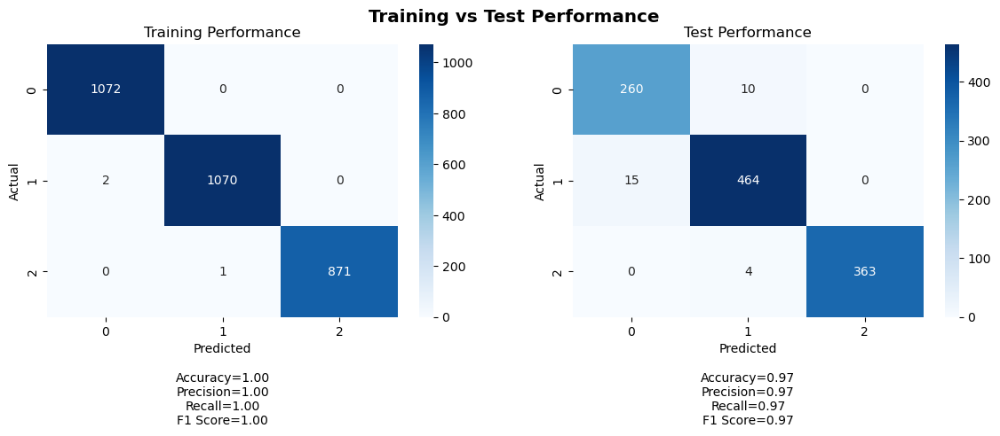

 71%|███████   | 71/100 [3:58:40<1:20:36, 166.76s/it]

Training Metrics:
Accuracy: 0.9990053050397878
Precision: 0.9990062303342074
Recall: 0.9990053050397878
F1 Score: 0.999005286853906

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9742324718367369
Recall: 0.9740143369175627
F1 Score: 0.9740936993546786

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1070, FP: 1, TN: 1943, FN: 2
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 260, FP: 15, TN: 831, FN: 10
Class 1 - TP: 464, FP: 14, TN: 623, FN: 15
Class 2 - TP: 363, FP: 0, TN: 749, FN: 4
35/35 [==============================] - 0s 2ms/step


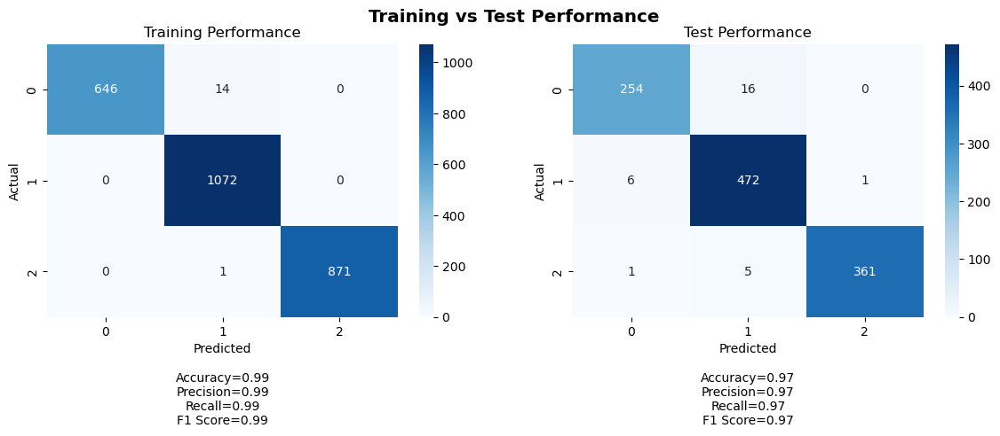

Training Metrics:
Accuracy: 0.9942396313364056
Precision: 0.9943191212443668
Recall: 0.9942396313364056
F1 Score: 0.9942307151730355

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9743200335298748
Recall: 0.9740143369175627
F1 Score: 0.9739988578399008

Training Confusion Matrix:
Class 0 - TP: 646, FP: 0, TN: 1944, FN: 14
Class 1 - TP: 1072, FP: 15, TN: 1517, FN: 0
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 254, FP: 7, TN: 839, FN: 16
Class 1 - TP: 472, FP: 21, TN: 616, FN: 7
Class 2 - TP: 361, FP: 1, TN: 748, FN: 6
35/35 [==============================] - 0s 2ms/step


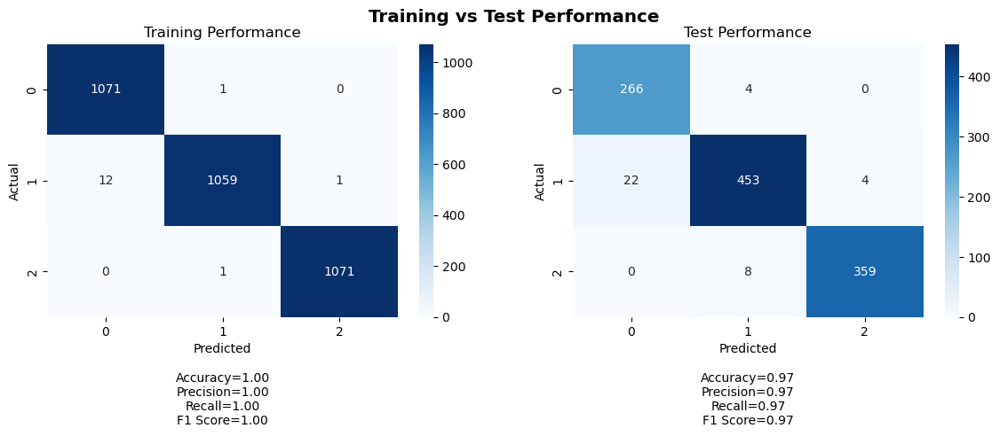

Training Metrics:
Accuracy: 0.9953358208955224
Precision: 0.9953672725438419
Recall: 0.9953358208955224
F1 Score: 0.9953341109253319

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9668186671527179
Recall: 0.9659498207885304
F1 Score: 0.9660436366177096

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 12, TN: 2132, FN: 1
Class 1 - TP: 1059, FP: 2, TN: 2142, FN: 13
Class 2 - TP: 1071, FP: 1, TN: 2143, FN: 1

Test Confusion Matrix:
Class 0 - TP: 266, FP: 22, TN: 824, FN: 4
Class 1 - TP: 453, FP: 12, TN: 625, FN: 26
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 2ms/step


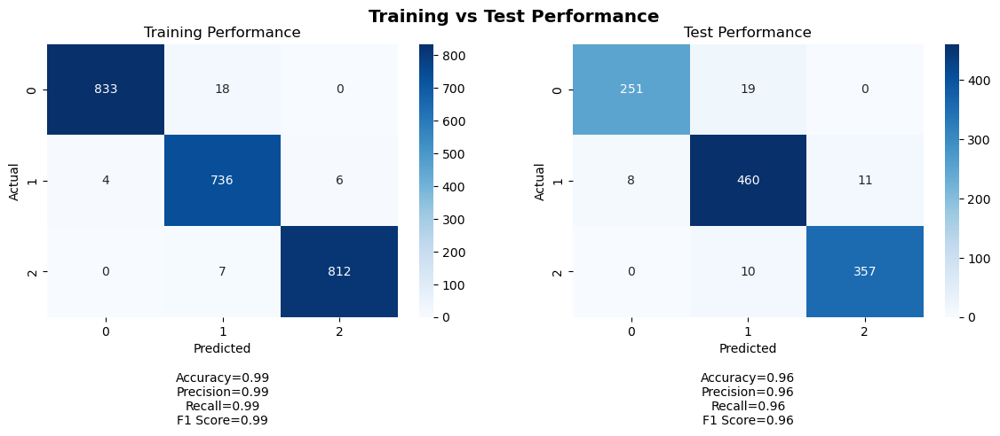

Training Metrics:
Accuracy: 0.9855132450331126
Precision: 0.9856864785136278
Recall: 0.9855132450331126
F1 Score: 0.9855459371776425

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9572429838703801
Recall: 0.956989247311828
F1 Score: 0.9569726713818094

Training Confusion Matrix:
Class 0 - TP: 833, FP: 4, TN: 1561, FN: 18
Class 1 - TP: 736, FP: 25, TN: 1645, FN: 10
Class 2 - TP: 812, FP: 6, TN: 1591, FN: 7

Test Confusion Matrix:
Class 0 - TP: 251, FP: 8, TN: 838, FN: 19
Class 1 - TP: 460, FP: 29, TN: 608, FN: 19
Class 2 - TP: 357, FP: 11, TN: 738, FN: 10
35/35 [==============================] - 0s 2ms/step


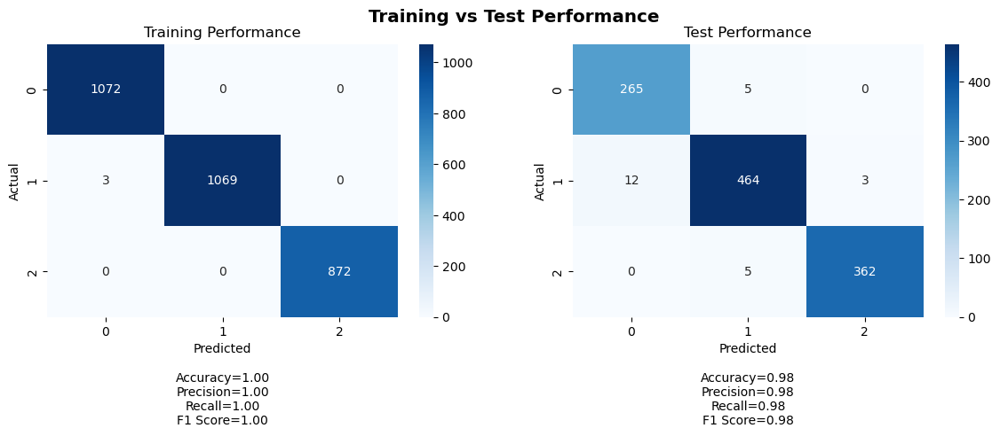

 72%|███████▏  | 72/100 [4:01:29<1:18:02, 167.23s/it]

Training Metrics:
Accuracy: 0.9990053050397878
Precision: 0.9990080809327001
Recall: 0.9990053050397878
F1 Score: 0.9990053030922598

Test Metrics:
Accuracy: 0.9775985663082437
Precision: 0.9777610443631193
Recall: 0.9775985663082437
F1 Score: 0.9776274765267959

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 3, TN: 1941, FN: 0
Class 1 - TP: 1069, FP: 0, TN: 1944, FN: 3
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 12, TN: 834, FN: 5
Class 1 - TP: 464, FP: 10, TN: 627, FN: 15
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 2ms/step


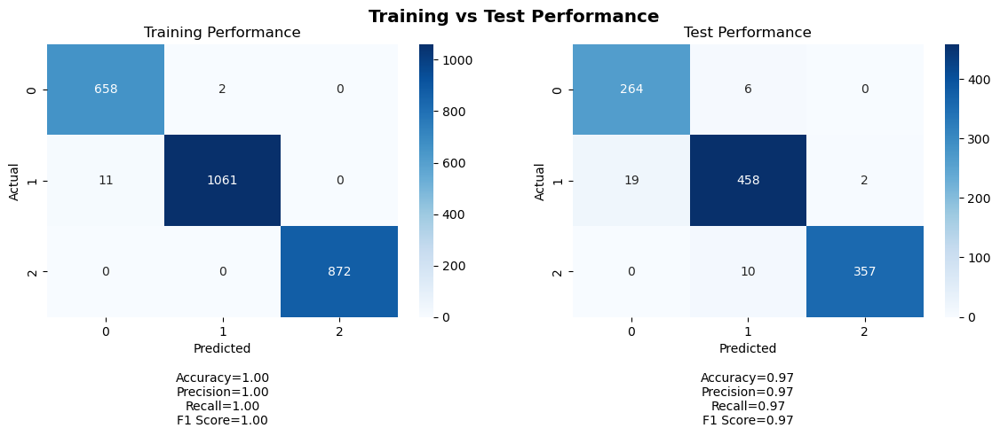

Training Metrics:
Accuracy: 0.9950076804915514
Precision: 0.9950580064726874
Recall: 0.9950076804915514
F1 Score: 0.9950140620546494

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9674367803790334
Recall: 0.9668458781362007
F1 Score: 0.9669629696287315

Training Confusion Matrix:
Class 0 - TP: 658, FP: 11, TN: 1933, FN: 2
Class 1 - TP: 1061, FP: 2, TN: 1530, FN: 11
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 19, TN: 827, FN: 6
Class 1 - TP: 458, FP: 16, TN: 621, FN: 21
Class 2 - TP: 357, FP: 2, TN: 747, FN: 10
35/35 [==============================] - 0s 2ms/step


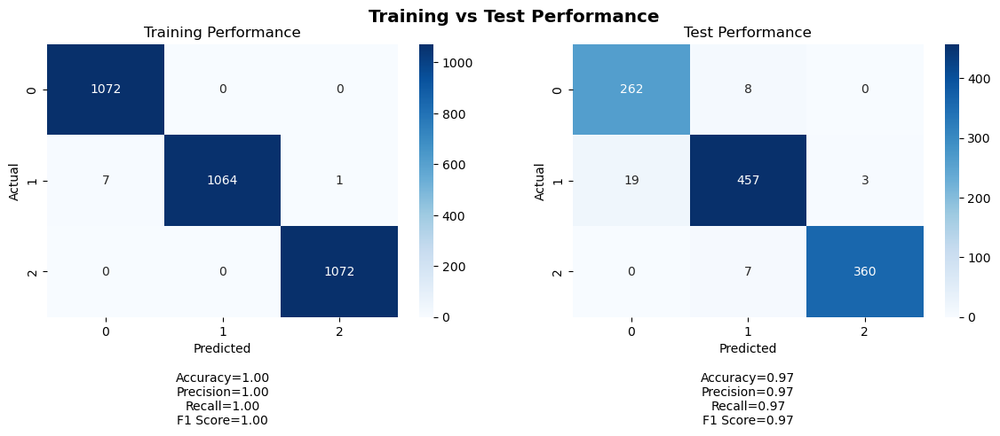

Training Metrics:
Accuracy: 0.9975124378109452
Precision: 0.9975268483785311
Recall: 0.9975124378109452
F1 Score: 0.99751139361877

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9672833841968052
Recall: 0.9668458781362007
F1 Score: 0.9669408066949144

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 7, TN: 2137, FN: 0
Class 1 - TP: 1064, FP: 0, TN: 2144, FN: 8
Class 2 - TP: 1072, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 19, TN: 827, FN: 8
Class 1 - TP: 457, FP: 15, TN: 622, FN: 22
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


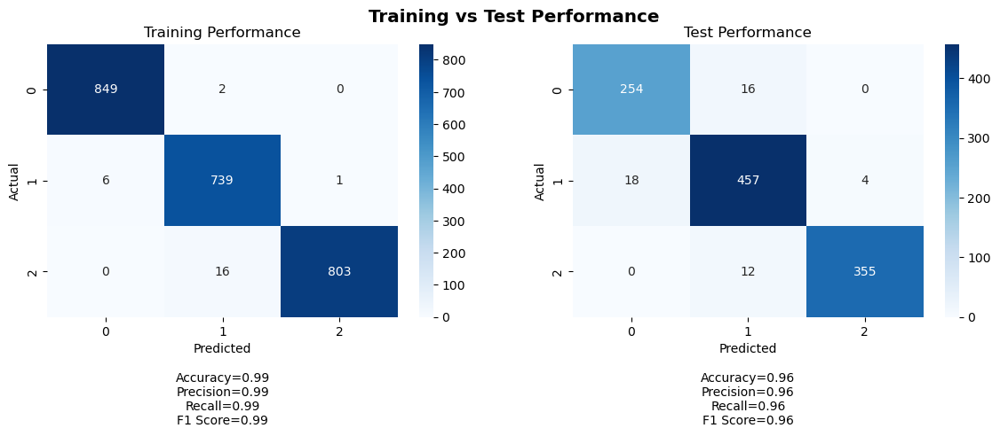

Training Metrics:
Accuracy: 0.9896523178807947
Precision: 0.989764475266431
Recall: 0.9896523178807947
F1 Score: 0.9896615497257037

Test Metrics:
Accuracy: 0.9551971326164874
Precision: 0.9555462439099489
Recall: 0.9551971326164874
F1 Score: 0.9553137795852014

Training Confusion Matrix:
Class 0 - TP: 849, FP: 6, TN: 1559, FN: 2
Class 1 - TP: 739, FP: 18, TN: 1652, FN: 7
Class 2 - TP: 803, FP: 1, TN: 1596, FN: 16

Test Confusion Matrix:
Class 0 - TP: 254, FP: 18, TN: 828, FN: 16
Class 1 - TP: 457, FP: 28, TN: 609, FN: 22
Class 2 - TP: 355, FP: 4, TN: 745, FN: 12
35/35 [==============================] - 0s 3ms/step


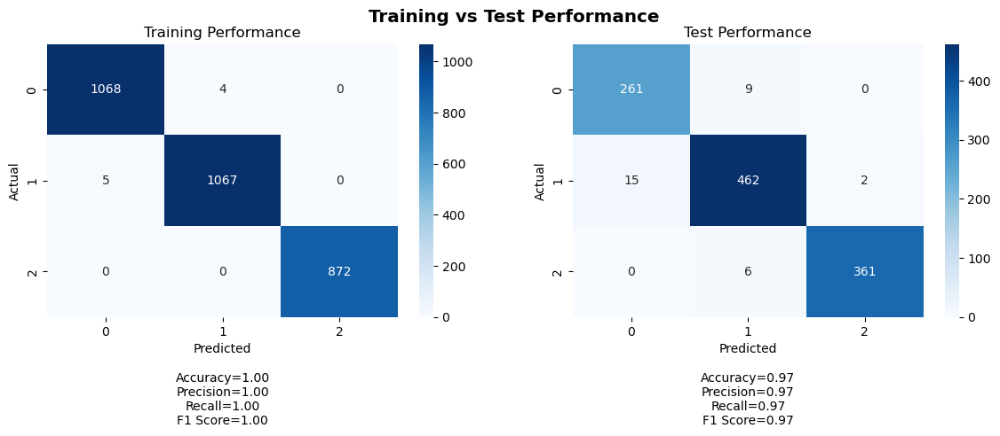

 73%|███████▎  | 73/100 [4:04:26<1:16:37, 170.27s/it]

Training Metrics:
Accuracy: 0.9970159151193634
Precision: 0.9970162218186278
Recall: 0.9970159151193634
F1 Score: 0.9970159144701884

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9715422538595588
Recall: 0.9713261648745519
F1 Score: 0.9713946931185498

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 5, TN: 1939, FN: 4
Class 1 - TP: 1067, FP: 4, TN: 1940, FN: 5
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 15, TN: 831, FN: 9
Class 1 - TP: 462, FP: 15, TN: 622, FN: 17
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


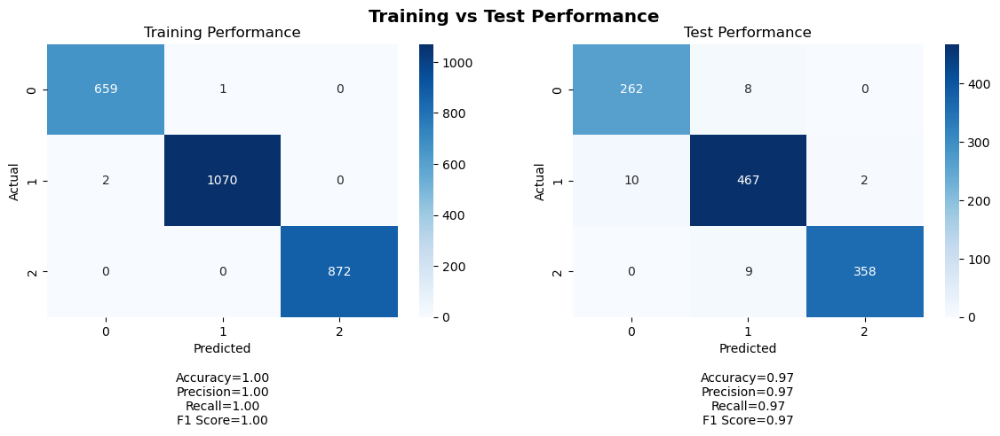

Training Metrics:
Accuracy: 0.9988479262672811
Precision: 0.9988487296512258
Recall: 0.9988479262672811
F1 Score: 0.9988480935292128

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.974202742255902
Recall: 0.9740143369175627
F1 Score: 0.9740641026335426

Training Confusion Matrix:
Class 0 - TP: 659, FP: 2, TN: 1942, FN: 1
Class 1 - TP: 1070, FP: 1, TN: 1531, FN: 2
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 10, TN: 836, FN: 8
Class 1 - TP: 467, FP: 17, TN: 620, FN: 12
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 2ms/step


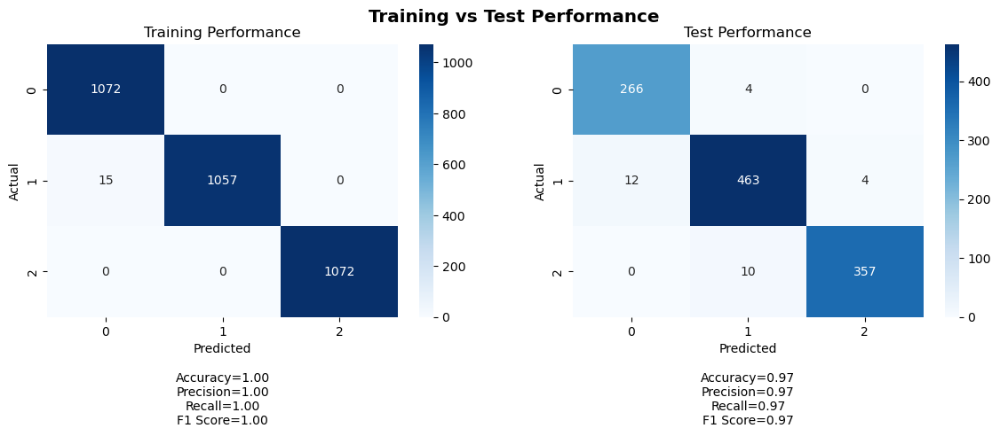

Training Metrics:
Accuracy: 0.9953358208955224
Precision: 0.9954001839926403
Recall: 0.9953358208955224
F1 Score: 0.9953355925831571

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9733155390115625
Recall: 0.9731182795698925
F1 Score: 0.9731431140325606

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 15, TN: 2129, FN: 0
Class 1 - TP: 1057, FP: 0, TN: 2144, FN: 15
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 12, TN: 834, FN: 4
Class 1 - TP: 463, FP: 14, TN: 623, FN: 16
Class 2 - TP: 357, FP: 4, TN: 745, FN: 10
35/35 [==============================] - 0s 2ms/step


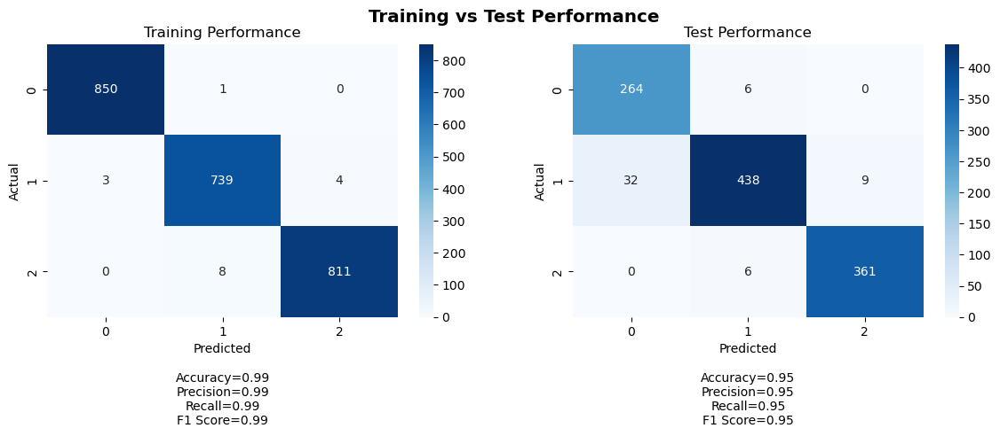

Training Metrics:
Accuracy: 0.9933774834437086
Precision: 0.9933822294151231
Recall: 0.9933774834437086
F1 Score: 0.9933768083774953

Test Metrics:
Accuracy: 0.9525089605734767
Precision: 0.9544000452064969
Recall: 0.9525089605734767
F1 Score: 0.952577138984996

Training Confusion Matrix:
Class 0 - TP: 850, FP: 3, TN: 1562, FN: 1
Class 1 - TP: 739, FP: 9, TN: 1661, FN: 7
Class 2 - TP: 811, FP: 4, TN: 1593, FN: 8

Test Confusion Matrix:
Class 0 - TP: 264, FP: 32, TN: 814, FN: 6
Class 1 - TP: 438, FP: 12, TN: 625, FN: 41
Class 2 - TP: 361, FP: 9, TN: 740, FN: 6
35/35 [==============================] - 0s 2ms/step


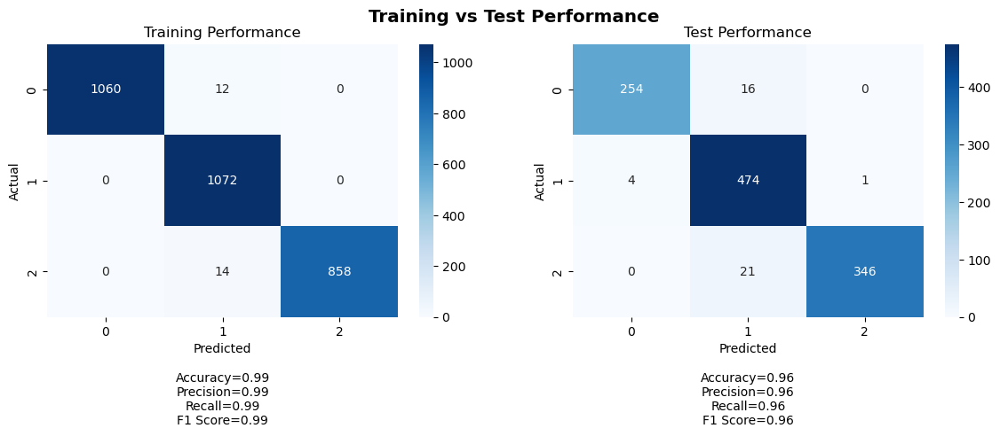

 74%|███████▍  | 74/100 [4:07:14<1:13:28, 169.55s/it]

Training Metrics:
Accuracy: 0.9913793103448276
Precision: 0.9915834432510522
Recall: 0.9913793103448276
F1 Score: 0.9914009754187262

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9642234247679902
Recall: 0.9623655913978495
F1 Score: 0.962494078765426

Training Confusion Matrix:
Class 0 - TP: 1060, FP: 0, TN: 1944, FN: 12
Class 1 - TP: 1072, FP: 26, TN: 1918, FN: 0
Class 2 - TP: 858, FP: 0, TN: 2144, FN: 14

Test Confusion Matrix:
Class 0 - TP: 254, FP: 4, TN: 842, FN: 16
Class 1 - TP: 474, FP: 37, TN: 600, FN: 5
Class 2 - TP: 346, FP: 1, TN: 748, FN: 21
35/35 [==============================] - 0s 2ms/step


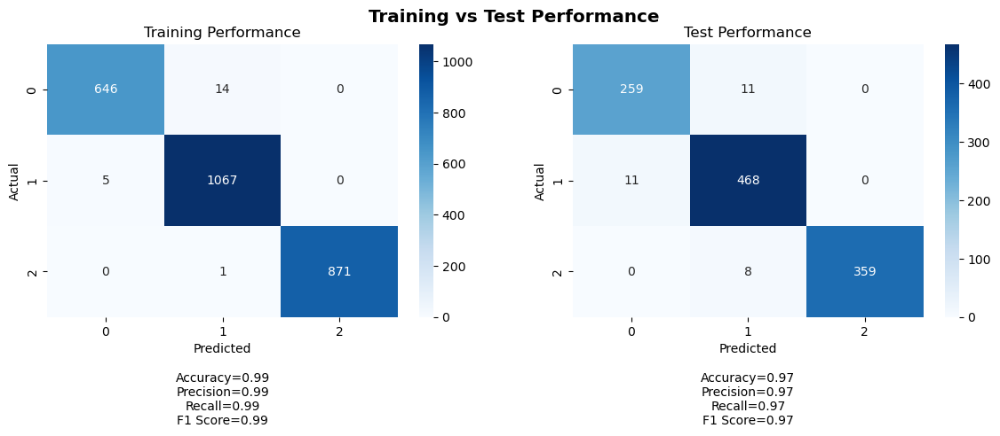

Training Metrics:
Accuracy: 0.9923195084485407
Precision: 0.9923462011285324
Recall: 0.9923195084485407
F1 Score: 0.9923121816445092

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9733979524997609
Recall: 0.9731182795698925
F1 Score: 0.9731900954009841

Training Confusion Matrix:
Class 0 - TP: 646, FP: 5, TN: 1939, FN: 14
Class 1 - TP: 1067, FP: 15, TN: 1517, FN: 5
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 259, FP: 11, TN: 835, FN: 11
Class 1 - TP: 468, FP: 19, TN: 618, FN: 11
Class 2 - TP: 359, FP: 0, TN: 749, FN: 8
35/35 [==============================] - 0s 2ms/step


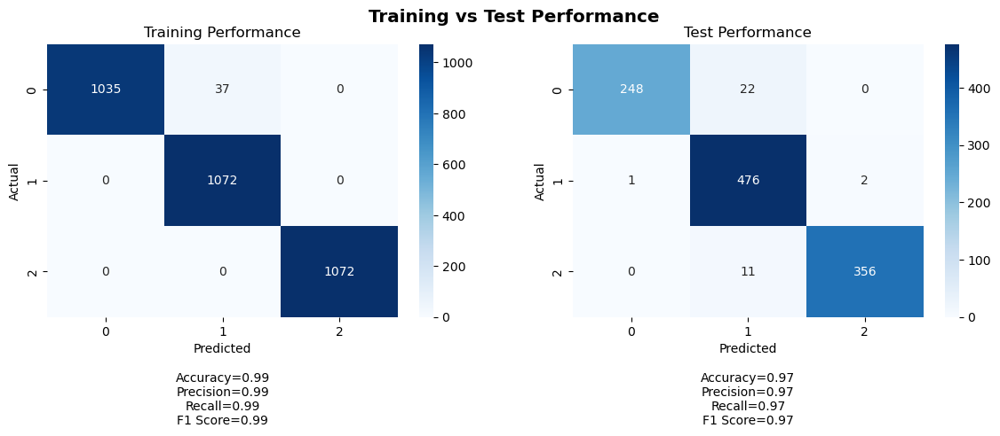

Training Metrics:
Accuracy: 0.9884950248756219
Precision: 0.9888788698527202
Recall: 0.9884950248756219
F1 Score: 0.9884915974429609

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9693641339586119
Recall: 0.967741935483871
F1 Score: 0.9677424293281415

Training Confusion Matrix:
Class 0 - TP: 1035, FP: 0, TN: 2144, FN: 37
Class 1 - TP: 1072, FP: 37, TN: 2107, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 248, FP: 1, TN: 845, FN: 22
Class 1 - TP: 476, FP: 33, TN: 604, FN: 3
Class 2 - TP: 356, FP: 2, TN: 747, FN: 11
35/35 [==============================] - 0s 2ms/step


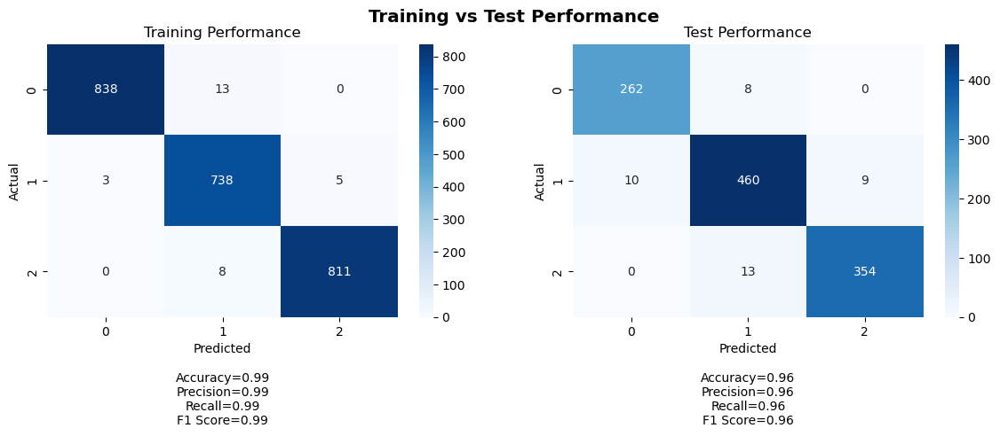

Training Metrics:
Accuracy: 0.9879966887417219
Precision: 0.9881231910688173
Recall: 0.9879966887417219
F1 Score: 0.9880240236920753

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9642129694850929
Recall: 0.96415770609319
F1 Score: 0.9641707912420853

Training Confusion Matrix:
Class 0 - TP: 838, FP: 3, TN: 1562, FN: 13
Class 1 - TP: 738, FP: 21, TN: 1649, FN: 8
Class 2 - TP: 811, FP: 5, TN: 1592, FN: 8

Test Confusion Matrix:
Class 0 - TP: 262, FP: 10, TN: 836, FN: 8
Class 1 - TP: 460, FP: 21, TN: 616, FN: 19
Class 2 - TP: 354, FP: 9, TN: 740, FN: 13
35/35 [==============================] - 0s 2ms/step


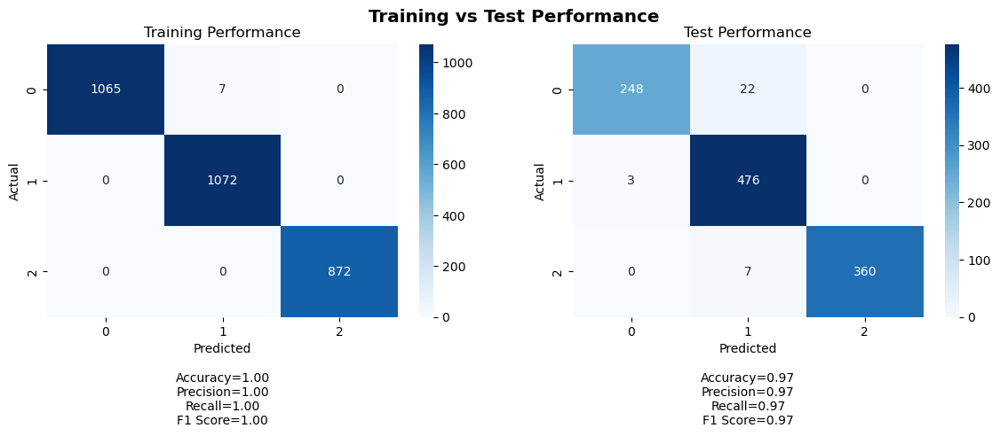

 75%|███████▌  | 75/100 [4:09:39<1:07:37, 162.28s/it]

Training Metrics:
Accuracy: 0.9976790450928382
Precision: 0.9976941022609106
Recall: 0.9976790450928382
F1 Score: 0.9976790203518039

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9724605534708463
Recall: 0.9713261648745519
F1 Score: 0.9712663171715153

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 0, TN: 1944, FN: 7
Class 1 - TP: 1072, FP: 7, TN: 1937, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 248, FP: 3, TN: 843, FN: 22
Class 1 - TP: 476, FP: 29, TN: 608, FN: 3
Class 2 - TP: 360, FP: 0, TN: 749, FN: 7
35/35 [==============================] - 0s 2ms/step


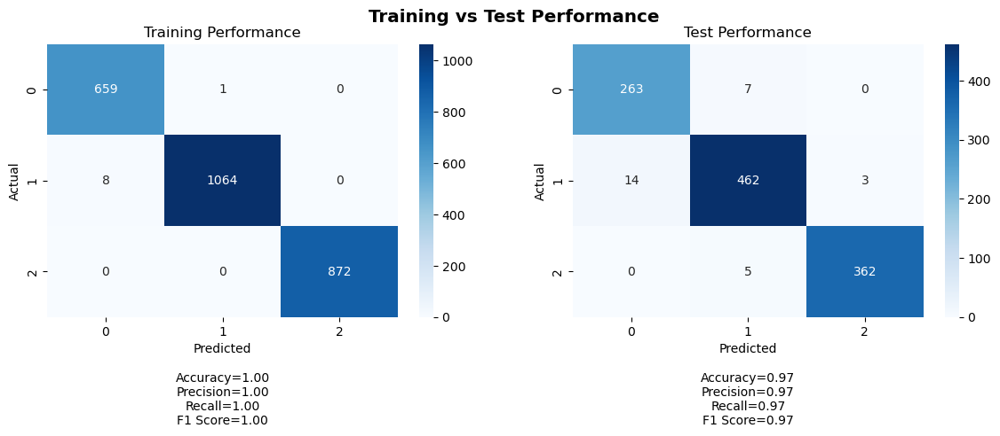

Training Metrics:
Accuracy: 0.9965437788018433
Precision: 0.996573496640183
Recall: 0.9965437788018433
F1 Score: 0.9965472340492346

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9742031989059795
Recall: 0.9740143369175627
F1 Score: 0.9740567784716664

Training Confusion Matrix:
Class 0 - TP: 659, FP: 8, TN: 1936, FN: 1
Class 1 - TP: 1064, FP: 1, TN: 1531, FN: 8
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 14, TN: 832, FN: 7
Class 1 - TP: 462, FP: 12, TN: 625, FN: 17
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 2ms/step


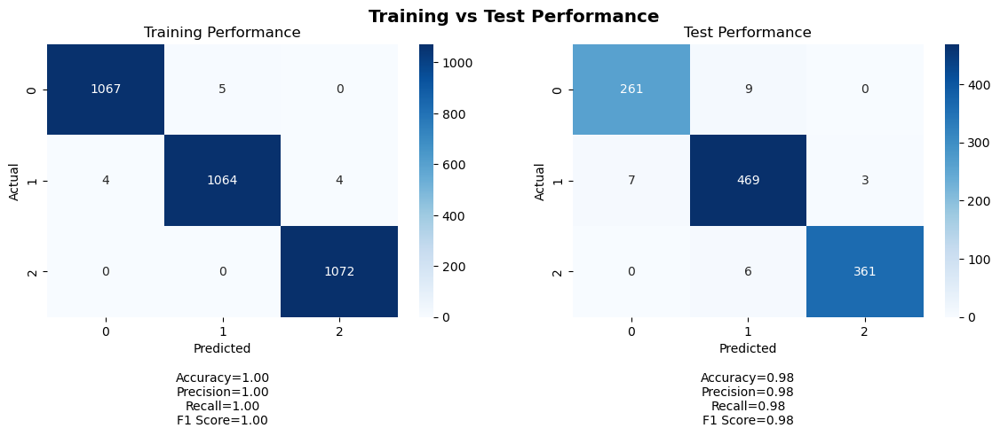

Training Metrics:
Accuracy: 0.9959577114427861
Precision: 0.9959568107138638
Recall: 0.9959577114427861
F1 Score: 0.9959553845277578

Test Metrics:
Accuracy: 0.9775985663082437
Precision: 0.9776684539399558
Recall: 0.9775985663082437
F1 Score: 0.9776135248393721

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 4, TN: 2140, FN: 5
Class 1 - TP: 1064, FP: 5, TN: 2139, FN: 8
Class 2 - TP: 1072, FP: 4, TN: 2140, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 7, TN: 839, FN: 9
Class 1 - TP: 469, FP: 15, TN: 622, FN: 10
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 2ms/step


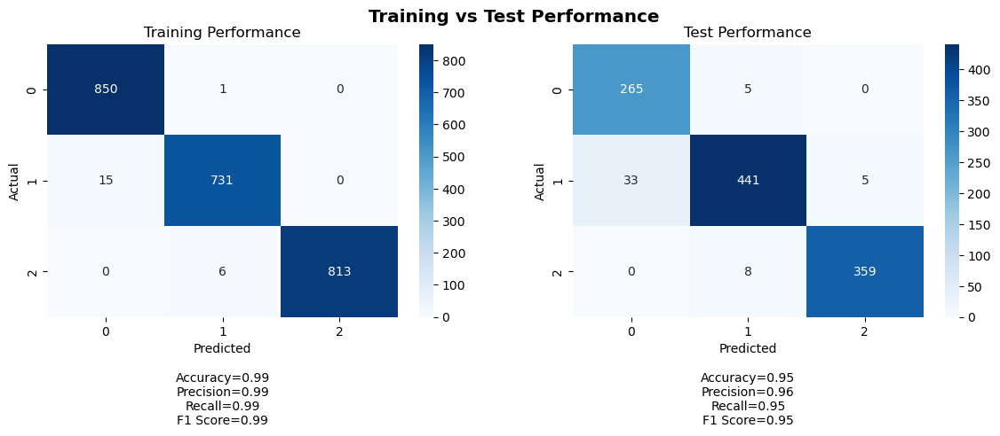

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9909631182978752
Recall: 0.9908940397350994
F1 Score: 0.9908919451416097

Test Metrics:
Accuracy: 0.9543010752688172
Precision: 0.9564010782427362
Recall: 0.9543010752688172
F1 Score: 0.9545041793807805

Training Confusion Matrix:
Class 0 - TP: 850, FP: 15, TN: 1550, FN: 1
Class 1 - TP: 731, FP: 7, TN: 1663, FN: 15
Class 2 - TP: 813, FP: 0, TN: 1597, FN: 6

Test Confusion Matrix:
Class 0 - TP: 265, FP: 33, TN: 813, FN: 5
Class 1 - TP: 441, FP: 13, TN: 624, FN: 38
Class 2 - TP: 359, FP: 5, TN: 744, FN: 8
35/35 [==============================] - 0s 2ms/step


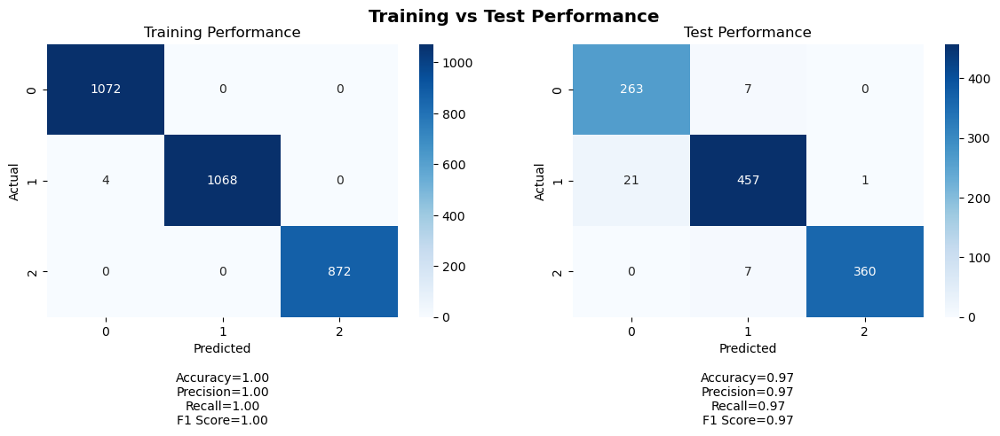

 76%|███████▌  | 76/100 [4:12:04<1:02:47, 157.00s/it]

Training Metrics:
Accuracy: 0.9986737400530504
Precision: 0.9986786703874257
Recall: 0.9986737400530504
F1 Score: 0.9986737354366807

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9684415760187557
Recall: 0.967741935483871
F1 Score: 0.9678935883811676

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1068, FP: 0, TN: 1944, FN: 4
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 21, TN: 825, FN: 7
Class 1 - TP: 457, FP: 14, TN: 623, FN: 22
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 2ms/step


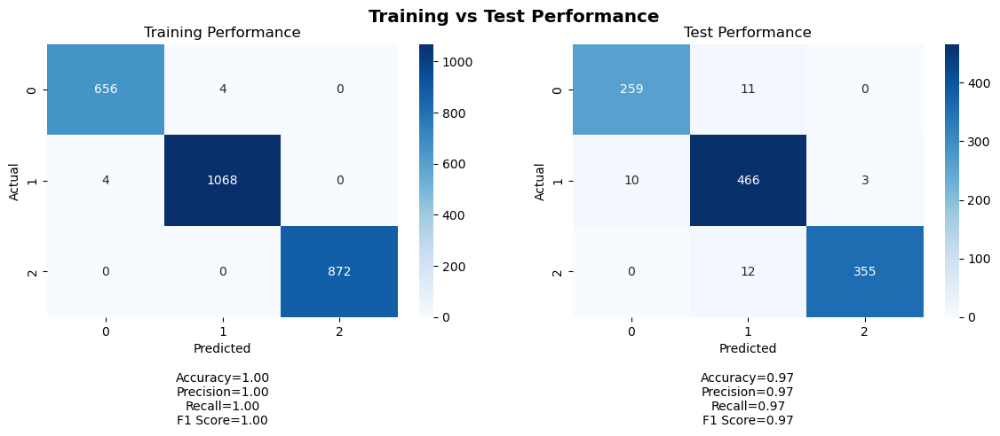

Training Metrics:
Accuracy: 0.9969278033794163
Precision: 0.9969278033794163
Recall: 0.9969278033794163
F1 Score: 0.9969278033794163

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9680625035238879
Recall: 0.967741935483871
F1 Score: 0.967807676026404

Training Confusion Matrix:
Class 0 - TP: 656, FP: 4, TN: 1940, FN: 4
Class 1 - TP: 1068, FP: 4, TN: 1528, FN: 4
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 10, TN: 836, FN: 11
Class 1 - TP: 466, FP: 23, TN: 614, FN: 13
Class 2 - TP: 355, FP: 3, TN: 746, FN: 12
35/35 [==============================] - 0s 2ms/step


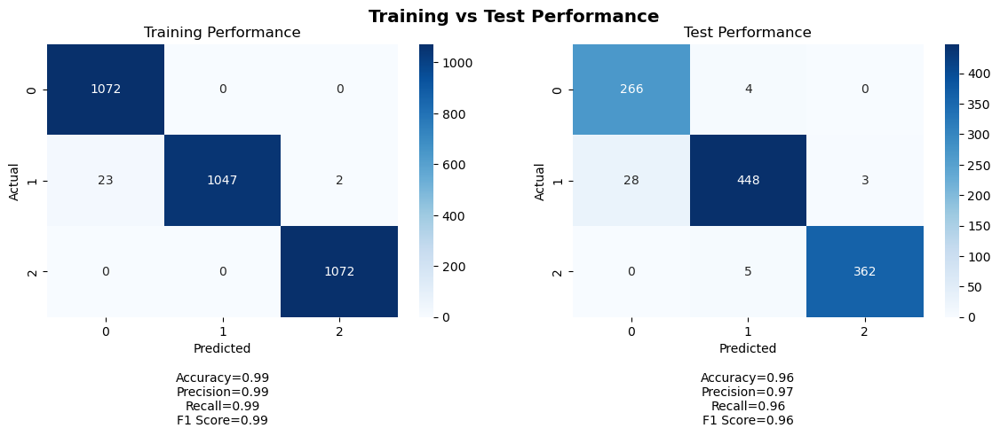

Training Metrics:
Accuracy: 0.992226368159204
Precision: 0.992377745465677
Recall: 0.992226368159204
F1 Score: 0.9922187546291005

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9658028813043699
Recall: 0.96415770609319
F1 Score: 0.9643367711756234

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 23, TN: 2121, FN: 0
Class 1 - TP: 1047, FP: 0, TN: 2144, FN: 25
Class 2 - TP: 1072, FP: 2, TN: 2142, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 28, TN: 818, FN: 4
Class 1 - TP: 448, FP: 9, TN: 628, FN: 31
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 2ms/step


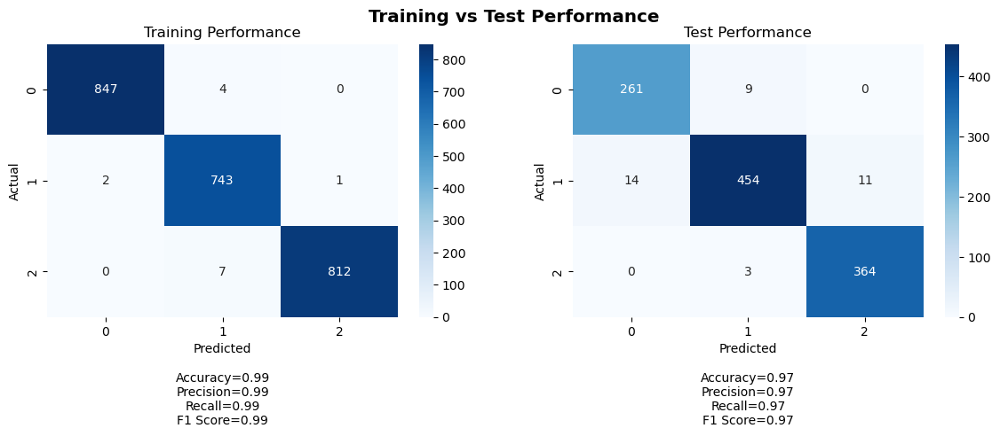

Training Metrics:
Accuracy: 0.9942052980132451
Precision: 0.9942486007352338
Recall: 0.9942052980132451
F1 Score: 0.9942132028308011

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9669842725561957
Recall: 0.9668458781362007
F1 Score: 0.9667799990419104

Training Confusion Matrix:
Class 0 - TP: 847, FP: 2, TN: 1563, FN: 4
Class 1 - TP: 743, FP: 11, TN: 1659, FN: 3
Class 2 - TP: 812, FP: 1, TN: 1596, FN: 7

Test Confusion Matrix:
Class 0 - TP: 261, FP: 14, TN: 832, FN: 9
Class 1 - TP: 454, FP: 12, TN: 625, FN: 25
Class 2 - TP: 364, FP: 11, TN: 738, FN: 3
35/35 [==============================] - 0s 2ms/step


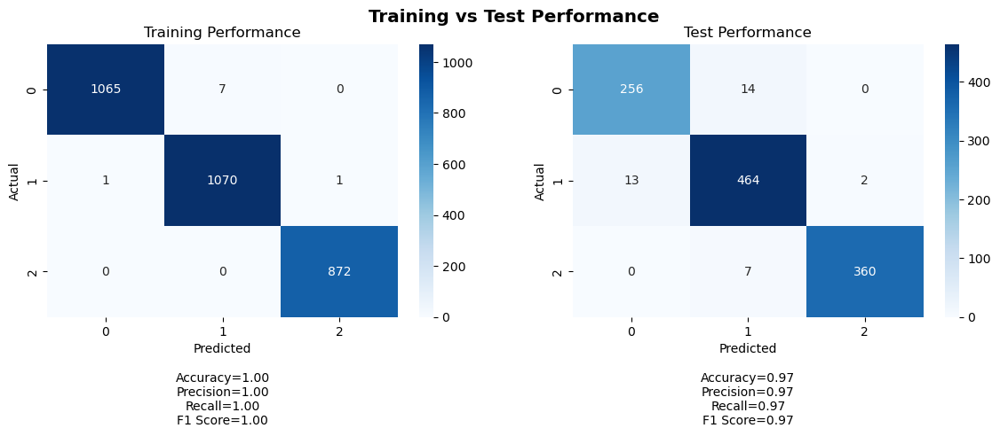

 77%|███████▋  | 77/100 [4:14:26<58:31, 152.68s/it]  

Training Metrics:
Accuracy: 0.9970159151193634
Precision: 0.9970252037918719
Recall: 0.9970159151193634
F1 Score: 0.9970157596401362

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9679066687880773
Recall: 0.967741935483871
F1 Score: 0.9677922245656818

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 1, TN: 1943, FN: 7
Class 1 - TP: 1070, FP: 7, TN: 1937, FN: 2
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 13, TN: 833, FN: 14
Class 1 - TP: 464, FP: 21, TN: 616, FN: 15
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


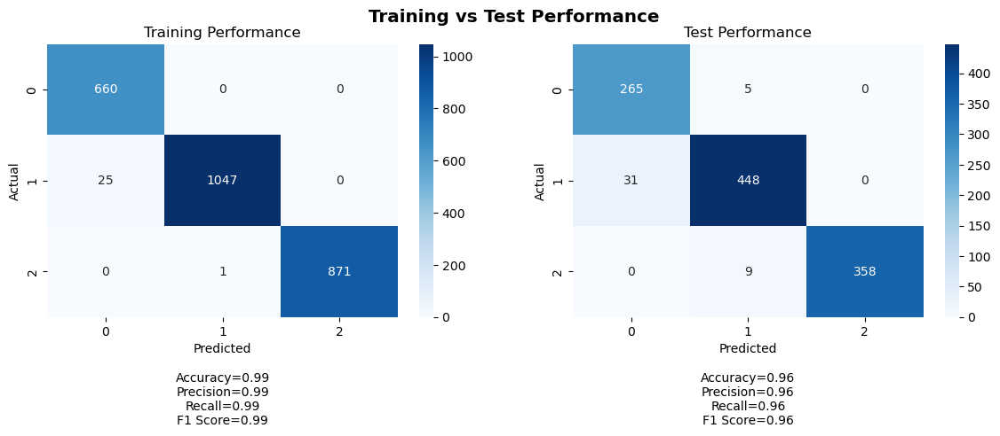

Training Metrics:
Accuracy: 0.9900153609831029
Precision: 0.9903569539154244
Recall: 0.9900153609831029
F1 Score: 0.9900479590377809

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9616557539944637
Recall: 0.9596774193548387
F1 Score: 0.9600040417466372

Training Confusion Matrix:
Class 0 - TP: 660, FP: 25, TN: 1919, FN: 0
Class 1 - TP: 1047, FP: 1, TN: 1531, FN: 25
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 265, FP: 31, TN: 815, FN: 5
Class 1 - TP: 448, FP: 14, TN: 623, FN: 31
Class 2 - TP: 358, FP: 0, TN: 749, FN: 9
35/35 [==============================] - 0s 2ms/step


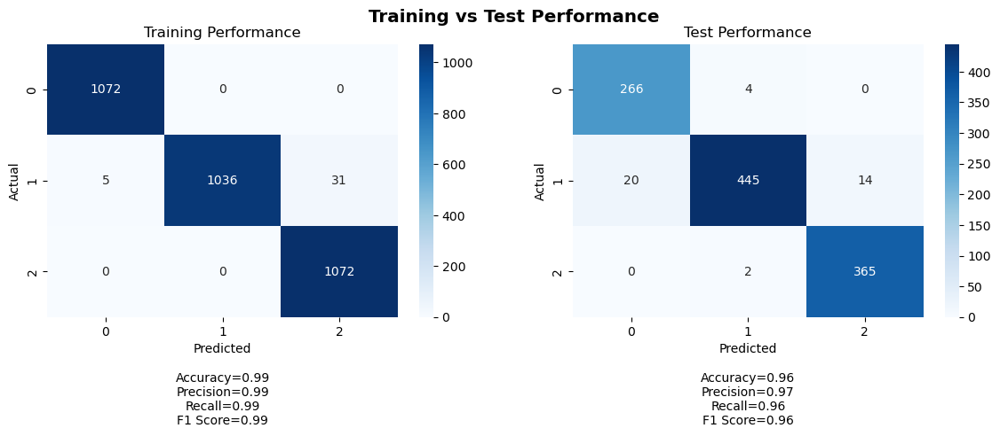

Training Metrics:
Accuracy: 0.9888059701492538
Precision: 0.9890841022472406
Recall: 0.9888059701492538
F1 Score: 0.9887808880036176

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9652236983364283
Recall: 0.96415770609319
F1 Score: 0.9640428848839161

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 5, TN: 2139, FN: 0
Class 1 - TP: 1036, FP: 0, TN: 2144, FN: 36
Class 2 - TP: 1072, FP: 31, TN: 2113, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 20, TN: 826, FN: 4
Class 1 - TP: 445, FP: 6, TN: 631, FN: 34
Class 2 - TP: 365, FP: 14, TN: 735, FN: 2
35/35 [==============================] - 0s 2ms/step


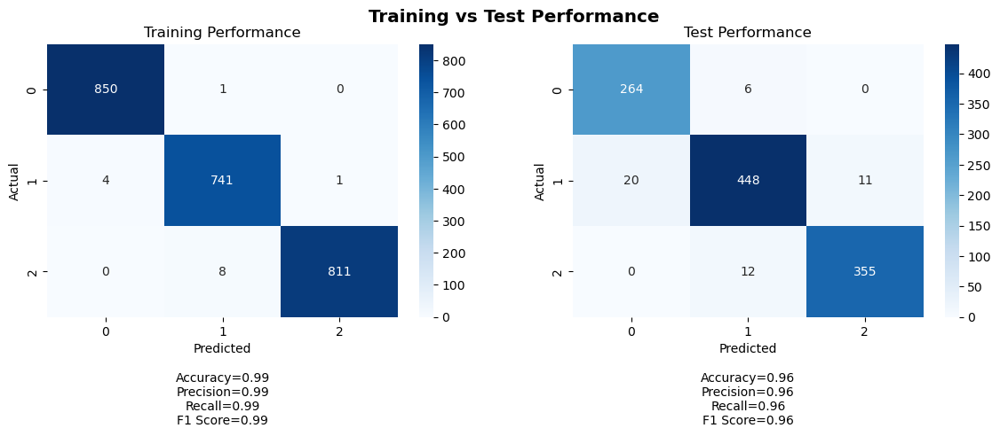

Training Metrics:
Accuracy: 0.9942052980132451
Precision: 0.9942274134240864
Recall: 0.9942052980132451
F1 Score: 0.9942068717300493

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.956499744556812
Recall: 0.9560931899641577
F1 Score: 0.9560714998826488

Training Confusion Matrix:
Class 0 - TP: 850, FP: 4, TN: 1561, FN: 1
Class 1 - TP: 741, FP: 9, TN: 1661, FN: 5
Class 2 - TP: 811, FP: 1, TN: 1596, FN: 8

Test Confusion Matrix:
Class 0 - TP: 264, FP: 20, TN: 826, FN: 6
Class 1 - TP: 448, FP: 18, TN: 619, FN: 31
Class 2 - TP: 355, FP: 11, TN: 738, FN: 12
35/35 [==============================] - 0s 2ms/step


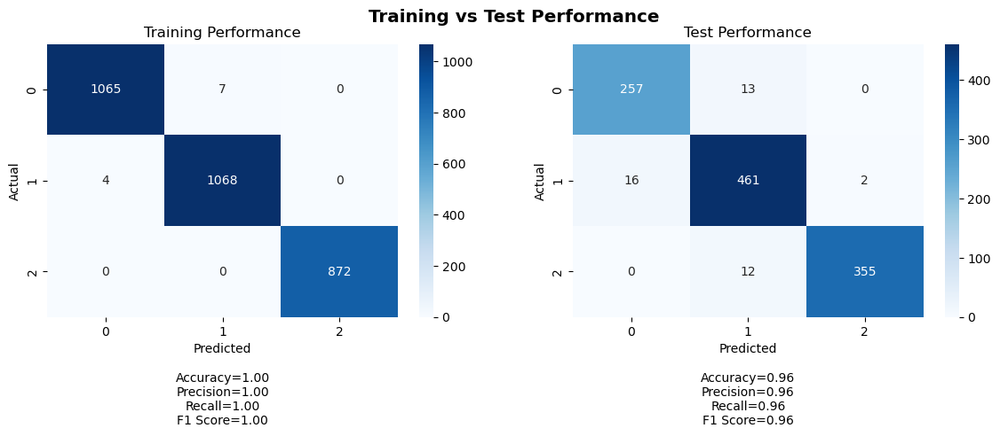

 78%|███████▊  | 78/100 [4:16:55<55:30, 151.37s/it]

Training Metrics:
Accuracy: 0.9963527851458885
Precision: 0.9963555402650466
Recall: 0.9963527851458885
F1 Score: 0.9963527780049527

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9618995376983757
Recall: 0.9614695340501792
F1 Score: 0.9615944300748992

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 4, TN: 1940, FN: 7
Class 1 - TP: 1068, FP: 7, TN: 1937, FN: 4
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 16, TN: 830, FN: 13
Class 1 - TP: 461, FP: 25, TN: 612, FN: 18
Class 2 - TP: 355, FP: 2, TN: 747, FN: 12
35/35 [==============================] - 0s 2ms/step


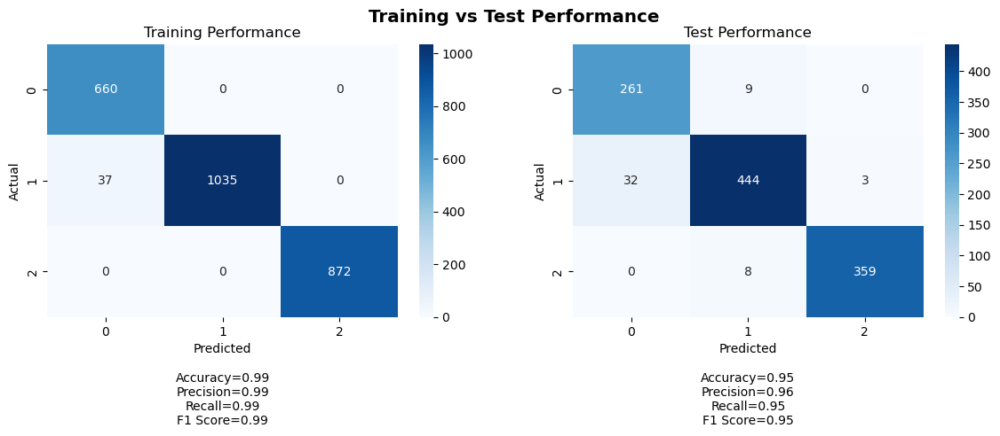

Training Metrics:
Accuracy: 0.9857910906298003
Precision: 0.986545365589194
Recall: 0.9857910906298003
F1 Score: 0.9858600430243385

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9550239556675021
Recall: 0.953405017921147
F1 Score: 0.9536755219973068

Training Confusion Matrix:
Class 0 - TP: 660, FP: 37, TN: 1907, FN: 0
Class 1 - TP: 1035, FP: 0, TN: 1532, FN: 37
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 32, TN: 814, FN: 9
Class 1 - TP: 444, FP: 17, TN: 620, FN: 35
Class 2 - TP: 359, FP: 3, TN: 746, FN: 8
35/35 [==============================] - 0s 1ms/step


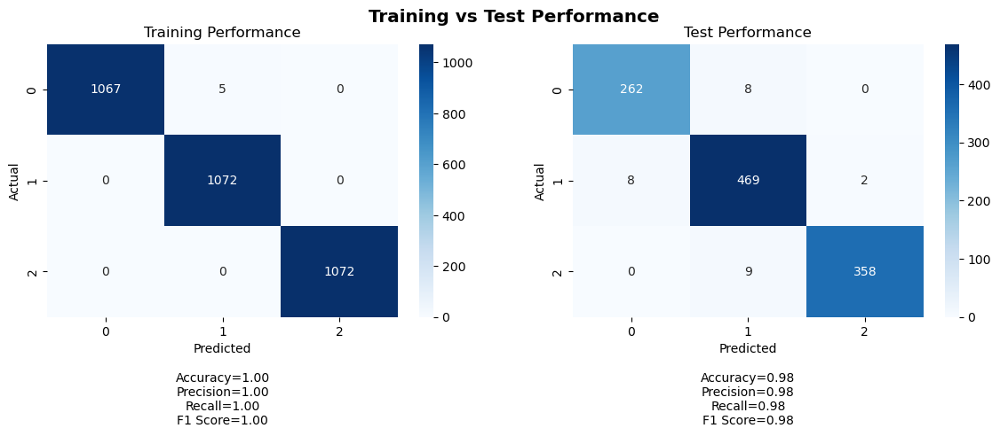

Training Metrics:
Accuracy: 0.9984452736318408
Precision: 0.9984524914887033
Recall: 0.9984452736318408
F1 Score: 0.9984452651761951

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9759910099266927
Recall: 0.9758064516129032
F1 Score: 0.9758467474033425

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 0, TN: 2144, FN: 5
Class 1 - TP: 1072, FP: 5, TN: 2139, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 8, TN: 838, FN: 8
Class 1 - TP: 469, FP: 17, TN: 620, FN: 10
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 2ms/step


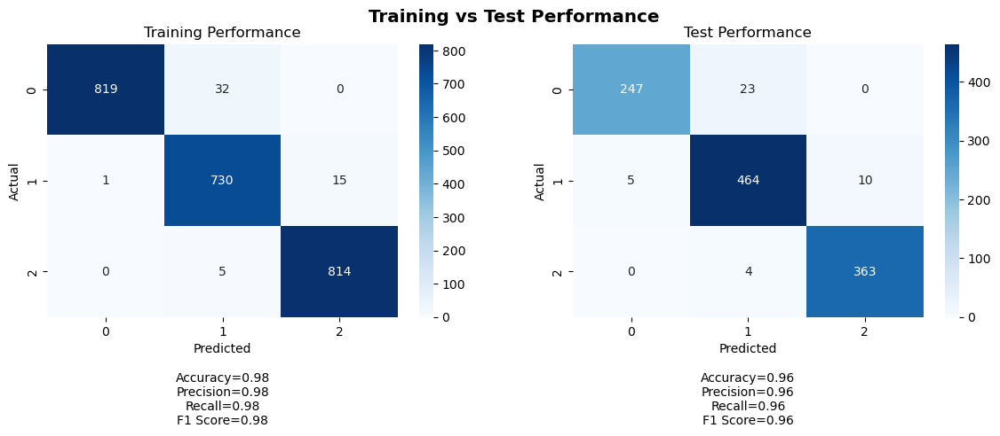

Training Metrics:
Accuracy: 0.9780629139072847
Precision: 0.9785414626755964
Recall: 0.9780629139072847
F1 Score: 0.978113571099273

Test Metrics:
Accuracy: 0.9623655913978495
Precision: 0.9627809971793114
Recall: 0.9623655913978495
F1 Score: 0.9622166594538533

Training Confusion Matrix:
Class 0 - TP: 819, FP: 1, TN: 1564, FN: 32
Class 1 - TP: 730, FP: 37, TN: 1633, FN: 16
Class 2 - TP: 814, FP: 15, TN: 1582, FN: 5

Test Confusion Matrix:
Class 0 - TP: 247, FP: 5, TN: 841, FN: 23
Class 1 - TP: 464, FP: 27, TN: 610, FN: 15
Class 2 - TP: 363, FP: 10, TN: 739, FN: 4
35/35 [==============================] - 0s 2ms/step


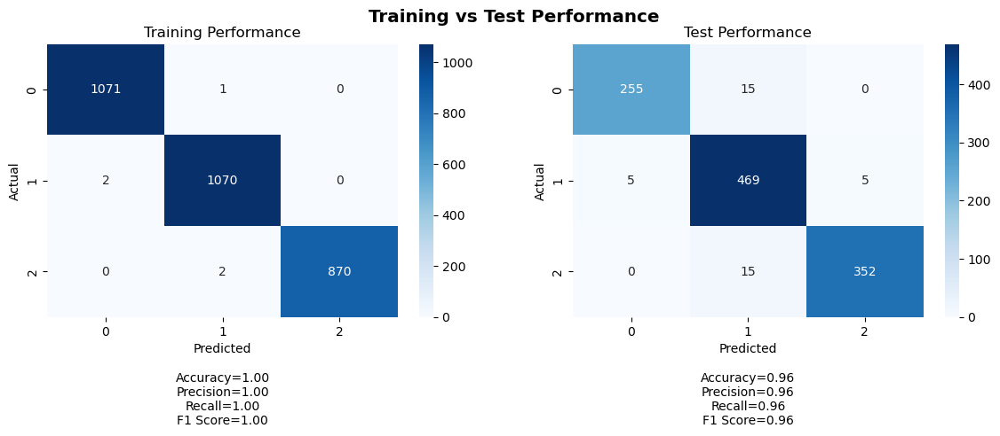

 79%|███████▉  | 79/100 [4:19:24<52:47, 150.85s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983437201035299
Recall: 0.998342175066313
F1 Score: 0.998342412697692

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9649373128090526
Recall: 0.96415770609319
F1 Score: 0.9642313594648442

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 2, TN: 1942, FN: 1
Class 1 - TP: 1070, FP: 3, TN: 1941, FN: 2
Class 2 - TP: 870, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 255, FP: 5, TN: 841, FN: 15
Class 1 - TP: 469, FP: 30, TN: 607, FN: 10
Class 2 - TP: 352, FP: 5, TN: 744, FN: 15
35/35 [==============================] - 0s 2ms/step


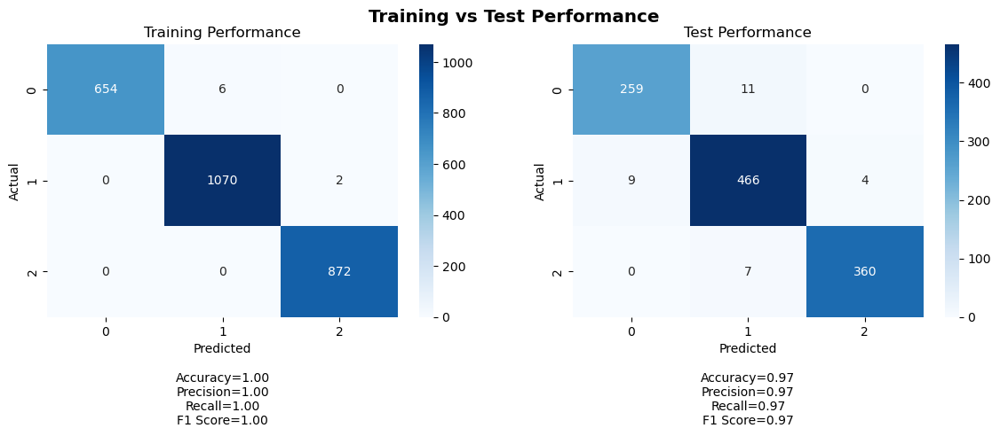

Training Metrics:
Accuracy: 0.9969278033794163
Precision: 0.9969381265329311
Recall: 0.9969278033794163
F1 Score: 0.9969258431777293

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9722991211479854
Recall: 0.9722222222222222
F1 Score: 0.9722407985065596

Training Confusion Matrix:
Class 0 - TP: 654, FP: 0, TN: 1944, FN: 6
Class 1 - TP: 1070, FP: 6, TN: 1526, FN: 2
Class 2 - TP: 872, FP: 2, TN: 1730, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 9, TN: 837, FN: 11
Class 1 - TP: 466, FP: 18, TN: 619, FN: 13
Class 2 - TP: 360, FP: 4, TN: 745, FN: 7
35/35 [==============================] - 0s 2ms/step


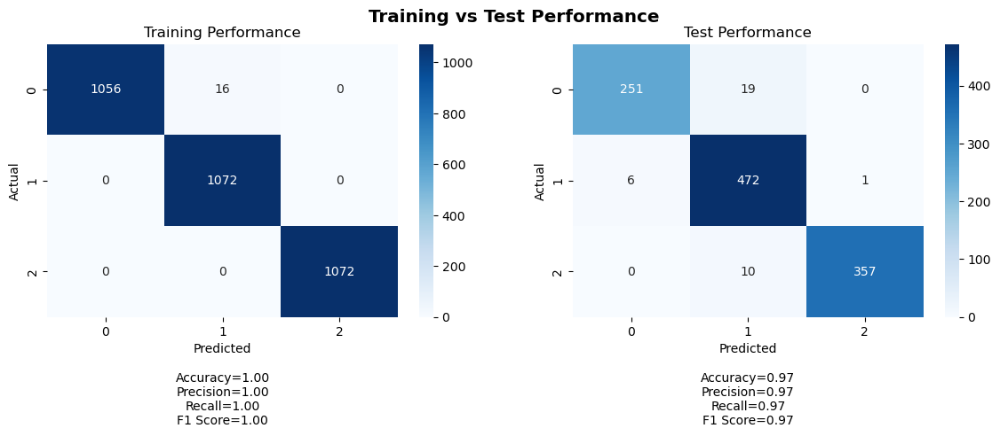

Training Metrics:
Accuracy: 0.9950248756218906
Precision: 0.9950980392156862
Recall: 0.9950248756218906
F1 Score: 0.9950245985333704

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9685885407558088
Recall: 0.967741935483871
F1 Score: 0.967766538193973

Training Confusion Matrix:
Class 0 - TP: 1056, FP: 0, TN: 2144, FN: 16
Class 1 - TP: 1072, FP: 16, TN: 2128, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 251, FP: 6, TN: 840, FN: 19
Class 1 - TP: 472, FP: 29, TN: 608, FN: 7
Class 2 - TP: 357, FP: 1, TN: 748, FN: 10
35/35 [==============================] - 0s 2ms/step


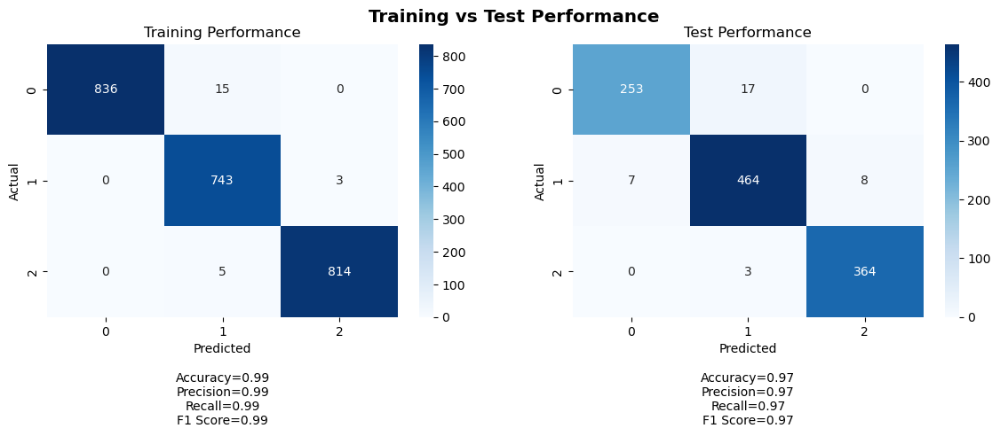

Training Metrics:
Accuracy: 0.9904801324503312
Precision: 0.9906615337314514
Recall: 0.9904801324503312
F1 Score: 0.9905041306275628

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9686782326906251
Recall: 0.9686379928315412
F1 Score: 0.9685498738753077

Training Confusion Matrix:
Class 0 - TP: 836, FP: 0, TN: 1565, FN: 15
Class 1 - TP: 743, FP: 20, TN: 1650, FN: 3
Class 2 - TP: 814, FP: 3, TN: 1594, FN: 5

Test Confusion Matrix:
Class 0 - TP: 253, FP: 7, TN: 839, FN: 17
Class 1 - TP: 464, FP: 20, TN: 617, FN: 15
Class 2 - TP: 364, FP: 8, TN: 741, FN: 3
35/35 [==============================] - 0s 1ms/step


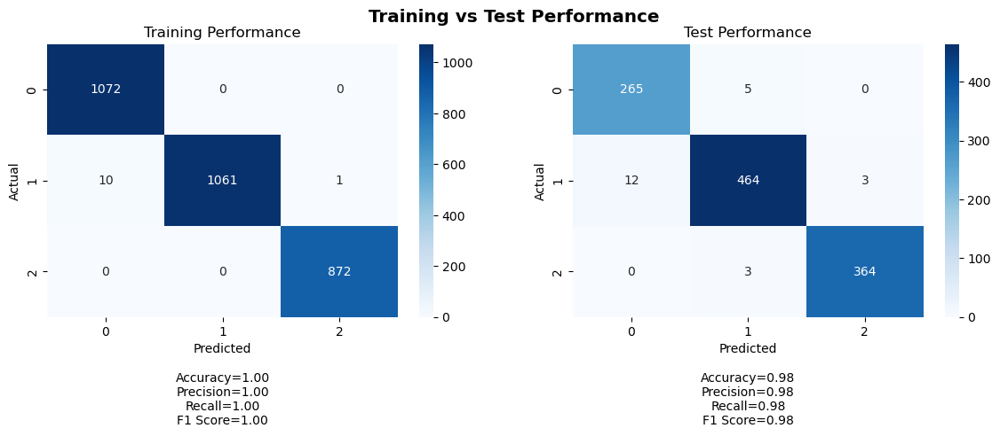

 80%|████████  | 80/100 [4:21:54<50:09, 150.47s/it]

Training Metrics:
Accuracy: 0.9963527851458885
Precision: 0.9963838086595315
Recall: 0.9963527851458885
F1 Score: 0.996351172199528

Test Metrics:
Accuracy: 0.9793906810035843
Precision: 0.9795560976968425
Recall: 0.9793906810035843
F1 Score: 0.9794123005357432

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 10, TN: 1934, FN: 0
Class 1 - TP: 1061, FP: 0, TN: 1944, FN: 11
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 12, TN: 834, FN: 5
Class 1 - TP: 464, FP: 8, TN: 629, FN: 15
Class 2 - TP: 364, FP: 3, TN: 746, FN: 3
35/35 [==============================] - 0s 2ms/step


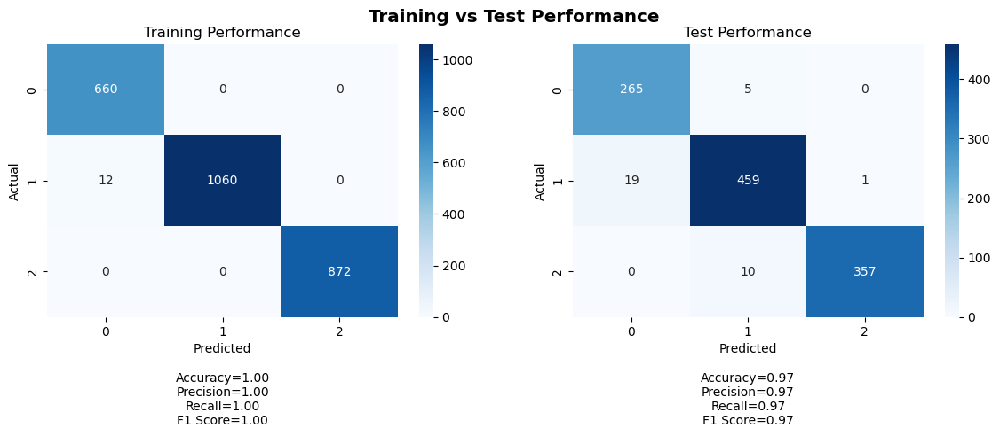

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.995473996050033
Recall: 0.9953917050691244
F1 Score: 0.9953994942193212

Test Metrics:
Accuracy: 0.9686379928315412
Precision: 0.9693129500048424
Recall: 0.9686379928315412
F1 Score: 0.9687662705334785

Training Confusion Matrix:
Class 0 - TP: 660, FP: 12, TN: 1932, FN: 0
Class 1 - TP: 1060, FP: 0, TN: 1532, FN: 12
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 19, TN: 827, FN: 5
Class 1 - TP: 459, FP: 15, TN: 622, FN: 20
Class 2 - TP: 357, FP: 1, TN: 748, FN: 10
35/35 [==============================] - 0s 2ms/step


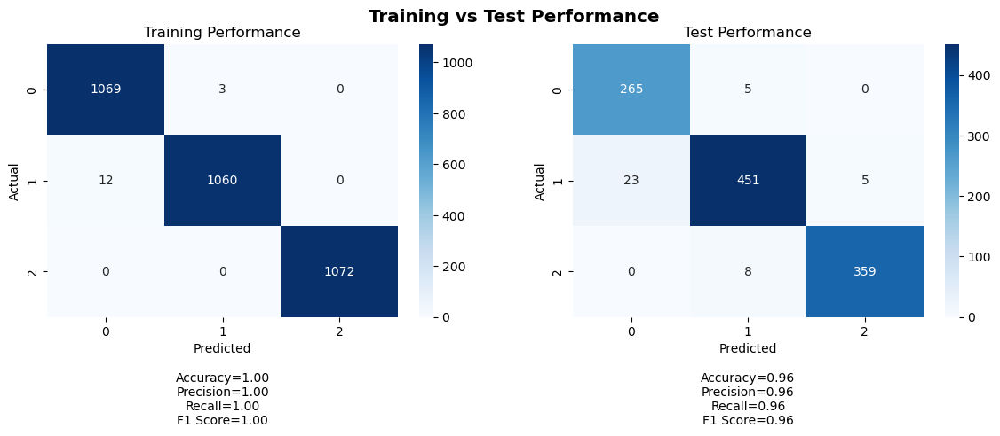

Training Metrics:
Accuracy: 0.9953358208955224
Precision: 0.9953589887068435
Recall: 0.9953358208955224
F1 Score: 0.9953357387056457

Test Metrics:
Accuracy: 0.9632616487455197
Precision: 0.9641362299176538
Recall: 0.9632616487455197
F1 Score: 0.9633502241578051

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 12, TN: 2132, FN: 3
Class 1 - TP: 1060, FP: 3, TN: 2141, FN: 12
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 23, TN: 823, FN: 5
Class 1 - TP: 451, FP: 13, TN: 624, FN: 28
Class 2 - TP: 359, FP: 5, TN: 744, FN: 8
35/35 [==============================] - 0s 2ms/step


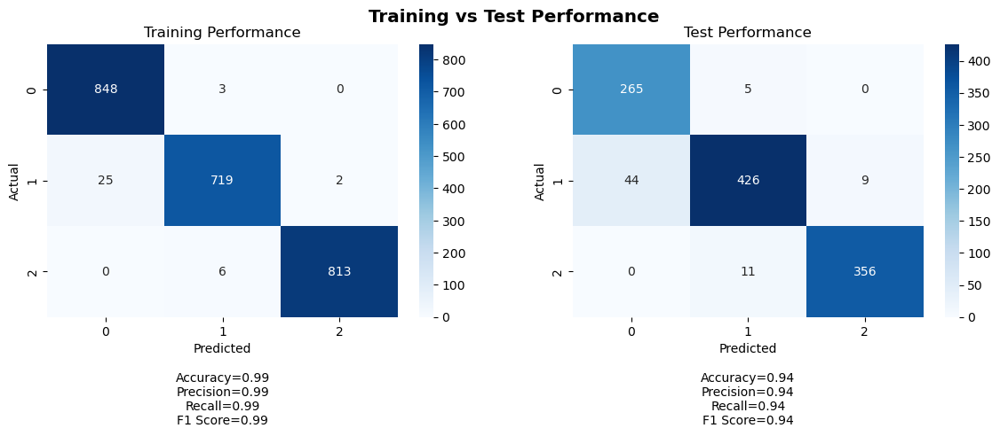

Training Metrics:
Accuracy: 0.9850993377483444
Precision: 0.9852639354434215
Recall: 0.9850993377483444
F1 Score: 0.9850782501365783

Test Metrics:
Accuracy: 0.9381720430107527
Precision: 0.941903867808174
Recall: 0.9381720430107527
F1 Score: 0.9383843576860607

Training Confusion Matrix:
Class 0 - TP: 848, FP: 25, TN: 1540, FN: 3
Class 1 - TP: 719, FP: 9, TN: 1661, FN: 27
Class 2 - TP: 813, FP: 2, TN: 1595, FN: 6

Test Confusion Matrix:
Class 0 - TP: 265, FP: 44, TN: 802, FN: 5
Class 1 - TP: 426, FP: 16, TN: 621, FN: 53
Class 2 - TP: 356, FP: 9, TN: 740, FN: 11
35/35 [==============================] - 0s 2ms/step


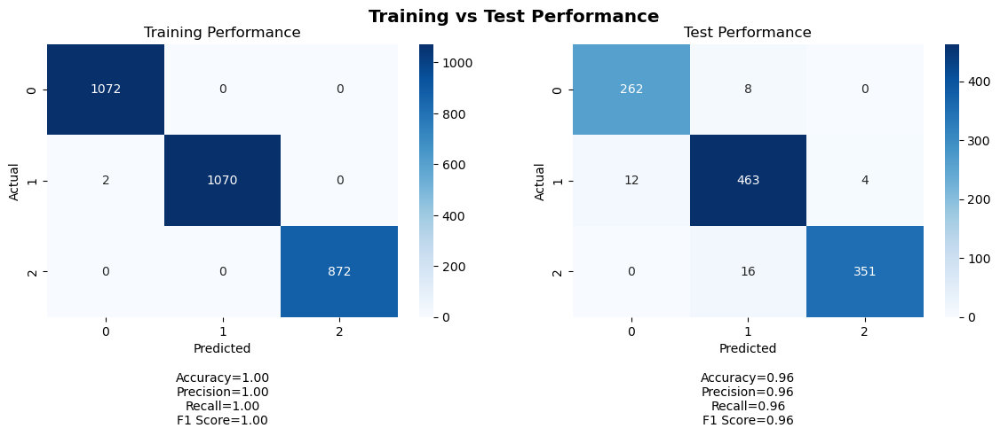

 81%|████████  | 81/100 [4:24:23<47:32, 150.11s/it]

Training Metrics:
Accuracy: 0.9993368700265252
Precision: 0.999338104905433
Recall: 0.9993368700265252
F1 Score: 0.9993368694494805

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9645467936626283
Recall: 0.96415770609319
F1 Score: 0.9642230787594933

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1070, FP: 0, TN: 1944, FN: 2
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 12, TN: 834, FN: 8
Class 1 - TP: 463, FP: 24, TN: 613, FN: 16
Class 2 - TP: 351, FP: 4, TN: 745, FN: 16
35/35 [==============================] - 0s 1ms/step


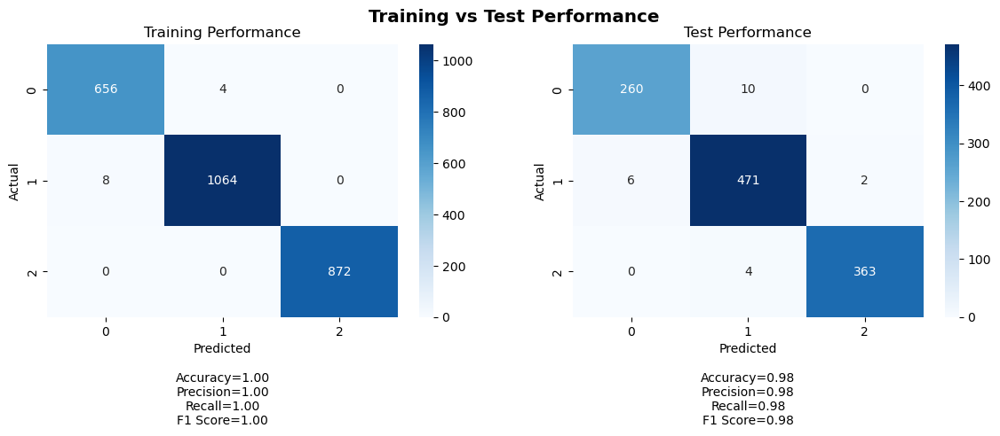

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.9954044591004901
Recall: 0.9953917050691244
F1 Score: 0.9953943594220225

Test Metrics:
Accuracy: 0.9802867383512545
Precision: 0.9803512647027501
Recall: 0.9802867383512545
F1 Score: 0.9802872459824746

Training Confusion Matrix:
Class 0 - TP: 656, FP: 8, TN: 1936, FN: 4
Class 1 - TP: 1064, FP: 4, TN: 1528, FN: 8
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 6, TN: 840, FN: 10
Class 1 - TP: 471, FP: 14, TN: 623, FN: 8
Class 2 - TP: 363, FP: 2, TN: 747, FN: 4
35/35 [==============================] - 0s 2ms/step


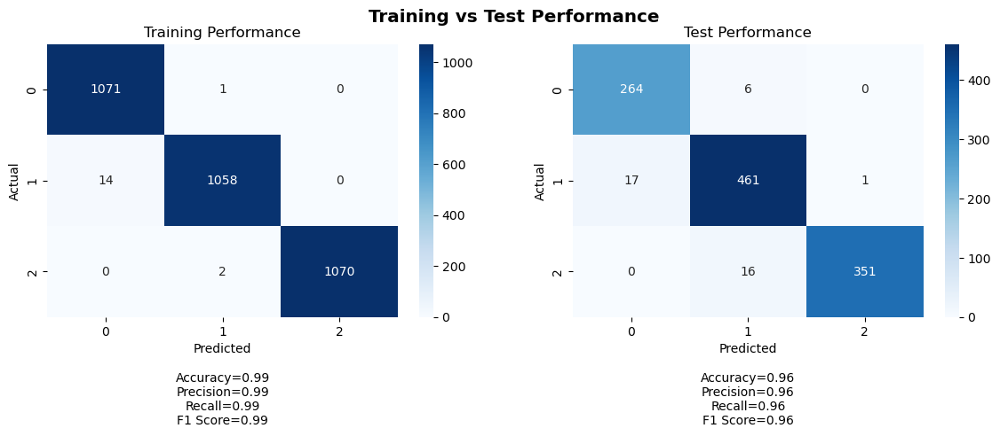

Training Metrics:
Accuracy: 0.9947139303482587
Precision: 0.9947564176623799
Recall: 0.9947139303482587
F1 Score: 0.9947140649838165

Test Metrics:
Accuracy: 0.96415770609319
Precision: 0.9648790872828491
Recall: 0.96415770609319
F1 Score: 0.9642790439389015

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 14, TN: 2130, FN: 1
Class 1 - TP: 1058, FP: 3, TN: 2141, FN: 14
Class 2 - TP: 1070, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 264, FP: 17, TN: 829, FN: 6
Class 1 - TP: 461, FP: 22, TN: 615, FN: 18
Class 2 - TP: 351, FP: 1, TN: 748, FN: 16
35/35 [==============================] - 0s 2ms/step


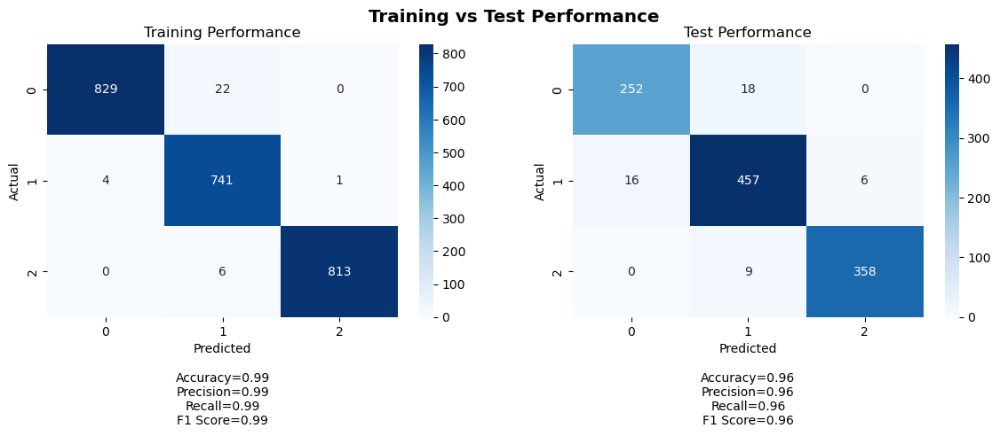

Training Metrics:
Accuracy: 0.9863410596026491
Precision: 0.9866493684418041
Recall: 0.9863410596026491
F1 Score: 0.9863827912696178

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.9561918208649728
Recall: 0.9560931899641577
F1 Score: 0.9561229658298512

Training Confusion Matrix:
Class 0 - TP: 829, FP: 4, TN: 1561, FN: 22
Class 1 - TP: 741, FP: 28, TN: 1642, FN: 5
Class 2 - TP: 813, FP: 1, TN: 1596, FN: 6

Test Confusion Matrix:
Class 0 - TP: 252, FP: 16, TN: 830, FN: 18
Class 1 - TP: 457, FP: 27, TN: 610, FN: 22
Class 2 - TP: 358, FP: 6, TN: 743, FN: 9
35/35 [==============================] - 0s 2ms/step


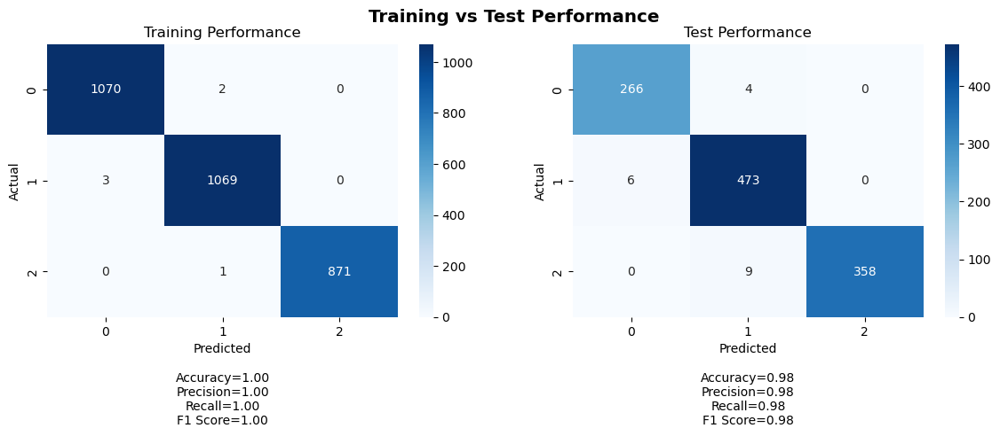

 82%|████████▏ | 82/100 [4:26:55<45:13, 150.73s/it]

Training Metrics:
Accuracy: 0.9980106100795756
Precision: 0.9980115371019058
Recall: 0.9980106100795756
F1 Score: 0.9980109014056475

Test Metrics:
Accuracy: 0.9829749103942652
Precision: 0.9831822226213376
Recall: 0.9829749103942652
F1 Score: 0.9830031362299595

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 3, TN: 1941, FN: 2
Class 1 - TP: 1069, FP: 3, TN: 1941, FN: 3
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 266, FP: 6, TN: 840, FN: 4
Class 1 - TP: 473, FP: 13, TN: 624, FN: 6
Class 2 - TP: 358, FP: 0, TN: 749, FN: 9
35/35 [==============================] - 0s 2ms/step


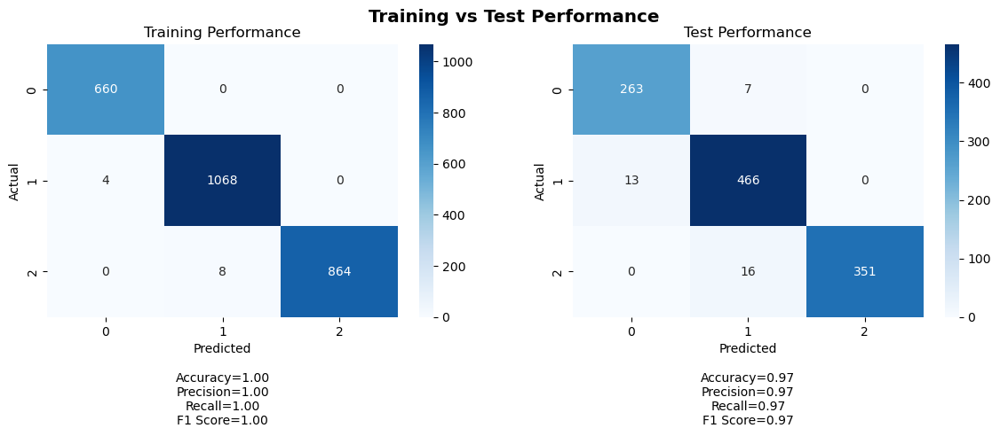

Training Metrics:
Accuracy: 0.9953917050691244
Precision: 0.9954123794786843
Recall: 0.9953917050691244
F1 Score: 0.9953912374426676

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9684166275483099
Recall: 0.967741935483871
F1 Score: 0.967847282744276

Training Confusion Matrix:
Class 0 - TP: 660, FP: 4, TN: 1940, FN: 0
Class 1 - TP: 1068, FP: 8, TN: 1524, FN: 4
Class 2 - TP: 864, FP: 0, TN: 1732, FN: 8

Test Confusion Matrix:
Class 0 - TP: 263, FP: 13, TN: 833, FN: 7
Class 1 - TP: 466, FP: 23, TN: 614, FN: 13
Class 2 - TP: 351, FP: 0, TN: 749, FN: 16
35/35 [==============================] - 0s 2ms/step


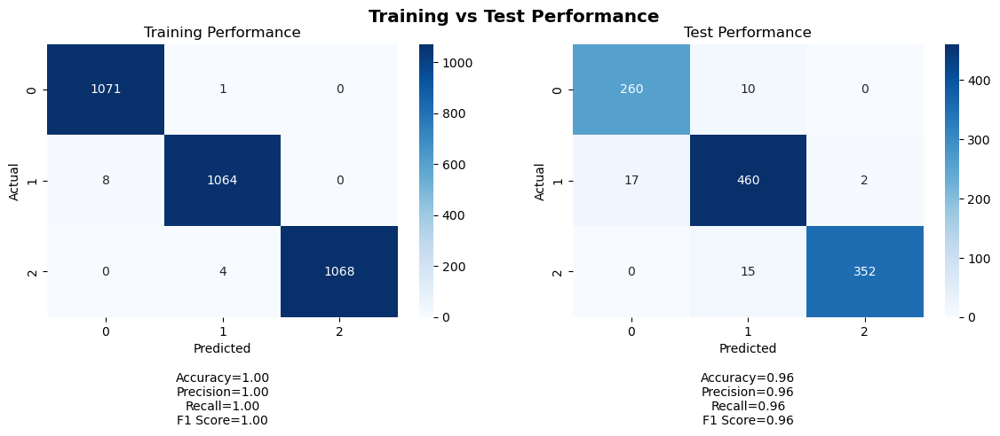

Training Metrics:
Accuracy: 0.9959577114427861
Precision: 0.9959694863500919
Recall: 0.9959577114427861
F1 Score: 0.9959582705659825

Test Metrics:
Accuracy: 0.9605734767025089
Precision: 0.9611697445438337
Recall: 0.9605734767025089
F1 Score: 0.960713647500418

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 8, TN: 2136, FN: 1
Class 1 - TP: 1064, FP: 5, TN: 2139, FN: 8
Class 2 - TP: 1068, FP: 0, TN: 2144, FN: 4

Test Confusion Matrix:
Class 0 - TP: 260, FP: 17, TN: 829, FN: 10
Class 1 - TP: 460, FP: 25, TN: 612, FN: 19
Class 2 - TP: 352, FP: 2, TN: 747, FN: 15
35/35 [==============================] - 0s 1ms/step


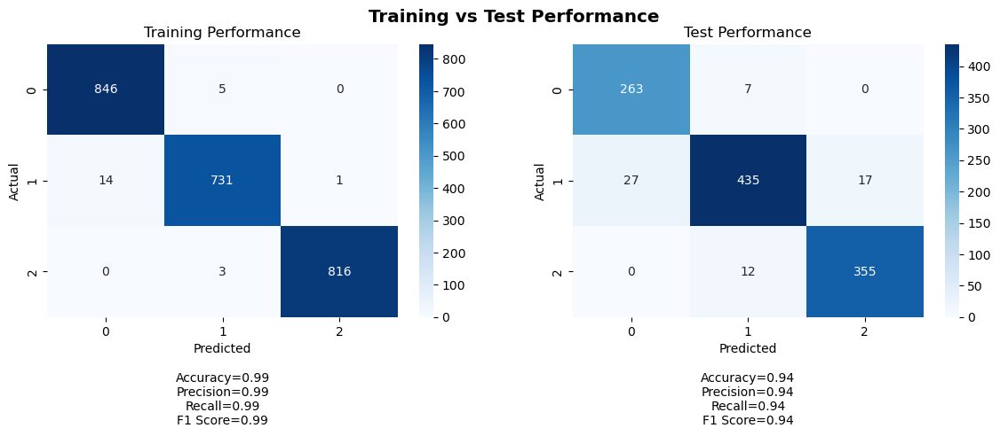

Training Metrics:
Accuracy: 0.9904801324503312
Precision: 0.9905083963447875
Recall: 0.9904801324503312
F1 Score: 0.9904773663225742

Test Metrics:
Accuracy: 0.9435483870967742
Precision: 0.9444841470273883
Recall: 0.9435483870967742
F1 Score: 0.9434240116113222

Training Confusion Matrix:
Class 0 - TP: 846, FP: 14, TN: 1551, FN: 5
Class 1 - TP: 731, FP: 8, TN: 1662, FN: 15
Class 2 - TP: 816, FP: 1, TN: 1596, FN: 3

Test Confusion Matrix:
Class 0 - TP: 263, FP: 27, TN: 819, FN: 7
Class 1 - TP: 435, FP: 19, TN: 618, FN: 44
Class 2 - TP: 355, FP: 17, TN: 732, FN: 12
35/35 [==============================] - 0s 2ms/step


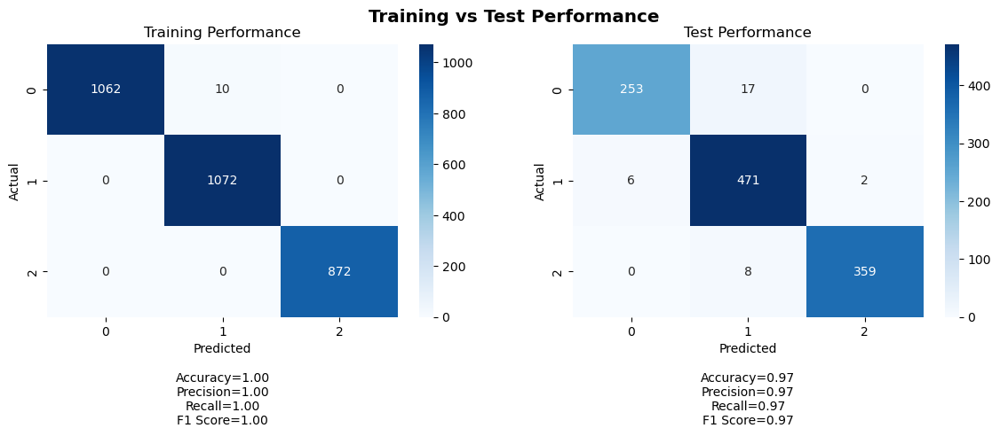

 83%|████████▎ | 83/100 [4:29:26<42:42, 150.76s/it]

Training Metrics:
Accuracy: 0.996684350132626
Precision: 0.9967149938467422
Recall: 0.996684350132626
F1 Score: 0.9966842780005306

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9709397738231663
Recall: 0.9704301075268817
F1 Score: 0.9704366963097677

Training Confusion Matrix:
Class 0 - TP: 1062, FP: 0, TN: 1944, FN: 10
Class 1 - TP: 1072, FP: 10, TN: 1934, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 253, FP: 6, TN: 840, FN: 17
Class 1 - TP: 471, FP: 25, TN: 612, FN: 8
Class 2 - TP: 359, FP: 2, TN: 747, FN: 8
35/35 [==============================] - 0s 2ms/step


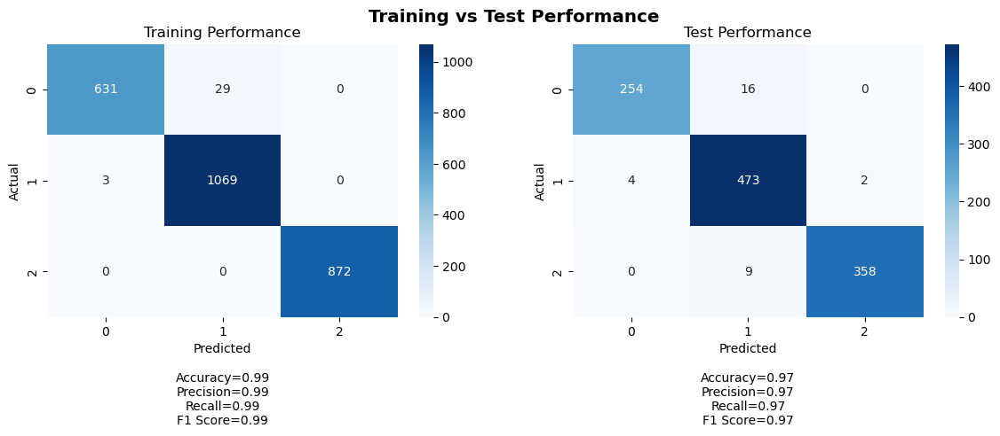

Training Metrics:
Accuracy: 0.9877112135176651
Precision: 0.9879276784582842
Recall: 0.9877112135176651
F1 Score: 0.9876613753064026

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9728753403768166
Recall: 0.9722222222222222
F1 Score: 0.9722412212112477

Training Confusion Matrix:
Class 0 - TP: 631, FP: 3, TN: 1941, FN: 29
Class 1 - TP: 1069, FP: 29, TN: 1503, FN: 3
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 254, FP: 4, TN: 842, FN: 16
Class 1 - TP: 473, FP: 25, TN: 612, FN: 6
Class 2 - TP: 358, FP: 2, TN: 747, FN: 9
35/35 [==============================] - 0s 2ms/step


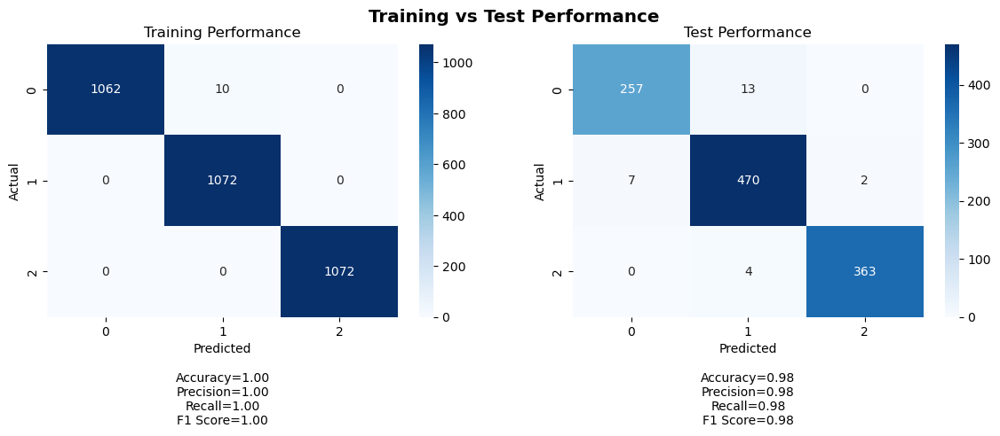

Training Metrics:
Accuracy: 0.9968905472636815
Precision: 0.9969192852741836
Recall: 0.9968905472636815
F1 Score: 0.9968904796174131

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9768003682500779
Recall: 0.9767025089605734
F1 Score: 0.9766909535695458

Training Confusion Matrix:
Class 0 - TP: 1062, FP: 0, TN: 2144, FN: 10
Class 1 - TP: 1072, FP: 10, TN: 2134, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 7, TN: 839, FN: 13
Class 1 - TP: 470, FP: 17, TN: 620, FN: 9
Class 2 - TP: 363, FP: 2, TN: 747, FN: 4
35/35 [==============================] - 0s 2ms/step


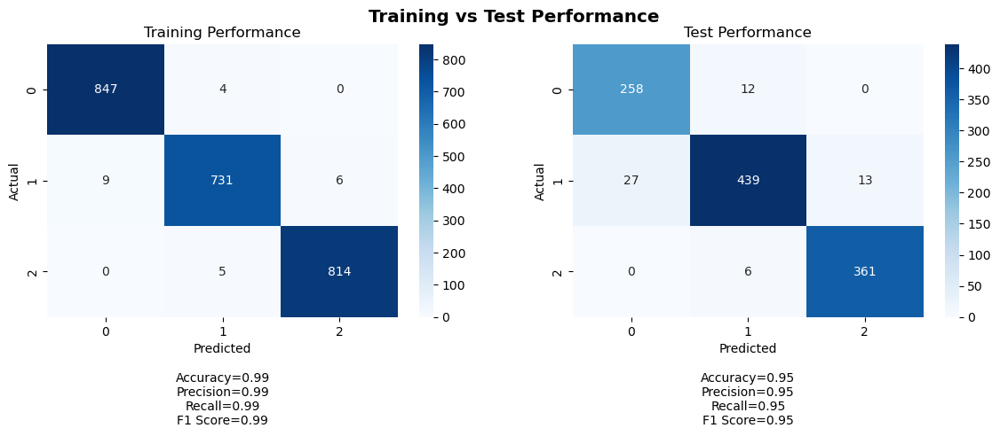

Training Metrics:
Accuracy: 0.9900662251655629
Precision: 0.99006080885499
Recall: 0.9900662251655629
F1 Score: 0.9900554398733932

Test Metrics:
Accuracy: 0.9480286738351255
Precision: 0.9487435908170737
Recall: 0.9480286738351255
F1 Score: 0.9479705615458304

Training Confusion Matrix:
Class 0 - TP: 847, FP: 9, TN: 1556, FN: 4
Class 1 - TP: 731, FP: 9, TN: 1661, FN: 15
Class 2 - TP: 814, FP: 6, TN: 1591, FN: 5

Test Confusion Matrix:
Class 0 - TP: 258, FP: 27, TN: 819, FN: 12
Class 1 - TP: 439, FP: 18, TN: 619, FN: 40
Class 2 - TP: 361, FP: 13, TN: 736, FN: 6
35/35 [==============================] - 0s 2ms/step


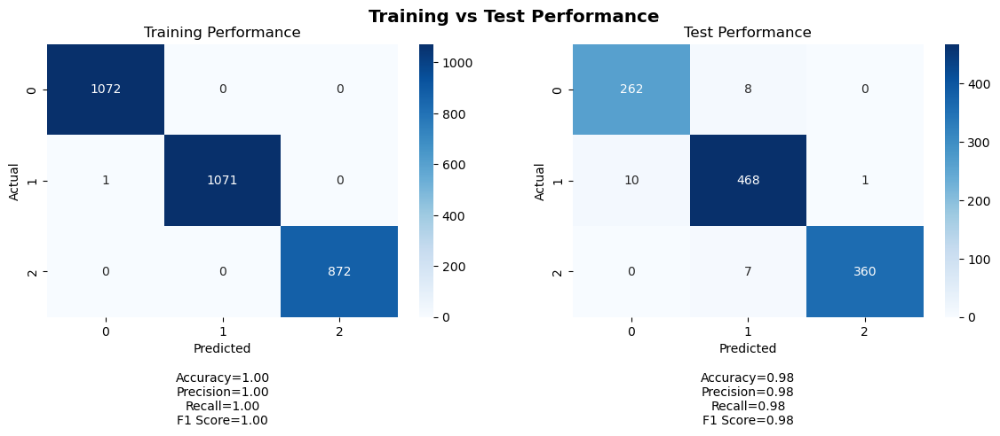

 84%|████████▍ | 84/100 [4:32:11<41:21, 155.09s/it]

Training Metrics:
Accuracy: 0.9996684350132626
Precision: 0.999668744020706
Recall: 0.9996684350132626
F1 Score: 0.9996684349411321

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9768648140821096
Recall: 0.9767025089605734
F1 Score: 0.9767511625028588

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 1, TN: 1943, FN: 0
Class 1 - TP: 1071, FP: 0, TN: 1944, FN: 1
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 10, TN: 836, FN: 8
Class 1 - TP: 468, FP: 15, TN: 622, FN: 11
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 4ms/step


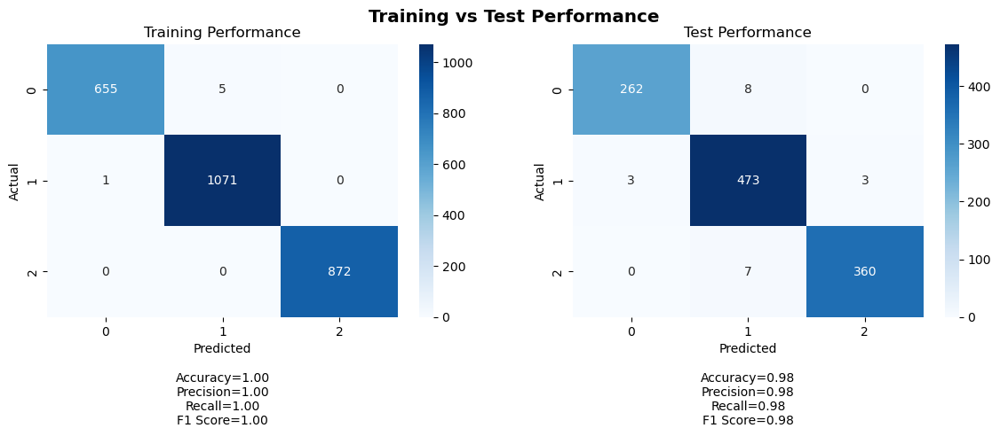

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.997700648924585
Recall: 0.9976958525345622
F1 Score: 0.9976944961793952

Test Metrics:
Accuracy: 0.9811827956989247
Precision: 0.9813503384582775
Recall: 0.9811827956989247
F1 Score: 0.9811997542948097

Training Confusion Matrix:
Class 0 - TP: 655, FP: 1, TN: 1943, FN: 5
Class 1 - TP: 1071, FP: 5, TN: 1527, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 3, TN: 843, FN: 8
Class 1 - TP: 473, FP: 15, TN: 622, FN: 6
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


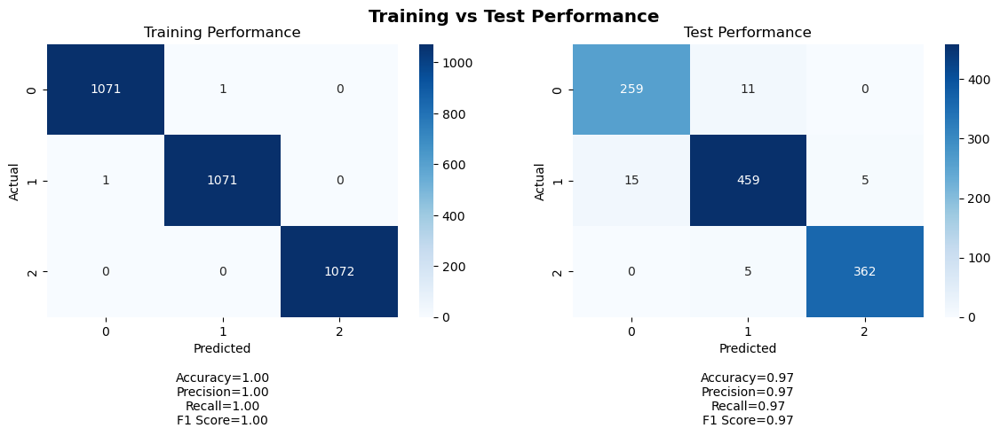

Training Metrics:
Accuracy: 0.9993781094527363
Precision: 0.9993781094527363
Recall: 0.9993781094527363
F1 Score: 0.9993781094527363

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9678174204839468
Recall: 0.967741935483871
F1 Score: 0.9677599610548216

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 1, TN: 2143, FN: 1
Class 1 - TP: 1071, FP: 1, TN: 2143, FN: 1
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 15, TN: 831, FN: 11
Class 1 - TP: 459, FP: 16, TN: 621, FN: 20
Class 2 - TP: 362, FP: 5, TN: 744, FN: 5
35/35 [==============================] - 0s 2ms/step


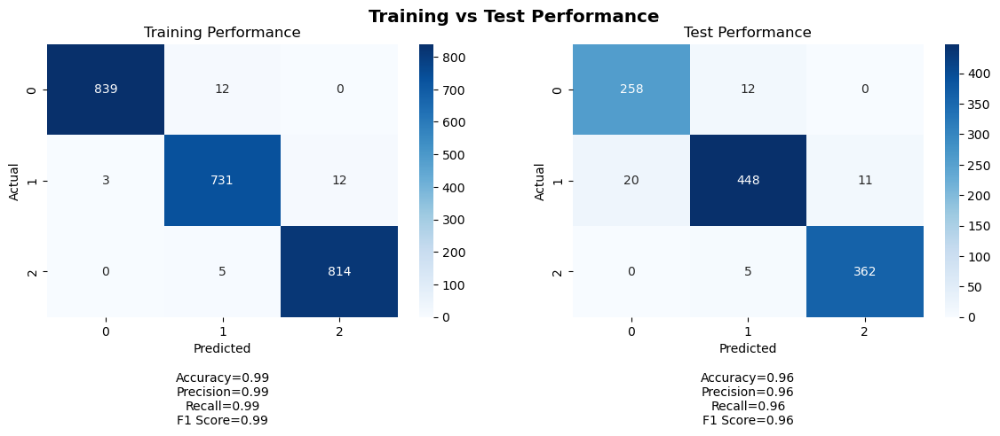

Training Metrics:
Accuracy: 0.9867549668874173
Precision: 0.9868026005597661
Recall: 0.9867549668874173
F1 Score: 0.9867623009805367

Test Metrics:
Accuracy: 0.956989247311828
Precision: 0.9572048882715842
Recall: 0.956989247311828
F1 Score: 0.9569377323510849

Training Confusion Matrix:
Class 0 - TP: 839, FP: 3, TN: 1562, FN: 12
Class 1 - TP: 731, FP: 17, TN: 1653, FN: 15
Class 2 - TP: 814, FP: 12, TN: 1585, FN: 5

Test Confusion Matrix:
Class 0 - TP: 258, FP: 20, TN: 826, FN: 12
Class 1 - TP: 448, FP: 17, TN: 620, FN: 31
Class 2 - TP: 362, FP: 11, TN: 738, FN: 5
35/35 [==============================] - 0s 2ms/step


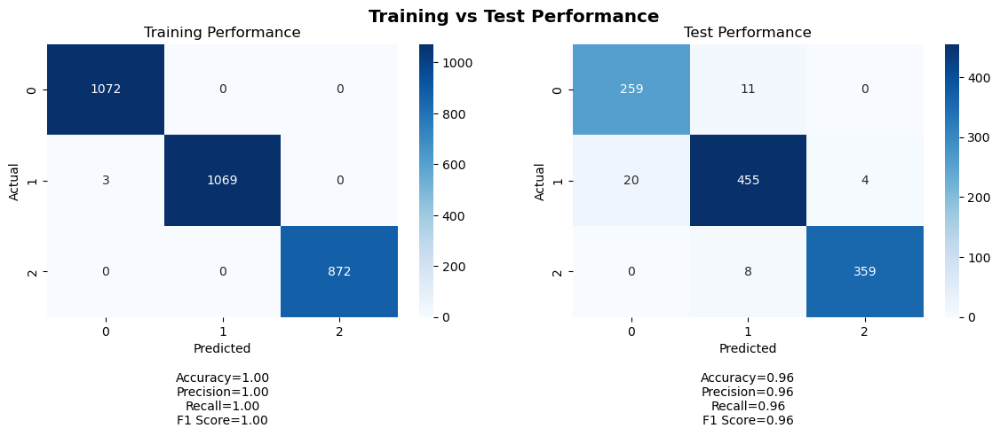

 85%|████████▌ | 85/100 [4:34:45<38:41, 154.74s/it]

Training Metrics:
Accuracy: 0.9990053050397878
Precision: 0.9990080809327001
Recall: 0.9990053050397878
F1 Score: 0.9990053030922598

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9618285503713335
Recall: 0.9614695340501792
F1 Score: 0.9615666845604106

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 3, TN: 1941, FN: 0
Class 1 - TP: 1069, FP: 0, TN: 1944, FN: 3
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 20, TN: 826, FN: 11
Class 1 - TP: 455, FP: 19, TN: 618, FN: 24
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 2ms/step


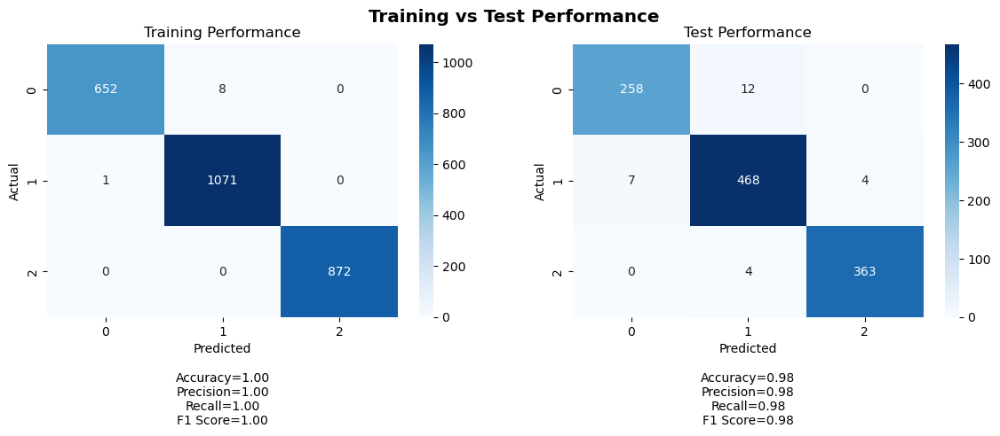

Training Metrics:
Accuracy: 0.9965437788018433
Precision: 0.9965595929924519
Recall: 0.9965437788018433
F1 Score: 0.9965401895126114

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9758362130685486
Recall: 0.9758064516129032
F1 Score: 0.9757897028774327

Training Confusion Matrix:
Class 0 - TP: 652, FP: 1, TN: 1943, FN: 8
Class 1 - TP: 1071, FP: 8, TN: 1524, FN: 1
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 258, FP: 7, TN: 839, FN: 12
Class 1 - TP: 468, FP: 16, TN: 621, FN: 11
Class 2 - TP: 363, FP: 4, TN: 745, FN: 4
35/35 [==============================] - 0s 2ms/step


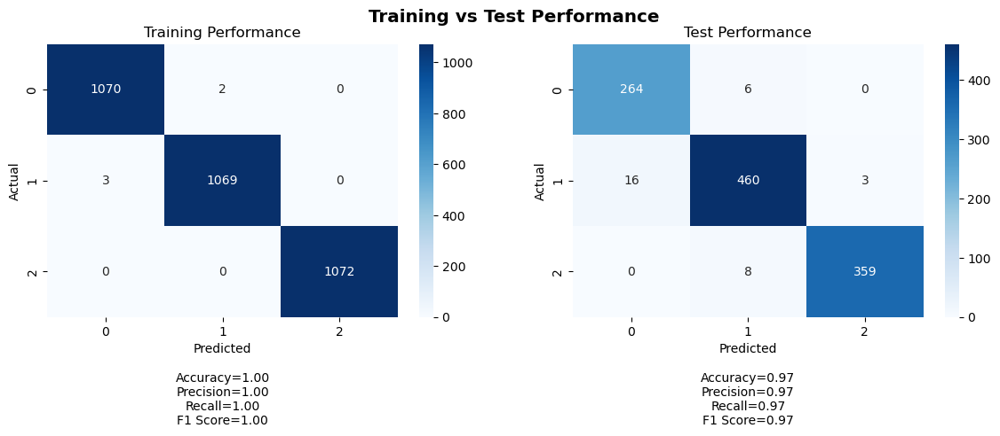

Training Metrics:
Accuracy: 0.9984452736318408
Precision: 0.9984455623400855
Recall: 0.9984452736318408
F1 Score: 0.9984452732936168

Test Metrics:
Accuracy: 0.9704301075268817
Precision: 0.9707726817047005
Recall: 0.9704301075268817
F1 Score: 0.9704979465605568

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 3, TN: 2141, FN: 2
Class 1 - TP: 1069, FP: 2, TN: 2142, FN: 3
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 264, FP: 16, TN: 830, FN: 6
Class 1 - TP: 460, FP: 14, TN: 623, FN: 19
Class 2 - TP: 359, FP: 3, TN: 746, FN: 8
35/35 [==============================] - 0s 1ms/step


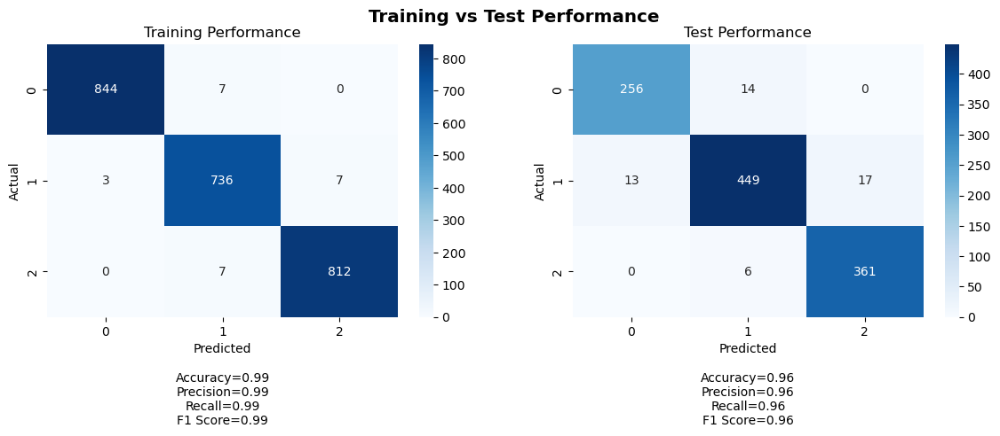

Training Metrics:
Accuracy: 0.9900662251655629
Precision: 0.9900912661490627
Recall: 0.9900662251655629
F1 Score: 0.9900746303801663

Test Metrics:
Accuracy: 0.9551971326164874
Precision: 0.9552150023519294
Recall: 0.9551971326164874
F1 Score: 0.9550905369134051

Training Confusion Matrix:
Class 0 - TP: 844, FP: 3, TN: 1562, FN: 7
Class 1 - TP: 736, FP: 14, TN: 1656, FN: 10
Class 2 - TP: 812, FP: 7, TN: 1590, FN: 7

Test Confusion Matrix:
Class 0 - TP: 256, FP: 13, TN: 833, FN: 14
Class 1 - TP: 449, FP: 20, TN: 617, FN: 30
Class 2 - TP: 361, FP: 17, TN: 732, FN: 6
35/35 [==============================] - 0s 2ms/step


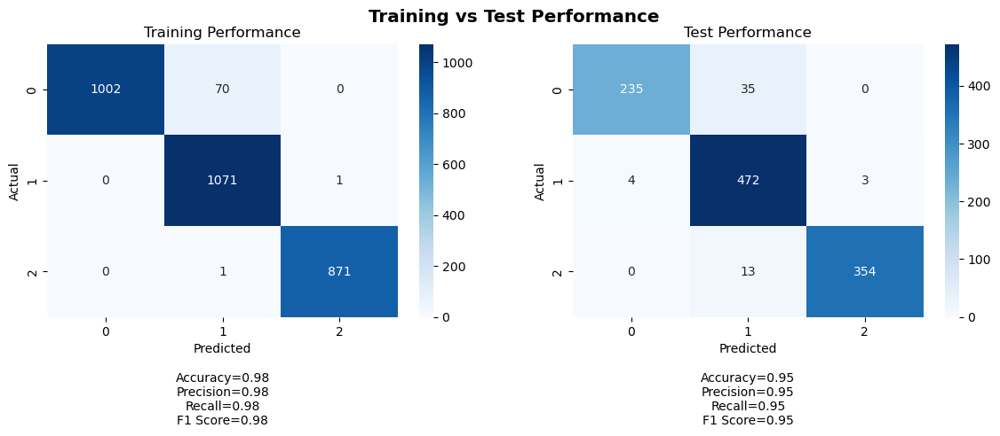

 86%|████████▌ | 86/100 [4:37:10<35:22, 151.63s/it]

Training Metrics:
Accuracy: 0.9761273209549072
Precision: 0.9775702964225822
Recall: 0.9761273209549072
F1 Score: 0.976113036867741

Test Metrics:
Accuracy: 0.9507168458781362
Precision: 0.9535678793183576
Recall: 0.9507168458781362
F1 Score: 0.9505649718649423

Training Confusion Matrix:
Class 0 - TP: 1002, FP: 0, TN: 1944, FN: 70
Class 1 - TP: 1071, FP: 71, TN: 1873, FN: 1
Class 2 - TP: 871, FP: 1, TN: 2143, FN: 1

Test Confusion Matrix:
Class 0 - TP: 235, FP: 4, TN: 842, FN: 35
Class 1 - TP: 472, FP: 48, TN: 589, FN: 7
Class 2 - TP: 354, FP: 3, TN: 746, FN: 13
35/35 [==============================] - 0s 2ms/step


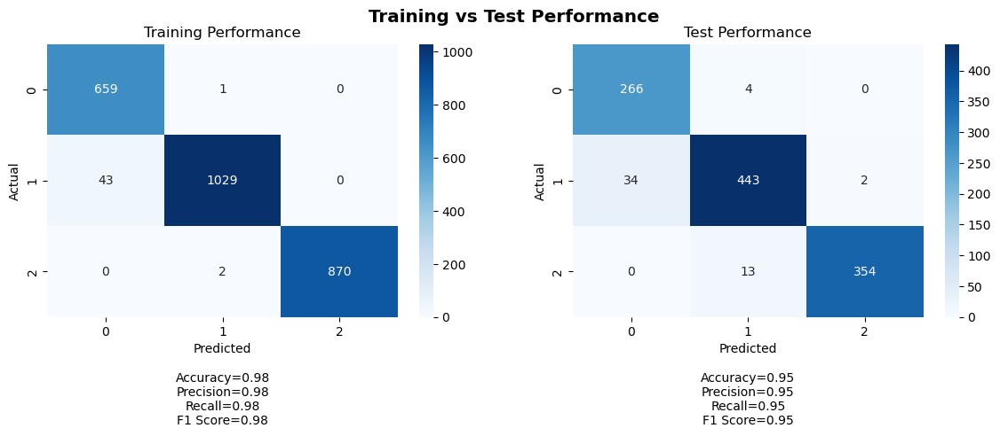

Training Metrics:
Accuracy: 0.9823348694316436
Precision: 0.9832781760763757
Recall: 0.9823348694316436
F1 Score: 0.9824270367257588

Test Metrics:
Accuracy: 0.9525089605734767
Precision: 0.9548709931309566
Recall: 0.9525089605734767
F1 Score: 0.9528222969386094

Training Confusion Matrix:
Class 0 - TP: 659, FP: 43, TN: 1901, FN: 1
Class 1 - TP: 1029, FP: 3, TN: 1529, FN: 43
Class 2 - TP: 870, FP: 0, TN: 1732, FN: 2

Test Confusion Matrix:
Class 0 - TP: 266, FP: 34, TN: 812, FN: 4
Class 1 - TP: 443, FP: 17, TN: 620, FN: 36
Class 2 - TP: 354, FP: 2, TN: 747, FN: 13
35/35 [==============================] - 0s 2ms/step


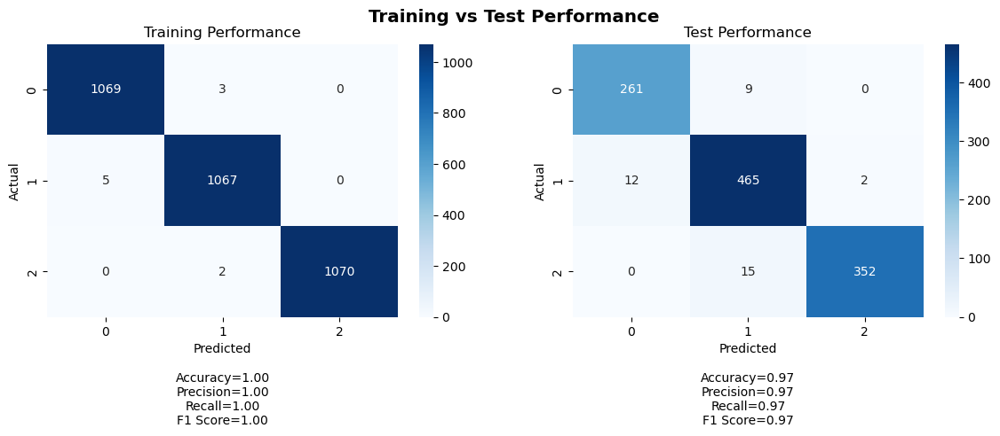

Training Metrics:
Accuracy: 0.9968905472636815
Precision: 0.9968934424710711
Recall: 0.9968905472636815
F1 Score: 0.9968914160942104

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.966441952822757
Recall: 0.9659498207885304
F1 Score: 0.9660403518633172

Training Confusion Matrix:
Class 0 - TP: 1069, FP: 5, TN: 2139, FN: 3
Class 1 - TP: 1067, FP: 5, TN: 2139, FN: 5
Class 2 - TP: 1070, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 261, FP: 12, TN: 834, FN: 9
Class 1 - TP: 465, FP: 24, TN: 613, FN: 14
Class 2 - TP: 352, FP: 2, TN: 747, FN: 15
35/35 [==============================] - 0s 2ms/step


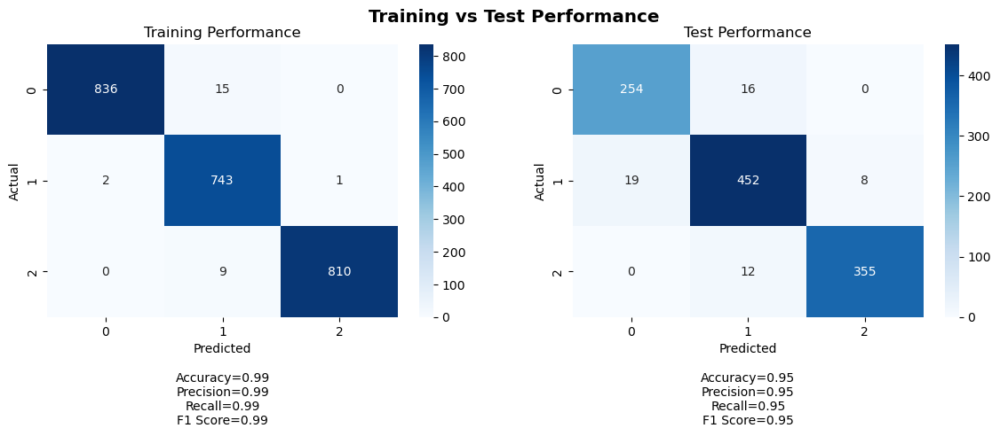

Training Metrics:
Accuracy: 0.9888245033112583
Precision: 0.9890795591838961
Recall: 0.9888245033112583
F1 Score: 0.9888648232074965

Test Metrics:
Accuracy: 0.9507168458781362
Precision: 0.9508772135055127
Recall: 0.9507168458781362
F1 Score: 0.9507800772994471

Training Confusion Matrix:
Class 0 - TP: 836, FP: 2, TN: 1563, FN: 15
Class 1 - TP: 743, FP: 24, TN: 1646, FN: 3
Class 2 - TP: 810, FP: 1, TN: 1596, FN: 9

Test Confusion Matrix:
Class 0 - TP: 254, FP: 19, TN: 827, FN: 16
Class 1 - TP: 452, FP: 28, TN: 609, FN: 27
Class 2 - TP: 355, FP: 8, TN: 741, FN: 12
35/35 [==============================] - 0s 2ms/step


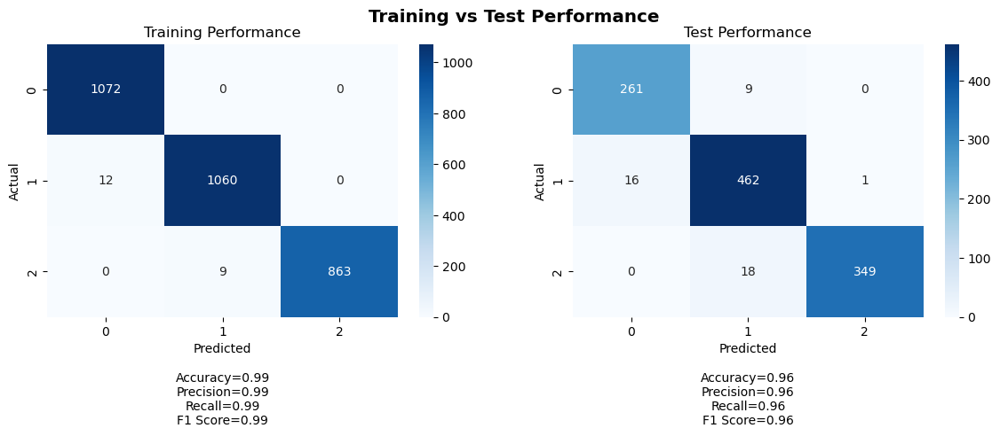

 87%|████████▋ | 87/100 [4:39:53<33:36, 155.13s/it]

Training Metrics:
Accuracy: 0.9930371352785146
Precision: 0.9930728063921244
Recall: 0.9930371352785146
F1 Score: 0.9930355900151593

Test Metrics:
Accuracy: 0.9605734767025089
Precision: 0.961387014283742
Recall: 0.9605734767025089
F1 Score: 0.9607186309065205

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 12, TN: 1932, FN: 0
Class 1 - TP: 1060, FP: 9, TN: 1935, FN: 12
Class 2 - TP: 863, FP: 0, TN: 2144, FN: 9

Test Confusion Matrix:
Class 0 - TP: 261, FP: 16, TN: 830, FN: 9
Class 1 - TP: 462, FP: 27, TN: 610, FN: 17
Class 2 - TP: 349, FP: 1, TN: 748, FN: 18
35/35 [==============================] - 0s 2ms/step


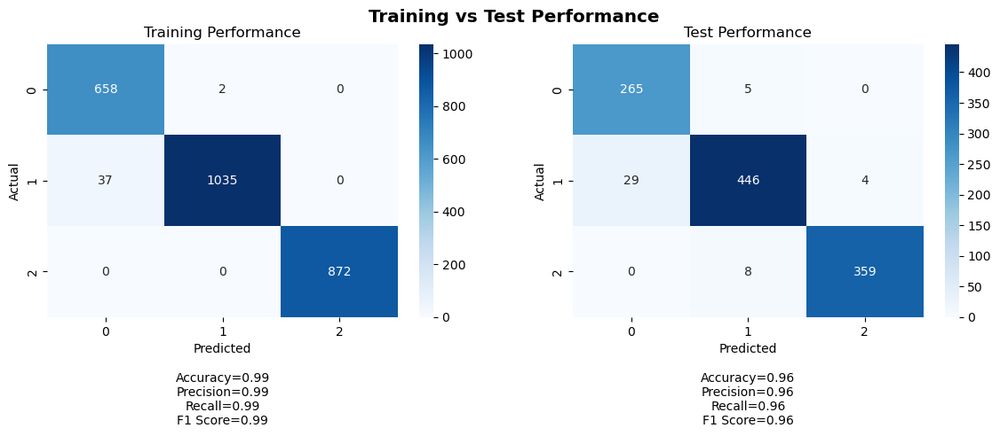

Training Metrics:
Accuracy: 0.9850230414746544
Precision: 0.9857126754768499
Recall: 0.9850230414746544
F1 Score: 0.9850921954493586

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9603555743745935
Recall: 0.9587813620071685
F1 Score: 0.9589606831771682

Training Confusion Matrix:
Class 0 - TP: 658, FP: 37, TN: 1907, FN: 2
Class 1 - TP: 1035, FP: 2, TN: 1530, FN: 37
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 265, FP: 29, TN: 817, FN: 5
Class 1 - TP: 446, FP: 13, TN: 624, FN: 33
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 2ms/step


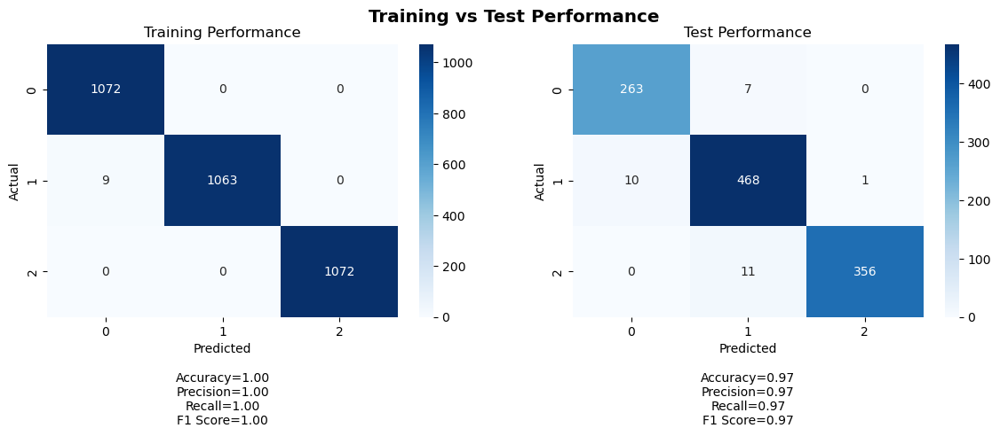

Training Metrics:
Accuracy: 0.9972014925373134
Precision: 0.9972247918593895
Recall: 0.9972014925373134
F1 Score: 0.9972014432233874

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9743200162765837
Recall: 0.9740143369175627
F1 Score: 0.9740764065814878

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 9, TN: 2135, FN: 0
Class 1 - TP: 1063, FP: 0, TN: 2144, FN: 9
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 10, TN: 836, FN: 7
Class 1 - TP: 468, FP: 18, TN: 619, FN: 11
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 2ms/step


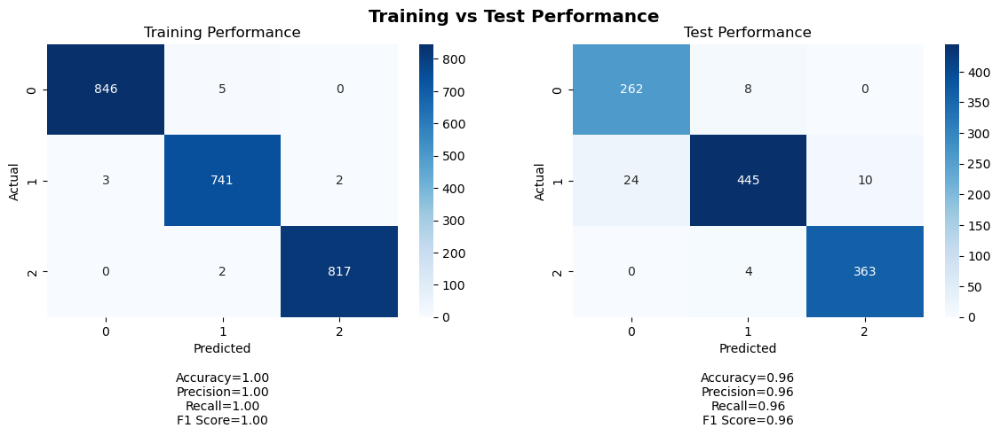

Training Metrics:
Accuracy: 0.9950331125827815
Precision: 0.9950379343707495
Recall: 0.9950331125827815
F1 Score: 0.9950344893402985

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.959610963016434
Recall: 0.9587813620071685
F1 Score: 0.9587603854129344

Training Confusion Matrix:
Class 0 - TP: 846, FP: 3, TN: 1562, FN: 5
Class 1 - TP: 741, FP: 7, TN: 1663, FN: 5
Class 2 - TP: 817, FP: 2, TN: 1595, FN: 2

Test Confusion Matrix:
Class 0 - TP: 262, FP: 24, TN: 822, FN: 8
Class 1 - TP: 445, FP: 12, TN: 625, FN: 34
Class 2 - TP: 363, FP: 10, TN: 739, FN: 4
35/35 [==============================] - 0s 2ms/step


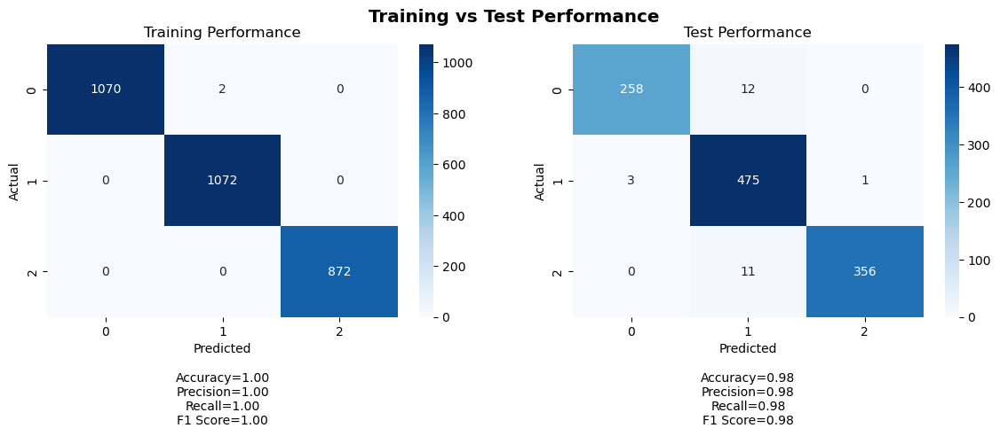

 88%|████████▊ | 88/100 [4:42:33<31:19, 156.60s/it]

Training Metrics:
Accuracy: 0.9993368700265252
Precision: 0.999338104905433
Recall: 0.9993368700265252
F1 Score: 0.9993368694494805

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9764749556987605
Recall: 0.9758064516129032
F1 Score: 0.975853536568602

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 0, TN: 1944, FN: 2
Class 1 - TP: 1072, FP: 2, TN: 1942, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 258, FP: 3, TN: 843, FN: 12
Class 1 - TP: 475, FP: 23, TN: 614, FN: 4
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 2ms/step


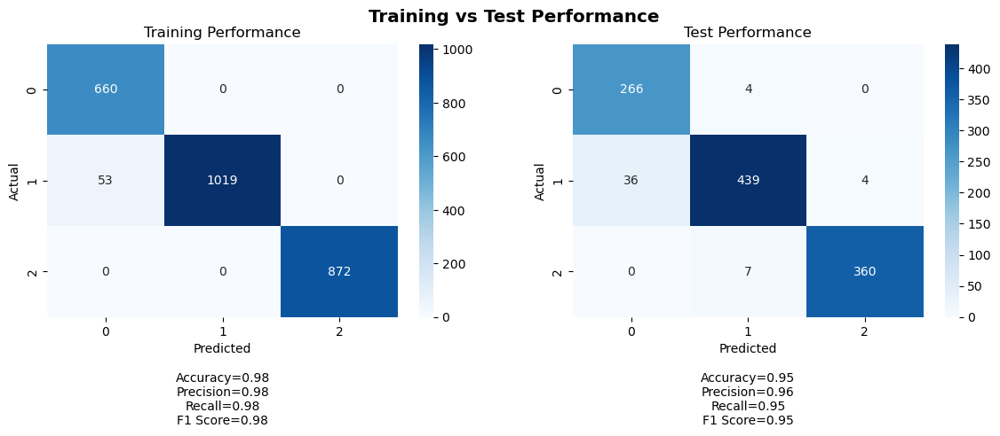

Training Metrics:
Accuracy: 0.9796466973886329
Precision: 0.9811596357314133
Recall: 0.9796466973886329
F1 Score: 0.9797815876629387

Test Metrics:
Accuracy: 0.9543010752688172
Precision: 0.9570544028804372
Recall: 0.9543010752688172
F1 Score: 0.9545701541905336

Training Confusion Matrix:
Class 0 - TP: 660, FP: 53, TN: 1891, FN: 0
Class 1 - TP: 1019, FP: 0, TN: 1532, FN: 53
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 36, TN: 810, FN: 4
Class 1 - TP: 439, FP: 11, TN: 626, FN: 40
Class 2 - TP: 360, FP: 4, TN: 745, FN: 7
35/35 [==============================] - 0s 2ms/step


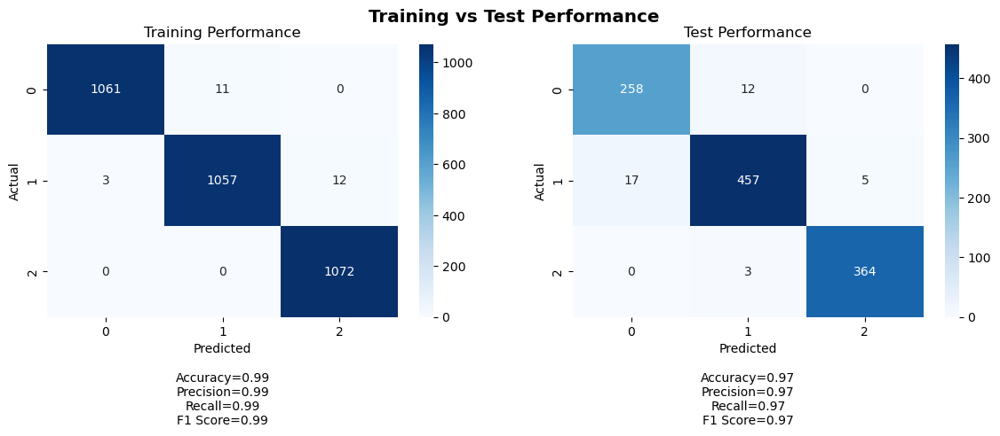

Training Metrics:
Accuracy: 0.9919154228855721
Precision: 0.9919369049861825
Recall: 0.9919154228855721
F1 Score: 0.9919100991549649

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9669477899220206
Recall: 0.9668458781362007
F1 Score: 0.9668527998549289

Training Confusion Matrix:
Class 0 - TP: 1061, FP: 3, TN: 2141, FN: 11
Class 1 - TP: 1057, FP: 11, TN: 2133, FN: 15
Class 2 - TP: 1072, FP: 12, TN: 2132, FN: 0

Test Confusion Matrix:
Class 0 - TP: 258, FP: 17, TN: 829, FN: 12
Class 1 - TP: 457, FP: 15, TN: 622, FN: 22
Class 2 - TP: 364, FP: 5, TN: 744, FN: 3
35/35 [==============================] - 0s 2ms/step


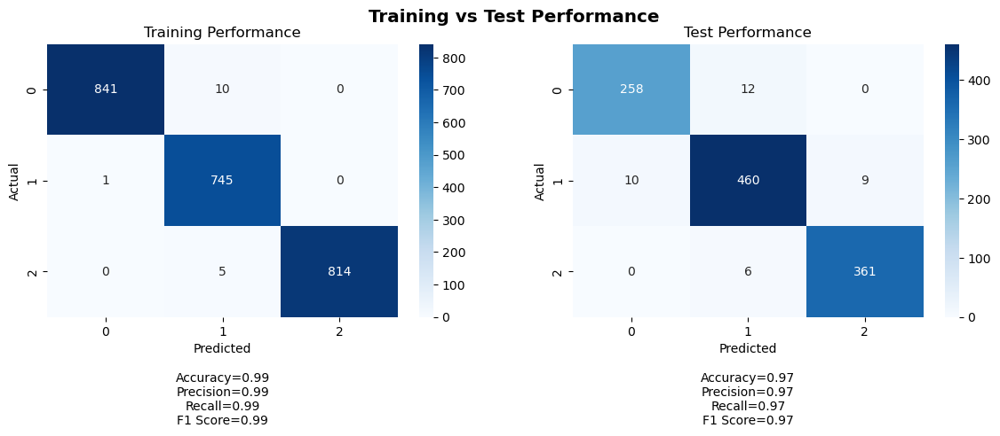

Training Metrics:
Accuracy: 0.9933774834437086
Precision: 0.9934874283747388
Recall: 0.9933774834437086
F1 Score: 0.9933929952514613

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9668106534081861
Recall: 0.9668458781362007
F1 Score: 0.9668192703723499

Training Confusion Matrix:
Class 0 - TP: 841, FP: 1, TN: 1564, FN: 10
Class 1 - TP: 745, FP: 15, TN: 1655, FN: 1
Class 2 - TP: 814, FP: 0, TN: 1597, FN: 5

Test Confusion Matrix:
Class 0 - TP: 258, FP: 10, TN: 836, FN: 12
Class 1 - TP: 460, FP: 18, TN: 619, FN: 19
Class 2 - TP: 361, FP: 9, TN: 740, FN: 6
35/35 [==============================] - 0s 2ms/step


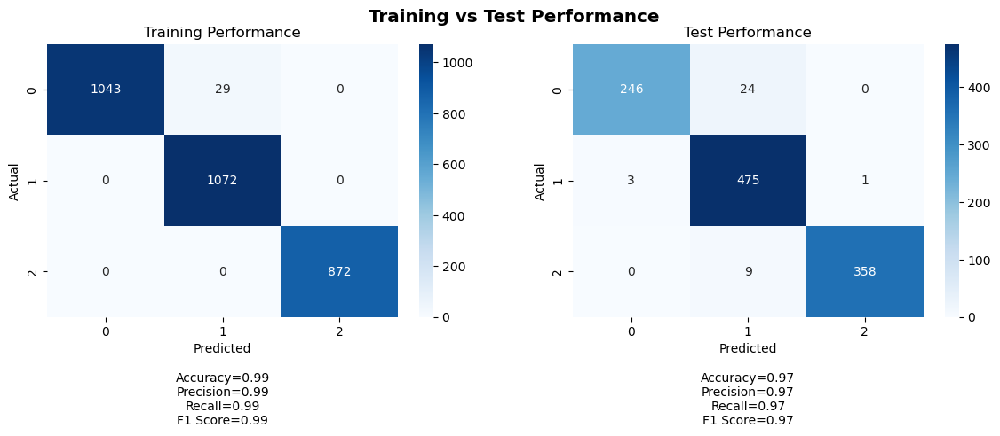

 89%|████████▉ | 89/100 [4:45:18<29:10, 159.17s/it]

Training Metrics:
Accuracy: 0.9903846153846154
Precision: 0.990637881646056
Recall: 0.9903846153846154
F1 Score: 0.9903828558712972

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9682872420223666
Recall: 0.9668458781362007
F1 Score: 0.9667941103668604

Training Confusion Matrix:
Class 0 - TP: 1043, FP: 0, TN: 1944, FN: 29
Class 1 - TP: 1072, FP: 29, TN: 1915, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 246, FP: 3, TN: 843, FN: 24
Class 1 - TP: 475, FP: 33, TN: 604, FN: 4
Class 2 - TP: 358, FP: 1, TN: 748, FN: 9
35/35 [==============================] - 0s 2ms/step


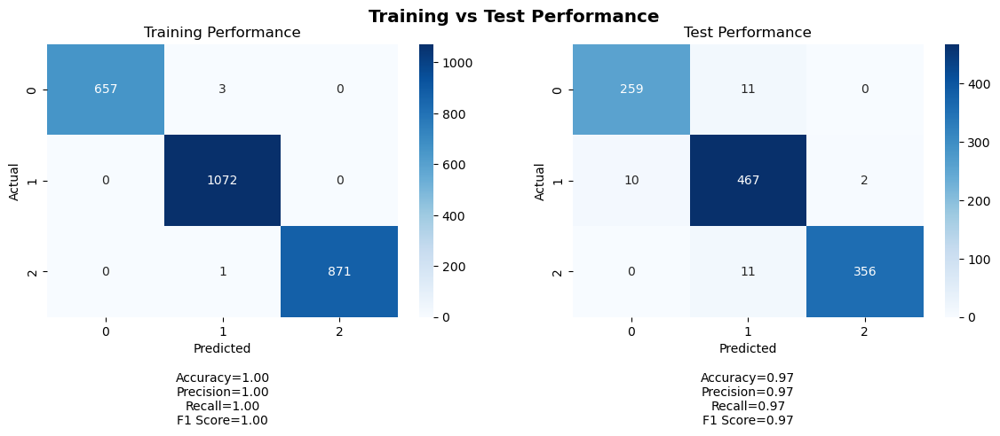

Training Metrics:
Accuracy: 0.9984639016897081
Precision: 0.9984696120923486
Recall: 0.9984639016897081
F1 Score: 0.9984639096300159

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9698588205194558
Recall: 0.9695340501792115
F1 Score: 0.9696016574014854

Training Confusion Matrix:
Class 0 - TP: 657, FP: 0, TN: 1944, FN: 3
Class 1 - TP: 1072, FP: 4, TN: 1528, FN: 0
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 259, FP: 10, TN: 836, FN: 11
Class 1 - TP: 467, FP: 22, TN: 615, FN: 12
Class 2 - TP: 356, FP: 2, TN: 747, FN: 11
35/35 [==============================] - 0s 3ms/step


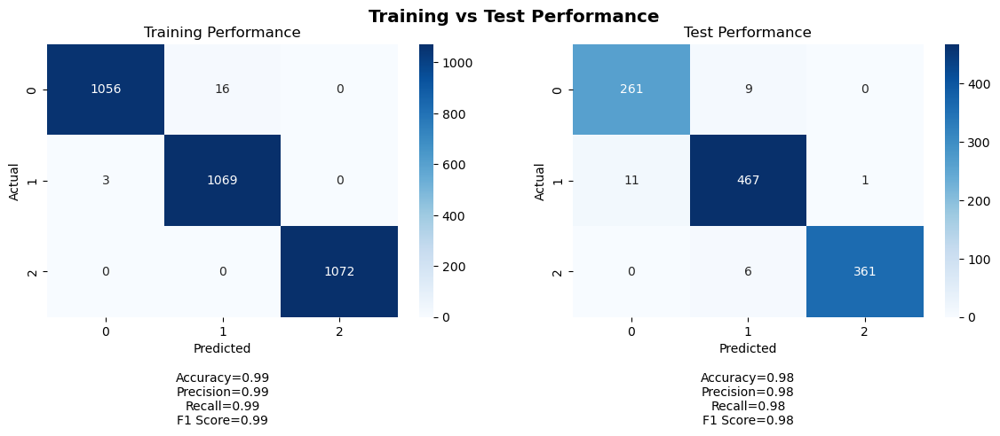

Training Metrics:
Accuracy: 0.994092039800995
Precision: 0.9941401983437987
Recall: 0.994092039800995
F1 Score: 0.9940918225855657

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9759502071631683
Recall: 0.9758064516129032
F1 Score: 0.9758557692495085

Training Confusion Matrix:
Class 0 - TP: 1056, FP: 3, TN: 2141, FN: 16
Class 1 - TP: 1069, FP: 16, TN: 2128, FN: 3
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 11, TN: 835, FN: 9
Class 1 - TP: 467, FP: 15, TN: 622, FN: 12
Class 2 - TP: 361, FP: 1, TN: 748, FN: 6
35/35 [==============================] - 0s 2ms/step


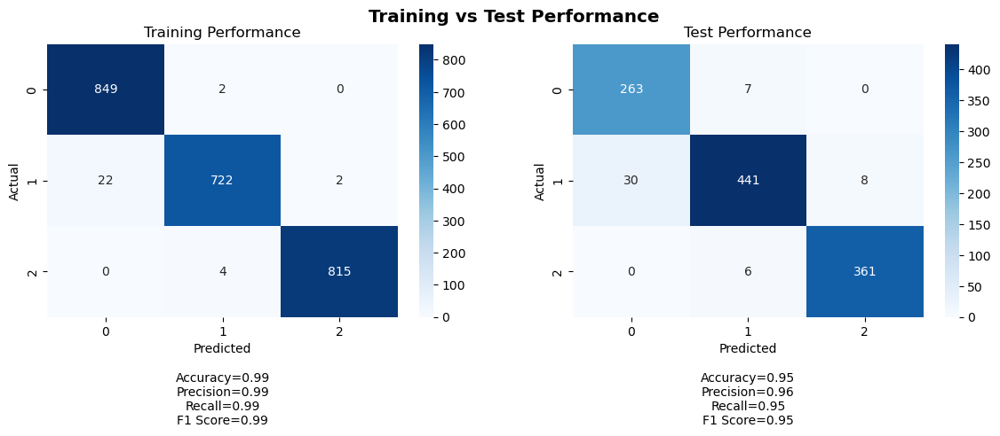

Training Metrics:
Accuracy: 0.9875827814569537
Precision: 0.9877284432392931
Recall: 0.9875827814569537
F1 Score: 0.9875631334050976

Test Metrics:
Accuracy: 0.9543010752688172
Precision: 0.9558086471399894
Recall: 0.9543010752688172
F1 Score: 0.9543830776370086

Training Confusion Matrix:
Class 0 - TP: 849, FP: 22, TN: 1543, FN: 2
Class 1 - TP: 722, FP: 6, TN: 1664, FN: 24
Class 2 - TP: 815, FP: 2, TN: 1595, FN: 4

Test Confusion Matrix:
Class 0 - TP: 263, FP: 30, TN: 816, FN: 7
Class 1 - TP: 441, FP: 13, TN: 624, FN: 38
Class 2 - TP: 361, FP: 8, TN: 741, FN: 6
35/35 [==============================] - 0s 2ms/step


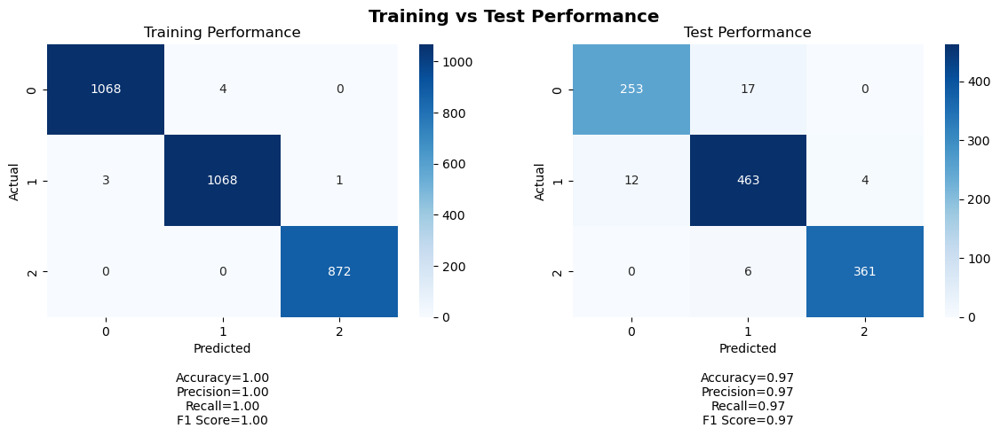

 90%|█████████ | 90/100 [4:47:55<26:25, 158.59s/it]

Training Metrics:
Accuracy: 0.9973474801061007
Precision: 0.9973469311521631
Recall: 0.9973474801061007
F1 Score: 0.9973470335903516

Test Metrics:
Accuracy: 0.9650537634408602
Precision: 0.9651280849620125
Recall: 0.9650537634408602
F1 Score: 0.9650468418963484

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 3, TN: 1941, FN: 4
Class 1 - TP: 1068, FP: 4, TN: 1940, FN: 4
Class 2 - TP: 872, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 253, FP: 12, TN: 834, FN: 17
Class 1 - TP: 463, FP: 23, TN: 614, FN: 16
Class 2 - TP: 361, FP: 4, TN: 745, FN: 6
35/35 [==============================] - 0s 2ms/step


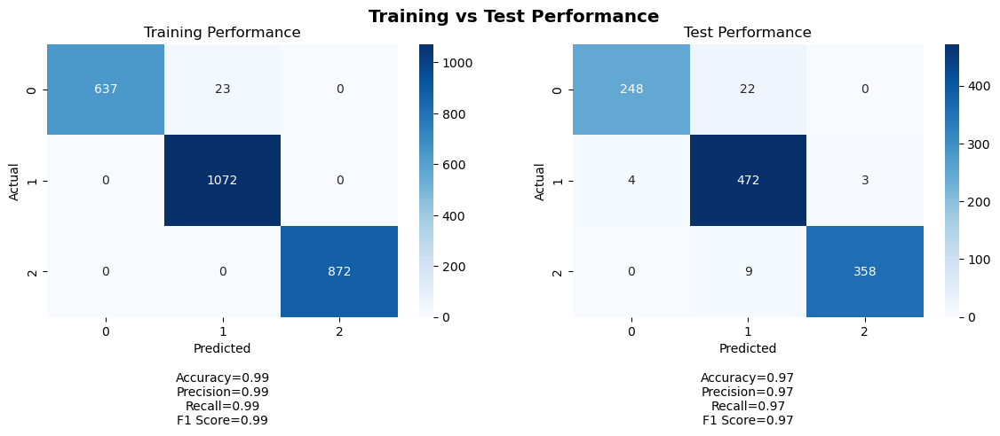

Training Metrics:
Accuracy: 0.9911674347158218
Precision: 0.991352958918138
Recall: 0.9911674347158218
F1 Score: 0.99113599308517

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9669745066908152
Recall: 0.9659498207885304
F1 Score: 0.9659199211833502

Training Confusion Matrix:
Class 0 - TP: 637, FP: 0, TN: 1944, FN: 23
Class 1 - TP: 1072, FP: 23, TN: 1509, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 248, FP: 4, TN: 842, FN: 22
Class 1 - TP: 472, FP: 31, TN: 606, FN: 7
Class 2 - TP: 358, FP: 3, TN: 746, FN: 9
35/35 [==============================] - 0s 2ms/step


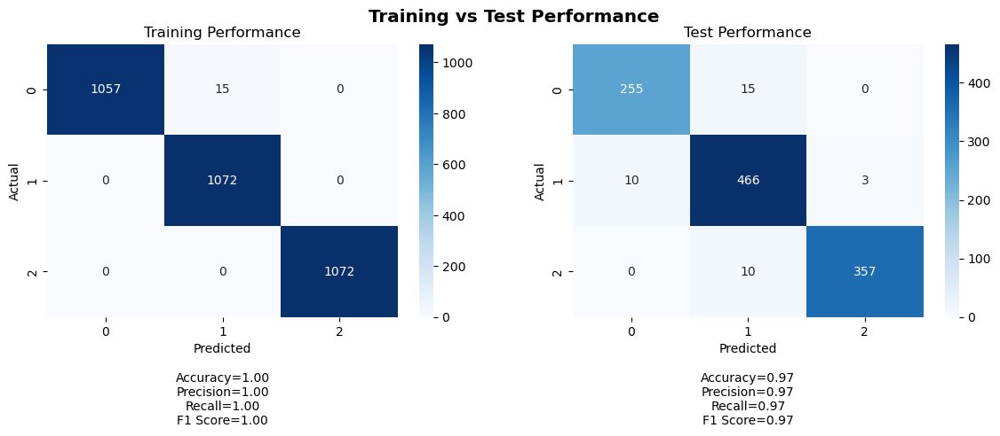

Training Metrics:
Accuracy: 0.9953358208955224
Precision: 0.9954001839926403
Recall: 0.9953358208955224
F1 Score: 0.9953355925831571

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9662759725669567
Recall: 0.9659498207885304
F1 Score: 0.9659996802390203

Training Confusion Matrix:
Class 0 - TP: 1057, FP: 0, TN: 2144, FN: 15
Class 1 - TP: 1072, FP: 15, TN: 2129, FN: 0
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 255, FP: 10, TN: 836, FN: 15
Class 1 - TP: 466, FP: 25, TN: 612, FN: 13
Class 2 - TP: 357, FP: 3, TN: 746, FN: 10
35/35 [==============================] - 0s 2ms/step


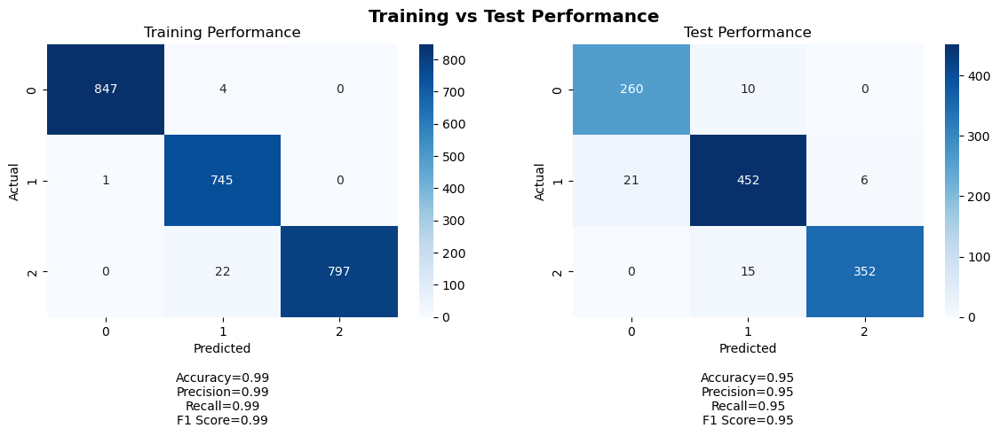

Training Metrics:
Accuracy: 0.9888245033112583
Precision: 0.9891719880893807
Recall: 0.9888245033112583
F1 Score: 0.9888527780378727

Test Metrics:
Accuracy: 0.953405017921147
Precision: 0.9539125486247112
Recall: 0.953405017921147
F1 Score: 0.9535167556035343

Training Confusion Matrix:
Class 0 - TP: 847, FP: 1, TN: 1564, FN: 4
Class 1 - TP: 745, FP: 26, TN: 1644, FN: 1
Class 2 - TP: 797, FP: 0, TN: 1597, FN: 22

Test Confusion Matrix:
Class 0 - TP: 260, FP: 21, TN: 825, FN: 10
Class 1 - TP: 452, FP: 25, TN: 612, FN: 27
Class 2 - TP: 352, FP: 6, TN: 743, FN: 15
35/35 [==============================] - 0s 2ms/step


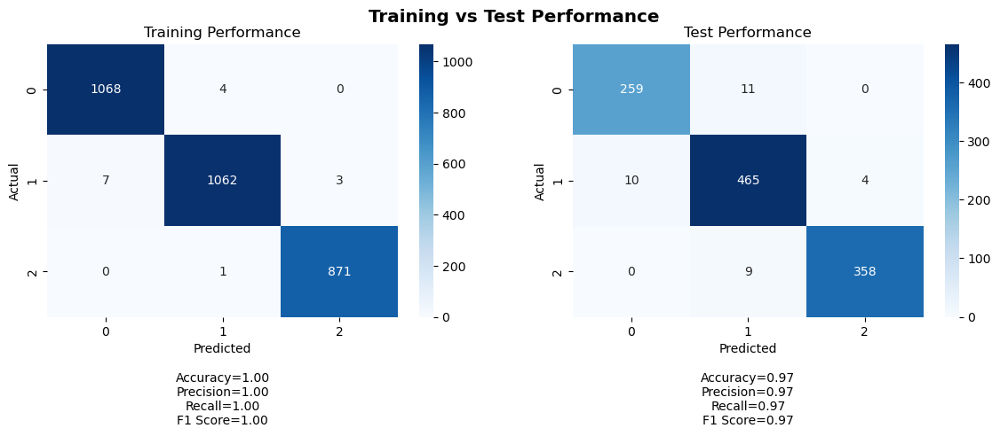

 91%|█████████ | 91/100 [4:50:24<23:18, 155.43s/it]

Training Metrics:
Accuracy: 0.995026525198939
Precision: 0.9950275098455602
Recall: 0.995026525198939
F1 Score: 0.9950240200716184

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9696729384770952
Recall: 0.9695340501792115
F1 Score: 0.9695714578767871

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 7, TN: 1937, FN: 4
Class 1 - TP: 1062, FP: 5, TN: 1939, FN: 10
Class 2 - TP: 871, FP: 3, TN: 2141, FN: 1

Test Confusion Matrix:
Class 0 - TP: 259, FP: 10, TN: 836, FN: 11
Class 1 - TP: 465, FP: 20, TN: 617, FN: 14
Class 2 - TP: 358, FP: 4, TN: 745, FN: 9
35/35 [==============================] - 0s 2ms/step


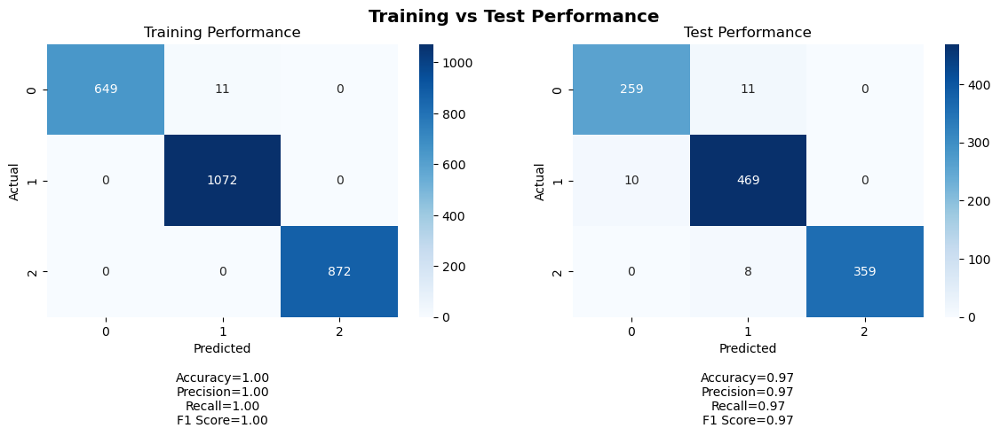

Training Metrics:
Accuracy: 0.9957757296466974
Precision: 0.9958186354397596
Recall: 0.9957757296466974
F1 Score: 0.9957687618120372

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9742950135437958
Recall: 0.9740143369175627
F1 Score: 0.974078311657577

Training Confusion Matrix:
Class 0 - TP: 649, FP: 0, TN: 1944, FN: 11
Class 1 - TP: 1072, FP: 11, TN: 1521, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 259, FP: 10, TN: 836, FN: 11
Class 1 - TP: 469, FP: 19, TN: 618, FN: 10
Class 2 - TP: 359, FP: 0, TN: 749, FN: 8
35/35 [==============================] - 0s 2ms/step


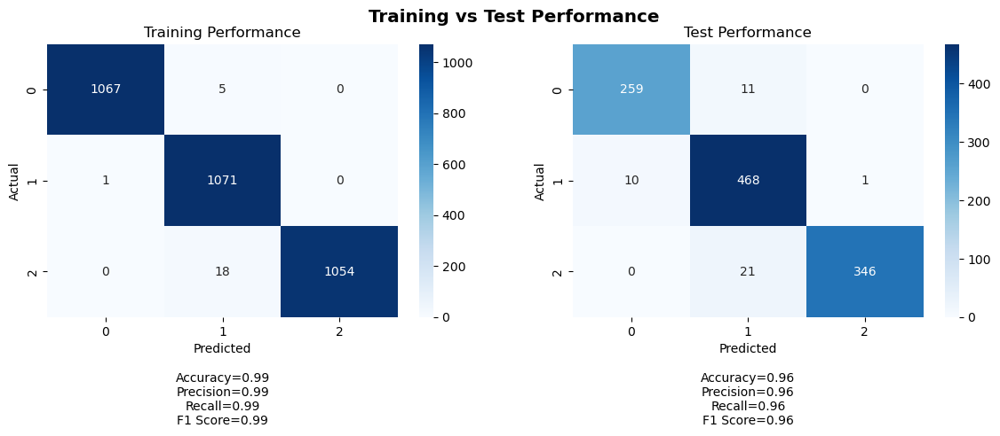

Training Metrics:
Accuracy: 0.9925373134328358
Precision: 0.9926799681385472
Recall: 0.9925373134328358
F1 Score: 0.9925497751070629

Test Metrics:
Accuracy: 0.9614695340501792
Precision: 0.9625888784867405
Recall: 0.9614695340501792
F1 Score: 0.9615892303886674

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 1, TN: 2143, FN: 5
Class 1 - TP: 1071, FP: 23, TN: 2121, FN: 1
Class 2 - TP: 1054, FP: 0, TN: 2144, FN: 18

Test Confusion Matrix:
Class 0 - TP: 259, FP: 10, TN: 836, FN: 11
Class 1 - TP: 468, FP: 32, TN: 605, FN: 11
Class 2 - TP: 346, FP: 1, TN: 748, FN: 21
35/35 [==============================] - 0s 2ms/step


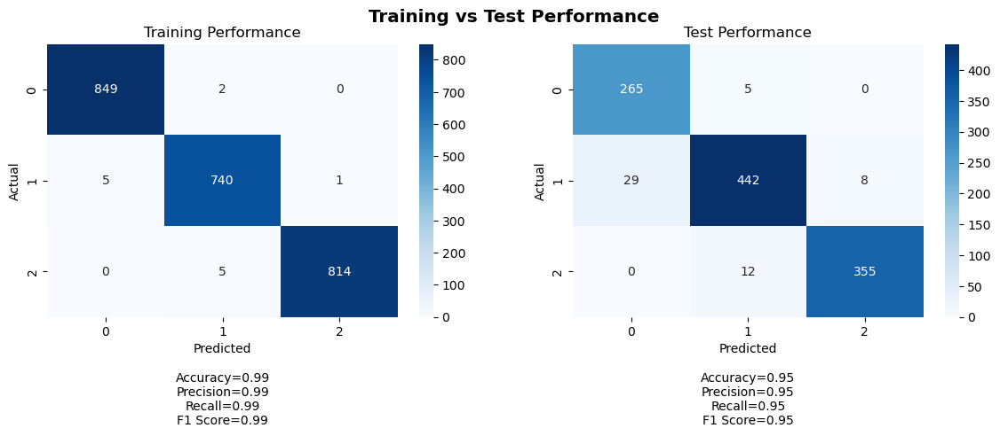

Training Metrics:
Accuracy: 0.9946192052980133
Precision: 0.9946283225347475
Recall: 0.9946192052980133
F1 Score: 0.9946205165839782

Test Metrics:
Accuracy: 0.9516129032258065
Precision: 0.9529914443799842
Recall: 0.9516129032258065
F1 Score: 0.9516961619811992

Training Confusion Matrix:
Class 0 - TP: 849, FP: 5, TN: 1560, FN: 2
Class 1 - TP: 740, FP: 7, TN: 1663, FN: 6
Class 2 - TP: 814, FP: 1, TN: 1596, FN: 5

Test Confusion Matrix:
Class 0 - TP: 265, FP: 29, TN: 817, FN: 5
Class 1 - TP: 442, FP: 17, TN: 620, FN: 37
Class 2 - TP: 355, FP: 8, TN: 741, FN: 12
35/35 [==============================] - 0s 2ms/step


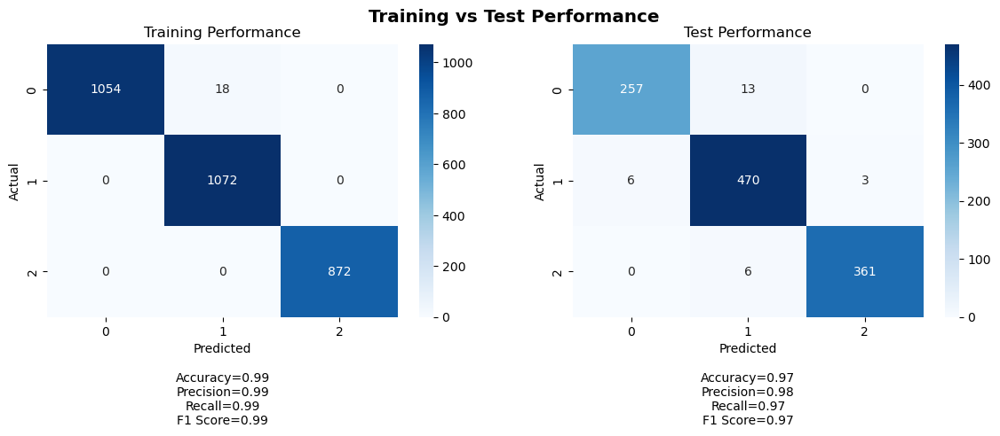

 92%|█████████▏| 92/100 [4:52:53<20:29, 153.74s/it]

Training Metrics:
Accuracy: 0.9940318302387268
Precision: 0.9941303871705645
Recall: 0.9940318302387268
F1 Score: 0.9940314095438452

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9750933037321182
Recall: 0.974910394265233
F1 Score: 0.974911644057789

Training Confusion Matrix:
Class 0 - TP: 1054, FP: 0, TN: 1944, FN: 18
Class 1 - TP: 1072, FP: 18, TN: 1926, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 257, FP: 6, TN: 840, FN: 13
Class 1 - TP: 470, FP: 19, TN: 618, FN: 9
Class 2 - TP: 361, FP: 3, TN: 746, FN: 6
35/35 [==============================] - 0s 2ms/step


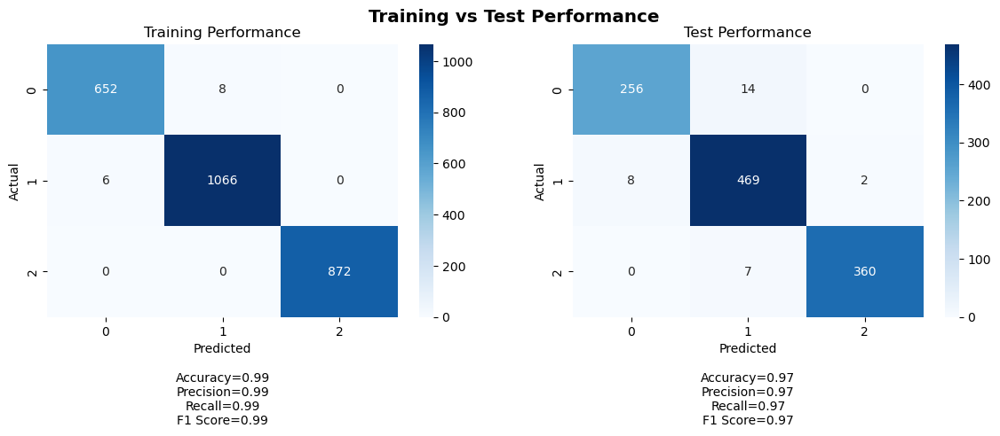

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.9946223734627792
Recall: 0.9946236559139785
F1 Score: 0.9946220820316299

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.972456976774389
Recall: 0.9722222222222222
F1 Score: 0.9722414828756404

Training Confusion Matrix:
Class 0 - TP: 652, FP: 6, TN: 1938, FN: 8
Class 1 - TP: 1066, FP: 8, TN: 1524, FN: 6
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 8, TN: 838, FN: 14
Class 1 - TP: 469, FP: 21, TN: 616, FN: 10
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


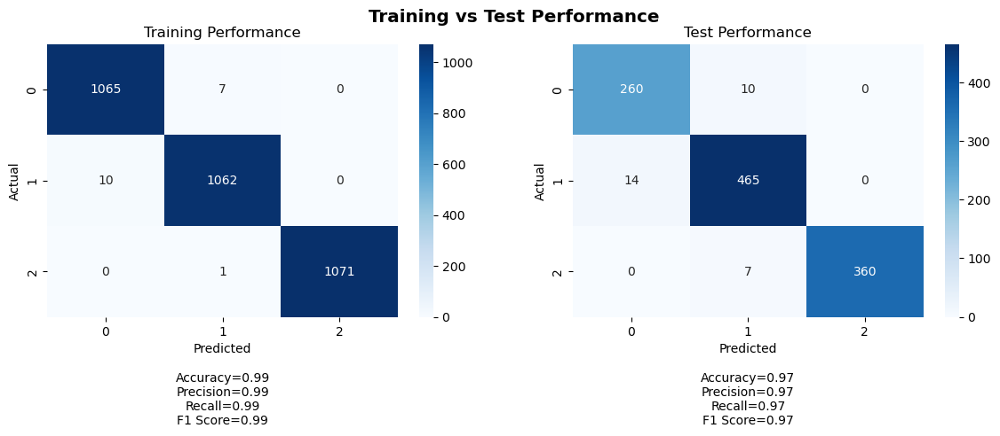

Training Metrics:
Accuracy: 0.9944029850746269
Precision: 0.9944070129681954
Recall: 0.9944029850746269
F1 Score: 0.9944039926488196

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9725001690776653
Recall: 0.9722222222222222
F1 Score: 0.9723144464635667

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 10, TN: 2134, FN: 7
Class 1 - TP: 1062, FP: 8, TN: 2136, FN: 10
Class 2 - TP: 1071, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 260, FP: 14, TN: 832, FN: 10
Class 1 - TP: 465, FP: 17, TN: 620, FN: 14
Class 2 - TP: 360, FP: 0, TN: 749, FN: 7
35/35 [==============================] - 0s 2ms/step


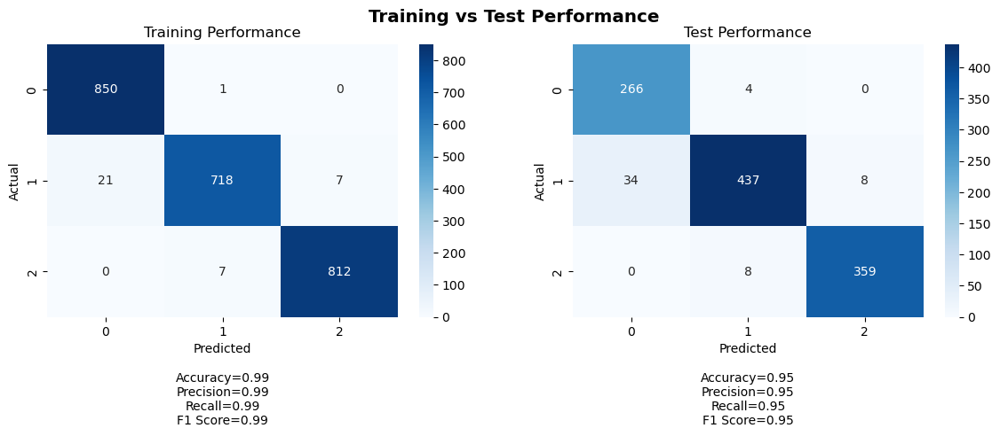

Training Metrics:
Accuracy: 0.9850993377483444
Precision: 0.9852077064105423
Recall: 0.9850993377483444
F1 Score: 0.9850509905641762

Test Metrics:
Accuracy: 0.9516129032258065
Precision: 0.953941055791045
Recall: 0.9516129032258065
F1 Score: 0.9517268415523422

Training Confusion Matrix:
Class 0 - TP: 850, FP: 21, TN: 1544, FN: 1
Class 1 - TP: 718, FP: 8, TN: 1662, FN: 28
Class 2 - TP: 812, FP: 7, TN: 1590, FN: 7

Test Confusion Matrix:
Class 0 - TP: 266, FP: 34, TN: 812, FN: 4
Class 1 - TP: 437, FP: 12, TN: 625, FN: 42
Class 2 - TP: 359, FP: 8, TN: 741, FN: 8
35/35 [==============================] - 0s 1ms/step


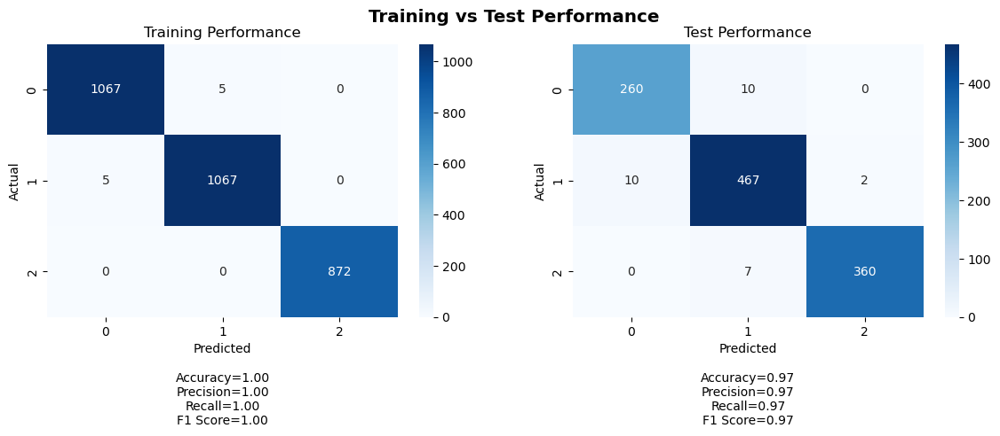

 93%|█████████▎| 93/100 [5:09:53<48:15, 413.58s/it]

Training Metrics:
Accuracy: 0.996684350132626
Precision: 0.996684350132626
Recall: 0.996684350132626
F1 Score: 0.996684350132626

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9741469493954467
Recall: 0.9740143369175627
F1 Score: 0.9740541410111192

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 5, TN: 1939, FN: 5
Class 1 - TP: 1067, FP: 5, TN: 1939, FN: 5
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 10, TN: 836, FN: 10
Class 1 - TP: 467, FP: 17, TN: 620, FN: 12
Class 2 - TP: 360, FP: 2, TN: 747, FN: 7
35/35 [==============================] - 0s 2ms/step


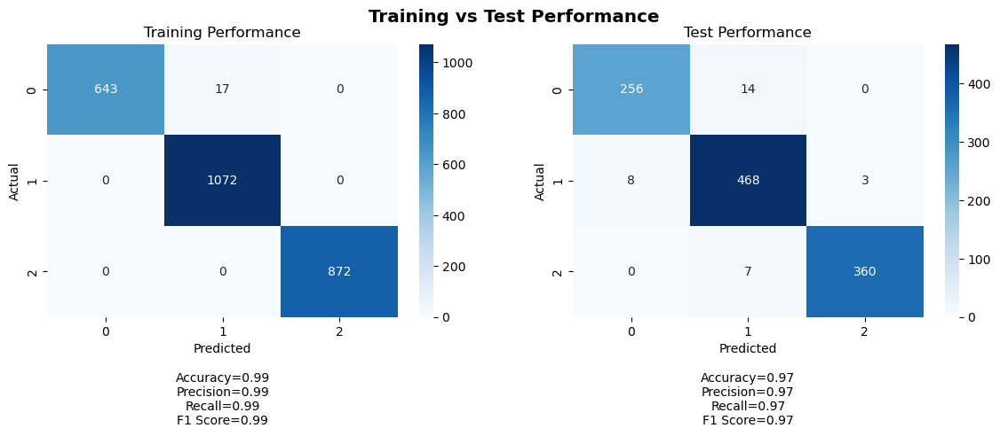

Training Metrics:
Accuracy: 0.9934715821812596
Precision: 0.9935734950397707
Recall: 0.9934715821812596
F1 Score: 0.9934546732961814

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9715184335301998
Recall: 0.9713261648745519
F1 Score: 0.9713389753497369

Training Confusion Matrix:
Class 0 - TP: 643, FP: 0, TN: 1944, FN: 17
Class 1 - TP: 1072, FP: 17, TN: 1515, FN: 0
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 256, FP: 8, TN: 838, FN: 14
Class 1 - TP: 468, FP: 21, TN: 616, FN: 11
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


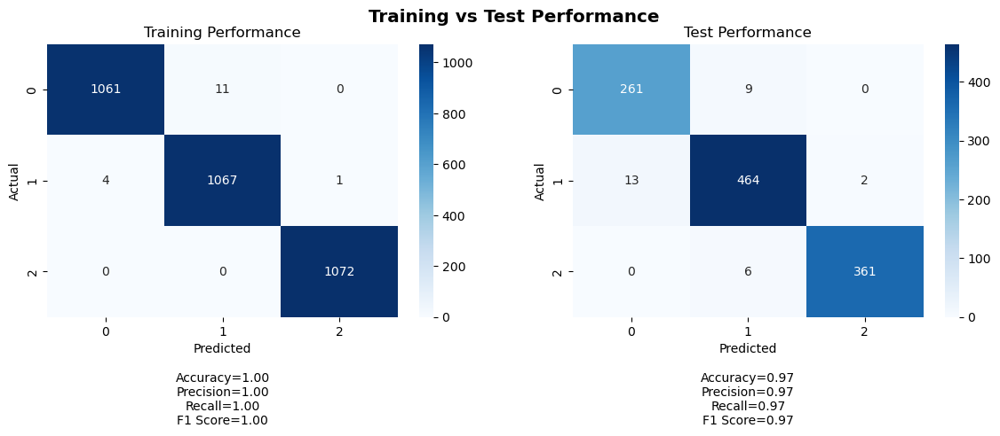

Training Metrics:
Accuracy: 0.9950248756218906
Precision: 0.9950360277911795
Recall: 0.9950248756218906
F1 Score: 0.9950242510980777

Test Metrics:
Accuracy: 0.9731182795698925
Precision: 0.9732685864286781
Recall: 0.9731182795698925
F1 Score: 0.9731711151834428

Training Confusion Matrix:
Class 0 - TP: 1061, FP: 4, TN: 2140, FN: 11
Class 1 - TP: 1067, FP: 11, TN: 2133, FN: 5
Class 2 - TP: 1072, FP: 1, TN: 2143, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 13, TN: 833, FN: 9
Class 1 - TP: 464, FP: 15, TN: 622, FN: 15
Class 2 - TP: 361, FP: 2, TN: 747, FN: 6
35/35 [==============================] - 0s 2ms/step


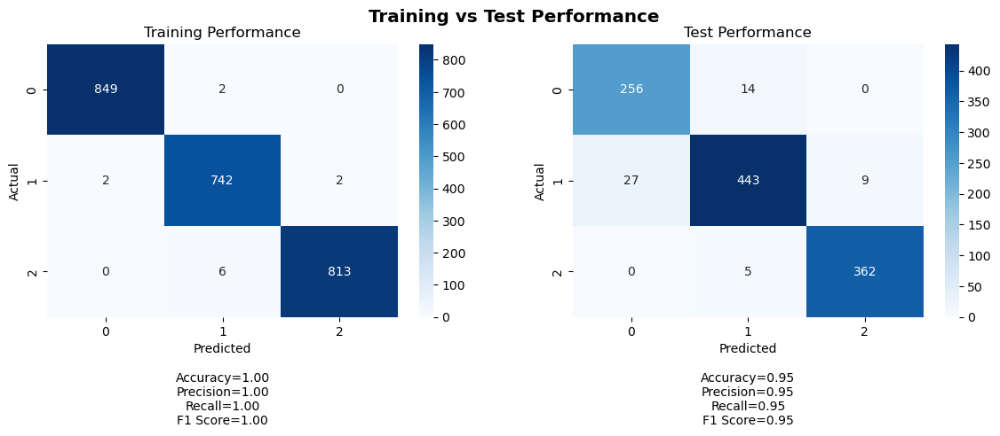

Training Metrics:
Accuracy: 0.9950331125827815
Precision: 0.9950467097333388
Recall: 0.9950331125827815
F1 Score: 0.9950356998588924

Test Metrics:
Accuracy: 0.9507168458781362
Precision: 0.9512886949164958
Recall: 0.9507168458781362
F1 Score: 0.9507374957836309

Training Confusion Matrix:
Class 0 - TP: 849, FP: 2, TN: 1563, FN: 2
Class 1 - TP: 742, FP: 8, TN: 1662, FN: 4
Class 2 - TP: 813, FP: 2, TN: 1595, FN: 6

Test Confusion Matrix:
Class 0 - TP: 256, FP: 27, TN: 819, FN: 14
Class 1 - TP: 443, FP: 19, TN: 618, FN: 36
Class 2 - TP: 362, FP: 9, TN: 740, FN: 5
35/35 [==============================] - 0s 1ms/step


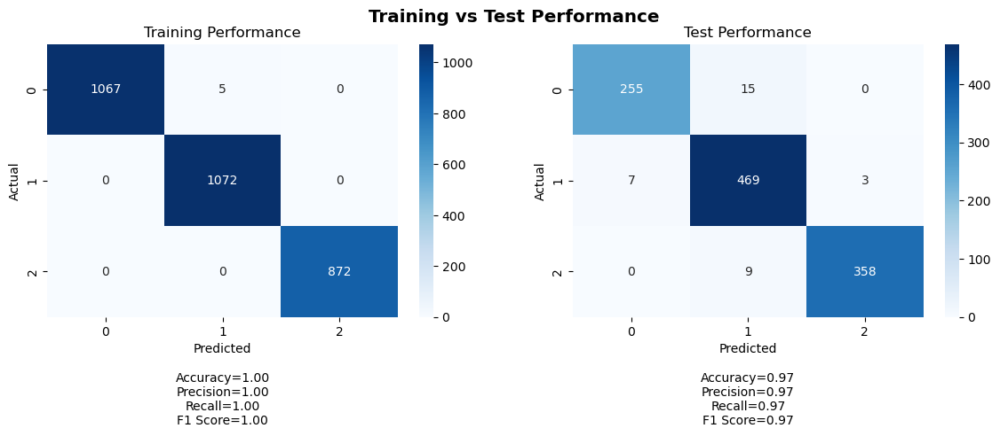

 94%|█████████▍| 94/100 [5:12:09<33:01, 330.25s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983498715608984
Recall: 0.998342175066313
F1 Score: 0.9983421660499482

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9699085480540233
Recall: 0.9695340501792115
F1 Score: 0.9695609246270548

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 0, TN: 1944, FN: 5
Class 1 - TP: 1072, FP: 5, TN: 1939, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 255, FP: 7, TN: 839, FN: 15
Class 1 - TP: 469, FP: 24, TN: 613, FN: 10
Class 2 - TP: 358, FP: 3, TN: 746, FN: 9
35/35 [==============================] - 0s 1ms/step


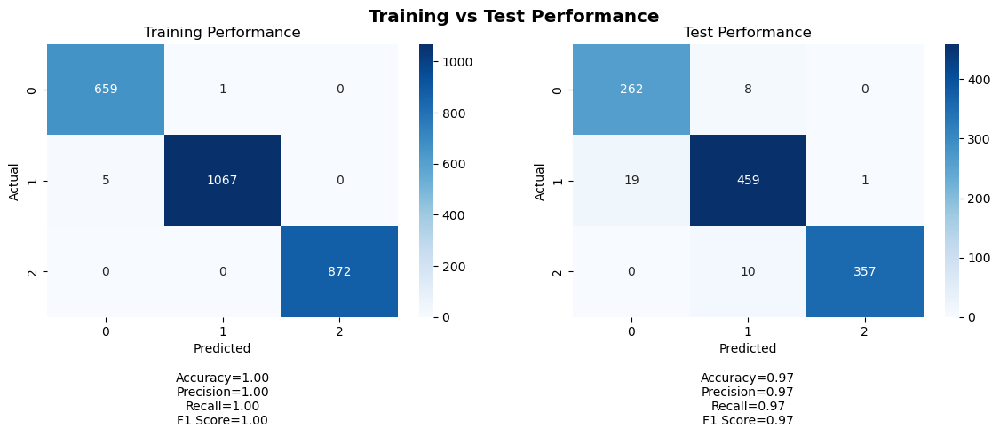

Training Metrics:
Accuracy: 0.9976958525345622
Precision: 0.9977059812456128
Recall: 0.9976958525345622
F1 Score: 0.9976971797110112

Test Metrics:
Accuracy: 0.9659498207885304
Precision: 0.9665261298199598
Recall: 0.9659498207885304
F1 Score: 0.9660945207578919

Training Confusion Matrix:
Class 0 - TP: 659, FP: 5, TN: 1939, FN: 1
Class 1 - TP: 1067, FP: 1, TN: 1531, FN: 5
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 19, TN: 827, FN: 8
Class 1 - TP: 459, FP: 18, TN: 619, FN: 20
Class 2 - TP: 357, FP: 1, TN: 748, FN: 10
35/35 [==============================] - 0s 1ms/step


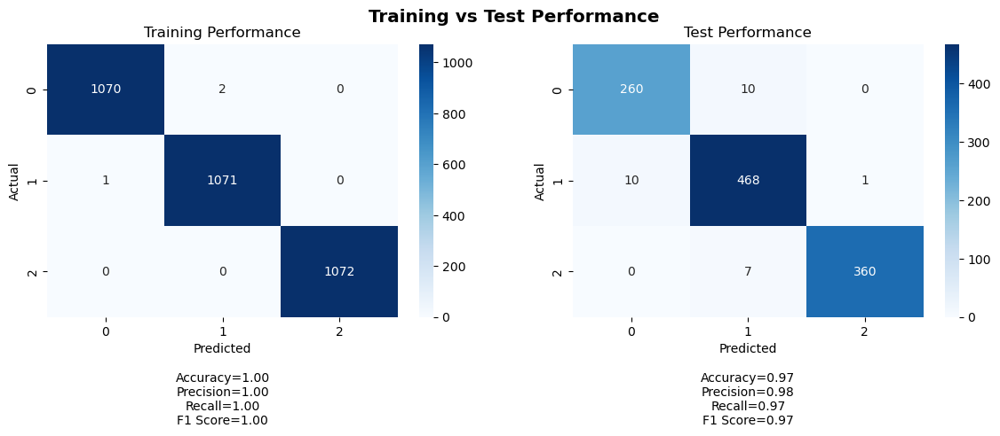

Training Metrics:
Accuracy: 0.9990671641791045
Precision: 0.9990674534285082
Recall: 0.9990671641791045
F1 Score: 0.9990671639761701

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9750839505194763
Recall: 0.974910394265233
F1 Score: 0.9749589335990085

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 1, TN: 2143, FN: 2
Class 1 - TP: 1071, FP: 2, TN: 2142, FN: 1
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 10, TN: 836, FN: 10
Class 1 - TP: 468, FP: 17, TN: 620, FN: 11
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 1ms/step


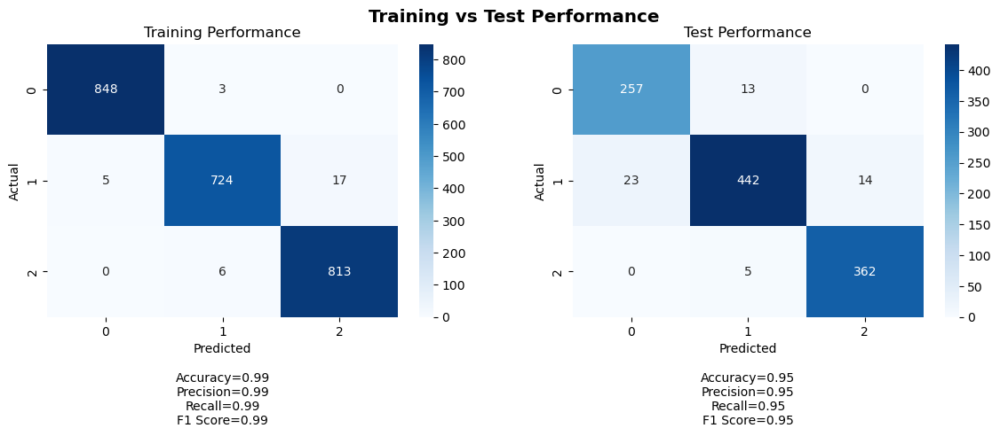

Training Metrics:
Accuracy: 0.9871688741721855
Precision: 0.98720091329721
Recall: 0.9871688741721855
F1 Score: 0.987146178514898

Test Metrics:
Accuracy: 0.9507168458781362
Precision: 0.9510869683633851
Recall: 0.9507168458781362
F1 Score: 0.950614609074377

Training Confusion Matrix:
Class 0 - TP: 848, FP: 5, TN: 1560, FN: 3
Class 1 - TP: 724, FP: 9, TN: 1661, FN: 22
Class 2 - TP: 813, FP: 17, TN: 1580, FN: 6

Test Confusion Matrix:
Class 0 - TP: 257, FP: 23, TN: 823, FN: 13
Class 1 - TP: 442, FP: 18, TN: 619, FN: 37
Class 2 - TP: 362, FP: 14, TN: 735, FN: 5
35/35 [==============================] - 0s 2ms/step


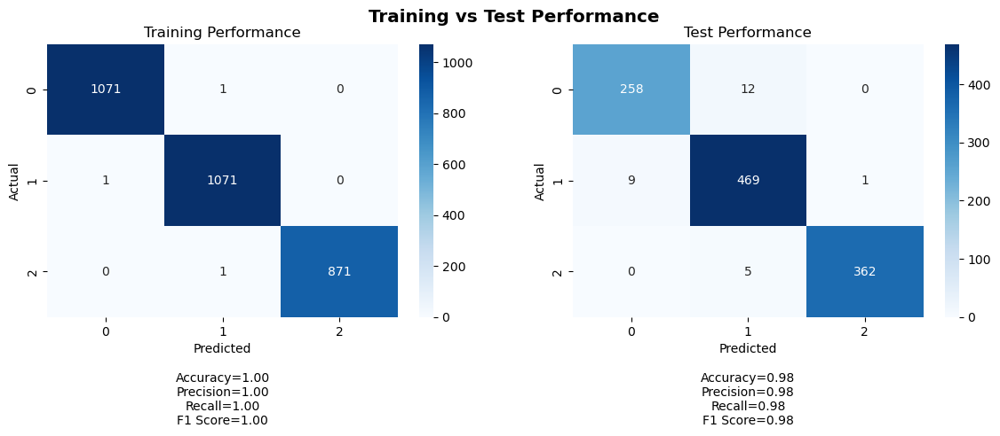

 95%|█████████▌| 95/100 [5:14:44<23:08, 277.75s/it]

Training Metrics:
Accuracy: 0.9990053050397878
Precision: 0.9990059230546745
Recall: 0.9990053050397878
F1 Score: 0.9990054417901083

Test Metrics:
Accuracy: 0.9758064516129032
Precision: 0.9759253701503817
Recall: 0.9758064516129032
F1 Score: 0.9758269085009842

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 1, TN: 1943, FN: 1
Class 1 - TP: 1071, FP: 2, TN: 1942, FN: 1
Class 2 - TP: 871, FP: 0, TN: 2144, FN: 1

Test Confusion Matrix:
Class 0 - TP: 258, FP: 9, TN: 837, FN: 12
Class 1 - TP: 469, FP: 17, TN: 620, FN: 10
Class 2 - TP: 362, FP: 1, TN: 748, FN: 5
35/35 [==============================] - 0s 2ms/step


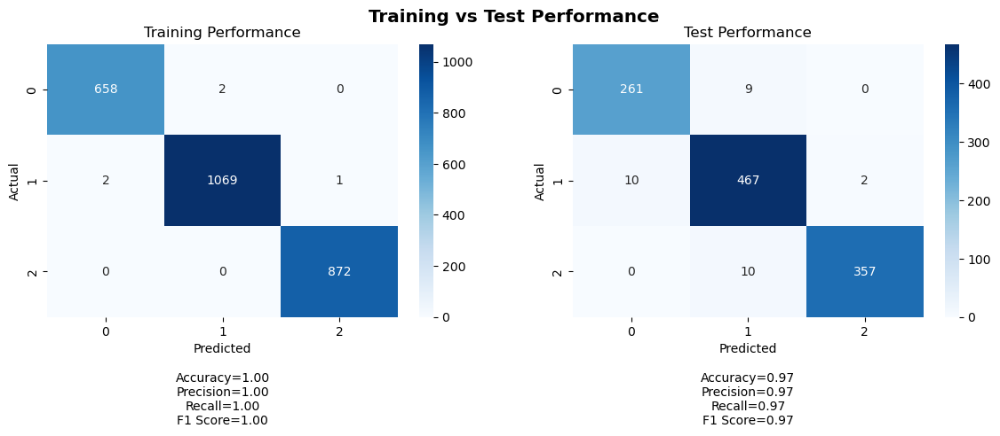

Training Metrics:
Accuracy: 0.9980798771121352
Precision: 0.9980795998700999
Recall: 0.9980798771121352
F1 Score: 0.9980795391490236

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9724605687054828
Recall: 0.9722222222222222
F1 Score: 0.9722794620113069

Training Confusion Matrix:
Class 0 - TP: 658, FP: 2, TN: 1942, FN: 2
Class 1 - TP: 1069, FP: 2, TN: 1530, FN: 3
Class 2 - TP: 872, FP: 1, TN: 1731, FN: 0

Test Confusion Matrix:
Class 0 - TP: 261, FP: 10, TN: 836, FN: 9
Class 1 - TP: 467, FP: 19, TN: 618, FN: 12
Class 2 - TP: 357, FP: 2, TN: 747, FN: 10
35/35 [==============================] - 0s 2ms/step


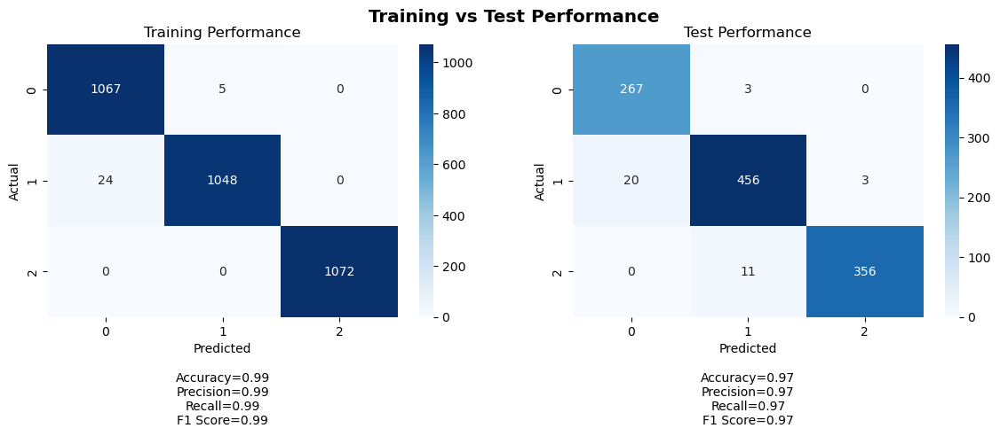

Training Metrics:
Accuracy: 0.9909825870646766
Precision: 0.991084498366299
Recall: 0.9909825870646766
F1 Score: 0.9909818788356767

Test Metrics:
Accuracy: 0.9668458781362007
Precision: 0.9676072863041901
Recall: 0.9668458781362007
F1 Score: 0.9669340543070052

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 24, TN: 2120, FN: 5
Class 1 - TP: 1048, FP: 5, TN: 2139, FN: 24
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 267, FP: 20, TN: 826, FN: 3
Class 1 - TP: 456, FP: 14, TN: 623, FN: 23
Class 2 - TP: 356, FP: 3, TN: 746, FN: 11
35/35 [==============================] - 0s 2ms/step


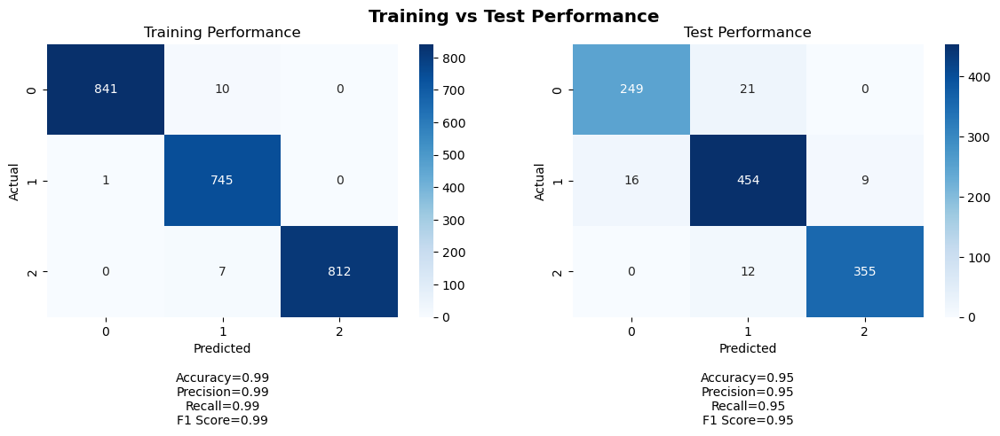

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9926929911194011
Recall: 0.9925496688741722
F1 Score: 0.9925708738484971

Test Metrics:
Accuracy: 0.9480286738351255
Precision: 0.9481774478846089
Recall: 0.9480286738351255
F1 Score: 0.948050337616435

Training Confusion Matrix:
Class 0 - TP: 841, FP: 1, TN: 1564, FN: 10
Class 1 - TP: 745, FP: 17, TN: 1653, FN: 1
Class 2 - TP: 812, FP: 0, TN: 1597, FN: 7

Test Confusion Matrix:
Class 0 - TP: 249, FP: 16, TN: 830, FN: 21
Class 1 - TP: 454, FP: 33, TN: 604, FN: 25
Class 2 - TP: 355, FP: 9, TN: 740, FN: 12
35/35 [==============================] - 0s 2ms/step


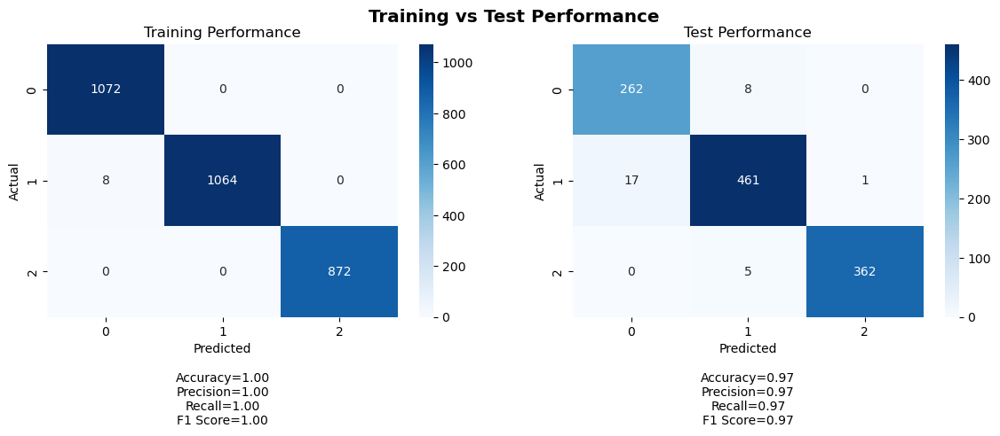

 96%|█████████▌| 96/100 [5:17:24<16:09, 242.36s/it]

Training Metrics:
Accuracy: 0.9973474801061007
Precision: 0.9973671284016111
Recall: 0.9973474801061007
F1 Score: 0.9973474431747572

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9725808575370429
Recall: 0.9722222222222222
F1 Score: 0.9723182415197257

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 8, TN: 1936, FN: 0
Class 1 - TP: 1064, FP: 0, TN: 1944, FN: 8
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 17, TN: 829, FN: 8
Class 1 - TP: 461, FP: 13, TN: 624, FN: 18
Class 2 - TP: 362, FP: 1, TN: 748, FN: 5
35/35 [==============================] - 0s 2ms/step


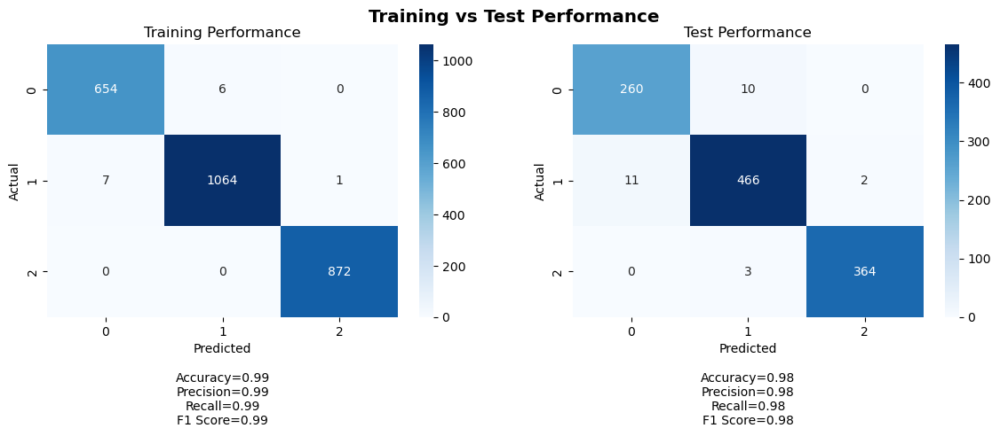

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.9946238558130683
Recall: 0.9946236559139785
F1 Score: 0.9946231455837174

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9767339838037902
Recall: 0.9767025089605734
F1 Score: 0.9767168439619821

Training Confusion Matrix:
Class 0 - TP: 654, FP: 7, TN: 1937, FN: 6
Class 1 - TP: 1064, FP: 6, TN: 1526, FN: 8
Class 2 - TP: 872, FP: 1, TN: 1731, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 11, TN: 835, FN: 10
Class 1 - TP: 466, FP: 13, TN: 624, FN: 13
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3
35/35 [==============================] - 0s 2ms/step


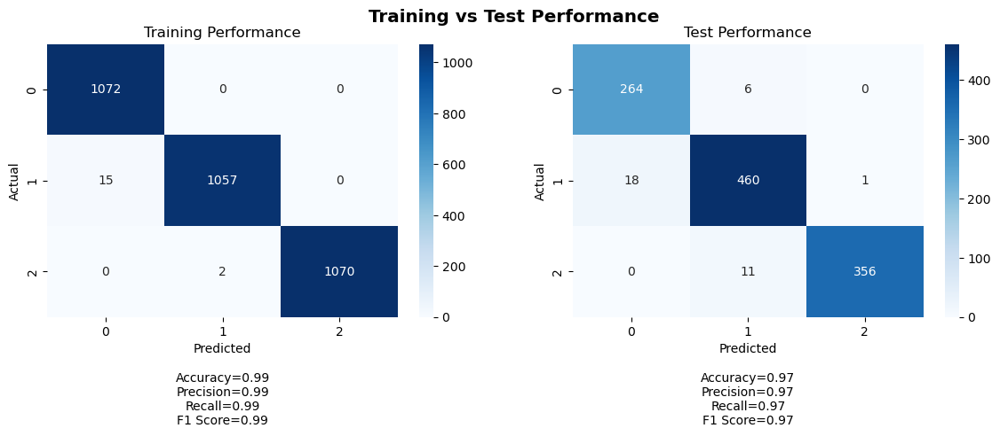

Training Metrics:
Accuracy: 0.9947139303482587
Precision: 0.9947706592837955
Recall: 0.9947139303482587
F1 Score: 0.9947137189553721

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9683393077207266
Recall: 0.967741935483871
F1 Score: 0.967867687933042

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 15, TN: 2129, FN: 0
Class 1 - TP: 1057, FP: 2, TN: 2142, FN: 15
Class 2 - TP: 1070, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 264, FP: 18, TN: 828, FN: 6
Class 1 - TP: 460, FP: 17, TN: 620, FN: 19
Class 2 - TP: 356, FP: 1, TN: 748, FN: 11
35/35 [==============================] - 0s 2ms/step


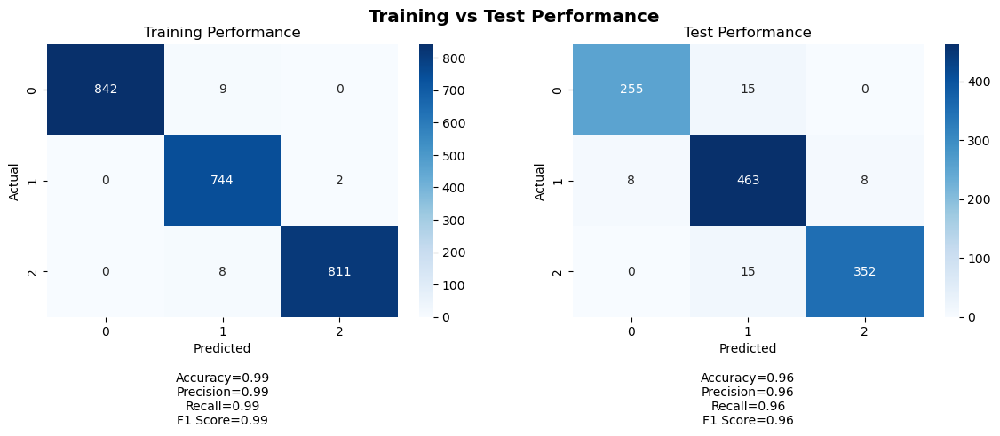

Training Metrics:
Accuracy: 0.992135761589404
Precision: 0.9922683465506322
Recall: 0.992135761589404
F1 Score: 0.9921573900418496

Test Metrics:
Accuracy: 0.9587813620071685
Precision: 0.9592145552558047
Recall: 0.9587813620071685
F1 Score: 0.958843651256135

Training Confusion Matrix:
Class 0 - TP: 842, FP: 0, TN: 1565, FN: 9
Class 1 - TP: 744, FP: 17, TN: 1653, FN: 2
Class 2 - TP: 811, FP: 2, TN: 1595, FN: 8

Test Confusion Matrix:
Class 0 - TP: 255, FP: 8, TN: 838, FN: 15
Class 1 - TP: 463, FP: 30, TN: 607, FN: 16
Class 2 - TP: 352, FP: 8, TN: 741, FN: 15
35/35 [==============================] - 0s 1ms/step


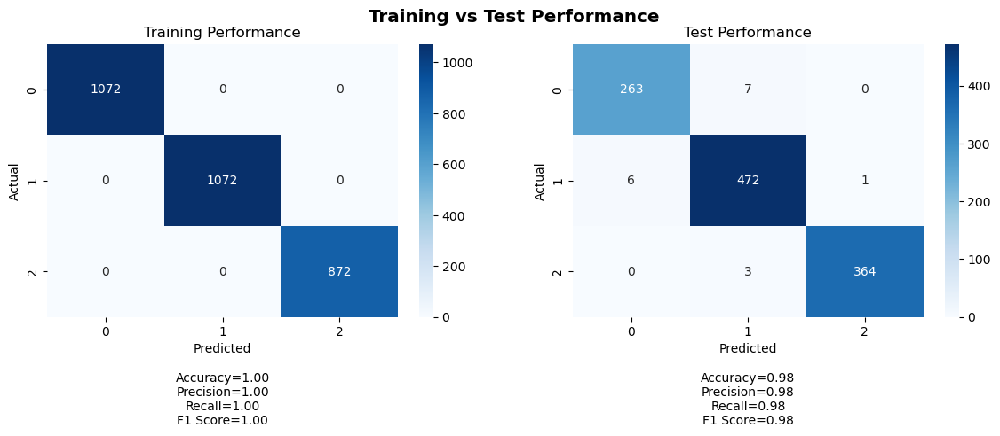

 97%|█████████▋| 97/100 [5:20:08<10:56, 218.73s/it]

Training Metrics:
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 Score: 1.0

Test Metrics:
Accuracy: 0.9847670250896058
Precision: 0.984797899981301
Recall: 0.9847670250896058
F1 Score: 0.9847750994708286

Training Confusion Matrix:
Class 0 - TP: 1072, FP: 0, TN: 1944, FN: 0
Class 1 - TP: 1072, FP: 0, TN: 1944, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 263, FP: 6, TN: 840, FN: 7
Class 1 - TP: 472, FP: 10, TN: 627, FN: 7
Class 2 - TP: 364, FP: 1, TN: 748, FN: 3
35/35 [==============================] - 0s 1ms/step


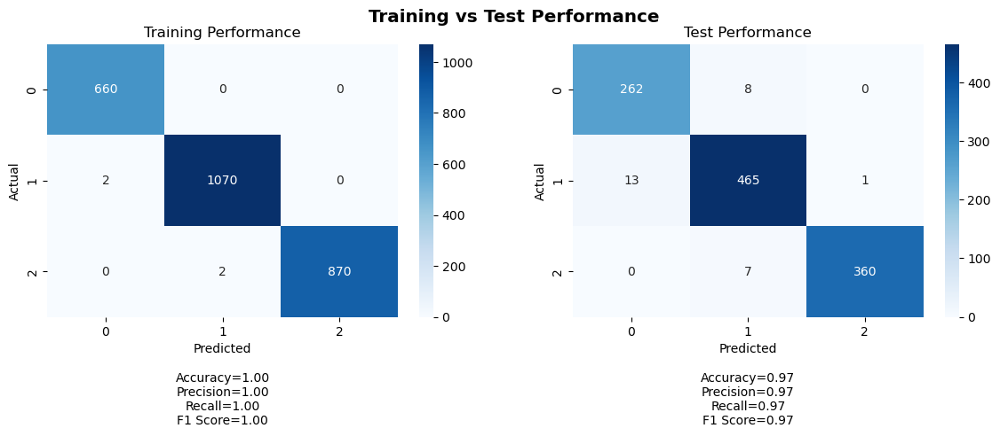

Training Metrics:
Accuracy: 0.9984639016897081
Precision: 0.9984662220799049
Recall: 0.9984639016897081
F1 Score: 0.9984640417640853

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9742392411628573
Recall: 0.9740143369175627
F1 Score: 0.9740846623287116

Training Confusion Matrix:
Class 0 - TP: 660, FP: 2, TN: 1942, FN: 0
Class 1 - TP: 1070, FP: 2, TN: 1530, FN: 2
Class 2 - TP: 870, FP: 0, TN: 1732, FN: 2

Test Confusion Matrix:
Class 0 - TP: 262, FP: 13, TN: 833, FN: 8
Class 1 - TP: 465, FP: 15, TN: 622, FN: 14
Class 2 - TP: 360, FP: 1, TN: 748, FN: 7
35/35 [==============================] - 0s 2ms/step


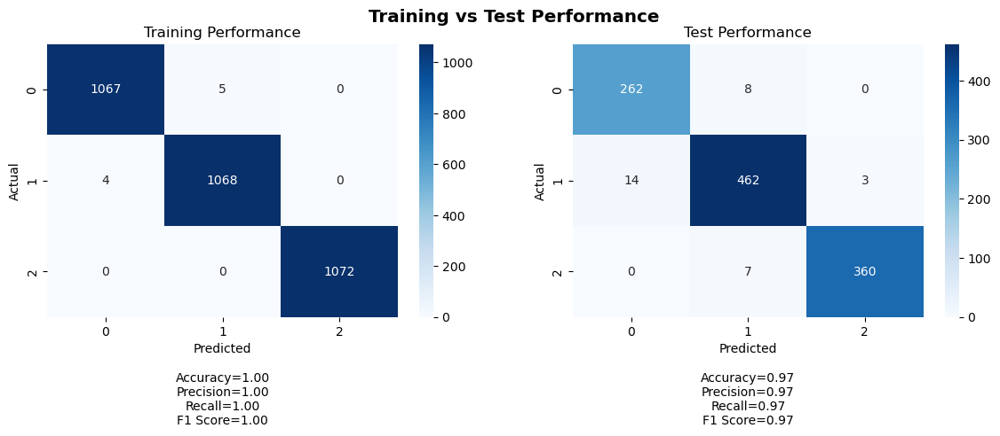

Training Metrics:
Accuracy: 0.9972014925373134
Precision: 0.9972017801632406
Recall: 0.9972014925373134
F1 Score: 0.99720149192851

Test Metrics:
Accuracy: 0.9713261648745519
Precision: 0.9715129004418336
Recall: 0.9713261648745519
F1 Score: 0.9713799364312345

Training Confusion Matrix:
Class 0 - TP: 1067, FP: 4, TN: 2140, FN: 5
Class 1 - TP: 1068, FP: 5, TN: 2139, FN: 4
Class 2 - TP: 1072, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 262, FP: 14, TN: 832, FN: 8
Class 1 - TP: 462, FP: 15, TN: 622, FN: 17
Class 2 - TP: 360, FP: 3, TN: 746, FN: 7
35/35 [==============================] - 0s 2ms/step


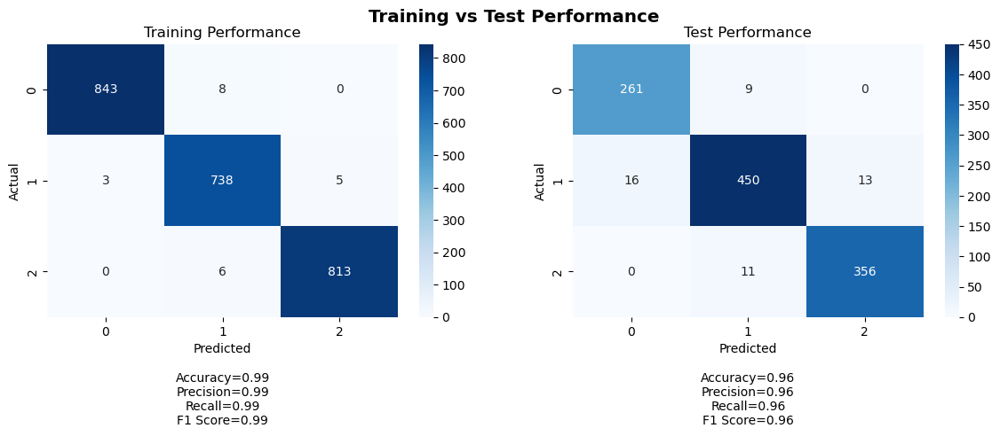

Training Metrics:
Accuracy: 0.9908940397350994
Precision: 0.9909304052821887
Recall: 0.9908940397350994
F1 Score: 0.9909041779274447

Test Metrics:
Accuracy: 0.9560931899641577
Precision: 0.9561754606730885
Recall: 0.9560931899641577
F1 Score: 0.9560575468554139

Training Confusion Matrix:
Class 0 - TP: 843, FP: 3, TN: 1562, FN: 8
Class 1 - TP: 738, FP: 14, TN: 1656, FN: 8
Class 2 - TP: 813, FP: 5, TN: 1592, FN: 6

Test Confusion Matrix:
Class 0 - TP: 261, FP: 16, TN: 830, FN: 9
Class 1 - TP: 450, FP: 20, TN: 617, FN: 29
Class 2 - TP: 356, FP: 13, TN: 736, FN: 11
35/35 [==============================] - 0s 2ms/step


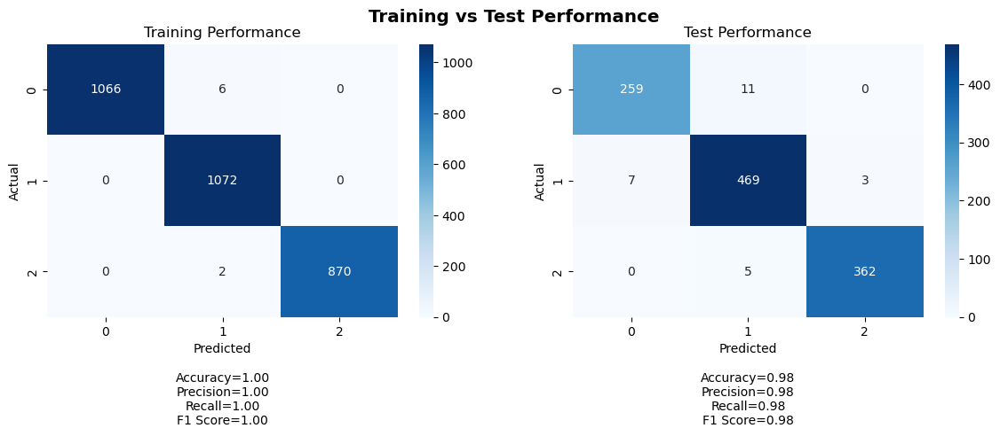

 98%|█████████▊| 98/100 [5:22:46<06:41, 200.70s/it]

Training Metrics:
Accuracy: 0.9973474801061007
Precision: 0.9973671284016111
Recall: 0.9973474801061007
F1 Score: 0.9973492382956216

Test Metrics:
Accuracy: 0.9767025089605734
Precision: 0.9767708213532893
Recall: 0.9767025089605734
F1 Score: 0.9767050355933846

Training Confusion Matrix:
Class 0 - TP: 1066, FP: 0, TN: 1944, FN: 6
Class 1 - TP: 1072, FP: 8, TN: 1936, FN: 0
Class 2 - TP: 870, FP: 0, TN: 2144, FN: 2

Test Confusion Matrix:
Class 0 - TP: 259, FP: 7, TN: 839, FN: 11
Class 1 - TP: 469, FP: 16, TN: 621, FN: 10
Class 2 - TP: 362, FP: 3, TN: 746, FN: 5
35/35 [==============================] - 0s 1ms/step


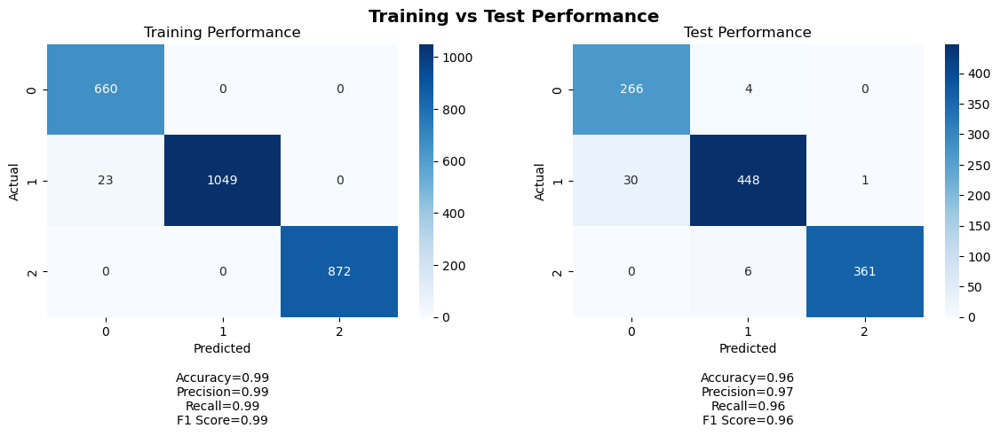

Training Metrics:
Accuracy: 0.9911674347158218
Precision: 0.9914648710284663
Recall: 0.9911674347158218
F1 Score: 0.9911951773447035

Test Metrics:
Accuracy: 0.9632616487455197
Precision: 0.9651996484736526
Recall: 0.9632616487455197
F1 Score: 0.963528197315048

Training Confusion Matrix:
Class 0 - TP: 660, FP: 23, TN: 1921, FN: 0
Class 1 - TP: 1049, FP: 0, TN: 1532, FN: 23
Class 2 - TP: 872, FP: 0, TN: 1732, FN: 0

Test Confusion Matrix:
Class 0 - TP: 266, FP: 30, TN: 816, FN: 4
Class 1 - TP: 448, FP: 10, TN: 627, FN: 31
Class 2 - TP: 361, FP: 1, TN: 748, FN: 6
35/35 [==============================] - 0s 2ms/step


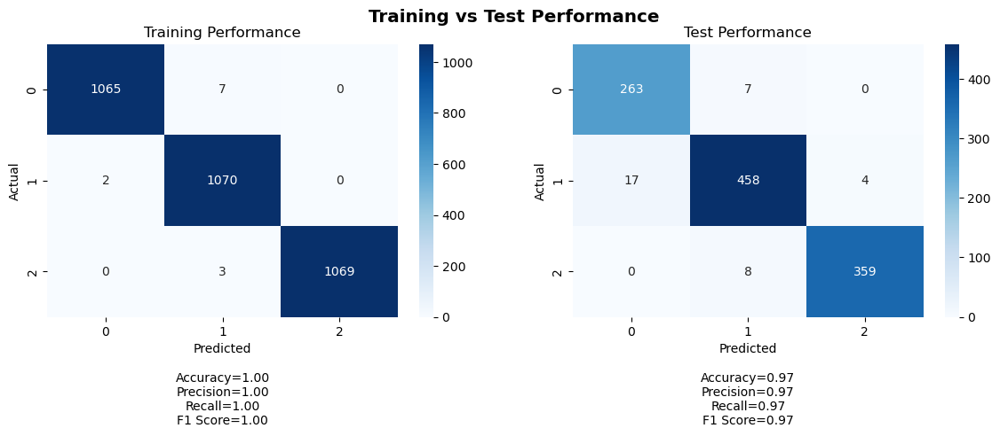

Training Metrics:
Accuracy: 0.996268656716418
Precision: 0.9962887754983976
Recall: 0.996268656716418
F1 Score: 0.9962716679344071

Test Metrics:
Accuracy: 0.967741935483871
Precision: 0.9680759774916836
Recall: 0.967741935483871
F1 Score: 0.9678063259208798

Training Confusion Matrix:
Class 0 - TP: 1065, FP: 2, TN: 2142, FN: 7
Class 1 - TP: 1070, FP: 10, TN: 2134, FN: 2
Class 2 - TP: 1069, FP: 0, TN: 2144, FN: 3

Test Confusion Matrix:
Class 0 - TP: 263, FP: 17, TN: 829, FN: 7
Class 1 - TP: 458, FP: 15, TN: 622, FN: 21
Class 2 - TP: 359, FP: 4, TN: 745, FN: 8
35/35 [==============================] - 0s 2ms/step


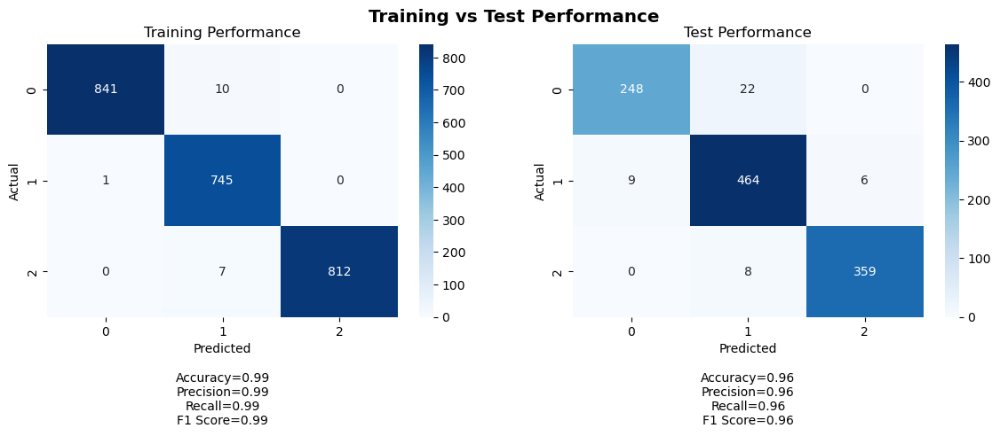

Training Metrics:
Accuracy: 0.9925496688741722
Precision: 0.9926929911194011
Recall: 0.9925496688741722
F1 Score: 0.9925708738484971

Test Metrics:
Accuracy: 0.9596774193548387
Precision: 0.9600562737844734
Recall: 0.9596774193548387
F1 Score: 0.959628482742486

Training Confusion Matrix:
Class 0 - TP: 841, FP: 1, TN: 1564, FN: 10
Class 1 - TP: 745, FP: 17, TN: 1653, FN: 1
Class 2 - TP: 812, FP: 0, TN: 1597, FN: 7

Test Confusion Matrix:
Class 0 - TP: 248, FP: 9, TN: 837, FN: 22
Class 1 - TP: 464, FP: 30, TN: 607, FN: 15
Class 2 - TP: 359, FP: 6, TN: 743, FN: 8
35/35 [==============================] - 0s 1ms/step


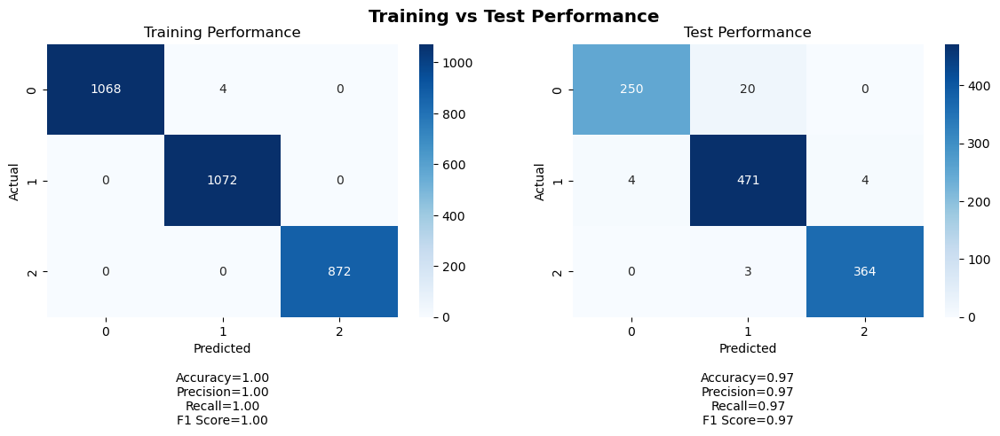

 99%|█████████▉| 99/100 [5:25:09<03:03, 183.20s/it]

Training Metrics:
Accuracy: 0.9986737400530504
Precision: 0.9986786703874257
Recall: 0.9986737400530504
F1 Score: 0.9986737354366807

Test Metrics:
Accuracy: 0.9722222222222222
Precision: 0.9726319727850197
Recall: 0.9722222222222222
F1 Score: 0.9721122772283223

Training Confusion Matrix:
Class 0 - TP: 1068, FP: 0, TN: 1944, FN: 4
Class 1 - TP: 1072, FP: 4, TN: 1940, FN: 0
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 250, FP: 4, TN: 842, FN: 20
Class 1 - TP: 471, FP: 23, TN: 614, FN: 8
Class 2 - TP: 364, FP: 4, TN: 745, FN: 3
35/35 [==============================] - 0s 1ms/step


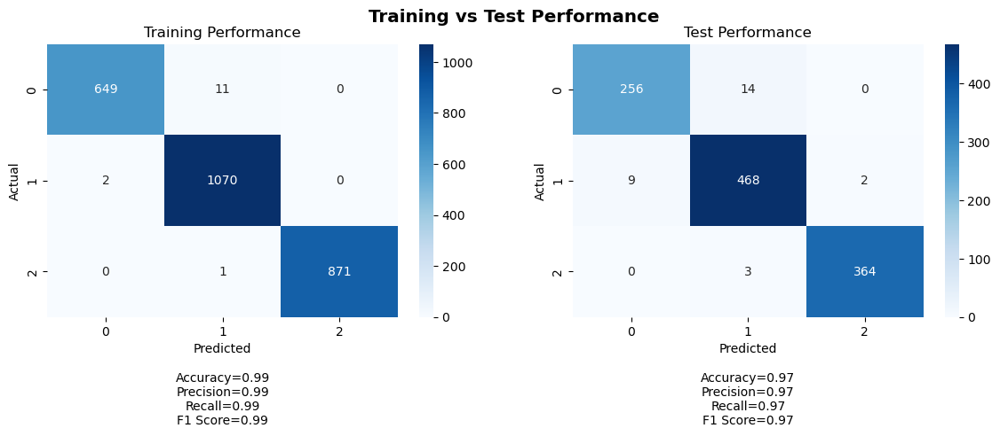

Training Metrics:
Accuracy: 0.9946236559139785
Precision: 0.994655628249057
Recall: 0.9946236559139785
F1 Score: 0.9946188895512195

Test Metrics:
Accuracy: 0.974910394265233
Precision: 0.9749417862694637
Recall: 0.974910394265233
F1 Score: 0.9748891125920663

Training Confusion Matrix:
Class 0 - TP: 649, FP: 2, TN: 1942, FN: 11
Class 1 - TP: 1070, FP: 12, TN: 1520, FN: 2
Class 2 - TP: 871, FP: 0, TN: 1732, FN: 1

Test Confusion Matrix:
Class 0 - TP: 256, FP: 9, TN: 837, FN: 14
Class 1 - TP: 468, FP: 17, TN: 620, FN: 11
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3
35/35 [==============================] - 0s 3ms/step


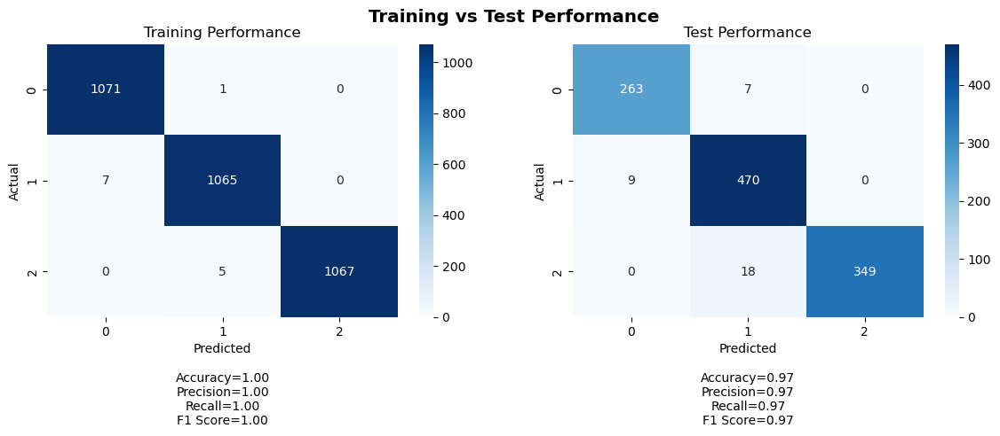

Training Metrics:
Accuracy: 0.9959577114427861
Precision: 0.9959680842033783
Recall: 0.9959577114427861
F1 Score: 0.9959584222037642

Test Metrics:
Accuracy: 0.9695340501792115
Precision: 0.9703174348375171
Recall: 0.9695340501792115
F1 Score: 0.9696079964984323

Training Confusion Matrix:
Class 0 - TP: 1071, FP: 7, TN: 2137, FN: 1
Class 1 - TP: 1065, FP: 6, TN: 2138, FN: 7
Class 2 - TP: 1067, FP: 0, TN: 2144, FN: 5

Test Confusion Matrix:
Class 0 - TP: 263, FP: 9, TN: 837, FN: 7
Class 1 - TP: 470, FP: 25, TN: 612, FN: 9
Class 2 - TP: 349, FP: 0, TN: 749, FN: 18
35/35 [==============================] - 0s 2ms/step


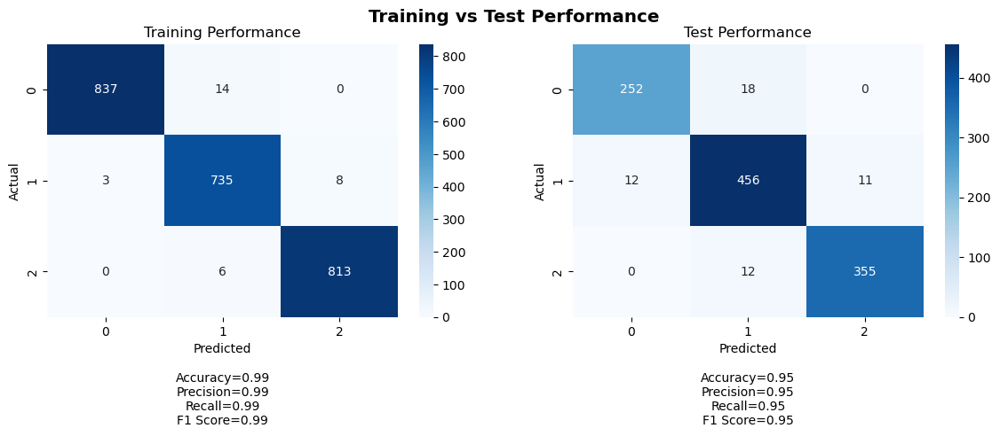

Training Metrics:
Accuracy: 0.9871688741721855
Precision: 0.9872593598139429
Recall: 0.9871688741721855
F1 Score: 0.9871879891972161

Test Metrics:
Accuracy: 0.9525089605734767
Precision: 0.9526248358852115
Recall: 0.9525089605734767
F1 Score: 0.9525161287669438

Training Confusion Matrix:
Class 0 - TP: 837, FP: 3, TN: 1562, FN: 14
Class 1 - TP: 735, FP: 20, TN: 1650, FN: 11
Class 2 - TP: 813, FP: 8, TN: 1589, FN: 6

Test Confusion Matrix:
Class 0 - TP: 252, FP: 12, TN: 834, FN: 18
Class 1 - TP: 456, FP: 30, TN: 607, FN: 23
Class 2 - TP: 355, FP: 11, TN: 738, FN: 12
35/35 [==============================] - 0s 3ms/step


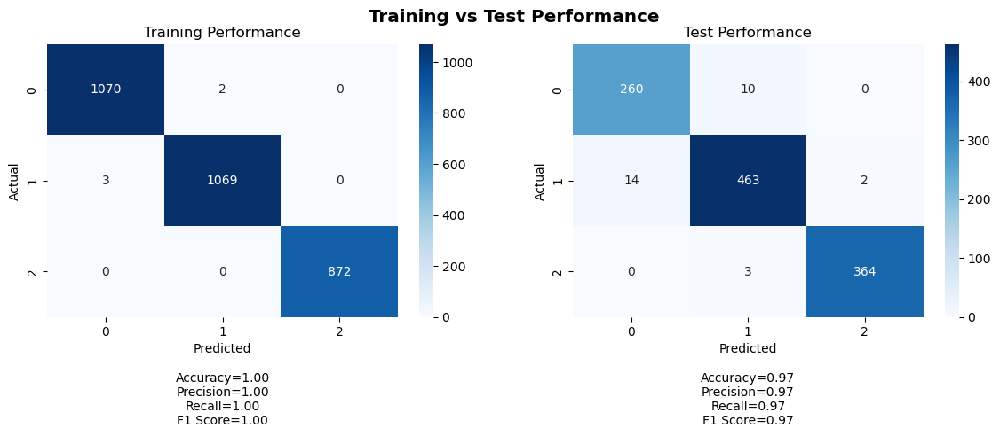

100%|██████████| 100/100 [5:28:25<00:00, 197.05s/it]

Training Metrics:
Accuracy: 0.998342175066313
Precision: 0.9983424829196668
Recall: 0.998342175066313
F1 Score: 0.9983421747056603

Test Metrics:
Accuracy: 0.9740143369175627
Precision: 0.9741191597742475
Recall: 0.9740143369175627
F1 Score: 0.9740495294934562

Training Confusion Matrix:
Class 0 - TP: 1070, FP: 3, TN: 1941, FN: 2
Class 1 - TP: 1069, FP: 2, TN: 1942, FN: 3
Class 2 - TP: 872, FP: 0, TN: 2144, FN: 0

Test Confusion Matrix:
Class 0 - TP: 260, FP: 14, TN: 832, FN: 10
Class 1 - TP: 463, FP: 13, TN: 624, FN: 16
Class 2 - TP: 364, FP: 2, TN: 747, FN: 3


In [31]:
# Redo the process multiple times and count the winners
winner_count = repeat_train_and_test(iterations=100)

# Save the result into a json file
with open('./datasets/winner_data.json', 'w') as f:
    json.dump(winner_count, f)

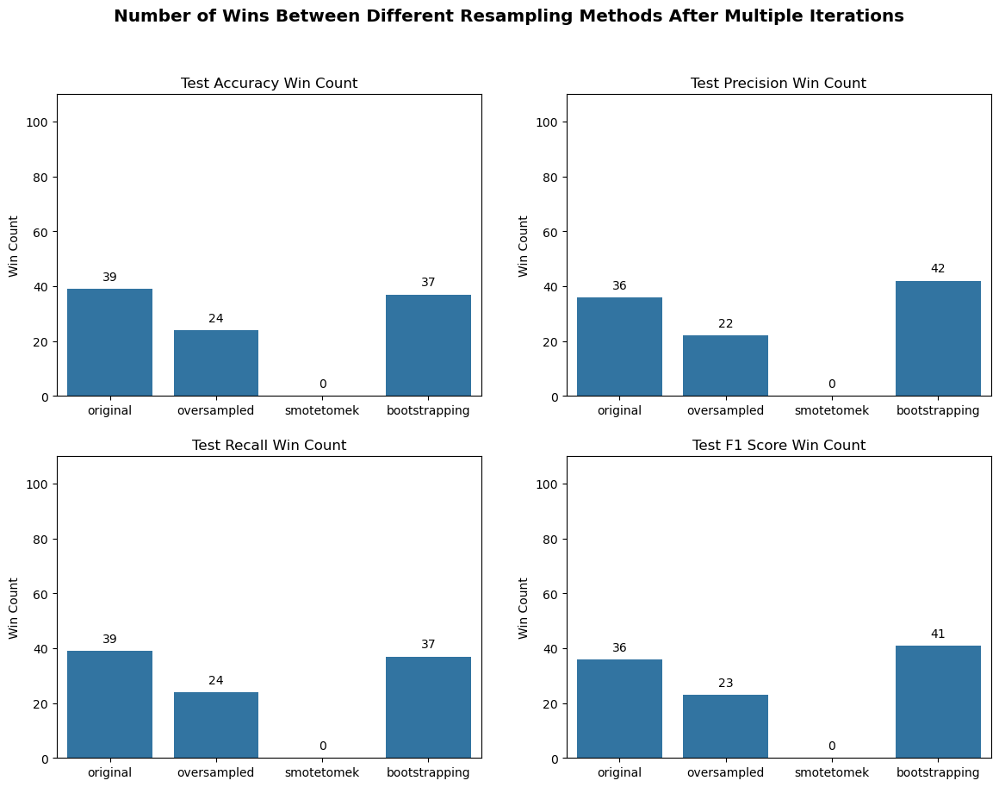

In [32]:
# Load json file
with open('./datasets/winner_data.json') as f:
    winner_count = json.load(f)
    
visualize_winner_count(winner_count)

After many iterations, we can see that we should use bootstrapping resampling method was it is relatively better.